In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import math
import pandas as pd
#import uproot
import uproot3
from scipy import optimize as op
import scipy.integrate as integrate

In [2]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb
#uproot3
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH1\ Functions-uproot3.ipynb

#Gain Access to functions for taking discrete derivatives of lists of data
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Derivatives.ipynb

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

In [65]:
#date="05-07-2024"
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date+"/cc"
dir="/Users/cmc/analysis_phd/root_files/local_runs/e16/target"
root_file=dir+"/analysis_full_e16_geo_fid.root"
#root_file=dir+"/exp_e16_clas6_fid_geo_"+date+".root"
file=uproot3.open(root_file)

species="ele"
detector="cc"
cut="pid"

sector_names = ["sec1","sec2","sec3","sec4","sec5","sec6","all"]
sides = ["right","coinc","left","All"]
num_cc_seg = 18
num_cc_side = 3
num_sc_pad = 48
#0-> pid | 1->event selection all 

edge_shifts = [-0.8,-0.1,0.7]


In [4]:
color_order = ['b','g','r']
rv_color_order = ['r','g','b']
cut_name = ['tight','mid','loose']
rv_cut_name = ['loose','mid','tight']

In [5]:
layer1="Geometric Distributions"
layer2="Geo Fid "+species
layer3=layer2+" "+detector
layer4=[layer3+" "+sector_names[sec] for sec in range(7)]
layer5=[layer4[sec]+" "+cut for sec in range(7)]

    

In [6]:
hist_idx_len = len(file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[0]+"/"+layer5[0]].keys())

hist = [[file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]][file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]].keys()[2*hist_idx]] for hist_idx in range(round(hist_idx_len/2))] for sec in range(7)]


cut_hist_len = round(hist_idx_len/4)

In [7]:
def x_idx(xarray_, xval_):
    for i in range(len(xarray_)):
        if xarray_[i] <= xval_:
            if xarray_[i+1] >= xval_:
                return i
    return -1

def y_idx(yarray_, yval_):
    for i in range(len(yarray_)):
        if yarray_[i] <= yval_:
            if yarray_[i+1] >= yval_:
                return i
    return -1

In [8]:
#For cut only
def side_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return 0
        elif hist_idx < num_cc_seg*2:
            return 1
        else:
            return 2
    elif hist_idx_ <= num_cc_seg*3+3:
        return hist_idx_ - (num_cc_seg*3)

def seg_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return hist_idx_
        elif hist_idx < num_cc_seg*2:
            return hist_idx_ - num_cc_seg
        else:
            return hist_idx_ - num_cc_seg*2
    elif hist_idx_ <= num_cc_seg*3+3:
        return _num_cc_seg
    
def pad_idx(hist_idx_):
    if hist_idx_ <= _num_sc_pad:
        return hist_idx_ 
    else:
        return -1
    
def cc_hist_idx(side_, seg_):
    if side_ == 3:
        if seg_ == num_cc_seg:
            return cut_hist_len-1
        else:
            return -1
    else:
        if seg_ == num_cc_seg:
            return num_cc_seg*3 + side_
        else:
            return num_cc_seg*side_ + seg_
    

In [9]:
#Look at Overall Distributions
xdim_len = len(Center_Xbins(hist[0][0]))
ydim_len = len(Center_Ybins(hist[0][0]))

x_merge = 1
y_merge = 1


xvals = Merge_Bins(Center_Xbins(hist[0][0]),x_merge)
yvals = Merge_Bins(Center_Ybins(hist[0][0]),y_merge)
zvals_xy = [[Merge_Z(XY_Values(hist[sec][hist_idx]),x_merge,y_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]
zvals_yx = [[Merge_Z(YX_Values(hist[sec][hist_idx]),y_merge,x_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]



In [10]:
xdim = len(xvals)
ydim = len(yvals)

xres = xvals[1]-xvals[0]
yres = yvals[1]-yvals[0]

def shift_idx(x_shift_):
    return round(x_shift_/xres)

In [11]:
dumb1_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense1 = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense2 = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x[sec][hist_idx][i+j*xdim]+=xvals[i]
                dumb1_y[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y[sec][hist_idx][j+i*ydim]+=xvals[i]
                dense2[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]


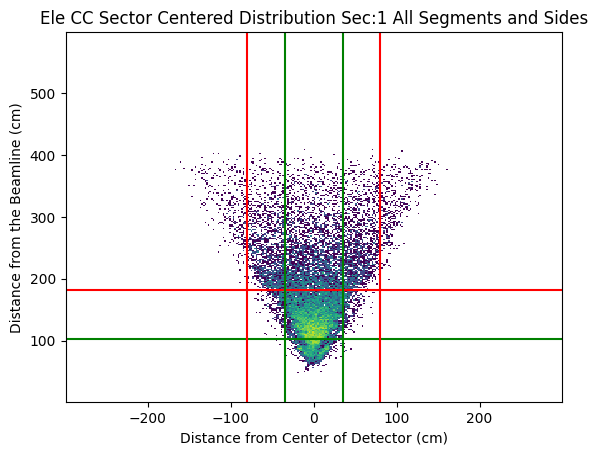

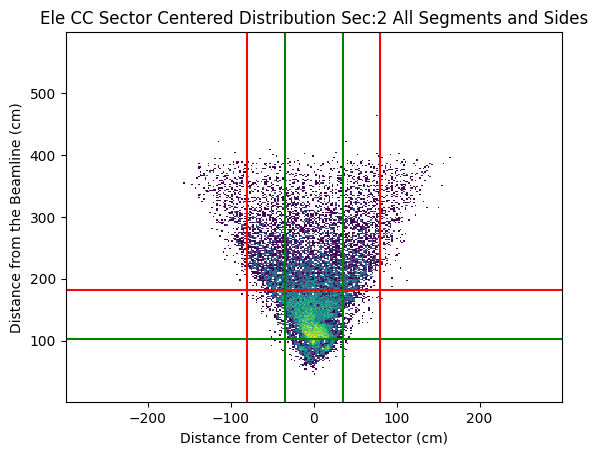

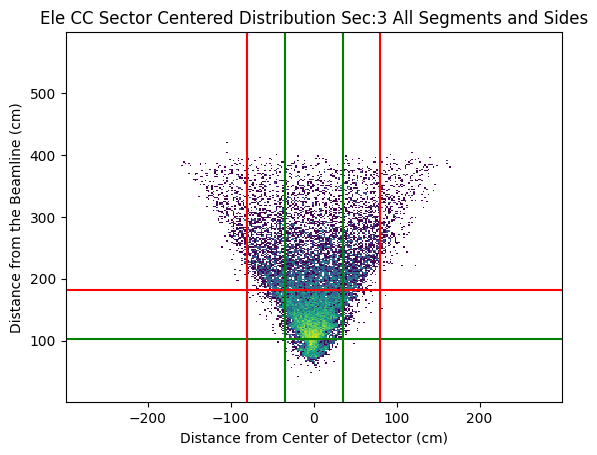

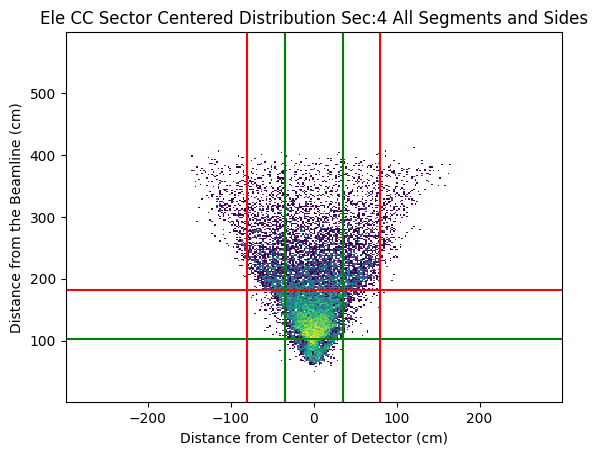

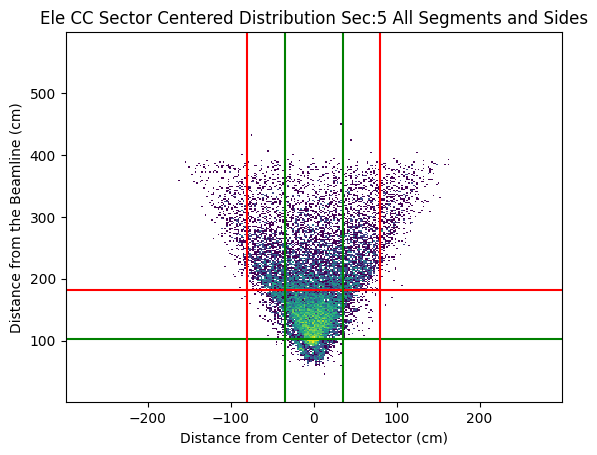

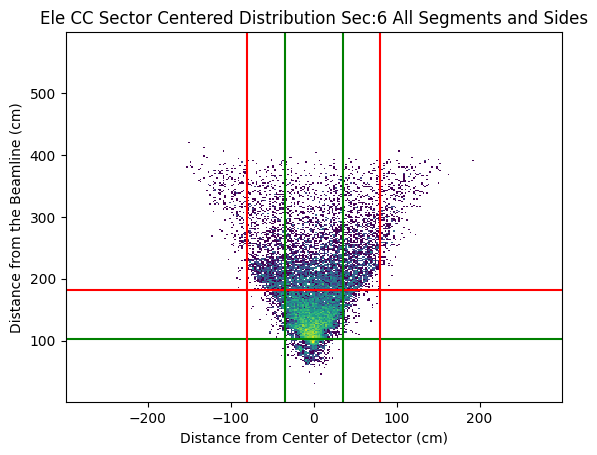

In [12]:
yidx=[51,90]

xrange = [[[-35,35],[-80,80]],
          [[-35,35],[-80,80]],
          [[-35,35],[-80,80]],
          [[-35,35],[-80,80]],
          [[-35,35],[-80,80]],
          [[-35,35],[-80,80]]]

for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.axhline(y=yvals[yidx[0]],color='g')
    plt.axhline(y=yvals[yidx[1]],color='r')
    plt.axvline(x=xrange[sec][0][0],color='g')
    plt.axvline(x=xrange[sec][0][1],color='g')
    plt.axvline(x=xrange[sec][1][0],color='r')
    plt.axvline(x=xrange[sec][1][1],color='r')
    plt.title("Ele CC Sector Centered Distribution Sec:{} All Segments and Sides".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

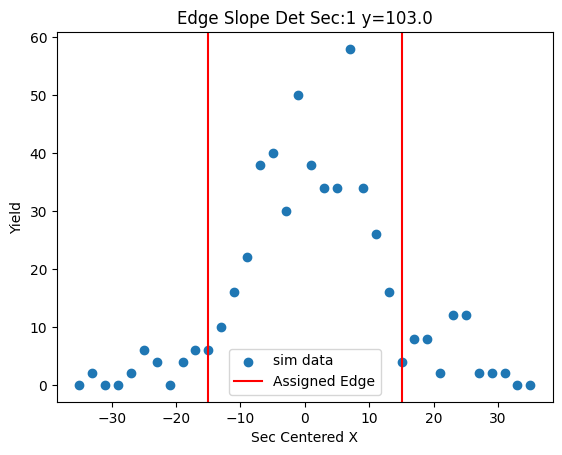

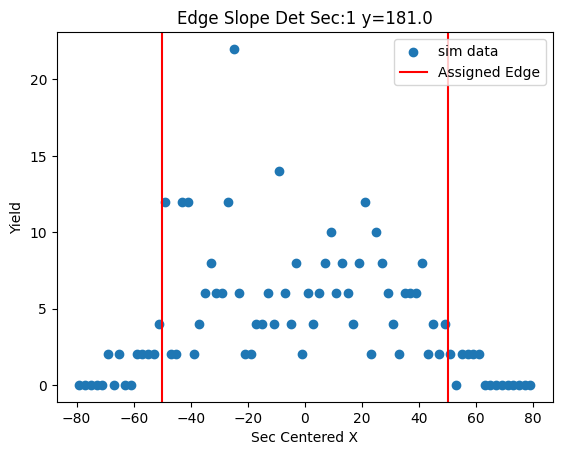

Right Slope =  2.2285714285714286
Left Slope =  -2.2285714285714286


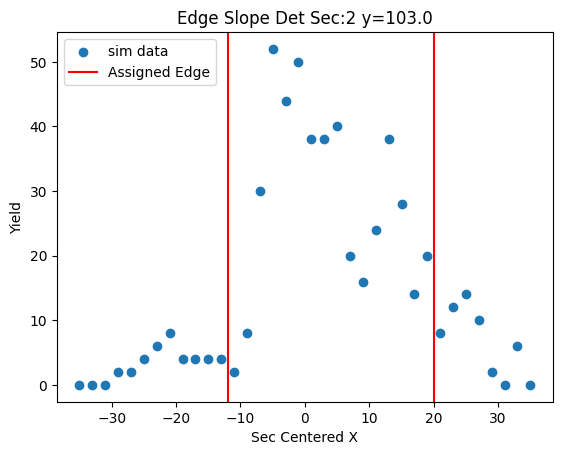

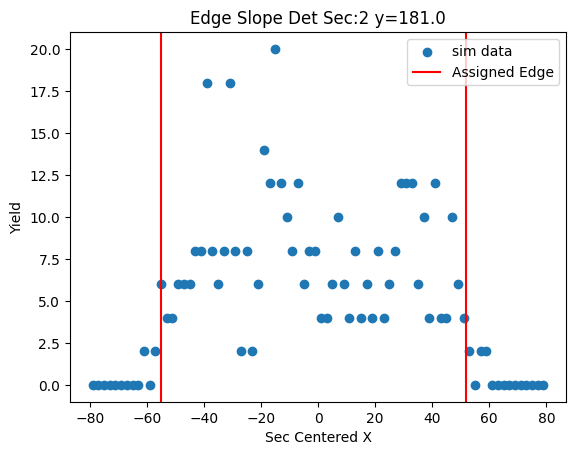

Right Slope =  2.4375
Left Slope =  -1.813953488372093


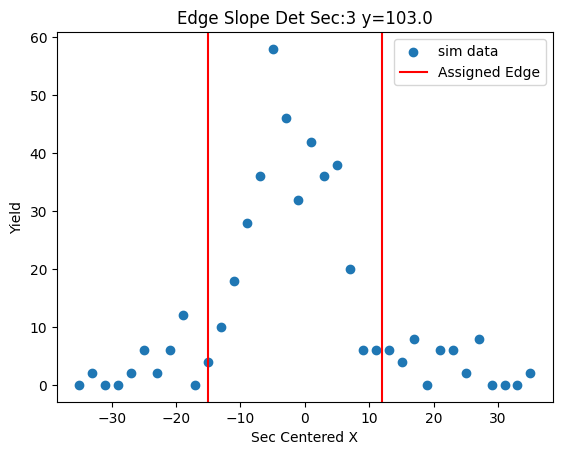

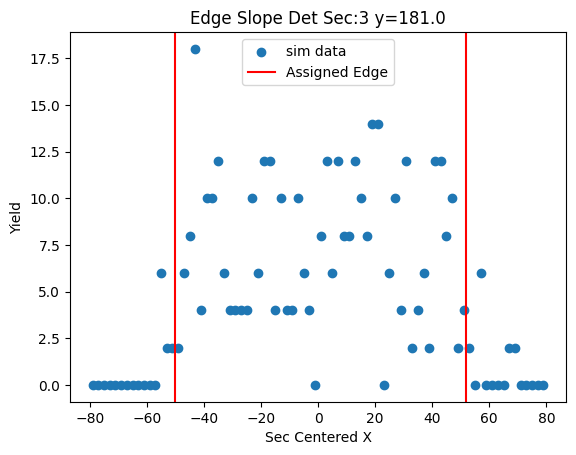

Right Slope =  1.95
Left Slope =  -2.2285714285714286


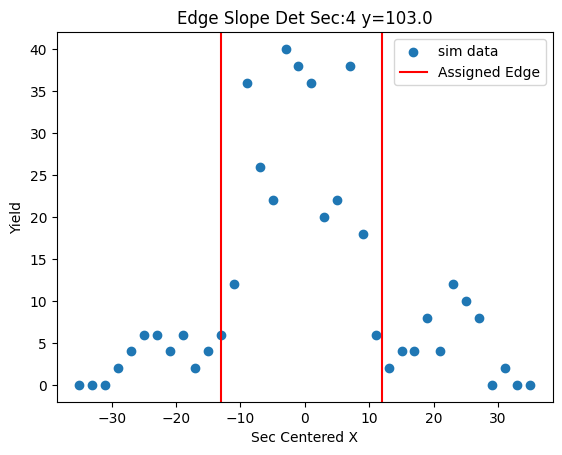

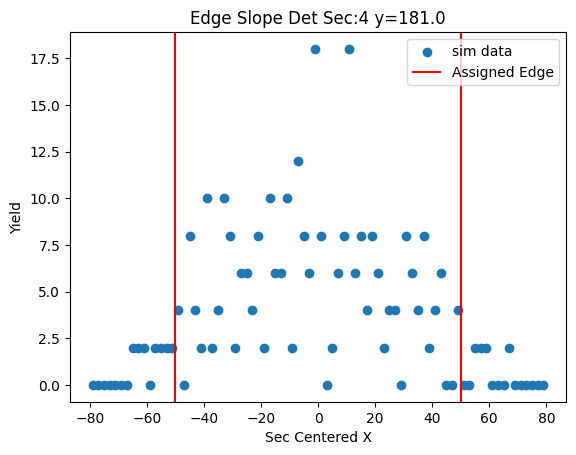

Right Slope =  2.0526315789473686
Left Slope =  -2.108108108108108


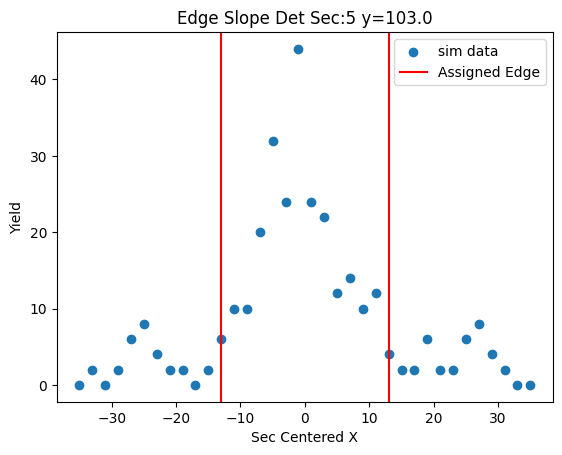

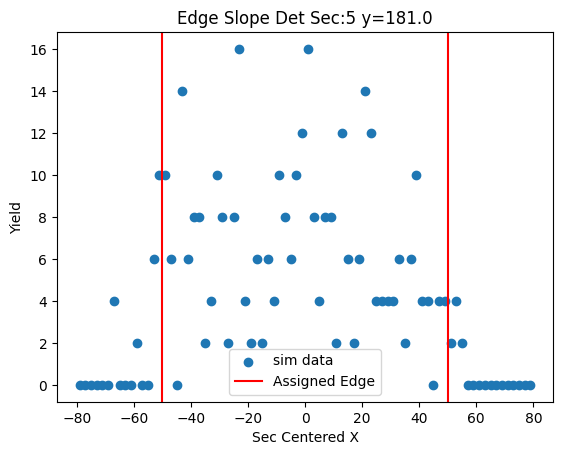

Right Slope =  2.108108108108108
Left Slope =  -2.108108108108108


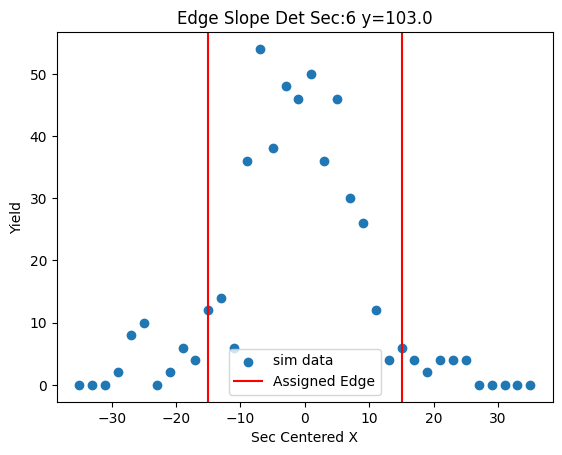

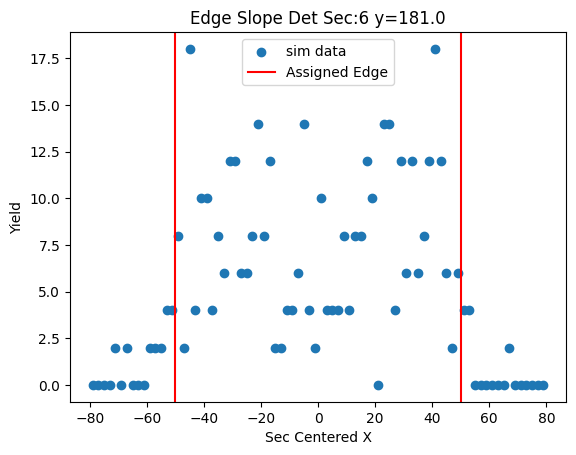

Right Slope =  2.2285714285714286
Left Slope =  -2.2285714285714286


In [13]:


x_points = [[[-15,15],[-50,50]],#1
            [[-12,20],[-55,52]],#2
            [[-15,12],[-50,52]],#3
            [[-13,12],[-50,50]],#4
            [[-13,13],[-50,50]],#5
            [[-15,15],[-50,50]]]#6

right_rot = [3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2)]
left_rot = [3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2)]


for sec in range(6):
    for b in range(2):
        mod_xvals = Bounds_on_Y(xvals,xrange[sec][b][0],xrange[sec][b][1])
        mod_zvals = Bounds_on_X_From_Y(zvals_yx[sec][cut_hist_len-1][yidx[b]],xvals,xrange[sec][b][0],xrange[sec][b][1])
        plt.scatter(mod_xvals,mod_zvals,label="sim data")
        plt.axvline(x=x_points[sec][b][0],color='r',label="Assigned Edge")
        plt.axvline(x=x_points[sec][b][1],color='r')
        plt.title("Edge Slope Det Sec:{} y={}".format(sec+1,yvals[yidx[b]]))
        plt.xlabel("Sec Centered X")
        plt.ylabel("Yield")
        plt.legend()
        plt.show()
    right_rot[sec] =  (yvals[yidx[1]]-yvals[yidx[0]])/(x_points[sec][1][1]-x_points[sec][0][1])
    left_rot[sec] = (yvals[yidx[1]]-yvals[yidx[0]])/(x_points[sec][1][0]-x_points[sec][0][0])
    print("Right Slope = ",right_rot[sec])
    print("Left Slope = ",left_rot[sec])

In [14]:
proj_y = np.zeros((7,cut_hist_len,ydim))
proj_x = np.zeros((7,cut_hist_len,ydim))
proj_xr = np.zeros((7,cut_hist_len,xdim))
proj_xl = np.zeros((7,cut_hist_len,xdim))
for sec in range(7):
    for i in range(ydim):
        for j in range(xdim):
            for side in range(3):
                for seg in range(num_cc_seg+1):
                    proj_y[sec][cc_hist_idx(side,seg)][i] += zvals_xy[sec][cc_hist_idx(side,seg)][j][i]
                    proj_x[sec][cc_hist_idx(side,seg)][j] += zvals_yx[sec][cc_hist_idx(side,seg)][i][j]
                    if side ==0:
                        if j-shift_idx(yvals[i]/(3**(1/2))) > 0:
                            proj_xr[sec][cc_hist_idx(side,seg)][j-shift_idx(yvals[i]/right_rot[sec])] += zvals_xy[sec][cc_hist_idx(side,seg)][j][i]
                    if side == 2:
                        if j+shift_idx(yvals[i]/(3**(1/2))) < xdim-1:
                            proj_xl[sec][cc_hist_idx(side,seg)][j-shift_idx(yvals[i]/left_rot[sec])] += zvals_xy[sec][cc_hist_idx(side,seg)][j][i]
                    

In [15]:
#Shifting for Right Edge
dumb1_x_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dense1_sr = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dense2_sr = np.zeros((7,cut_hist_len,xdim*ydim))
side = 0
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for seg in range(num_cc_seg+1):
                dumb1_x_sr[sec][cc_hist_idx(side,seg)][i+j*xdim]+=xvals[i]-yvals[j]/right_rot[sec]
                dumb1_y_sr[sec][cc_hist_idx(side,seg)][i+j*xdim]+=yvals[j]
                dense1_sr[sec][cc_hist_idx(side,seg)][i+j*xdim]+=zvals_xy[sec][cc_hist_idx(side,seg)][i][j]
                dumb2_x_sr[sec][cc_hist_idx(side,seg)][j+i*ydim]+=yvals[j]
                dumb2_y_sr[sec][cc_hist_idx(side,seg)][j+i*ydim]+=xvals[i]-yvals[j]/right_rot[sec]
                dense2_sr[sec][cc_hist_idx(side,seg)][j+i*ydim]+=zvals_yx[sec][cc_hist_idx(side,seg)][j][i]


b'ele_cc_Geometric_Fid_Sec:sec1_Cut:pid_cut_Seg:All_Side:left'


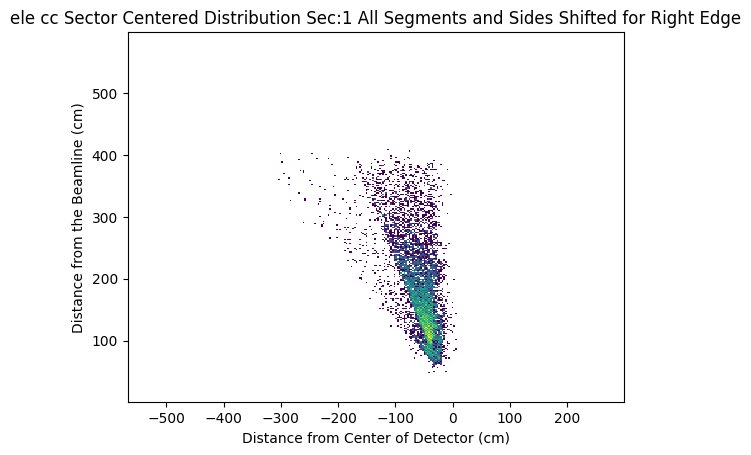

b'ele_cc_Geometric_Fid_Sec:sec2_Cut:pid_cut_Seg:All_Side:left'


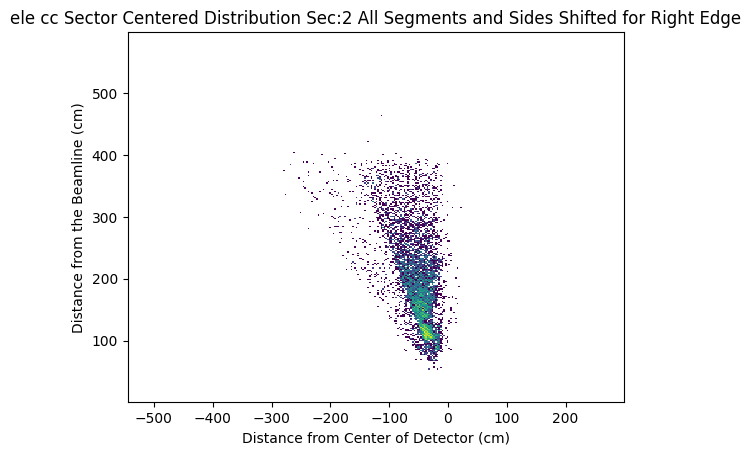

b'ele_cc_Geometric_Fid_Sec:sec3_Cut:pid_cut_Seg:All_Side:left'


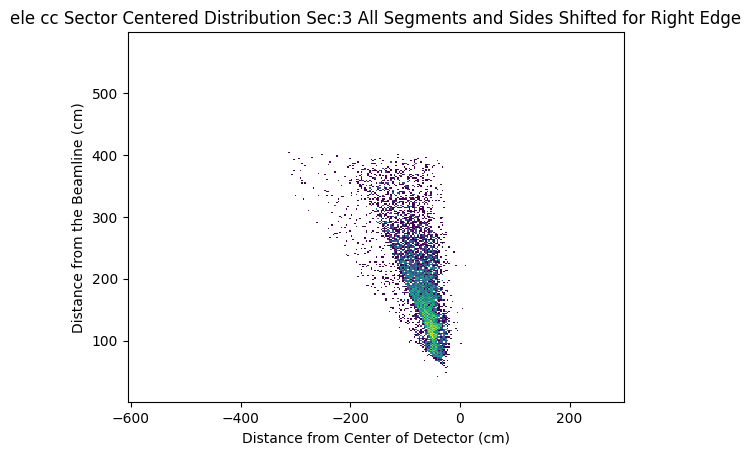

b'ele_cc_Geometric_Fid_Sec:sec4_Cut:pid_cut_Seg:All_Side:left'


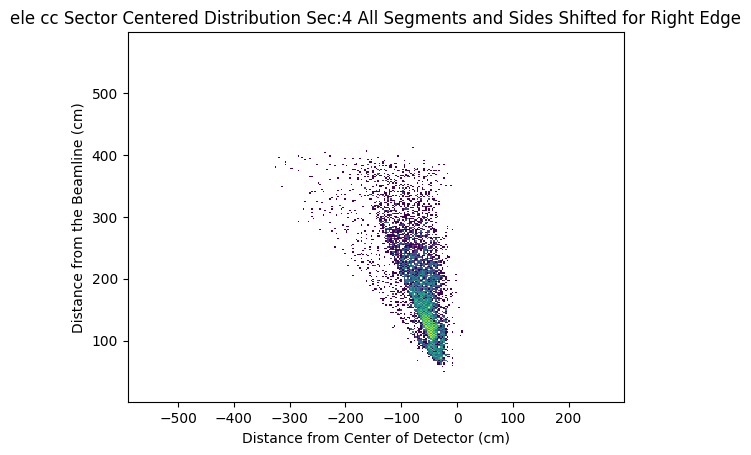

b'ele_cc_Geometric_Fid_Sec:sec5_Cut:pid_cut_Seg:All_Side:left'


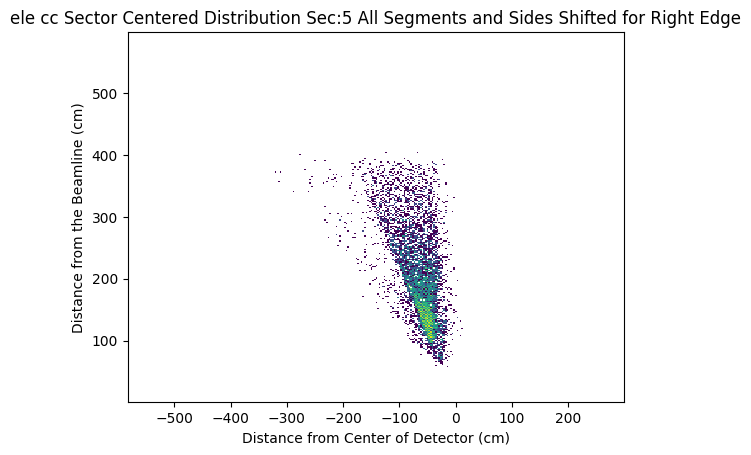

b'ele_cc_Geometric_Fid_Sec:sec6_Cut:pid_cut_Seg:All_Side:left'


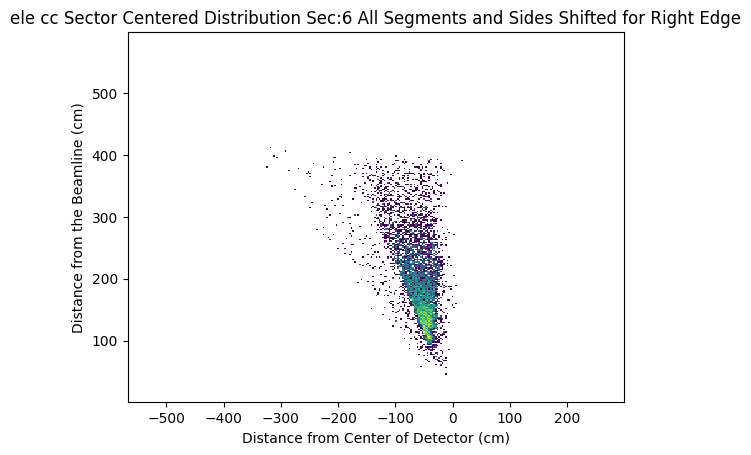

In [16]:
side = 0
for sec in range(6):
    plt.hist2d(dumb1_x_sr[sec][cc_hist_idx(side,num_cc_seg)], dumb1_y_sr[sec][cc_hist_idx(side,num_cc_seg)], bins=(xdim, ydim), weights=dense1_sr[sec][cc_hist_idx(side,num_cc_seg)],norm = mpl.colors.LogNorm())
    print(hist[sec][cc_hist_idx(side,num_cc_seg)].title)
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{} All Segments and Sides Shifted for Right Edge".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [17]:
#Shifting for left Edge
dumb1_x_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dense1_sl = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dense2_sl = np.zeros((7,cut_hist_len,xdim*ydim))
side = 2
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for seg in range(num_cc_seg+1):
                dumb1_x_sl[sec][cc_hist_idx(side,seg)][i+j*xdim]+=xvals[i]-yvals[j]/left_rot[sec]
                dumb1_y_sl[sec][cc_hist_idx(side,seg)][i+j*xdim]+=yvals[j]
                dense1_sl[sec][cc_hist_idx(side,seg)][i+j*xdim]+=zvals_xy[sec][cc_hist_idx(side,seg)][i][j]
                dumb2_x_sl[sec][cc_hist_idx(side,seg)][j+i*ydim]+=yvals[j]
                dumb2_y_sl[sec][cc_hist_idx(side,seg)][j+i*ydim]+=xvals[i]-yvals[j]/left_rot[sec]
                dense2_sl[sec][cc_hist_idx(side,seg)][j+i*ydim]+=zvals_yx[sec][cc_hist_idx(side,seg)][j][i]

b'ele_cc_Geometric_Fid_Sec:sec1_Cut:pid_cut_Seg:All_Side:right'


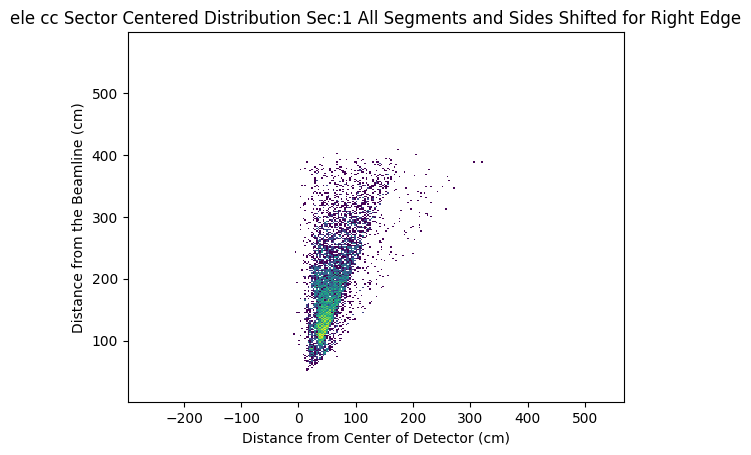

b'ele_cc_Geometric_Fid_Sec:sec2_Cut:pid_cut_Seg:All_Side:right'


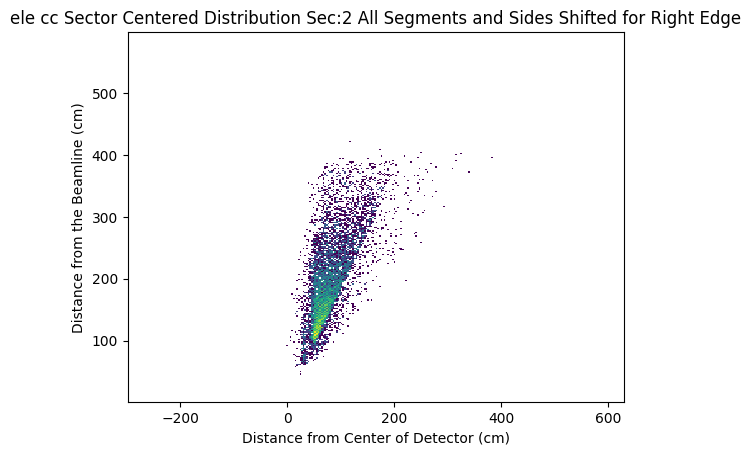

b'ele_cc_Geometric_Fid_Sec:sec3_Cut:pid_cut_Seg:All_Side:right'


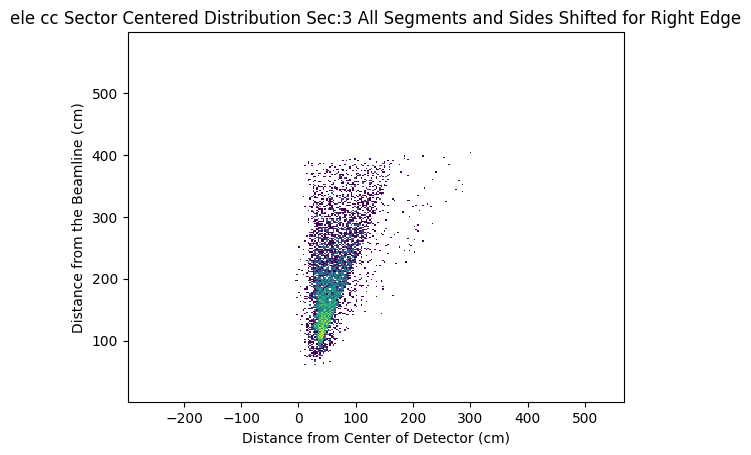

b'ele_cc_Geometric_Fid_Sec:sec4_Cut:pid_cut_Seg:All_Side:right'


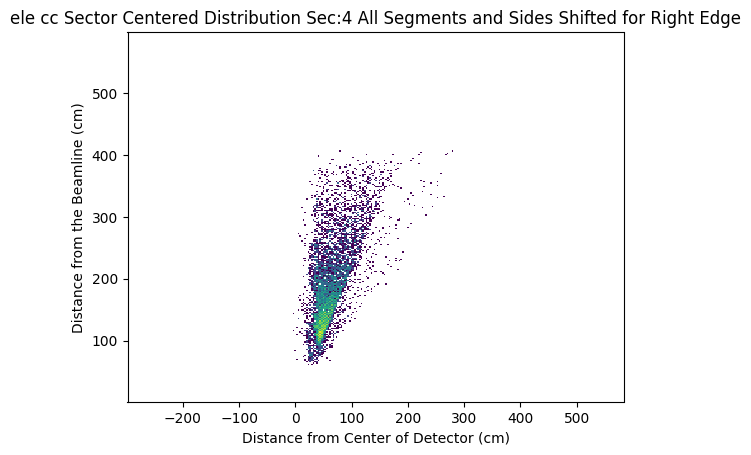

b'ele_cc_Geometric_Fid_Sec:sec5_Cut:pid_cut_Seg:All_Side:right'


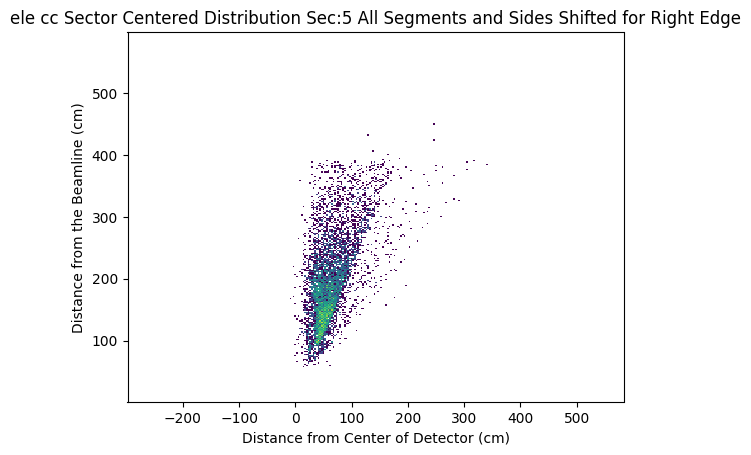

b'ele_cc_Geometric_Fid_Sec:sec6_Cut:pid_cut_Seg:All_Side:right'


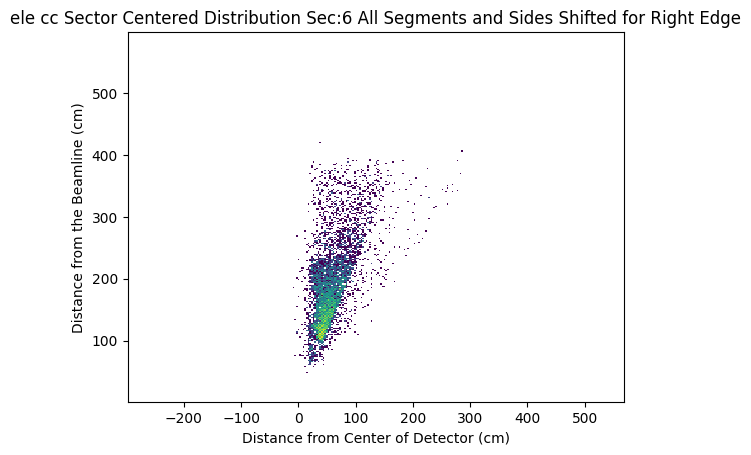

In [18]:
side = 2
for sec in range(6):
    plt.hist2d(dumb1_x_sl[sec][cc_hist_idx(side,num_cc_seg)], dumb1_y_sl[sec][cc_hist_idx(side,num_cc_seg)], bins=(xdim, ydim), weights=dense1_sl[sec][cc_hist_idx(side,num_cc_seg)],norm = mpl.colors.LogNorm())
    print(hist[sec][cc_hist_idx(side,num_cc_seg)].title)
    plt.title(species+" "+detector+" Sector Centered Distribution Sec:{} All Segments and Sides Shifted for Right Edge".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

[-3.78919971e+00 -2.92000344e+01  2.75957147e+01  3.73033740e+04]


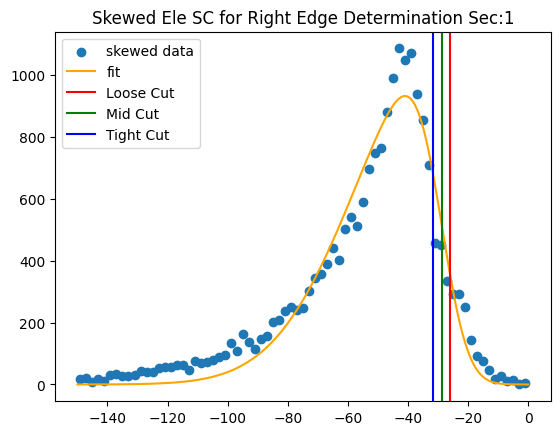

[-3.07151391e+00 -2.42705072e+01  2.98269044e+01  3.04046294e+04]


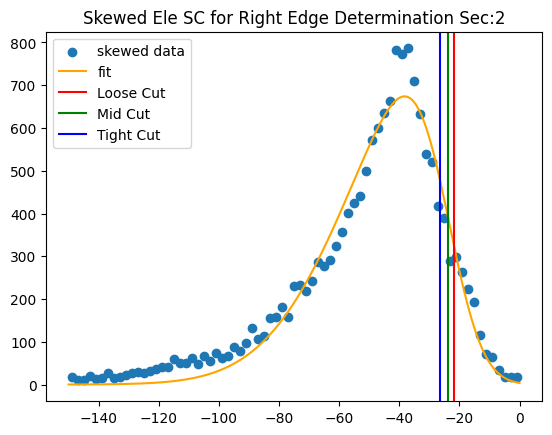

[-5.40609148e+00 -3.93686252e+01  3.16897300e+01  3.47669031e+04]


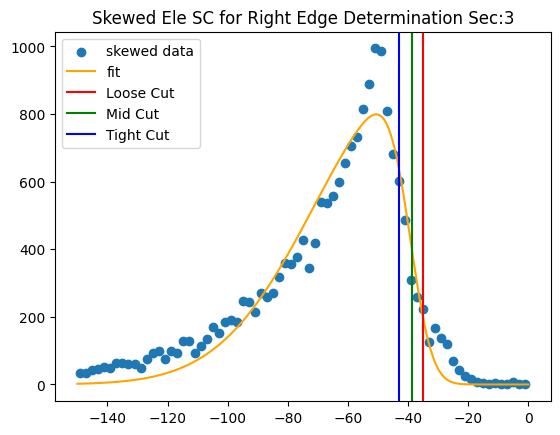

[-3.36933738e+00 -3.44533413e+01  3.02944817e+01  3.44983458e+04]


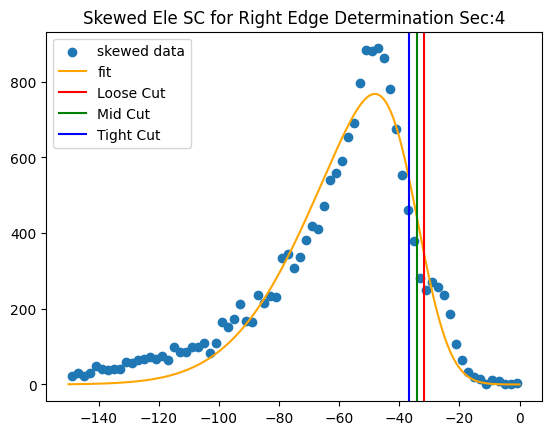

[-4.28193761e+00 -3.36617046e+01  3.35878818e+01  2.88422318e+04]


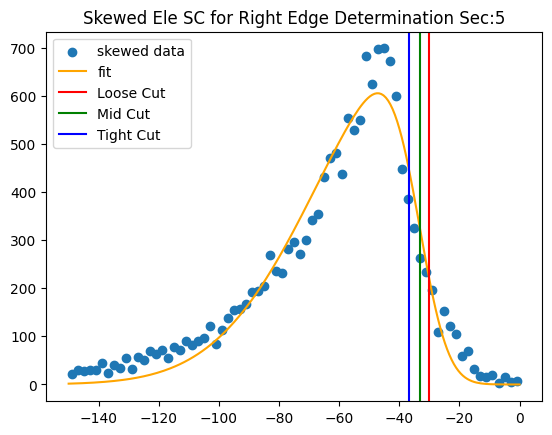

[-4.20693709e+00 -3.17276277e+01  2.87636872e+01  2.91947796e+04]


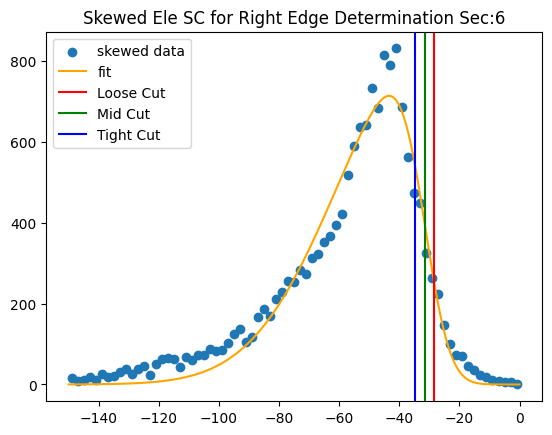

[-5.19353871e+00 -4.64355595e+01  3.74233218e+01  1.93006301e+05]


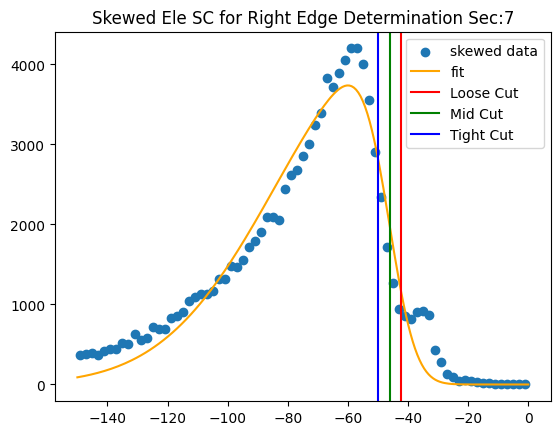

In [66]:
right_edge = [[-50.,-50,-50.] for i in range(7)]

ini_par = [-3.789, -29.20,  27.5,  37303.]

#Bounds_on_Y(yarray_,low_,high_) removes all values not between or equal to bounds
#Bounds_on_X_From_Y(xarray_,yarray_,low_,high_) 

#skew_norm(x_,skew_,loc_,scale_,norm_)
bou = [-150.0,0.0]
side = 0
for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,bou[0],bou[1])
    mod_zvals = Bounds_on_X_From_Y(proj_xr[sec][cc_hist_idx(side,num_cc_seg)],xvals,bou[0],bou[1])
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(bou[0],bou[1],200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        right_edge[sec][2] = pars[1]+edge_shifts[0]*pars[0]
        right_edge[sec][1] = pars[1]+edge_shifts[1]*pars[0]
        right_edge[sec][0] = pars[1]+edge_shifts[2]*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    plt.axvline(x=right_edge[sec][2],label="Loose Cut",color='r')
    plt.axvline(x=right_edge[sec][1],label="Mid Cut",color='g')
    plt.axvline(x=right_edge[sec][0],label="Tight Cut",color='b')
    plt.title("Skewed Ele SC for Right Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

[ 7.27008138e+00 -4.41148446e-01  2.66385011e+01  3.52649274e+04]


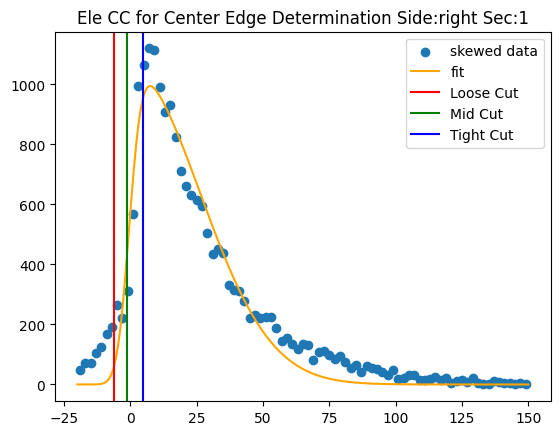

[1.32393849e+01 1.15860519e+00 3.01087650e+01 2.84881180e+04]


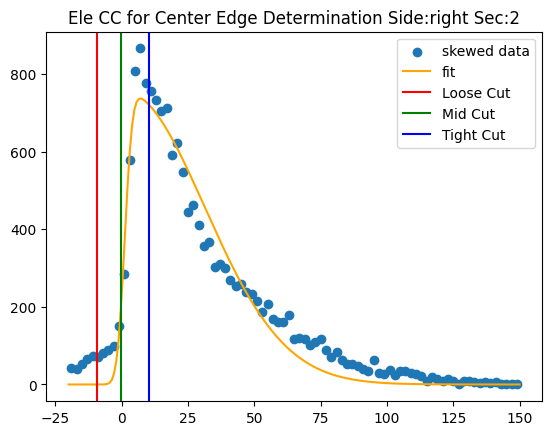

[ 9.22910199e+00 -1.76234561e+00  2.97222763e+01  3.39038815e+04]


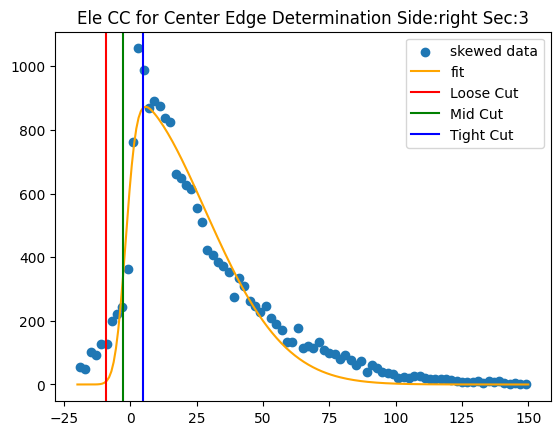

[ 8.41060238e+00 -4.34724663e-01  2.57828606e+01  3.21811452e+04]


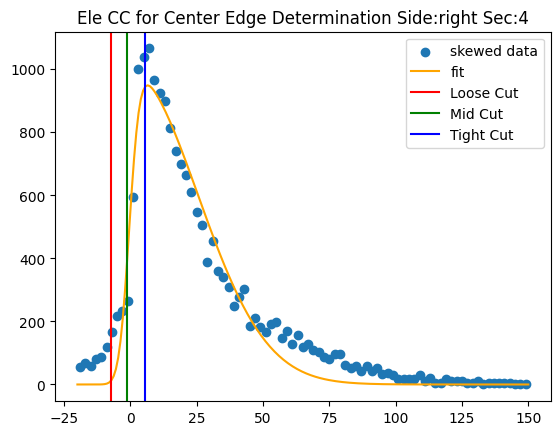

[1.35013035e+01 7.78475601e-01 3.33625816e+01 2.77016027e+04]


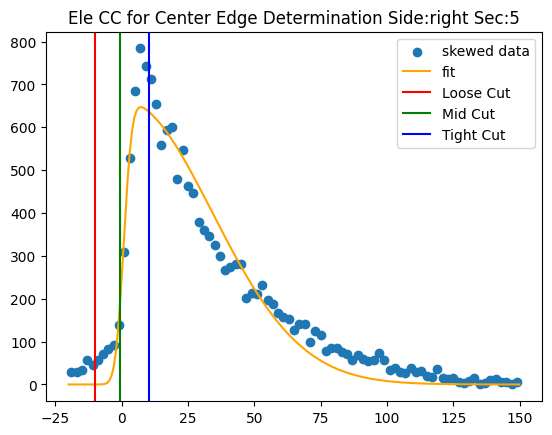

[1.92507811e+01 1.00673582e+00 3.10949838e+01 2.85322560e+04]


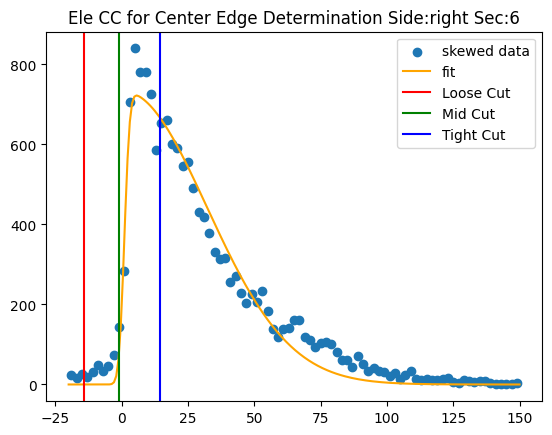

[ 1.09664646e+01 -2.73208147e-02  2.91876074e+01  1.85167224e+05]


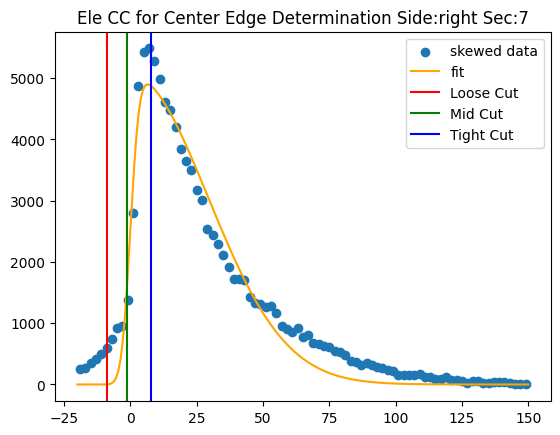

In [67]:
right_cen_edge = [[50.,50,50.] for i in range(7)]

ini_par = [3.789, 29.20,  27.5,  37303.]

#Bounds_on_Y(yarray_,low_,high_) removes all values not between or equal to bounds
#Bounds_on_X_From_Y(xarray_,yarray_,low_,high_) 

#skew_norm(x_,skew_,loc_,scale_,norm_)
bou = [-20,150.0]
side = 0
for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,bou[0],bou[1])
    mod_zvals = Bounds_on_X_From_Y(proj_x[sec][cc_hist_idx(side,num_cc_seg)],xvals,bou[0],bou[1])
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(bou[0],bou[1],200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        right_cen_edge[sec][2] = pars[1]+edge_shifts[0]*pars[0]
        right_cen_edge[sec][1] = pars[1]+edge_shifts[1]*pars[0]
        right_cen_edge[sec][0] = pars[1]+edge_shifts[2]*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    plt.axvline(x=right_cen_edge[sec][2],label="Loose Cut",color='r')
    plt.axvline(x=right_cen_edge[sec][1],label="Mid Cut",color='g')
    plt.axvline(x=right_cen_edge[sec][0],label="Tight Cut",color='b')
    plt.title("Ele CC for Center Edge Determination Side:{} Sec:{}".format(sides[side],sec+1))
    plt.legend()
    plt.show()

[4.07431600e+00 3.06034064e+01 2.78961837e+01 3.19215103e+04]


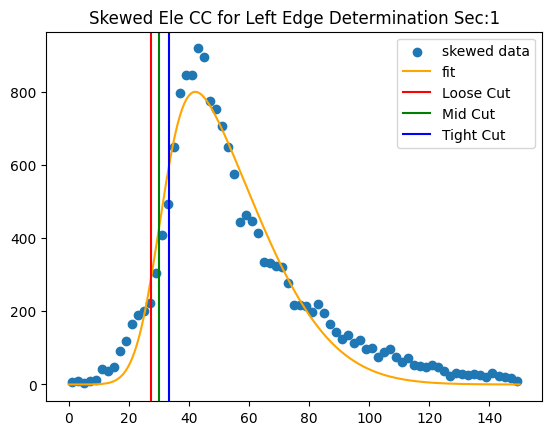

[9.33989581e+00 4.68054419e+01 3.40465838e+01 3.28785953e+04]


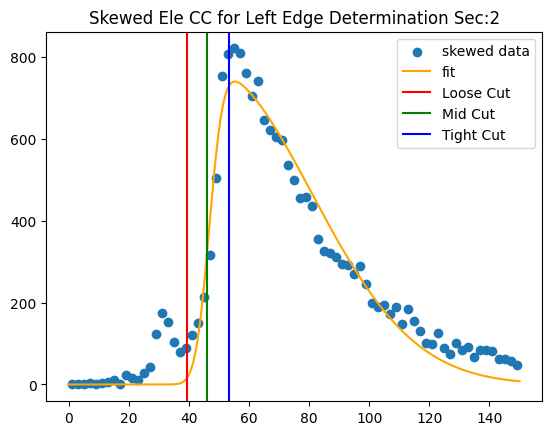

[5.32378890e+00 3.02210964e+01 2.72502748e+01 2.99731184e+04]


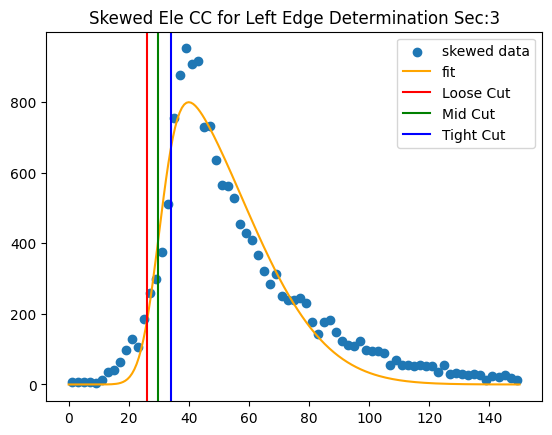

[5.89636970e+00 3.41919538e+01 2.91712611e+01 3.05627981e+04]


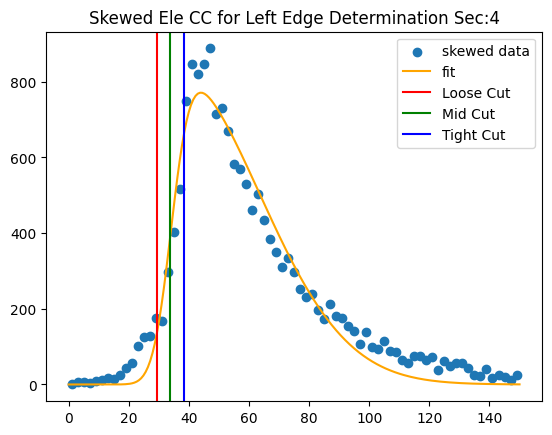

[4.04953168e+00 3.22283006e+01 3.21803127e+01 2.95130917e+04]


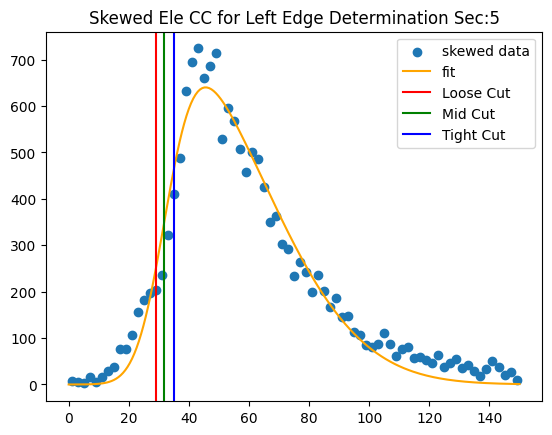

[3.89503111e+00 2.95430237e+01 2.80183608e+01 3.06479284e+04]


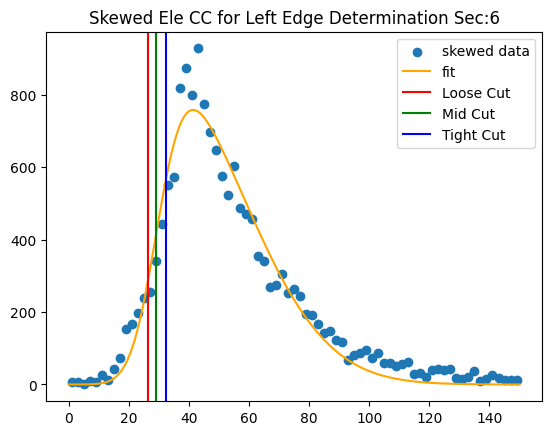

[3.78900001e+00 2.92000000e+01 2.75000000e+01 4.03009061e-14]


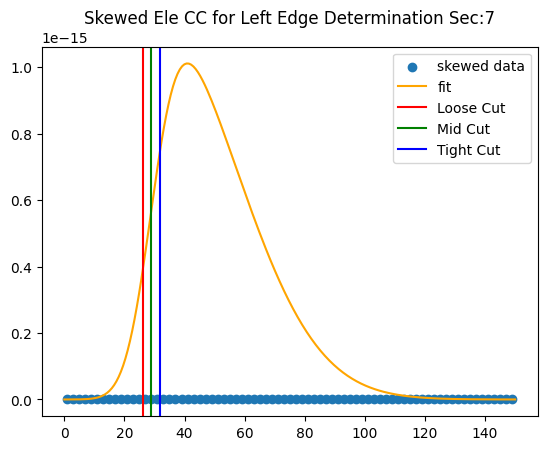

In [68]:
left_edge = [[50.,50,50.] for i in range(7)]

ini_par = [3.789, 29.20,  27.5,  37303.]

#Bounds_on_Y(yarray_,low_,high_) removes all values not between or equal to bounds
#Bounds_on_X_From_Y(xarray_,yarray_,low_,high_) 

#skew_norm(x_,skew_,loc_,scale_,norm_)
bou = [0.0,150.0]
side = 2
for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,bou[0],bou[1])
    mod_zvals = Bounds_on_X_From_Y(proj_xl[sec][cc_hist_idx(side,num_cc_seg)],xvals,bou[0],bou[1])
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(bou[0],bou[1],200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        left_edge[sec][2] = pars[1]+edge_shifts[0]*pars[0]
        left_edge[sec][1] = pars[1]+edge_shifts[1]*pars[0]
        left_edge[sec][0] = pars[1]+edge_shifts[2]*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    plt.axvline(x=left_edge[sec][2],label="Loose Cut",color='r')
    plt.axvline(x=left_edge[sec][1],label="Mid Cut",color='g')
    plt.axvline(x=left_edge[sec][0],label="Tight Cut",color='b')
    plt.title("Skewed Ele CC for Left Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

[-1.35683467e+01 -1.14280865e+00  2.65951728e+01  3.08190476e+04]


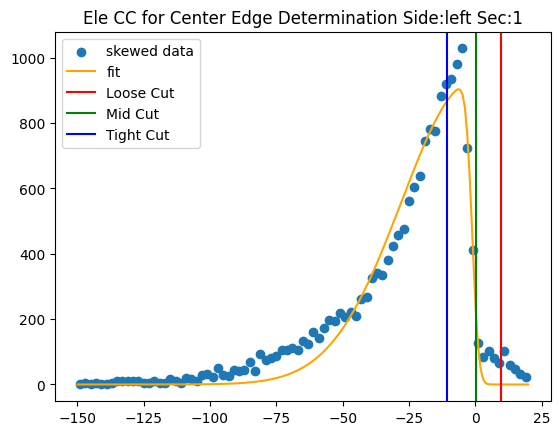

[-1.46626995e+01 -5.24344887e-01  2.90660102e+01  3.24991340e+04]


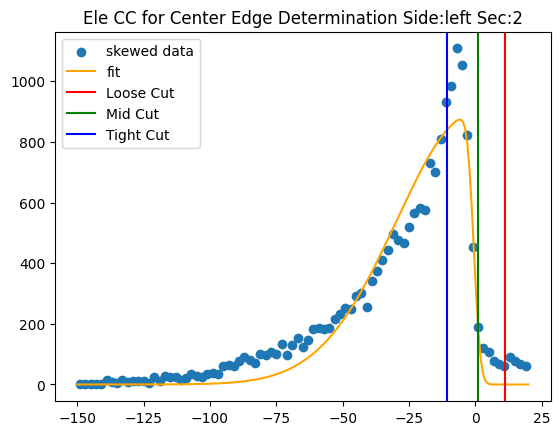

[-1.52537671e+01 -3.02405308e+00  2.82293799e+01  2.95232092e+04]


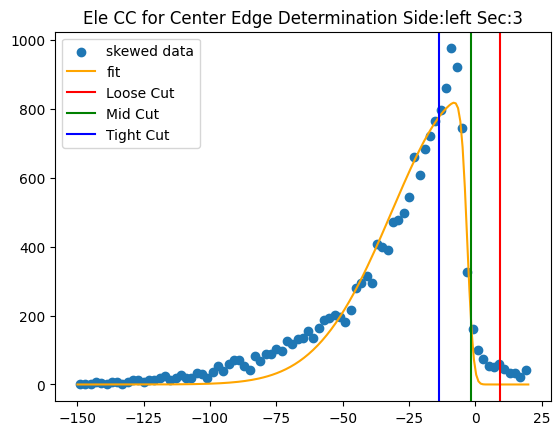

[-1.56484082e+01 -9.81396936e-01  2.70537290e+01  2.96166829e+04]


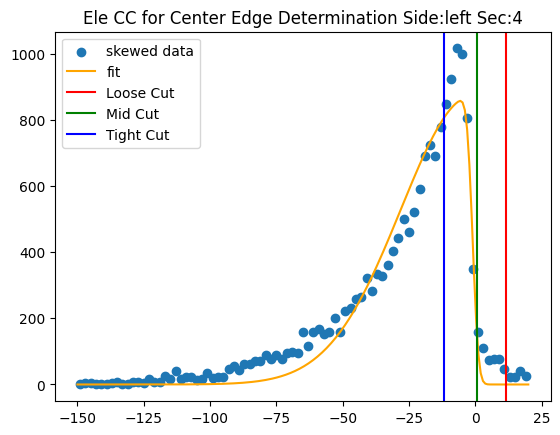

[-1.09485071e+01 -1.15799581e+00  3.34532484e+01  2.87508181e+04]


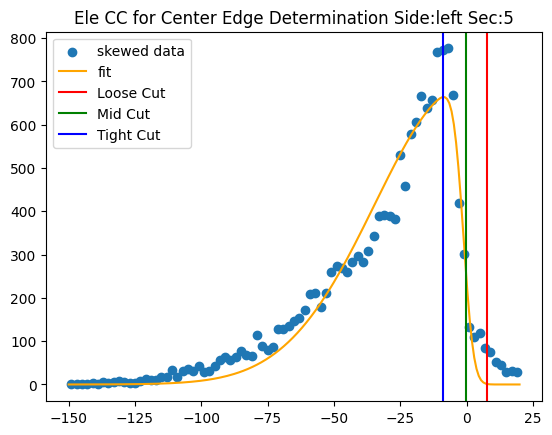

[-1.19028249e+01 -1.90098021e+00  2.63355672e+01  2.97137064e+04]


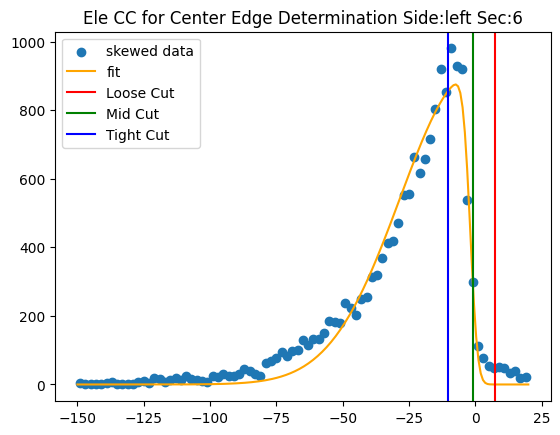

[-1.29446177e+01 -1.33720086e+00  2.84549866e+01  1.81049644e+05]


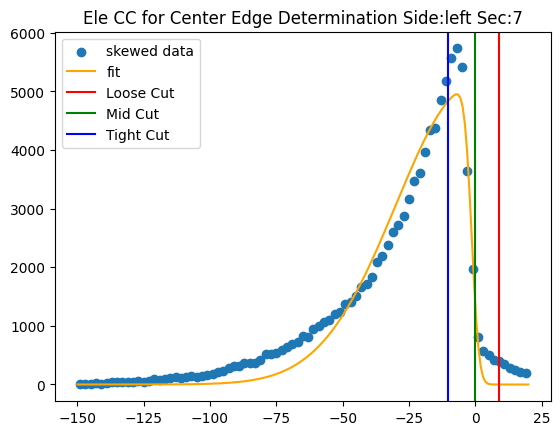

In [69]:
left_cen_edge = [[50.,50,50.] for i in range(7)]

ini_par = [3.789, 29.20,  27.5,  37303.]

#Bounds_on_Y(yarray_,low_,high_) removes all values not between or equal to bounds
#Bounds_on_X_From_Y(xarray_,yarray_,low_,high_) 

#skew_norm(x_,skew_,loc_,scale_,norm_)
bou = [-150,20.0]
side = 2
for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,bou[0],bou[1])
    mod_zvals = Bounds_on_X_From_Y(proj_x[sec][cc_hist_idx(side,num_cc_seg)],xvals,bou[0],bou[1])
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(bou[0],bou[1],200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        left_cen_edge[sec][2] = pars[1]+edge_shifts[0]*pars[0]
        left_cen_edge[sec][1] = pars[1]+edge_shifts[1]*pars[0]
        left_cen_edge[sec][0] = pars[1]+edge_shifts[2]*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    plt.axvline(x=left_cen_edge[sec][2],label="Loose Cut",color='r')
    plt.axvline(x=left_cen_edge[sec][1],label="Mid Cut",color='g')
    plt.axvline(x=left_cen_edge[sec][0],label="Tight Cut",color='b')
    plt.title("Ele CC for Center Edge Determination Side:{} Sec:{}".format(sides[side],sec+1))
    plt.legend()
    plt.show()

In [70]:
def exp_off(x_, a_, mu_,d_):
    return a_*np.exp(-(x_-mu_)/d_)

def exp_off_edge(comp_,frac_, a_, mu_, d_):
    return -d_*(math.log(frac_)-((comp_-mu_)/d_)-(mu_/d_))

[6801.0846083    19.85958898   14.56863348]


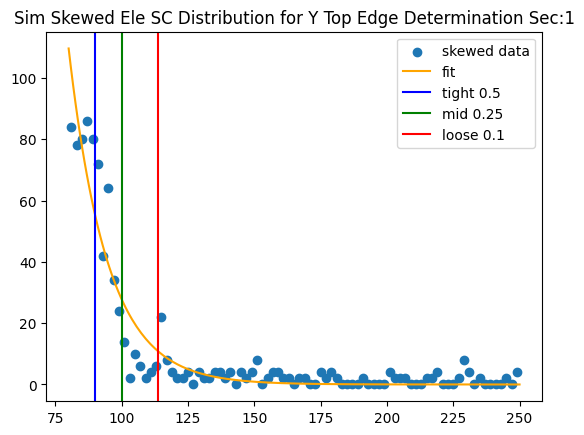

[ 1.36040729e+06 -5.00627799e+03  1.61467383e+01]


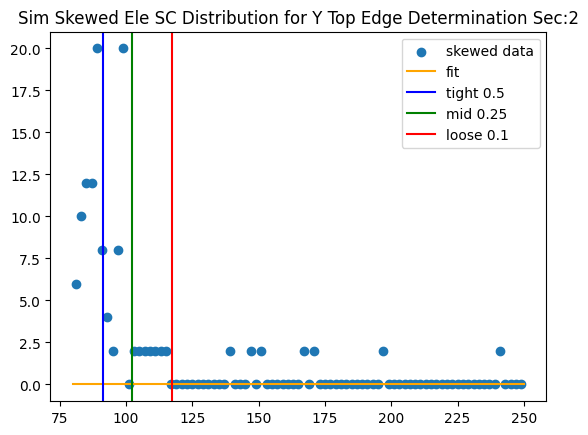

[6221.1709877    23.64105878   14.95733895]


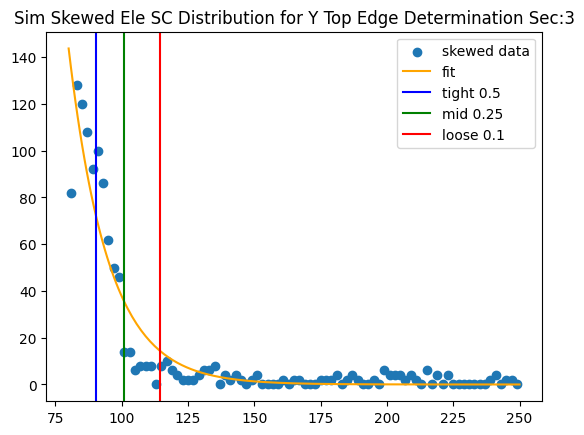

[4319.2515063    21.98556386   15.32542775]


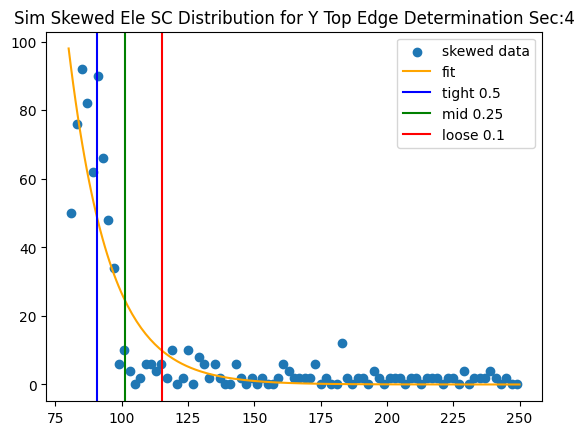

[178.41928115  14.86850034  35.53655403]


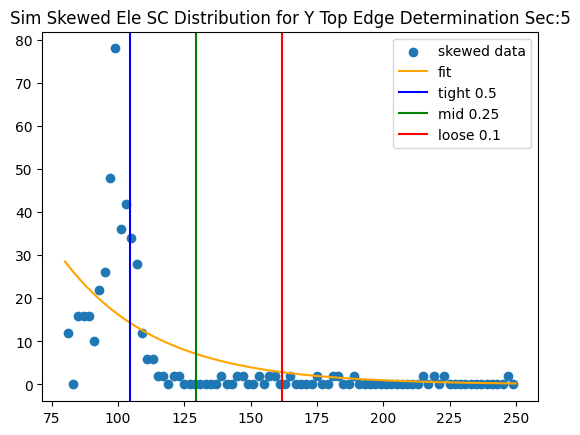

[128.5448383    2.09387216  29.79454679]


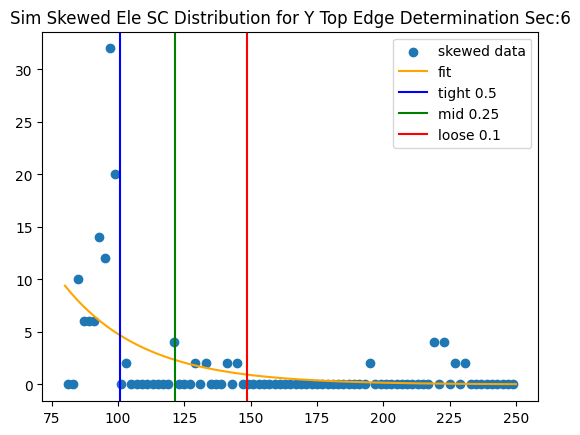

[ 4.94802670e+04 -6.44574975e+00  1.77728845e+01]


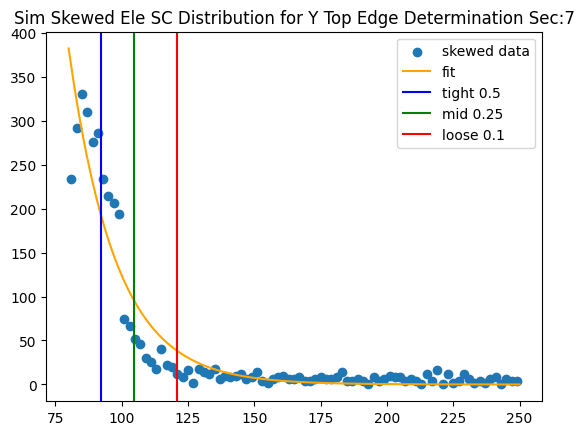

In [71]:
y_edge = np.zeros((7,3))

ini_par = [4145.27,   22.61,     15.32]

bou_y = [80.0,250.0]

comp_x = 80.0

frac_y = [0.5,0.25,0.1]

for sec in range(7):
    mod_xvals = Bounds_on_Y(yvals,bou_y[0],bou_y[1])
    mod_zvals = Bounds_on_X_From_Y(proj_y[sec][0],yvals,bou_y[0],bou_y[1])
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(bou_y[0],bou_y[1],200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(exp_off,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,exp_off(cont_x,*pars),label="fit",color='orange')
        print(pars)
        for cut in range(3):
            y_edge[sec][cut] = exp_off_edge(comp_x,frac_y[cut],*pars)
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    for cut in range(3):
        plt.axvline(x=y_edge[sec][cut],label="{} {}".format(cut_name[cut],frac_y[cut]),color=color_order[cut])
    plt.title("Sim Skewed Ele SC Distribution for Y Top Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

[[[70.98551398279388, 2.2285714285714286], [64.2299122064902, 2.2285714285714286], [58.318760652224476, 2.2285714285714286]], [[64.40013195960987, 2.4375], [58.41067983869384, 2.4375], [53.16990923289231, 2.4375]], [[84.1481339498871, 1.95], [75.71463124171648, 1.95], [68.33531637206721, 1.95]], [[75.56122224343876, 2.0526315789473686], [70.02841560119867, 2.0526315789473686], [65.18720978923861, 2.0526315789473686]], [[77.28126354852525, 2.108108108108108], [70.05983362727372, 2.108108108108108], [63.74108244617862, 2.108108108108108]], [[77.2701065090789, 2.2285714285714286], [69.76973867527639, 2.2285714285714286], [63.206916820699185, 2.2285714285714286]], [[86.7255792906302, 1.7320508075688772], [79.52920095691128, 1.7320508075688772], [73.23236991490725, 1.7320508075688772]]]
[[70.98551398279388, 2.2285714285714286], [64.2299122064902, 2.2285714285714286], [58.318760652224476, 2.2285714285714286]]


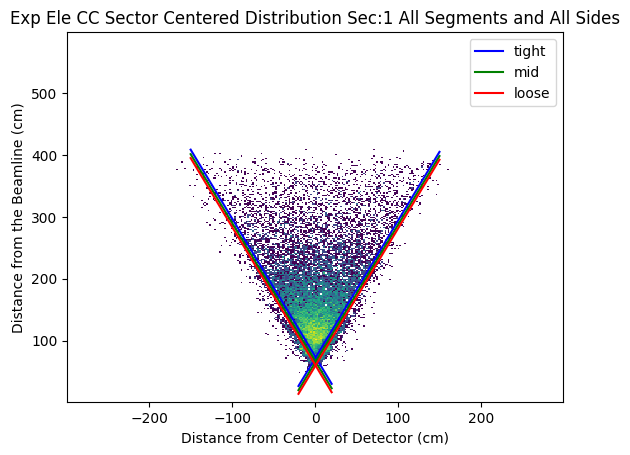

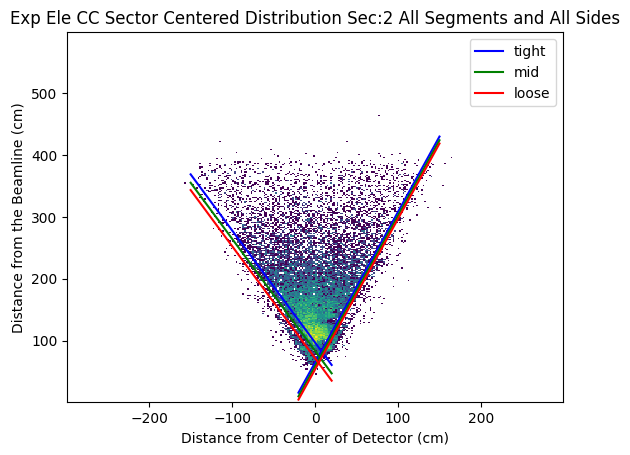

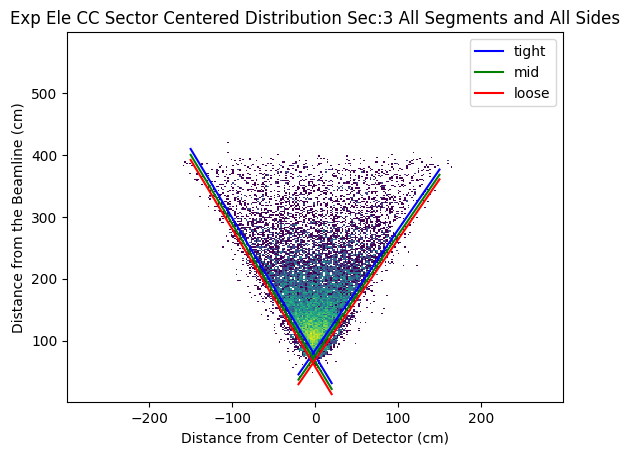

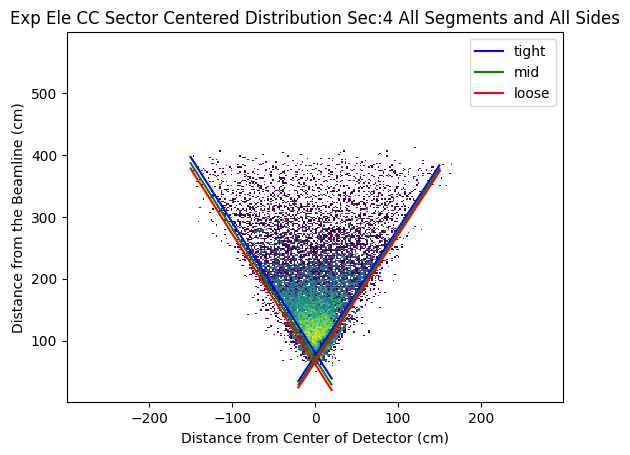

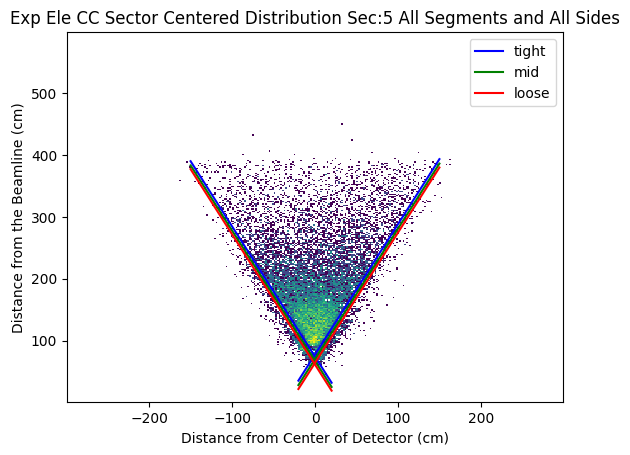

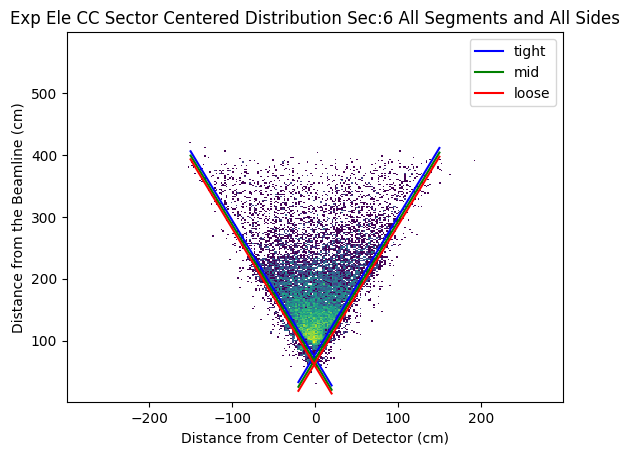

In [72]:
right_cut_pars = [[[-right_edge[sec][cut_idx]*right_rot[sec],right_rot[sec]] for cut_idx in range(3)] for sec in range(7)]
left_cut_pars = [[[left_edge[sec][cut_idx]*(-left_rot[sec]),left_rot[sec]] for cut_idx in range(3)] for sec in range(7)]

#side_cut_pars = [[[-right_edge[sec][cut_idx1]*3**(1/2),3**(1/2)] for cut_idx1 in range(3)],[[left_edge[sec][cut_idx2]*3**(1/2),-(3**(1/2))] for cut_idx2 in range(3)] for sec in range(7)]

print(right_cut_pars)
print(right_cut_pars[0])

cont_x_r = np.linspace(-20.0,150.,200)
cont_x_l = np.linspace(-150.0,20.,200)


for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    for cut in range(3):
        plt.plot(cont_x_r,Poly(cont_x_r,right_cut_pars[sec][cut]),label=cut_name[cut],color=color_order[cut])
        plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),color=color_order[cut])
    plt.title("Exp Ele CC Sector Centered Distribution Sec:{} All Segments and All Sides".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.legend()
    plt.show()

In [73]:
def super_gaus_cut_bound(frac_,side_,a_,m_,s_,p_):
    if side_ == 0:
        return 0.5*(2*m_ - 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    elif side_ ==1:
        return 0.5*(2*m_ + 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    else:
        return -99.9
    

def Sup_Gaus_Cutoff(x_,frac_,a_,m_,s_,p_):
    if x < super_gaus_cut_bound(frac_,0,a_,m_,s_,p_):
        return 0.
    elif x > super_gaus_cut_bound(frac_,1,a_,m_,s_,p_):
        return 0.
    else:
        return Super_Gaus(x_,a_,m_,s_,p_)
    
def Sup_Gaus_Cutoff_Array(x_,frac_,a_,m_,s_,p_):
    output = np.zeros(len(x_))
    for i in range(len(x_)):
        output[i] = Sup_Gaus_Cutoff(x_[i],frac_,a_,m_,s_,p_)
    return output

Parameters for Sec:1 Side:right Seg:1
test pars [83. 82. 10.  3.]
fit pars [83.82521968 82.42070373 10.89417119  2.87640978]



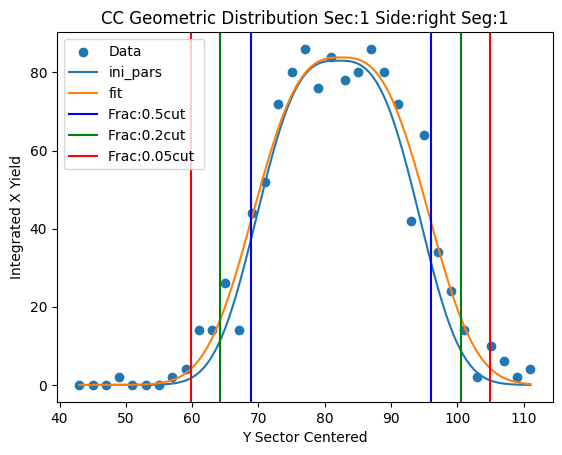

Parameters for Sec:1 Side:right Seg:2
test pars [ 83.82521968 105.          11.89417119   2.87640978]
fit pars [159.59949219 103.68620023   5.07529275   1.05826705]



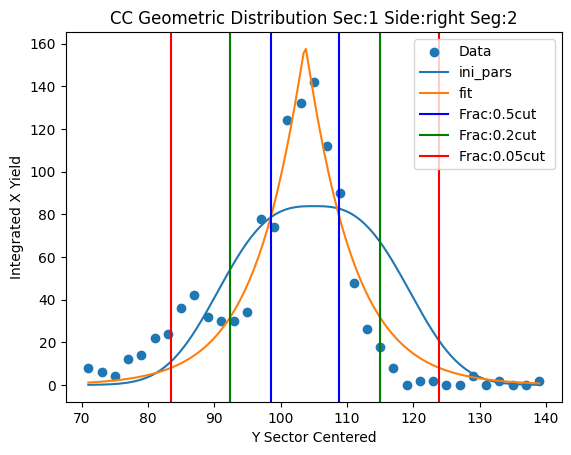

Parameters for Sec:1 Side:right Seg:3
test pars [159.59949219 119.           6.07529275   1.05826705]
fit pars [218.71559553 115.2717674    8.34099481   2.85248599]



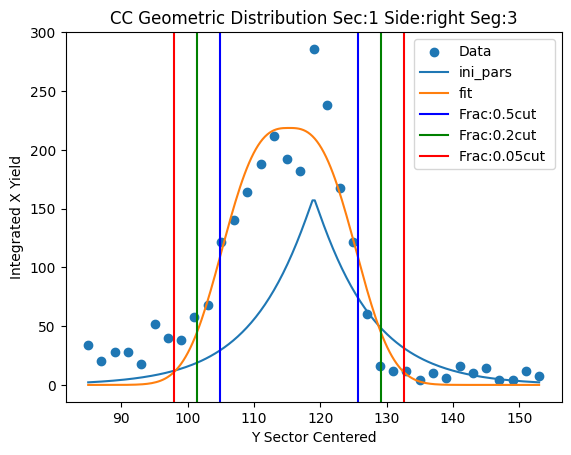

Parameters for Sec:1 Side:right Seg:4
test pars [218.71559553 133.           9.34099481   2.85248599]
fit pars [247.18962093 130.96362998   7.28616106   2.43006617]



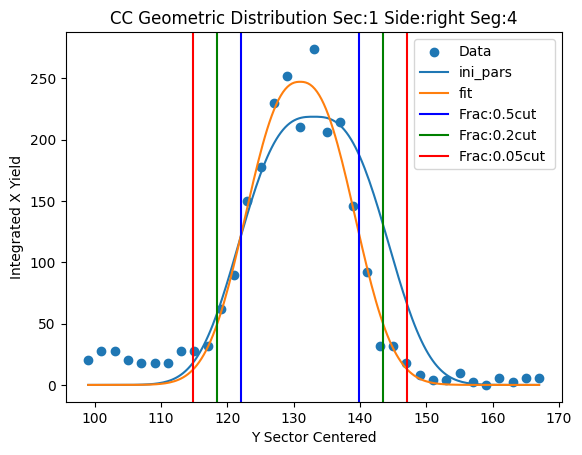

Parameters for Sec:1 Side:right Seg:5
test pars [247.18962093 149.           8.28616106   2.43006617]
fit pars [180.5191532  147.04404778   7.27733382   4.02770749]



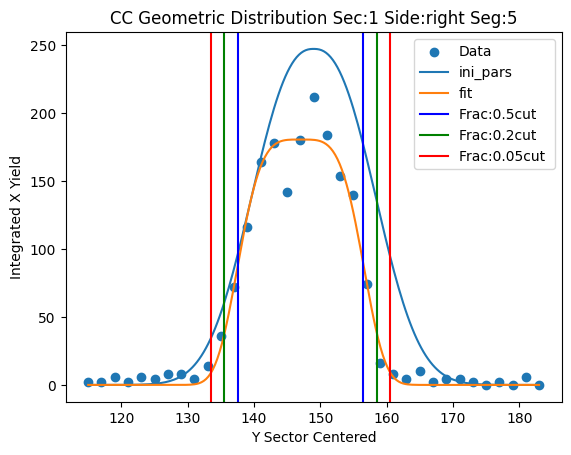

Parameters for Sec:1 Side:right Seg:6
test pars [180.5191532  161.           8.27733382   4.02770749]
fit pars [191.40068484 163.87997273   7.83311704   1.91879586]



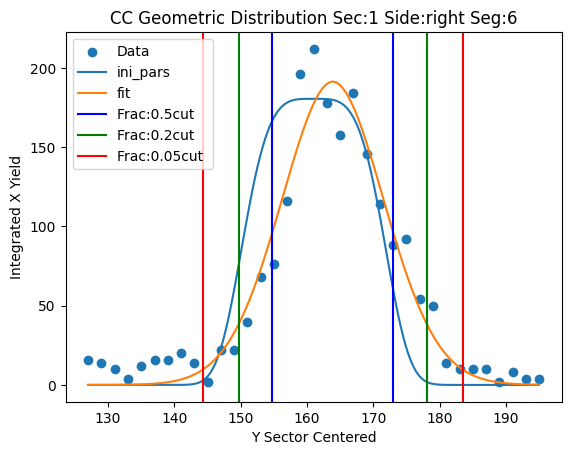

Parameters for Sec:1 Side:right Seg:7
test pars [191.40068484 185.           8.83311704   1.91879586]
fit pars [134.05795784 182.76400251   8.50626298   2.85149985]



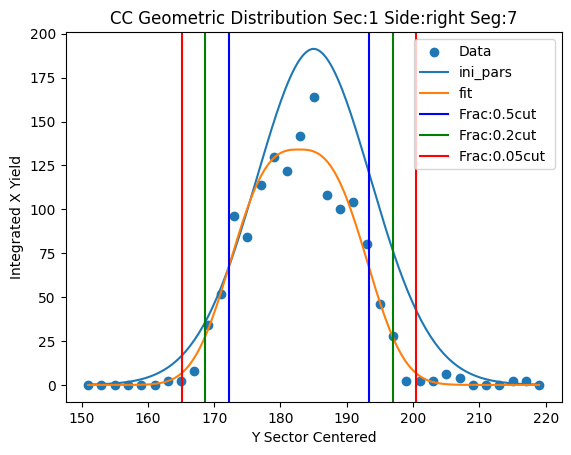

Parameters for Sec:1 Side:right Seg:8
test pars [134.05795784 199.           9.50626298   2.85149985]
fit pars [143.20274423 199.60316037   5.85931948   1.62359272]



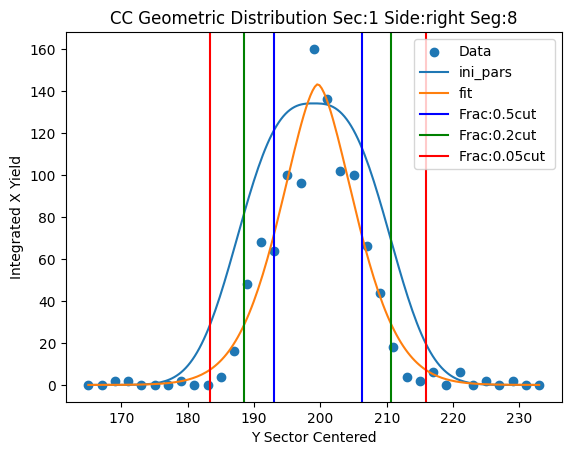

Parameters for Sec:1 Side:right Seg:9
test pars [143.20274423 213.           6.85931948   1.62359272]
fit pars [105.10767981 214.03077223   6.37567864   3.94684613]



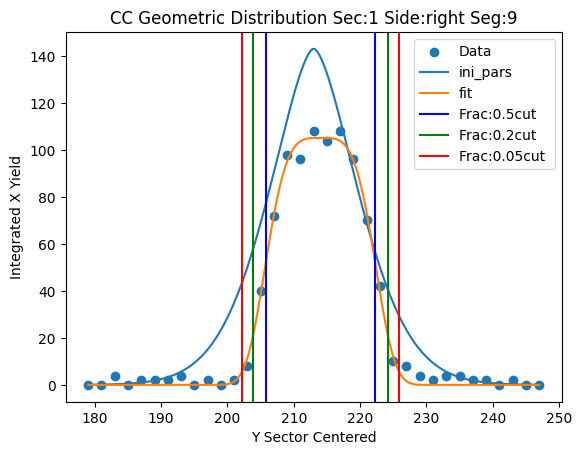

Parameters for Sec:1 Side:right Seg:10
test pars [105.10767981 227.           7.37567864   3.94684613]
fit pars [106.71167172 227.55352287   5.80092185   1.75399395]



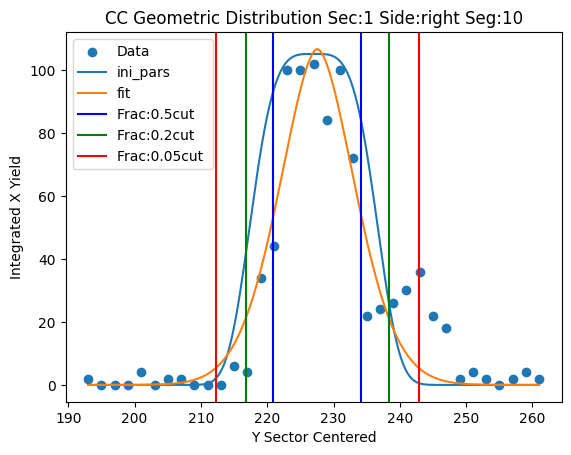

Parameters for Sec:1 Side:right Seg:11
test pars [106.71167172 253.           6.80092185   1.75399395]
fit pars [ 63.93250062 247.08495444   9.94396159  23.64099125]



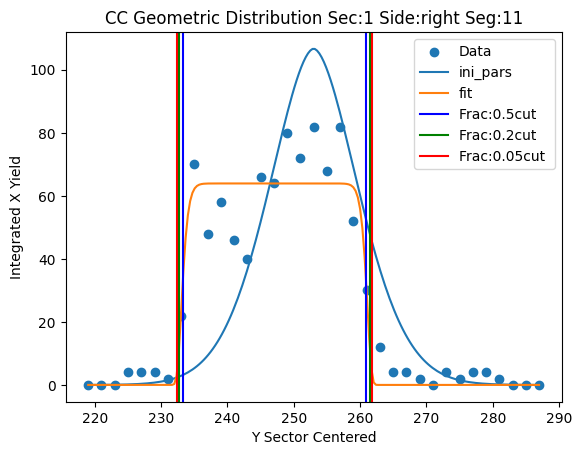

Parameters for Sec:1 Side:right Seg:12
test pars [ 63.93250062 271.          10.94396159  23.64099125]
fit pars [ 37.116032   271.51896149  10.60571919   8.92528565]



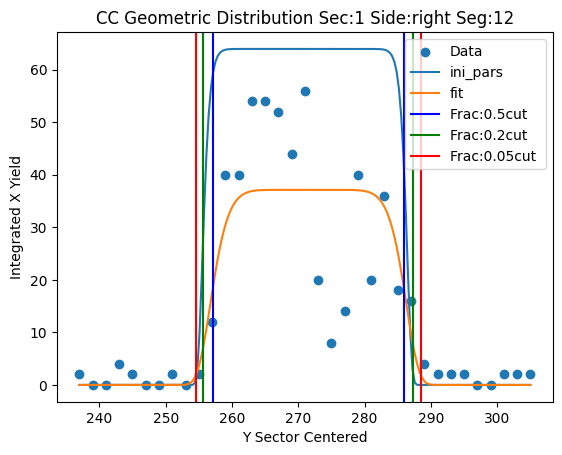

Parameters for Sec:1 Side:right Seg:13
test pars [ 37.116032   295.          11.60571919   8.92528565]
fit pars [ 33.62499999 290.03117314  12.06634349 152.68565088]



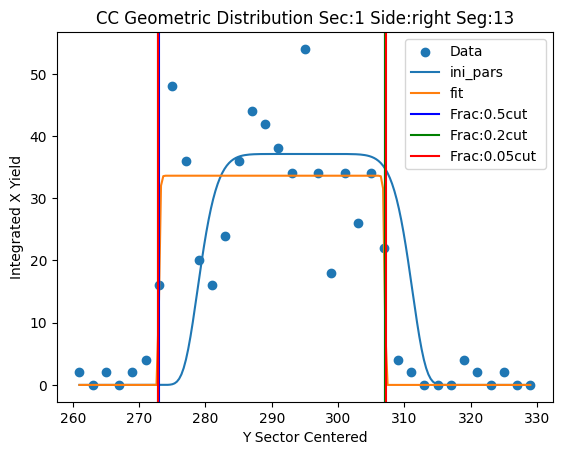

Parameters for Sec:1 Side:right Seg:14
test pars [ 33.62499999 311.          13.06634349 152.68565088]
fit pars [ 36.05034132 316.45485351  11.31693089   2.90358079]



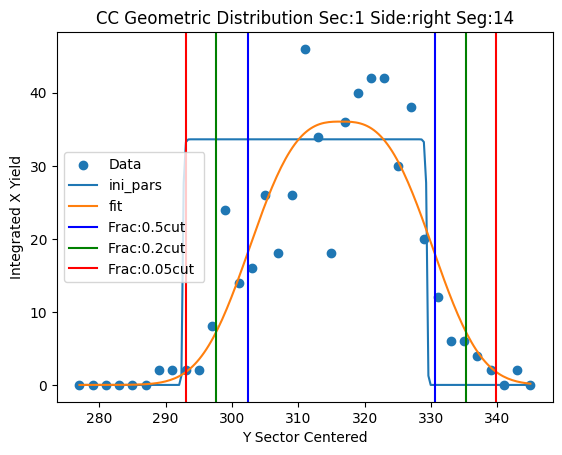

Parameters for Sec:1 Side:right Seg:15
test pars [ 36.05034132 333.          12.31693089   2.90358079]
fit pars [ 26.23540434 339.67676779   9.59973393   3.54639056]



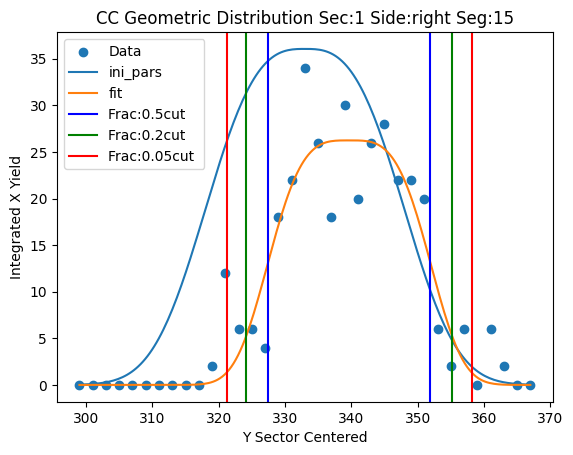

Parameters for Sec:1 Side:right Seg:16
test pars [ 26.23540434 357.          10.59973393   3.54639056]
fit pars [ 19.47112907 361.92124894   9.58158337   3.44302079]



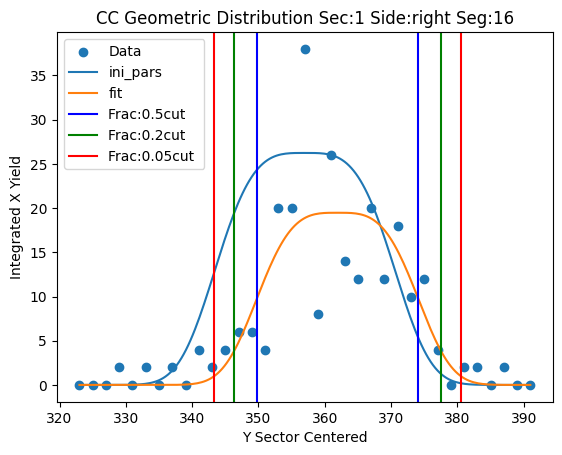

Parameters for Sec:1 Side:right Seg:17
test pars [ 19.47112907 381.          10.58158337   3.44302079]
fit pars [ 15.38150711 378.22815195   7.66449861   1.33254443]



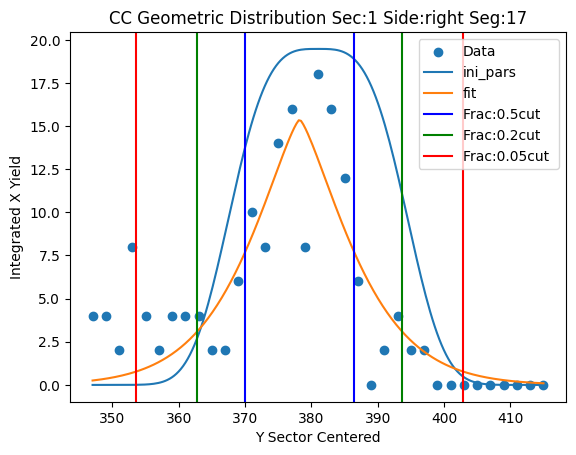

Parameters for Sec:1 Side:right Seg:18
test pars [ 15.38150711 291.           8.66449861   1.33254443]
fit pars [  5.64099867 290.9999998    3.10573259   0.35330813]



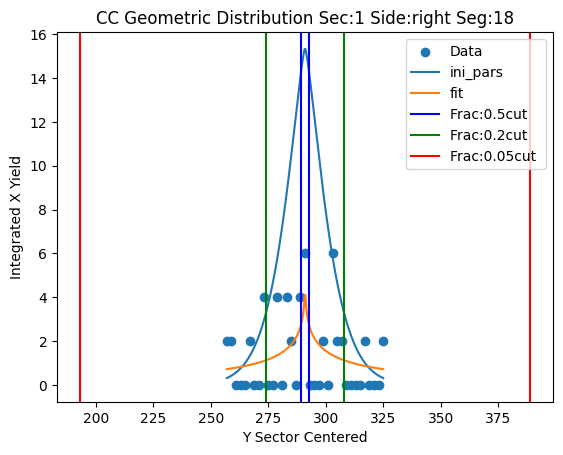

Parameters for Sec:1 Side:coinc Seg:1
test pars [40. 97. 19.  6.]
fit pars [42.6985016  85.37890491 11.93151163  2.69821041]



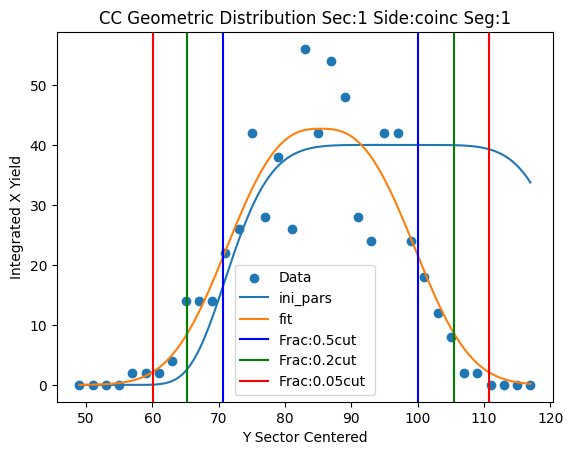

Parameters for Sec:1 Side:coinc Seg:2
test pars [ 42.6985016  107.          12.93151163   2.69821041]
fit pars [64.49269495 97.74775409 12.4651736   6.31523931]



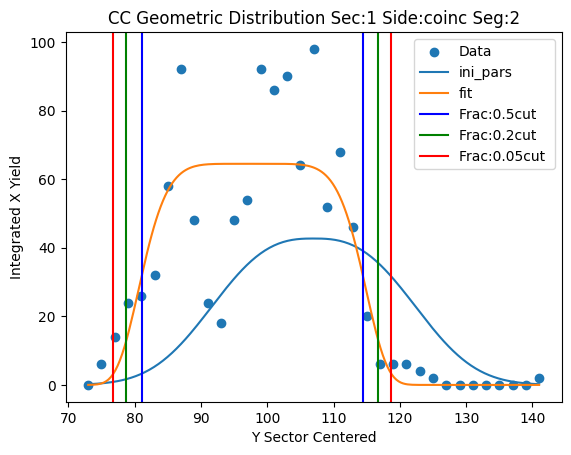

Parameters for Sec:1 Side:coinc Seg:3
test pars [ 64.49269495 119.          13.4651736    6.31523931]
fit pars [104.84616372 119.12499087   4.87874459   1.073665  ]



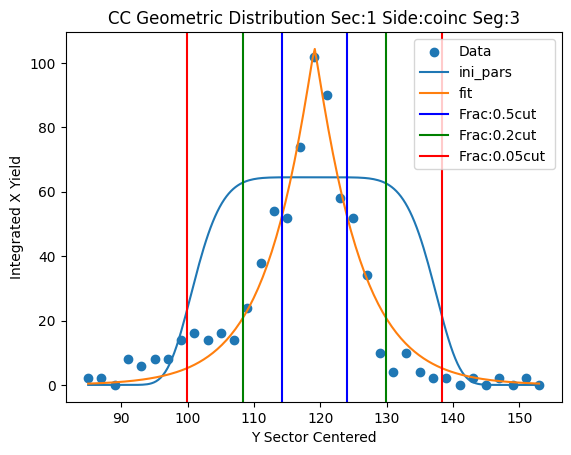

Parameters for Sec:1 Side:coinc Seg:4
test pars [104.84616372 131.           5.87874459   1.073665  ]
fit pars [ 38.09565665 135.11264946   8.80142235   3.05392949]



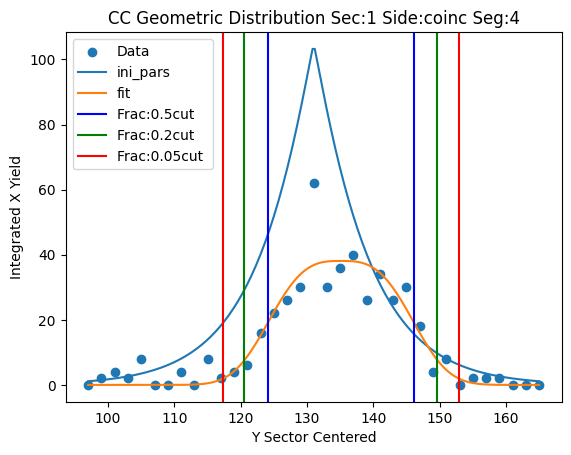

Parameters for Sec:1 Side:coinc Seg:5
test pars [ 38.09565665 147.           9.80142235   3.05392949]
fit pars [ 35.9209089  150.19485331   6.97737078   2.63143816]



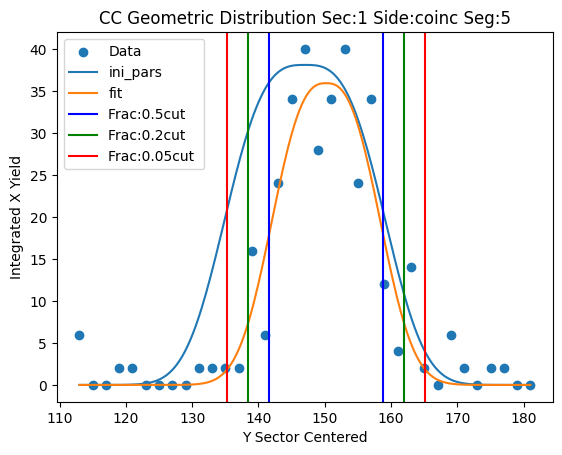

Parameters for Sec:1 Side:coinc Seg:6
test pars [ 35.9209089  173.           7.97737078   2.63143816]
fit pars [ 19.93212849 167.54005071   8.29000926   2.77440958]



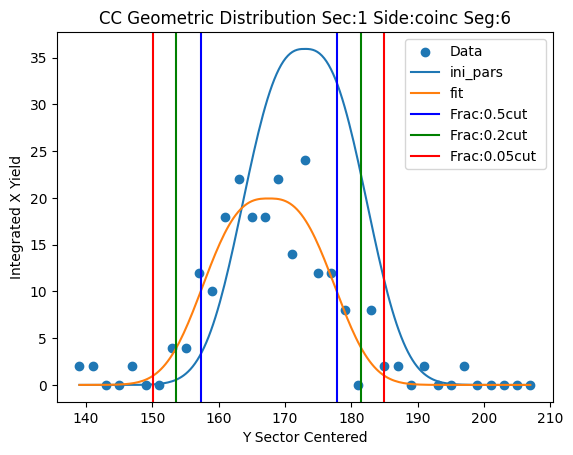

Parameters for Sec:1 Side:coinc Seg:7
test pars [ 19.93212849 183.           9.29000926   2.77440958]
fit pars [ 11.49985465 185.18752078  10.22514609   3.01285078]



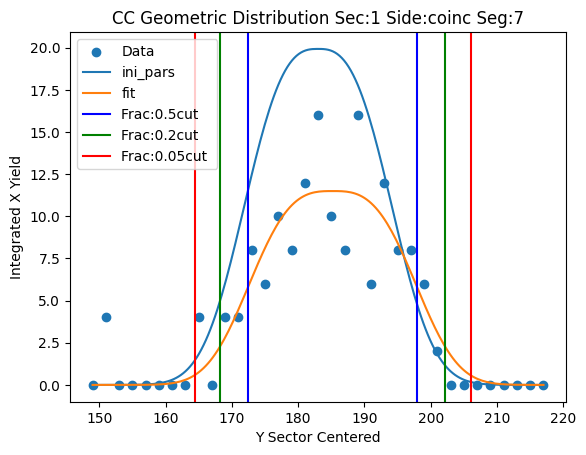

Parameters for Sec:1 Side:coinc Seg:8
test pars [ 11.49985465 201.          11.22514609   3.01285078]
fit pars [ 11.81434856 202.54737882   7.90424784   1.64232817]



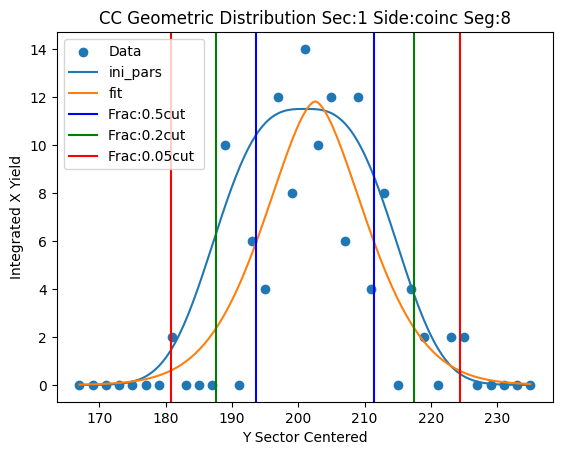

Parameters for Sec:1 Side:coinc Seg:9
test pars [ 11.81434856 217.           8.90424784   1.64232817]
fit pars [ 10.34265764 216.69304601   6.27257091   1.39758322]



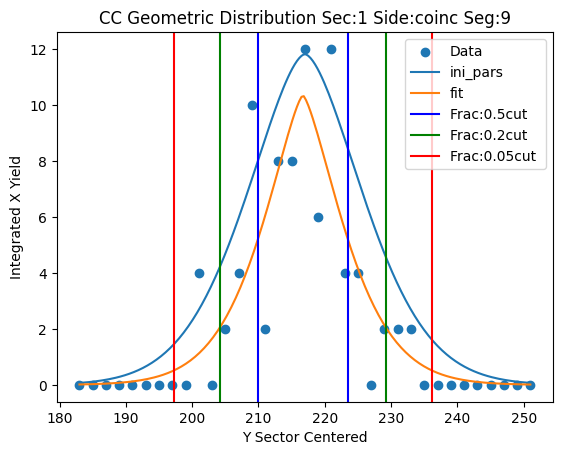

Parameters for Sec:1 Side:coinc Seg:10
test pars [ 10.34265764 227.           7.27257091   1.39758322]
fit pars [  8.80517862 226.99999956   6.52605162   0.78410826]



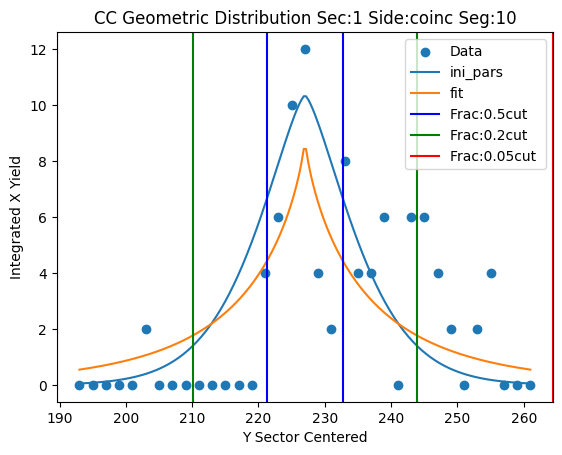

Parameters for Sec:1 Side:coinc Seg:11
test pars [  8.80517862 253.           7.52605162   0.78410826]
fit pars [  9.21285733 253.00000022   5.72204968   0.8315001 ]



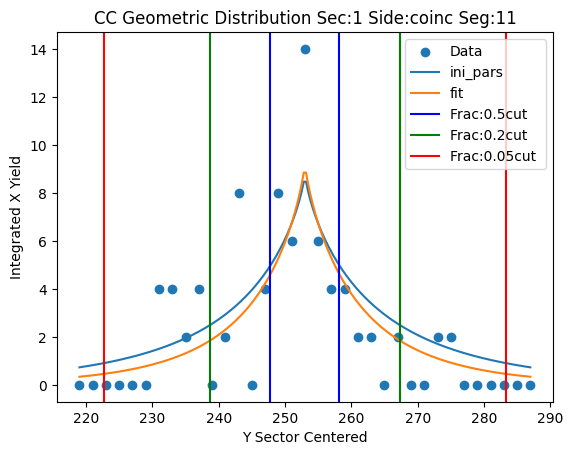

Parameters for Sec:1 Side:coinc Seg:12
test pars [  9.21285733 263.           6.72204968   0.8315001 ]
fit pars [3.83828929e+03 2.63867683e+02 2.45195125e-08 1.05986497e-01]



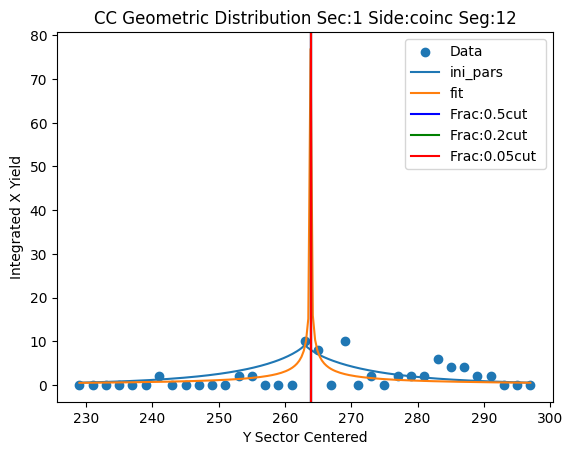

Parameters for Sec:1 Side:coinc Seg:13
test pars [3.83828929e+03 2.91000000e+02 1.00000002e+00 1.05986497e-01]
fit pars [2.20219185e+03 2.91952618e+02 3.65204163e-01 2.75309686e+00]



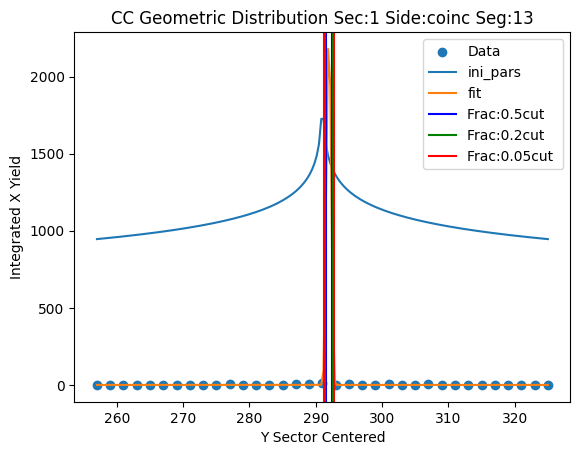

Parameters for Sec:1 Side:coinc Seg:14
test pars [2.20219185e+03 3.15000000e+02 1.36520416e+00 2.75309686e+00]
fit pars [  6.         315.           1.40796913  21.25251364]



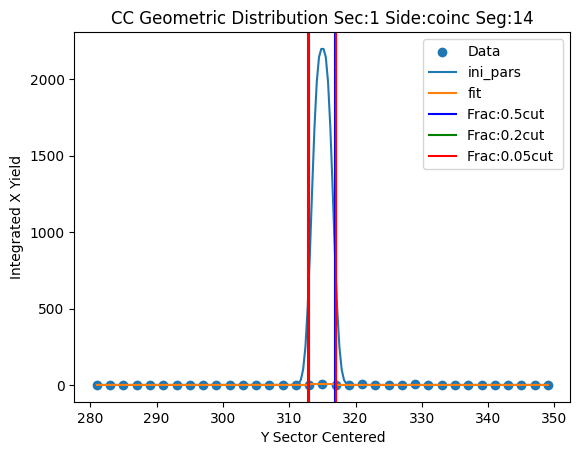

Parameters for Sec:1 Side:coinc Seg:15
test pars [  6.         347.           2.40796913  21.25251364]
fit pars [  6.         347.           1.40040395   9.58414211]



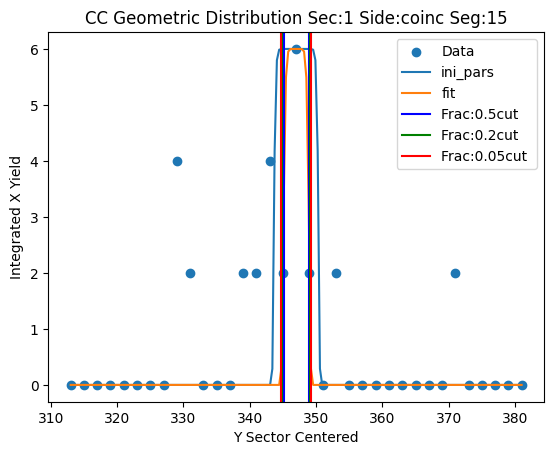

Parameters for Sec:1 Side:coinc Seg:16
test pars [  6.         307.           2.40040395   9.58414211]
fit pars [  2.         306.99999873   1.31608867  36.95385149]



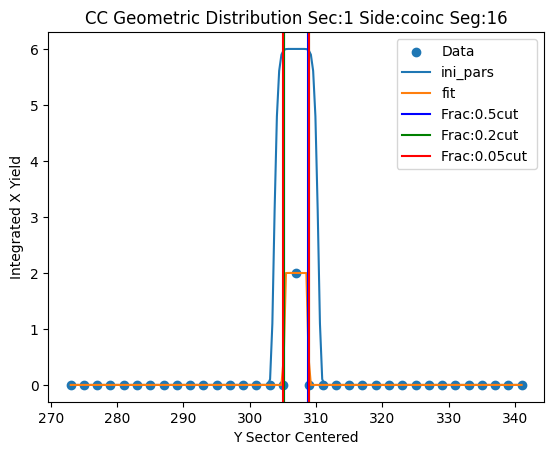

Parameters for Sec:1 Side:left Seg:1
test pars [19. 83. 13.  5.]
fit pars [19.40828369 83.80792256 13.64368243  5.17665853]



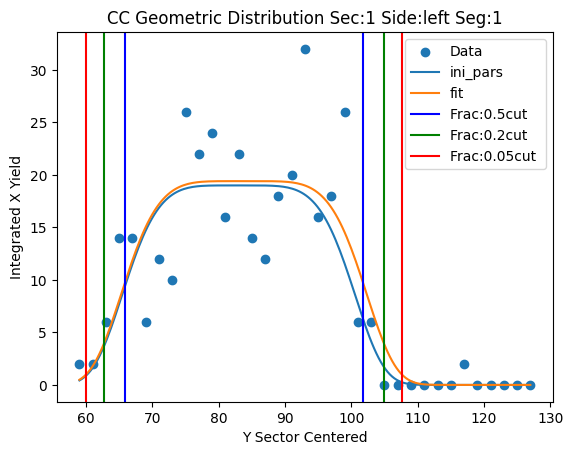

Parameters for Sec:1 Side:left Seg:2
test pars [ 19.40828369 103.          14.64368243   5.17665853]
fit pars [164.53717925 104.40011986   4.58919673   0.84536675]



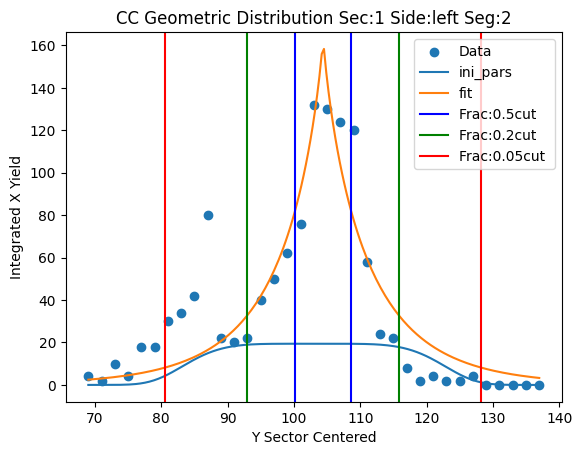

Parameters for Sec:1 Side:left Seg:3
test pars [164.53717925 117.           5.58919673   0.84536675]
fit pars [206.5858917  117.14532189   6.83958916   2.89496244]



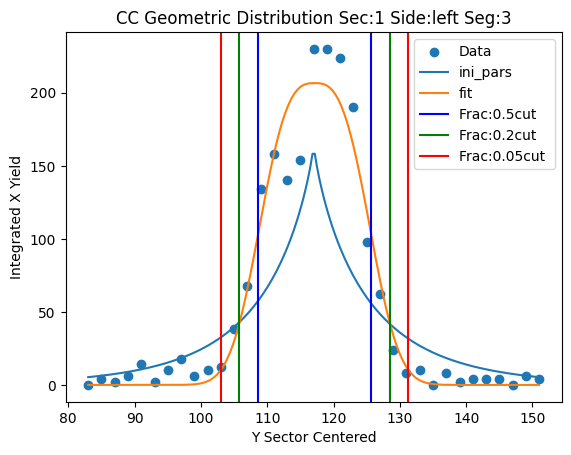

Parameters for Sec:1 Side:left Seg:4
test pars [206.5858917  135.           7.83958916   2.89496244]
fit pars [228.52115187 132.7225454    7.75223399   2.38175471]



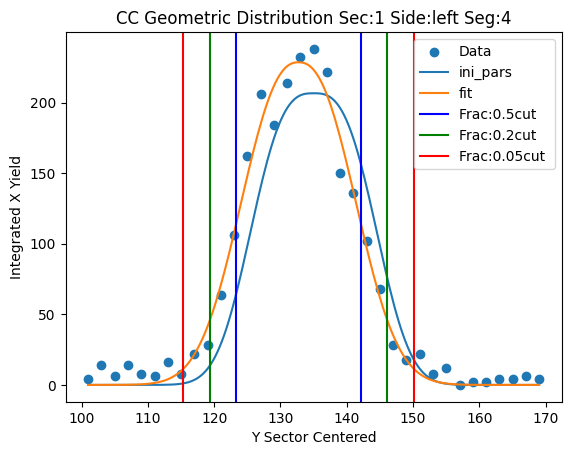

Parameters for Sec:1 Side:left Seg:5
test pars [228.52115187 153.           8.75223399   2.38175471]
fit pars [186.04715748 149.98265747   6.88476138   2.45774055]



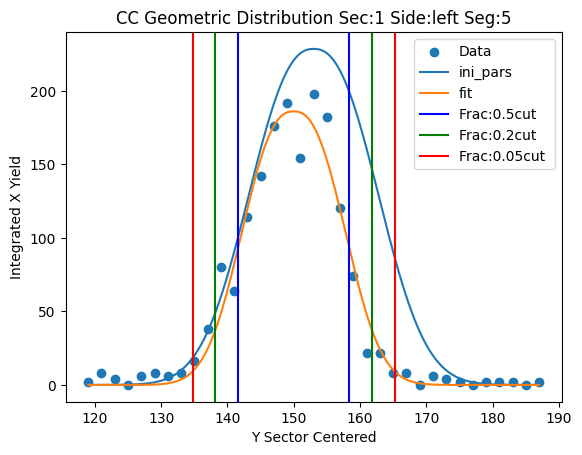

Parameters for Sec:1 Side:left Seg:6
test pars [186.04715748 165.           7.88476138   2.45774055]
fit pars [198.75768772 165.74551344   6.01278348   1.63423487]



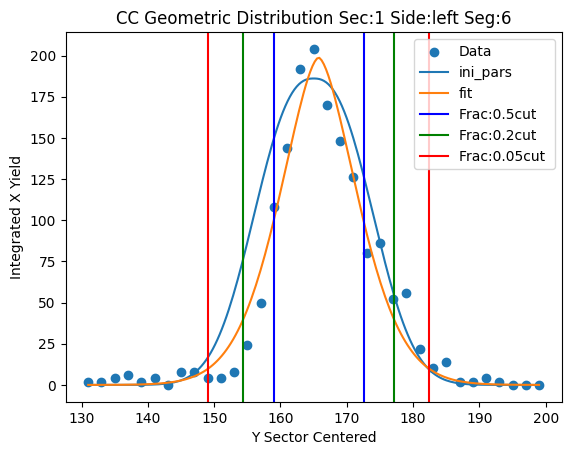

Parameters for Sec:1 Side:left Seg:7
test pars [198.75768772 187.           7.01278348   1.63423487]
fit pars [159.8432268  183.83042653   7.76336446   2.5098006 ]



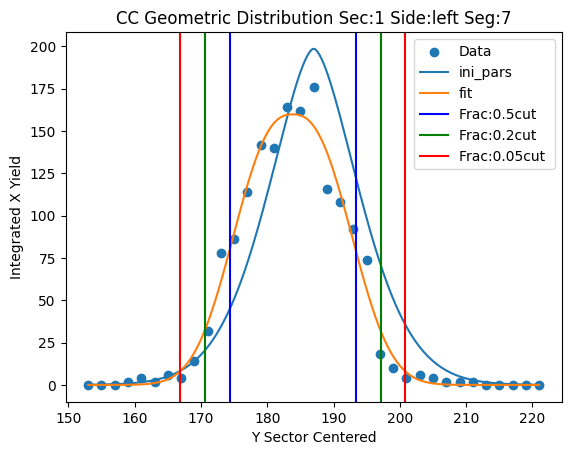

Parameters for Sec:1 Side:left Seg:8
test pars [159.8432268  201.           8.76336446   2.5098006 ]
fit pars [151.49683189 199.76500636   6.68137731   2.75804704]



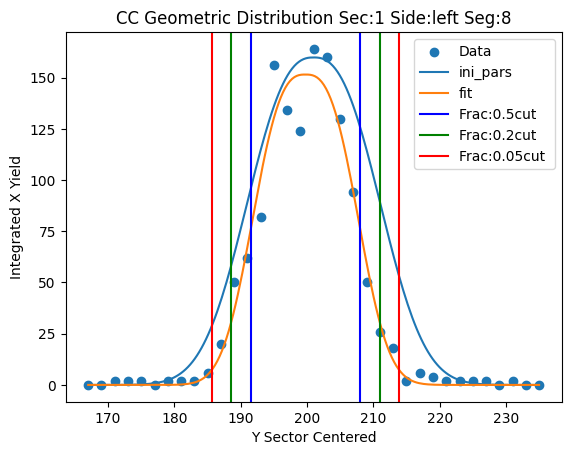

Parameters for Sec:1 Side:left Seg:9
test pars [151.49683189 215.           7.68137731   2.75804704]
fit pars [101.26139371 215.08559126   6.51251095   4.36226371]



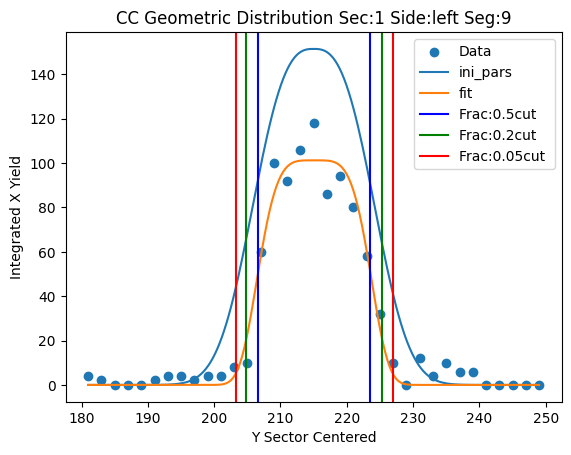

Parameters for Sec:1 Side:left Seg:10
test pars [101.26139371 231.           7.51251095   4.36226371]
fit pars [101.70012824 230.28076654   4.53897733   0.86478063]



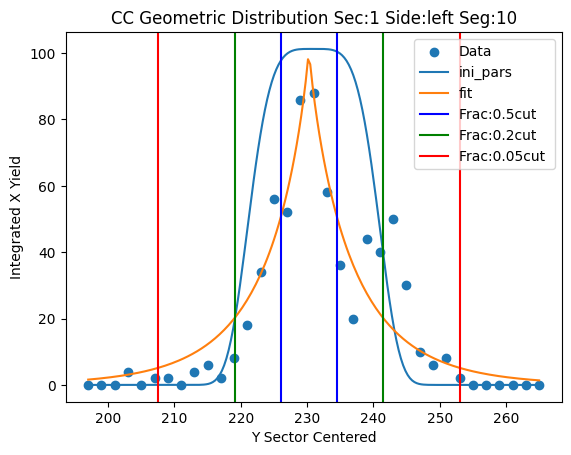

Parameters for Sec:1 Side:left Seg:11
test pars [101.70012824 251.           5.53897733   0.86478063]
fit pars [ 85.914563   248.58463972   7.9806932    1.75155456]



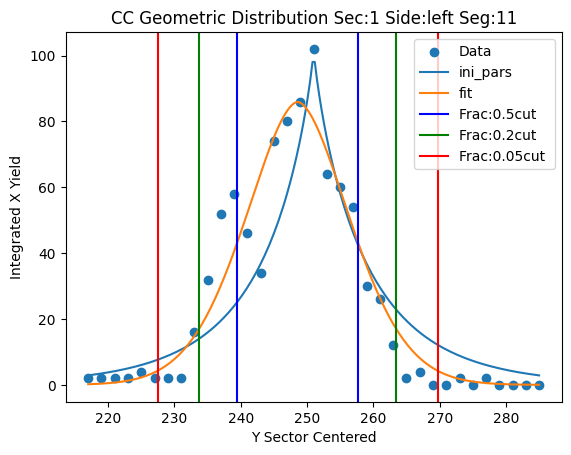

Parameters for Sec:1 Side:left Seg:12
test pars [ 85.914563   269.           8.9806932    1.75155456]
fit pars [ 73.04585603 268.27576213   6.4319998    1.04959252]



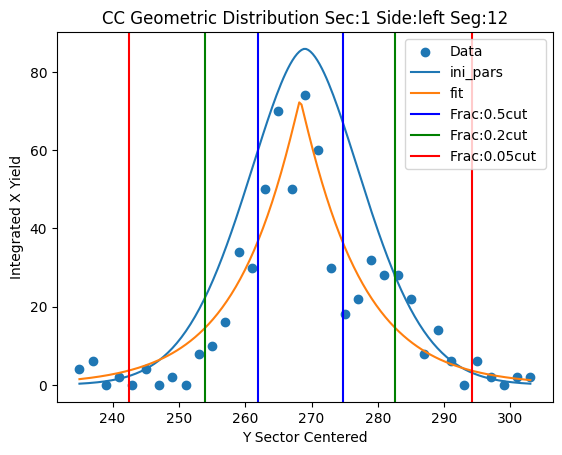

Parameters for Sec:1 Side:left Seg:13
test pars [ 73.04585603 293.           7.4319998    1.04959252]
fit pars [ 60.38168053 292.89745448   9.63647399   1.47832405]



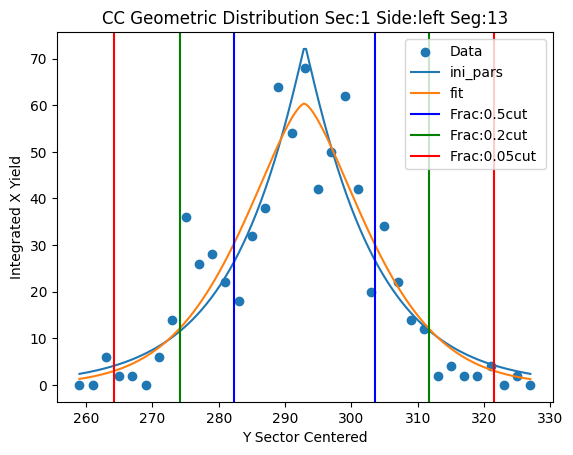

Parameters for Sec:1 Side:left Seg:14
test pars [ 60.38168053 321.          10.63647399   1.47832405]
fit pars [ 31.55370216 318.41171954  11.92641526   3.04089393]



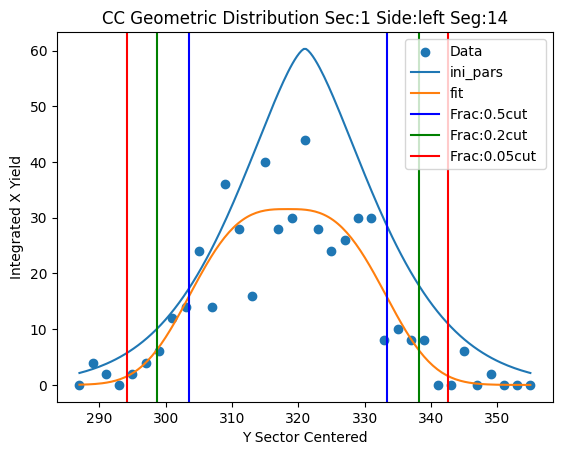

Parameters for Sec:1 Side:left Seg:15
test pars [ 31.55370216 337.          12.92641526   3.04089393]
fit pars [ 20.00876024 342.6976954    9.92755789   2.47232107]



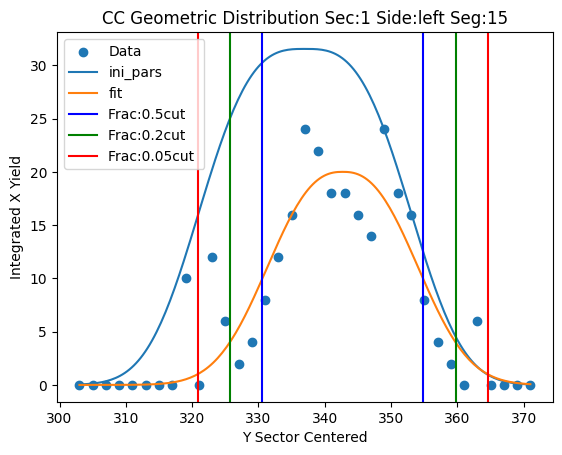

Parameters for Sec:1 Side:left Seg:16
test pars [ 20.00876024 375.          10.92755789   2.47232107]
fit pars [ 17.55064194 364.09039368  11.06788669   9.6939646 ]



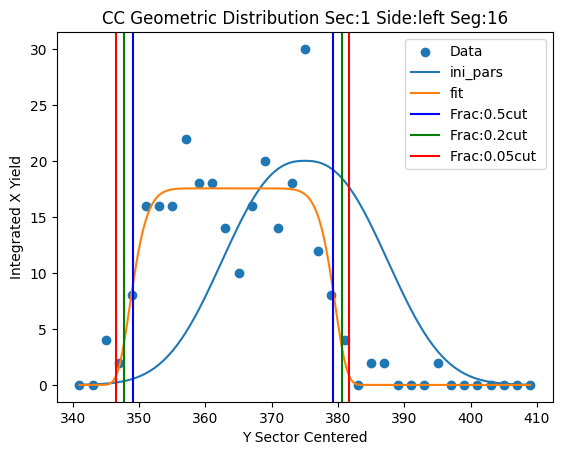

Parameters for Sec:1 Side:left Seg:17
test pars [ 17.55064194 379.          12.06788669   9.6939646 ]
fit pars [  8.57142857 383.09867937   5.60020342 115.73884668]



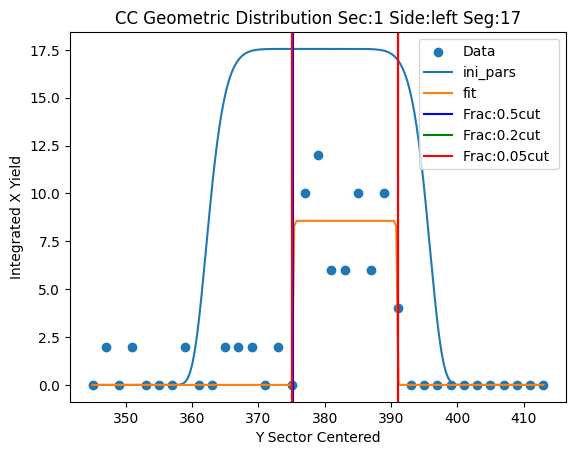

Parameters for Sec:1 Side:left Seg:18
test pars [  8.57142857 173.           6.60020342 115.73884668]
fit pars [  4.         172.99690977   1.20580613  21.43870443]



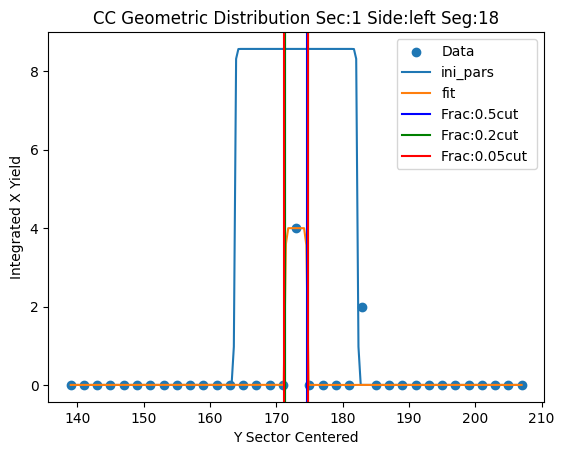

Parameters for Sec:2 Side:right Seg:1
test pars [83. 82. 10.  3.]
fit pars [21.17971108 88.56966804  3.89247605  0.66166848]



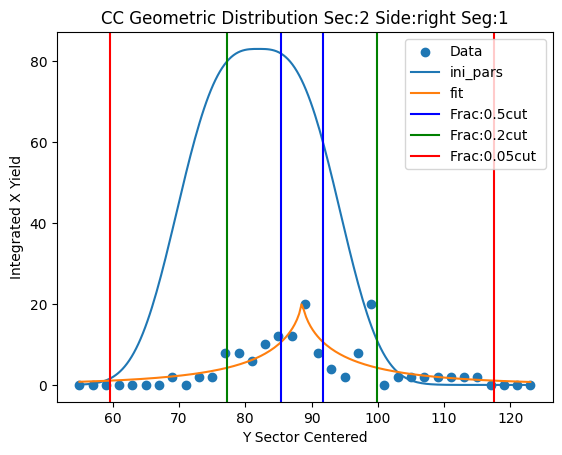

Parameters for Sec:2 Side:right Seg:2
test pars [ 21.17971108 107.           4.89247605   0.66166848]
fit pars [198.41514267 106.80088509   2.85775623   1.45499494]



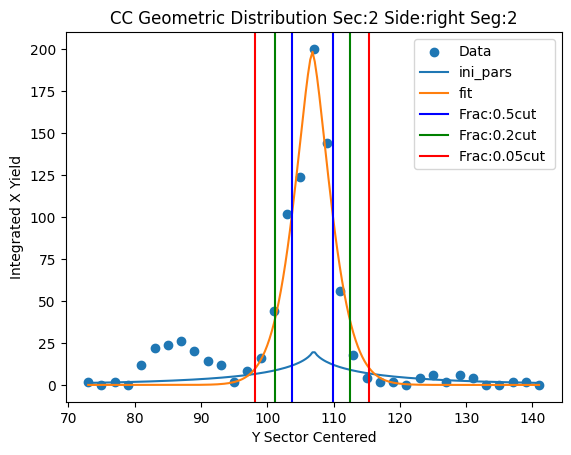

Parameters for Sec:2 Side:right Seg:3
test pars [198.41514267 117.           3.85775623   1.45499494]
fit pars [232.31179452 113.88243526   8.64563979   1.61120939]



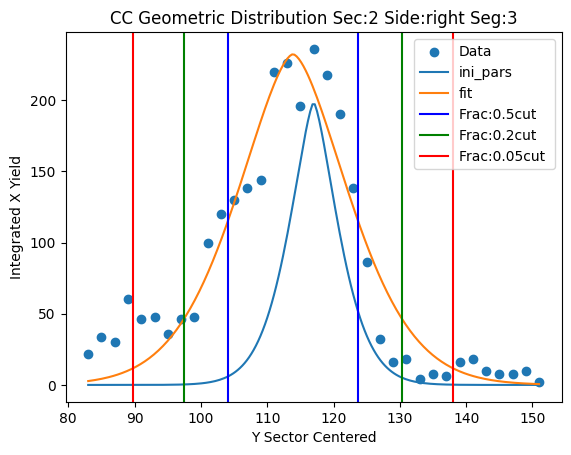

Parameters for Sec:2 Side:right Seg:4
test pars [232.31179452 137.           9.64563979   1.61120939]
fit pars [ 57.53754389 130.42760848   7.04447209   7.05139457]



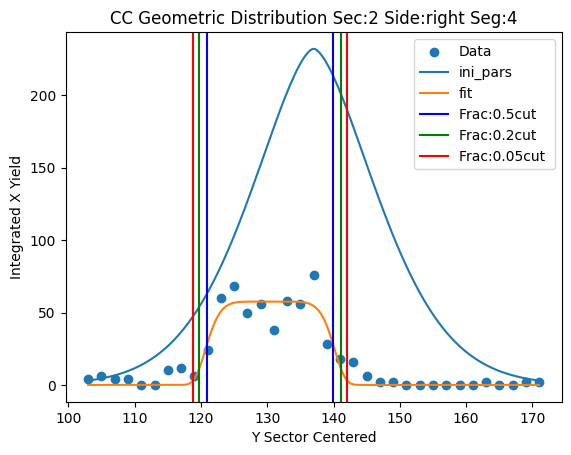

Parameters for Sec:2 Side:right Seg:5
test pars [ 57.53754389 141.           8.04447209   7.05139457]
fit pars [126.59873981 145.68325326   6.87369254   4.77359243]



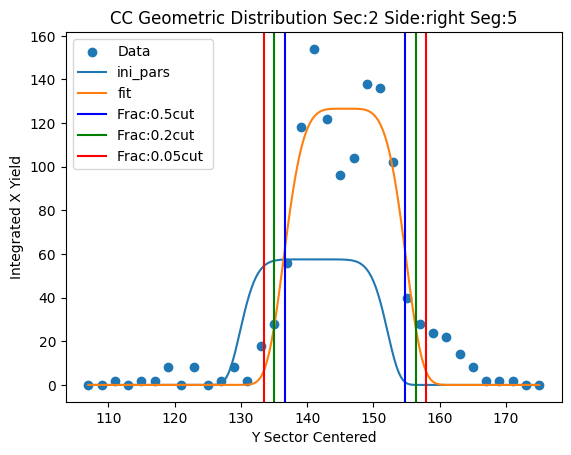

Parameters for Sec:2 Side:right Seg:6
test pars [126.59873981 161.           7.87369254   4.77359243]
fit pars [163.84379889 161.71680364   7.73909704   2.63407873]



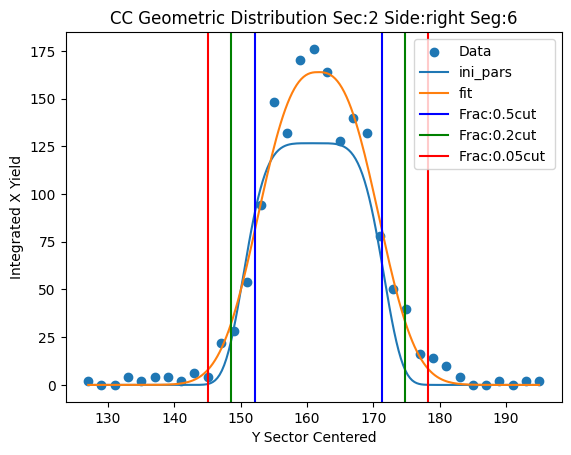

Parameters for Sec:2 Side:right Seg:7
test pars [163.84379889 181.           8.73909704   2.63407873]
fit pars [139.28952746 179.9877121    7.37257601   2.10593962]



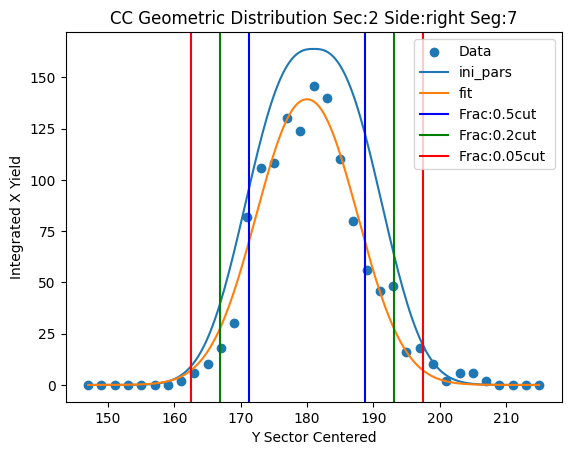

Parameters for Sec:2 Side:right Seg:8
test pars [139.28952746 199.           8.37257601   2.10593962]
fit pars [140.44577432 197.65135002   7.86954783   2.39499589]



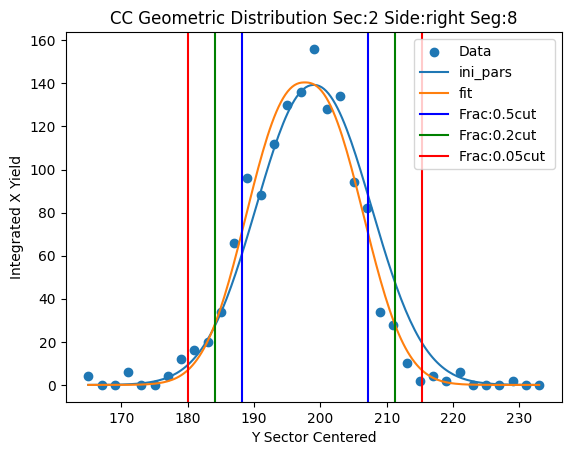

Parameters for Sec:2 Side:right Seg:9
test pars [140.44577432 215.           8.86954783   2.39499589]
fit pars [118.89951437 214.48392311   6.46639023   1.96332782]



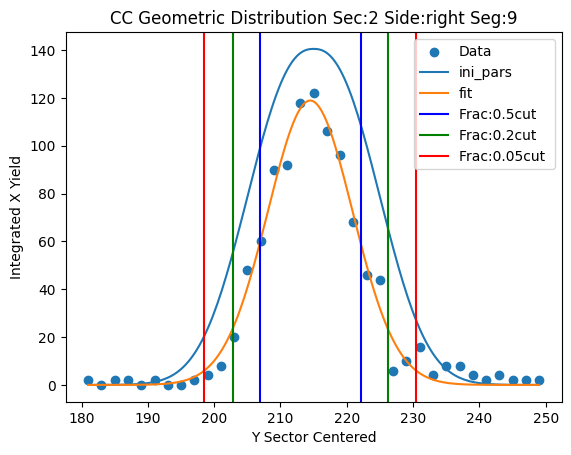

Parameters for Sec:2 Side:right Seg:10
test pars [118.89951437 227.           7.46639023   1.96332782]
fit pars [102.85380815 229.16739659   6.70681983   1.71529447]



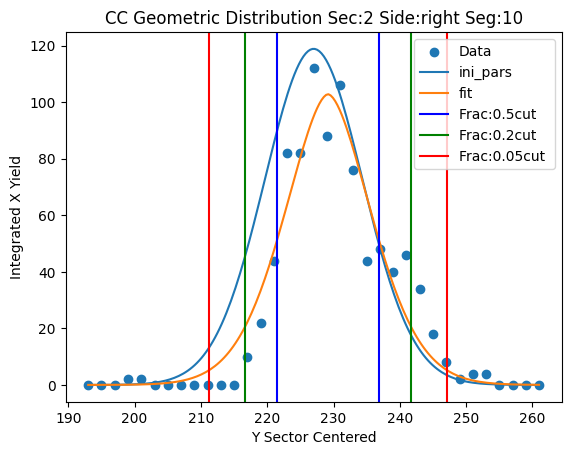

Parameters for Sec:2 Side:right Seg:11
test pars [102.85380815 253.           7.70681983   1.71529447]
fit pars [ 46.11851446 248.42459077  11.22662363   7.36398749]



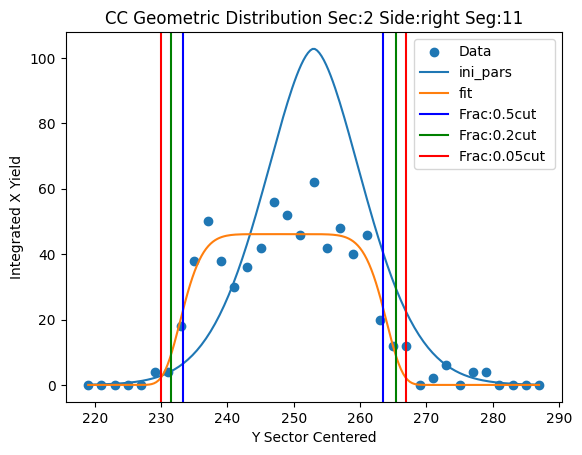

Parameters for Sec:2 Side:right Seg:12
test pars [ 46.11851446 263.          12.22662363   7.36398749]
fit pars [ 57.79514536 268.51568503   7.7396889    1.83306173]



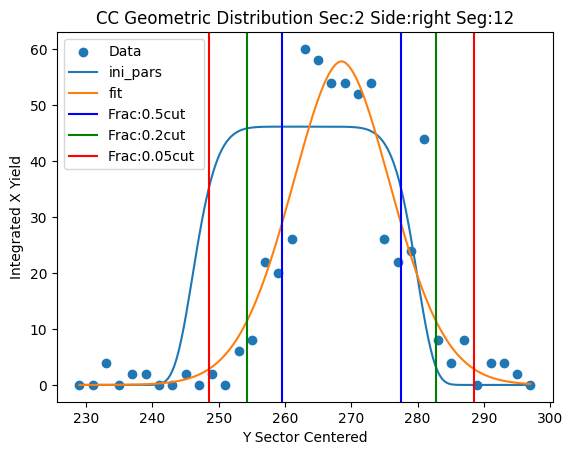

Parameters for Sec:2 Side:right Seg:13
test pars [ 57.79514536 291.           8.7396889    1.83306173]
fit pars [ 59.45732803 290.60091465   9.60406604   1.60752932]



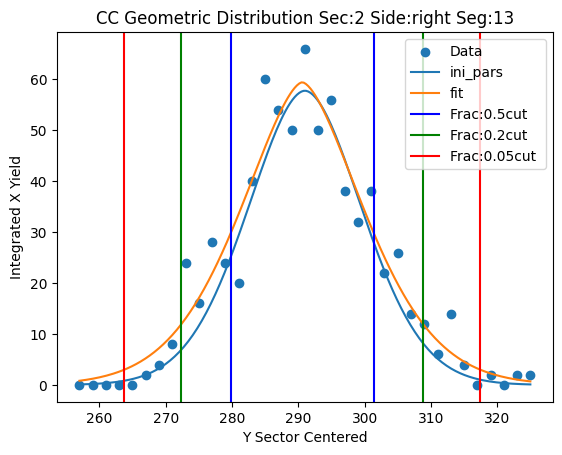

Parameters for Sec:2 Side:right Seg:14
test pars [ 59.45732803 313.          10.60406604   1.60752932]
fit pars [ 30.8607627  314.47396398   9.88611543   2.01123665]



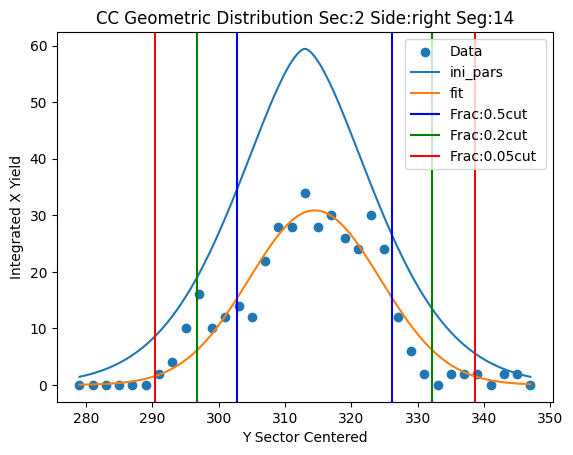

Parameters for Sec:2 Side:right Seg:15
test pars [ 30.8607627  335.          10.88611543   2.01123665]
fit pars [ 24.00037333 338.41787282  10.5246967    3.2685793 ]



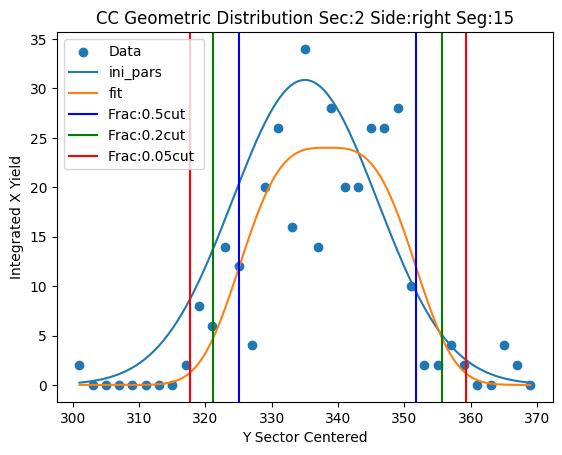

Parameters for Sec:2 Side:right Seg:16
test pars [ 24.00037333 351.          11.5246967    3.2685793 ]
fit pars [ 22.36377816 359.7889807    9.78362967   4.44870193]



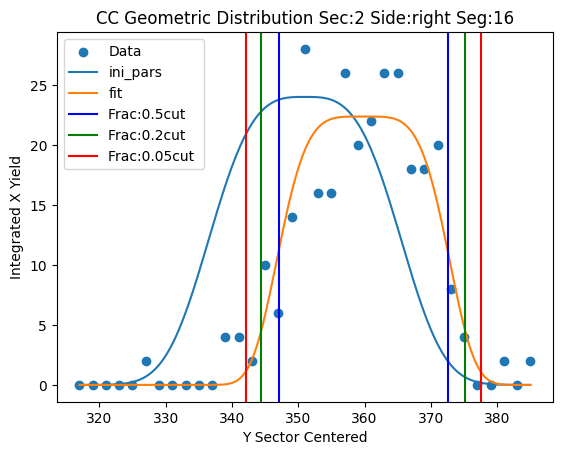

Parameters for Sec:2 Side:right Seg:17
test pars [ 22.36377816 379.          10.78362967   4.44870193]
fit pars [ 23.69460064 377.98910129   6.2689582    0.8813541 ]



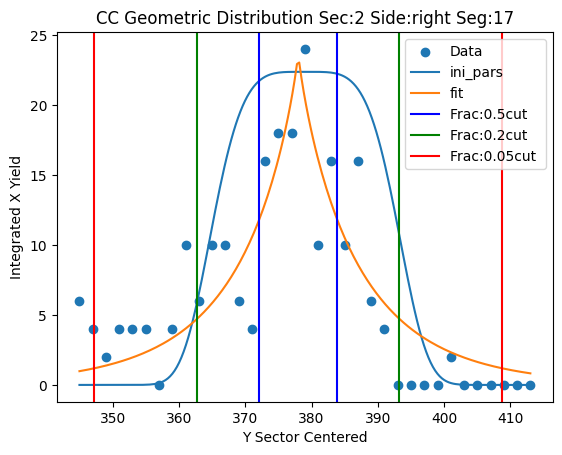

Parameters for Sec:2 Side:right Seg:18
test pars [ 23.69460064 387.           7.2689582    0.8813541 ]
fit pars [ 11.49716988 387.00000088   3.14005605   0.53114954]



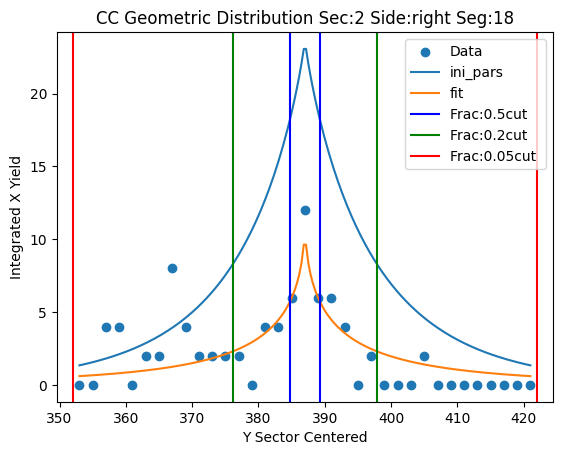

Parameters for Sec:2 Side:coinc Seg:1
test pars [40. 97. 19.  6.]
fit pars [68.66087296 85.86036176  5.35830131  0.81678252]



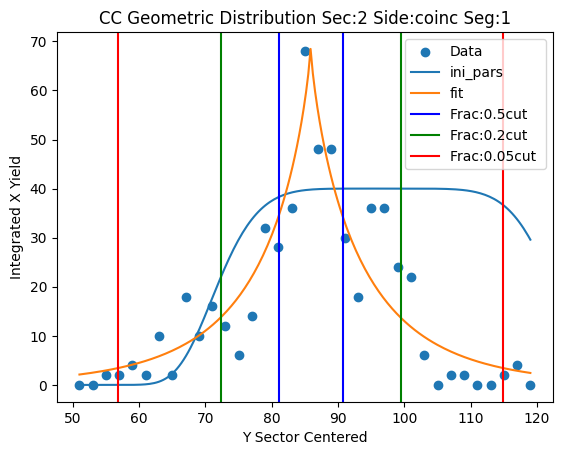

Parameters for Sec:2 Side:coinc Seg:2
test pars [ 68.66087296 101.           6.35830131   0.81678252]
fit pars [170.14377236 102.28478931   5.68548941   1.0031727 ]



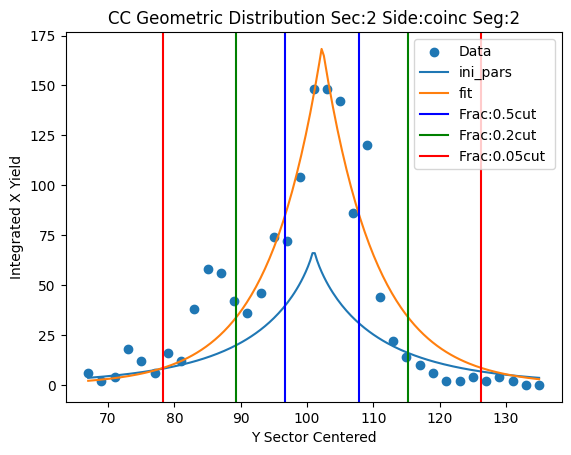

Parameters for Sec:2 Side:coinc Seg:3
test pars [170.14377236 117.           6.68548941   1.0031727 ]
fit pars [ 92.32970098 117.71100737   6.4339836    1.68921186]



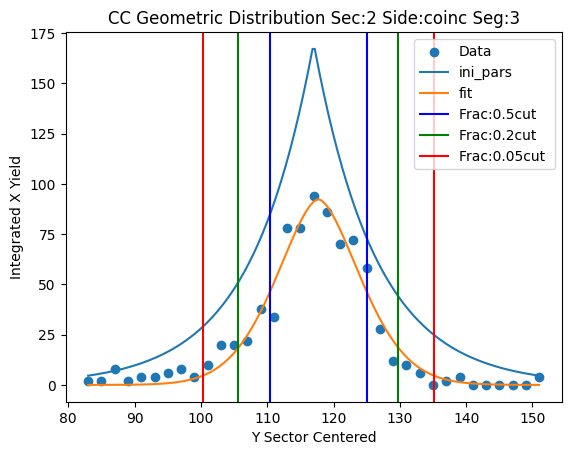

Parameters for Sec:2 Side:coinc Seg:4
test pars [ 92.32970098 135.           7.4339836    1.68921186]
fit pars [ 54.57150433 134.86557462   5.66785359   1.61885584]



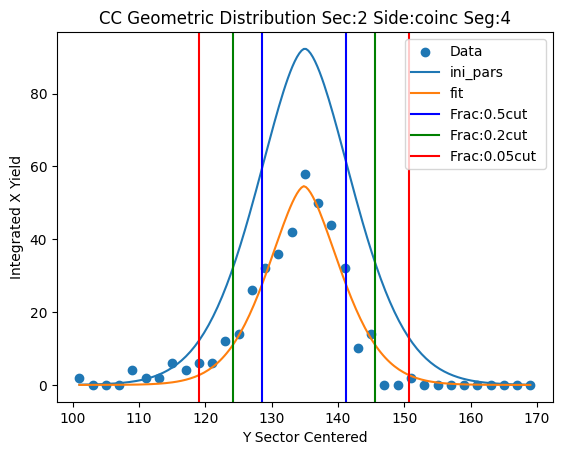

Parameters for Sec:2 Side:coinc Seg:5
test pars [ 54.57150433 147.           6.66785359   1.61885584]
fit pars [ 29.55365214 149.29912744   8.80291434   3.83757232]



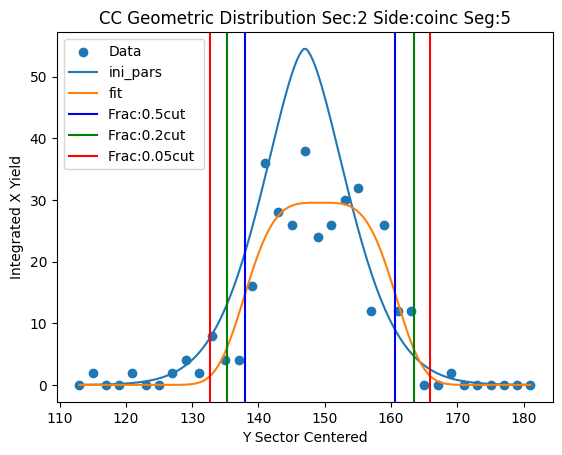

Parameters for Sec:2 Side:coinc Seg:6
test pars [ 29.55365214 165.           9.80291434   3.83757232]
fit pars [ 34.21501122 165.59929295   6.71453233   1.74067699]



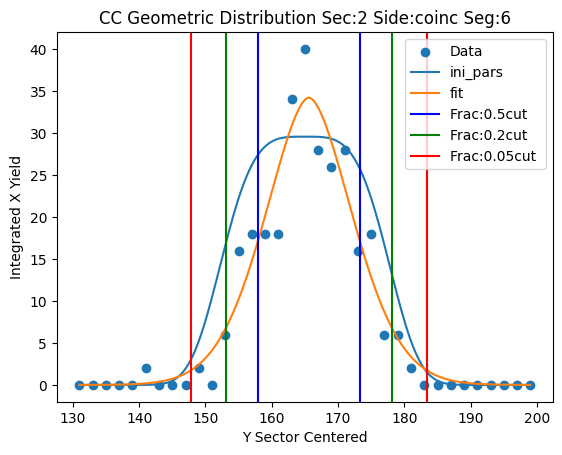

Parameters for Sec:2 Side:coinc Seg:7
test pars [ 34.21501122 183.           7.71453233   1.74067699]
fit pars [ 19.08700777 185.46016847   8.71304488   2.41675275]



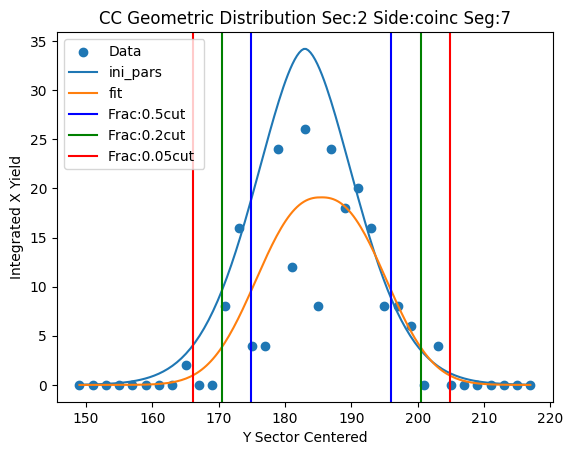

Parameters for Sec:2 Side:coinc Seg:8
test pars [ 19.08700777 197.           9.71304488   2.41675275]
fit pars [ 18.03345707 197.13212889   4.18746249   1.07645284]



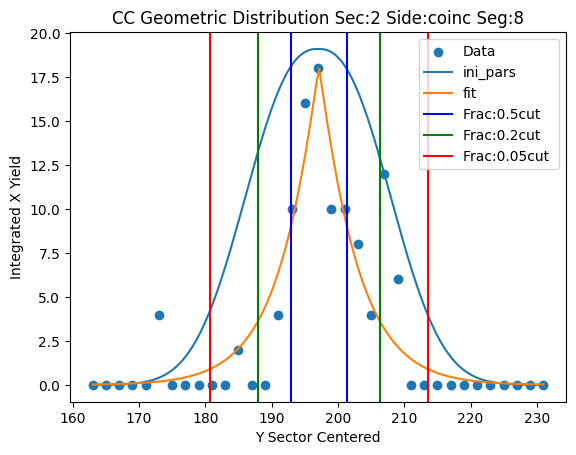

Parameters for Sec:2 Side:coinc Seg:9
test pars [ 18.03345707 221.           5.18746249   1.07645284]
fit pars [ 14.23368533 220.79918551   4.69696039   0.80410989]



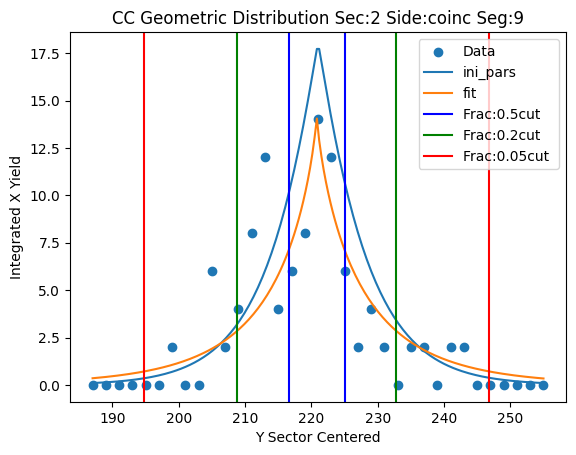

Parameters for Sec:2 Side:coinc Seg:10
test pars [ 14.23368533 225.           5.69696039   0.80410989]
fit pars [  8.93866402 229.32817932   6.85606328   1.41954379]



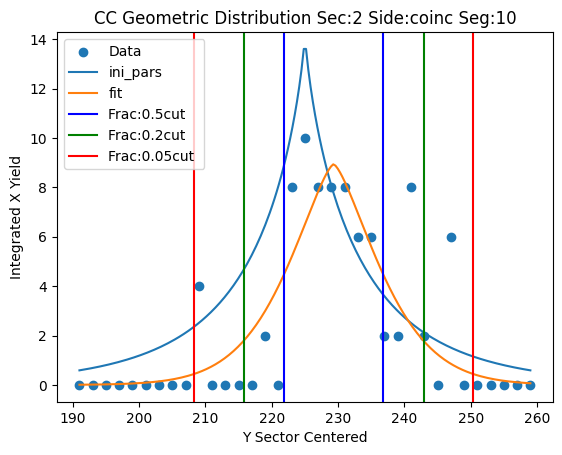

Parameters for Sec:2 Side:coinc Seg:11
test pars [  8.93866402 239.           7.85606328   1.41954379]
fit pars [  4.93936723 243.19918915   9.66663667   2.04061309]



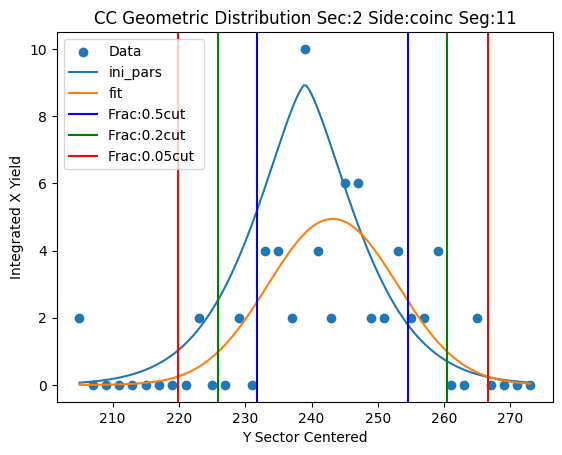

Parameters for Sec:2 Side:coinc Seg:12
test pars [  4.93936723 275.          10.66663667   2.04061309]
fit pars [  2.16056896 273.49364839  13.29661368   3.83282174]



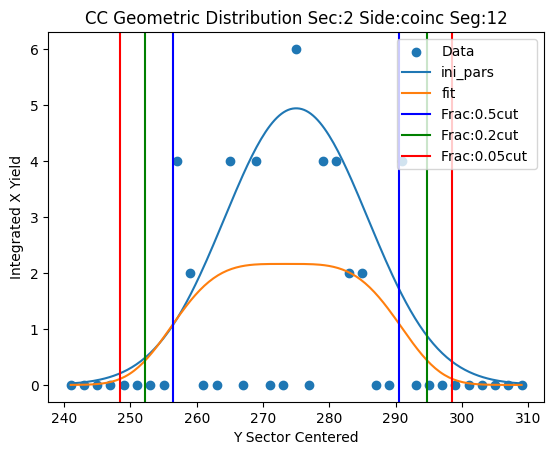

Parameters for Sec:2 Side:coinc Seg:13
test pars [  2.16056896 281.          14.29661368   3.83282174]
fit pars [  3.09550106 293.40767674  13.04691696   9.61320919]



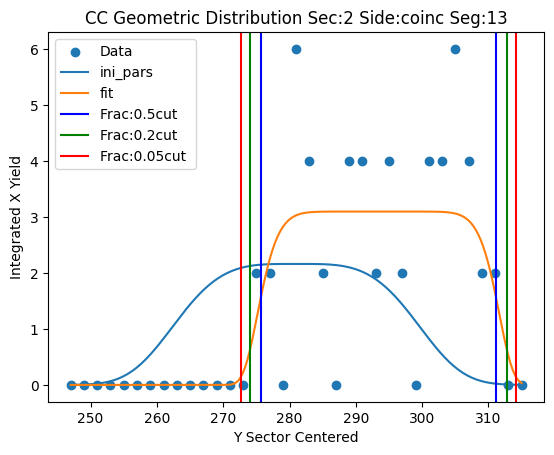

Parameters for Sec:2 Side:coinc Seg:14
test pars [  3.09550106 299.          14.04691696   9.61320919]
fit pars [  0.62857143 324.31223636  86.79820983 107.40972253]



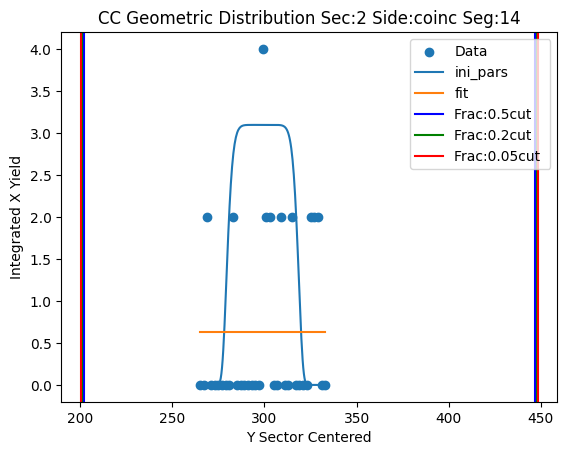

Parameters for Sec:2 Side:coinc Seg:15
test pars [  0.62857143 343.          87.79820983 107.40972253]
fit pars [  0.74278308 343.          87.79820983 107.40972253]



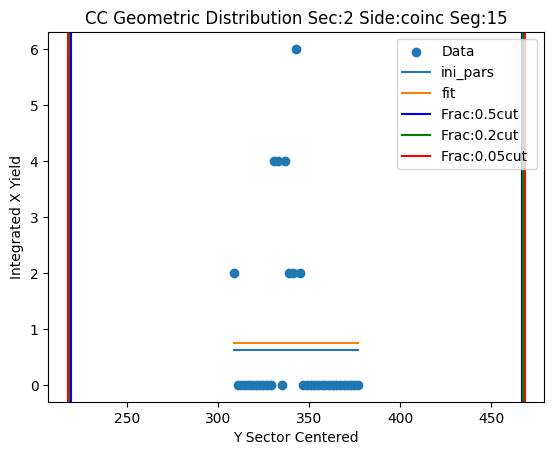

Parameters for Sec:2 Side:left Seg:1
test pars [19. 83. 13.  5.]
fit pars [17.14969441 81.1618786  13.74766407 23.77423578]



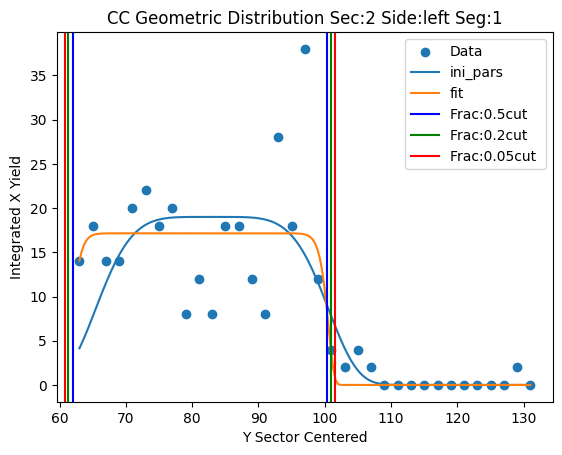

Parameters for Sec:2 Side:left Seg:2
test pars [ 17.14969441 105.          14.74766407  23.77423578]
fit pars [123.05604347 105.6405142    4.21303769   2.16398482]



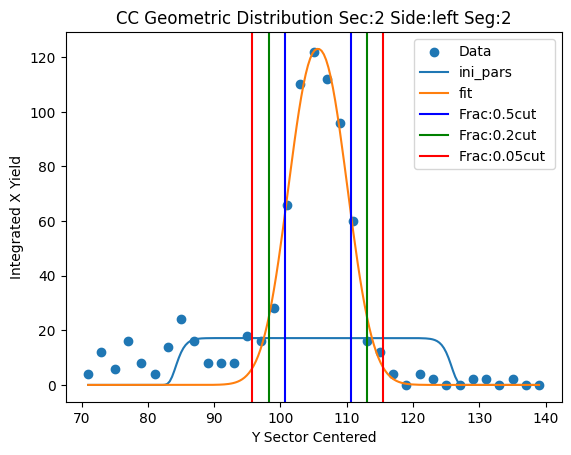

Parameters for Sec:2 Side:left Seg:3
test pars [123.05604347 113.           5.21303769   2.16398482]
fit pars [202.18806208 116.84727517   6.34583757   3.13873053]



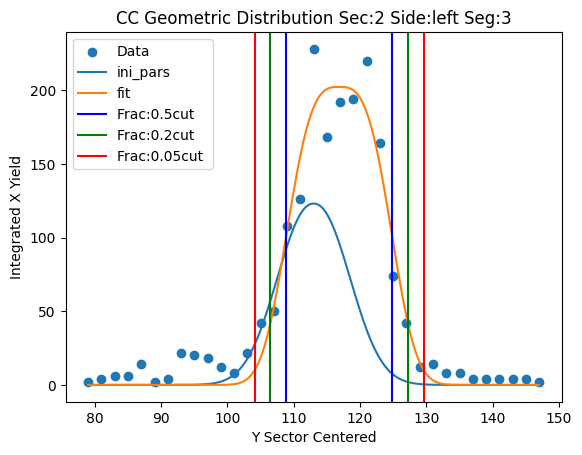

Parameters for Sec:2 Side:left Seg:4
test pars [202.18806208 131.           7.34583757   3.13873053]
fit pars [189.22235317 131.95264861   6.29595633   2.48828841]



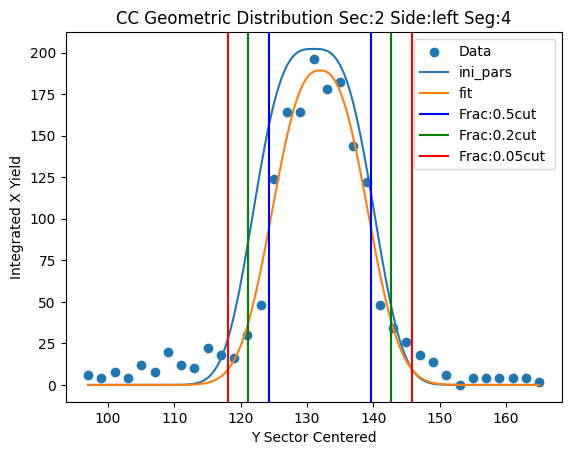

Parameters for Sec:2 Side:left Seg:5
test pars [189.22235317 145.           7.29595633   2.48828841]
fit pars [185.92496672 146.95605344   7.96988993   2.61071372]



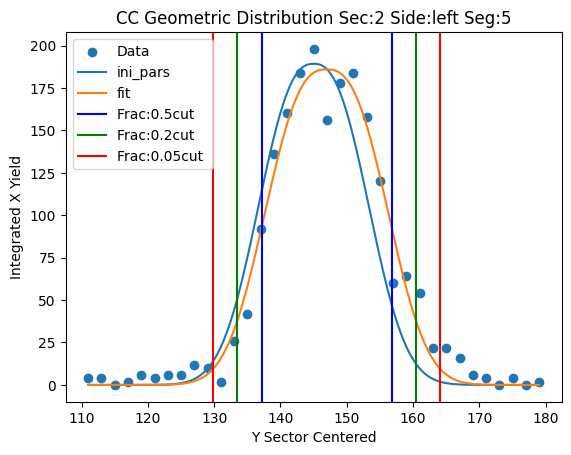

Parameters for Sec:2 Side:left Seg:6
test pars [185.92496672 167.           8.96988993   2.61071372]
fit pars [221.97049533 164.49936751   7.77616299   2.05076185]



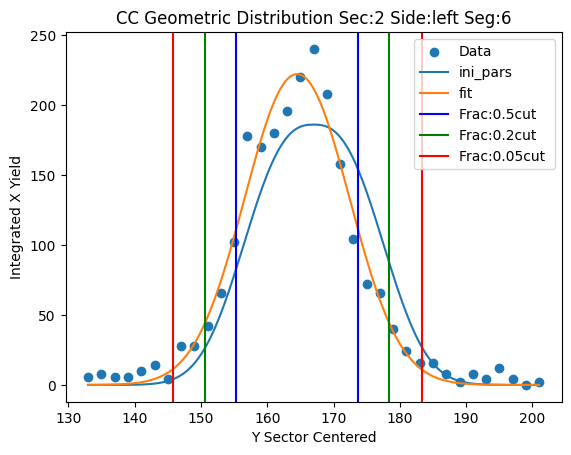

Parameters for Sec:2 Side:left Seg:7
test pars [221.97049533 181.           8.77616299   2.05076185]
fit pars [171.36934305 182.22453915   7.21184222   2.19939775]



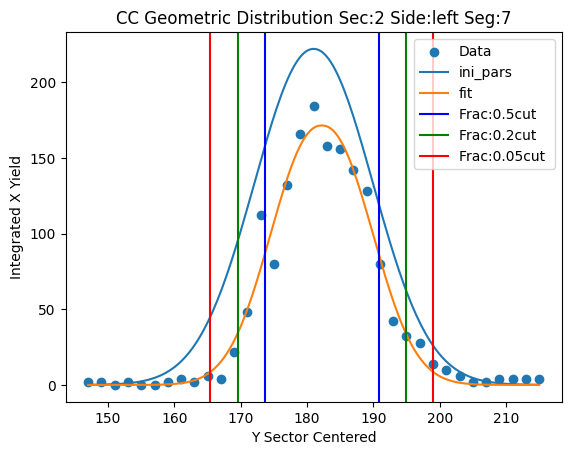

Parameters for Sec:2 Side:left Seg:8
test pars [171.36934305 203.           8.21184222   2.19939775]
fit pars [149.54213414 199.81603445   7.30709816   2.29699161]



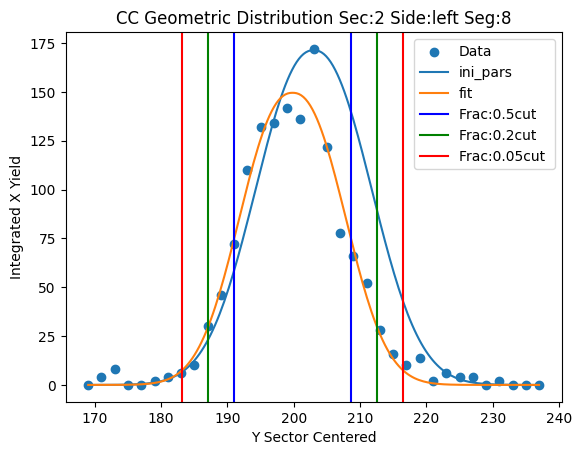

Parameters for Sec:2 Side:left Seg:9
test pars [149.54213414 221.           8.30709816   2.29699161]
fit pars [125.52286333 216.06679205   6.68497094   3.09064043]



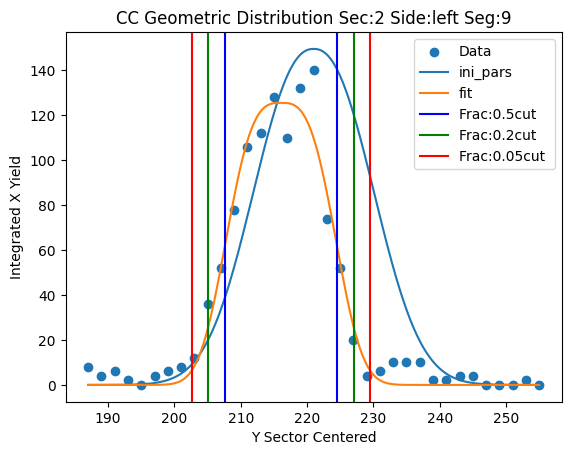

Parameters for Sec:2 Side:left Seg:10
test pars [125.52286333 225.           7.68497094   3.09064043]
fit pars [105.48263175 229.99225661   6.47232602   1.35145691]



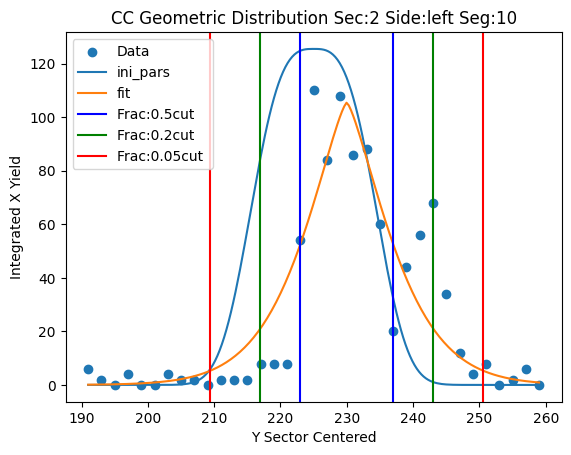

Parameters for Sec:2 Side:left Seg:11
test pars [105.48263175 249.           7.47232602   1.35145691]
fit pars [ 78.70966764 249.52667302   9.70708228   2.96059645]



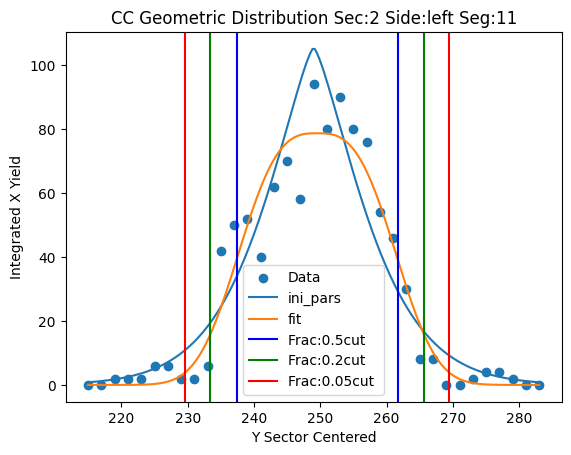

Parameters for Sec:2 Side:left Seg:12
test pars [ 78.70966764 269.          10.70708228   2.96059645]
fit pars [105.44248682 269.00000001   4.83604852   0.84090124]



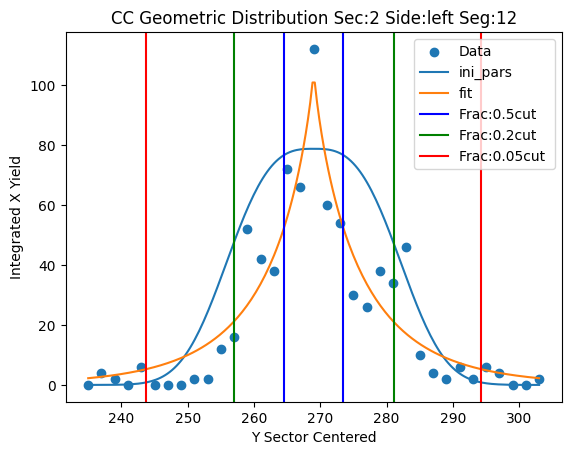

Parameters for Sec:2 Side:left Seg:13
test pars [105.44248682 291.           5.83604852   0.84090124]
fit pars [ 56.25276507 293.05195961  12.31039248   2.11054406]



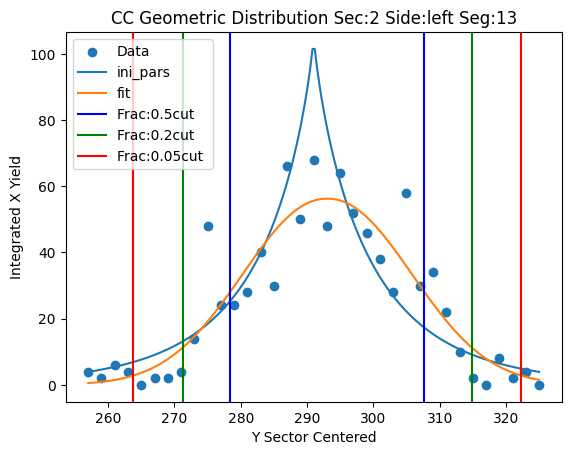

Parameters for Sec:2 Side:left Seg:14
test pars [ 56.25276507 317.          13.31039248   2.11054406]
fit pars [ 48.05375791 318.18807134   7.06716569   1.03044409]



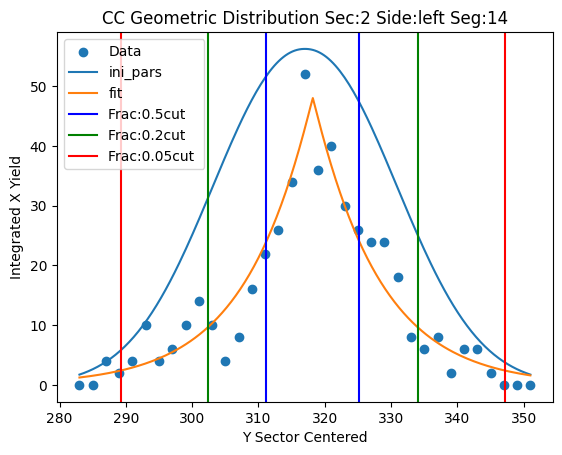

Parameters for Sec:2 Side:left Seg:15
test pars [ 48.05375791 345.           8.06716569   1.03044409]
fit pars [ 26.82932914 341.15245085  10.16921341   4.2537558 ]



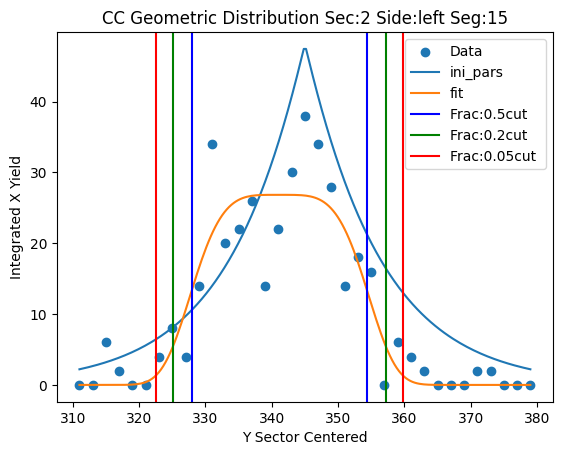

Parameters for Sec:2 Side:left Seg:16
test pars [ 26.82932914 359.          11.16921341   4.2537558 ]
fit pars [ 21.12289117 362.81790319   9.106402     3.35416335]



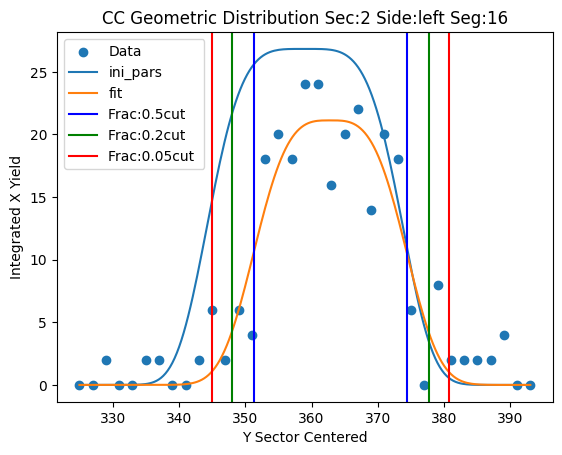

Parameters for Sec:2 Side:left Seg:17
test pars [ 21.12289117 379.          10.106402     3.35416335]
fit pars [ 15.88143873 381.06219426   6.70777791   2.73066753]



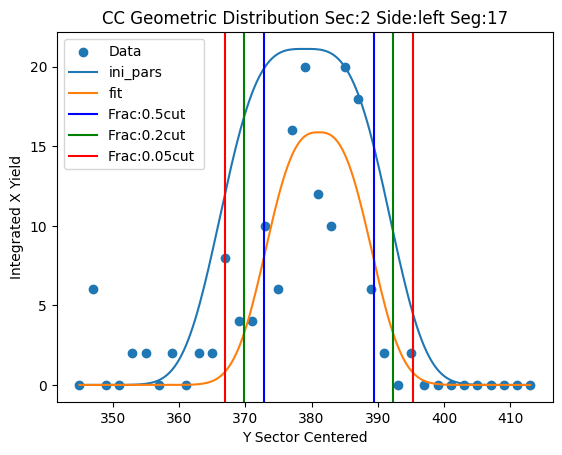

Parameters for Sec:3 Side:right Seg:1
test pars [83. 82. 10.  3.]
fit pars [114.99026168  85.4536156    8.91763876   1.90719931]



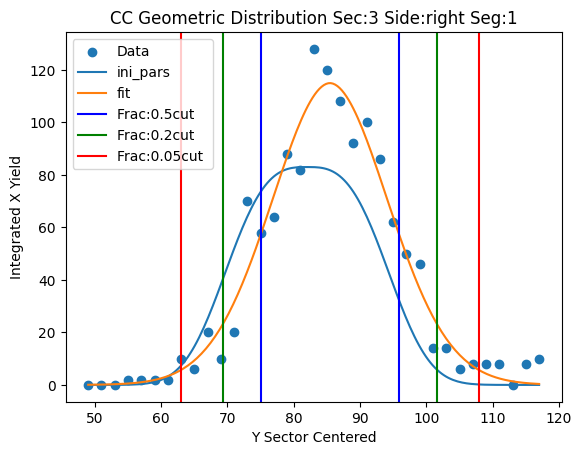

Parameters for Sec:3 Side:right Seg:2
test pars [114.99026168 105.           9.91763876   1.90719931]
fit pars [120.24316996 106.15746454   4.2365017    2.19226444]



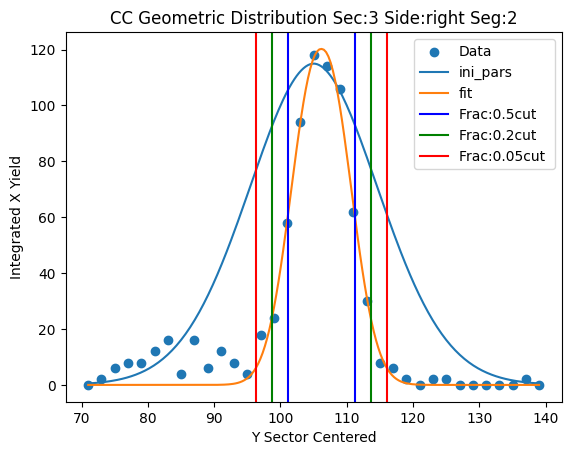

Parameters for Sec:3 Side:right Seg:3
test pars [120.24316996 119.           5.2365017    2.19226444]
fit pars [204.64802057 116.85556285   6.91605325   2.58027804]



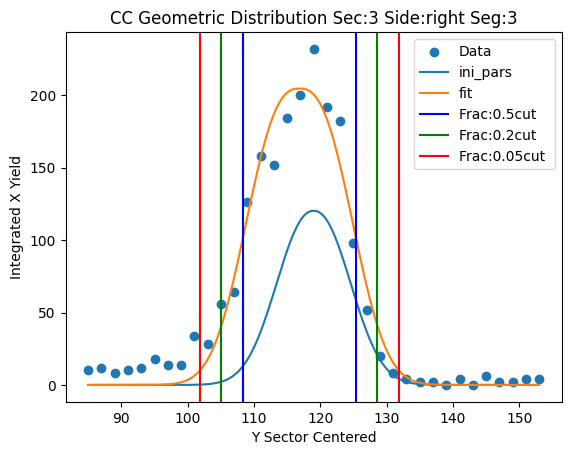

Parameters for Sec:3 Side:right Seg:4
test pars [204.64802057 129.           7.91605325   2.58027804]
fit pars [199.94078264 130.4390391    7.66494085   2.5512146 ]



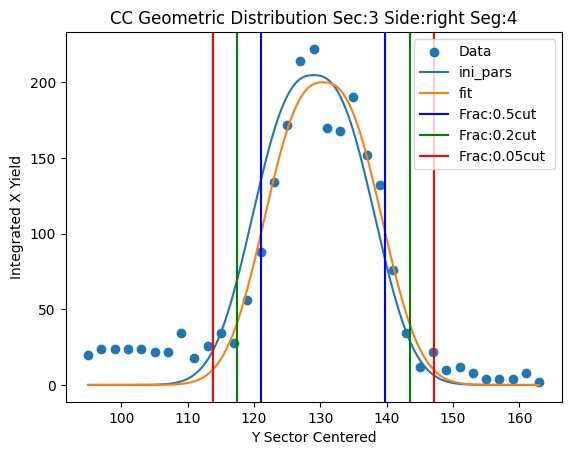

Parameters for Sec:3 Side:right Seg:5
test pars [199.94078264 153.           8.66494085   2.5512146 ]
fit pars [170.57214471 146.57026791   7.66731137   2.79343502]



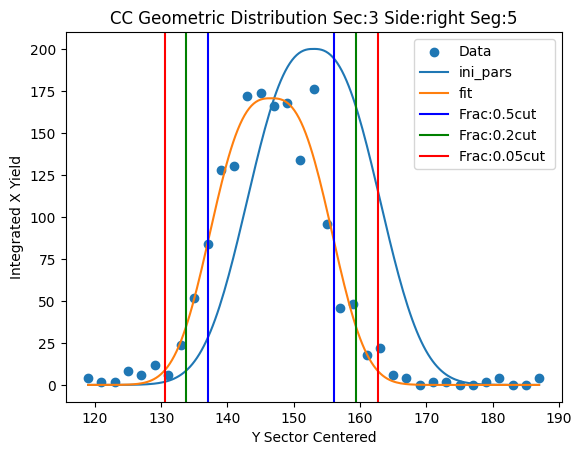

Parameters for Sec:3 Side:right Seg:6
test pars [170.57214471 167.           8.66731137   2.79343502]
fit pars [208.3685871  164.27968356   6.81552655   2.43198918]



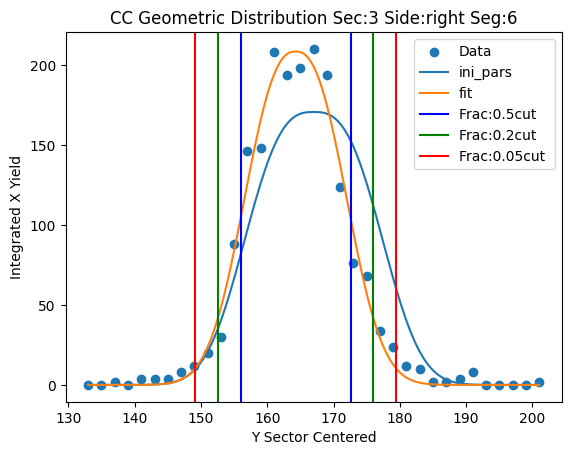

Parameters for Sec:3 Side:right Seg:7
test pars [208.3685871  183.           7.81552655   2.43198918]
fit pars [172.51546017 181.45345122   6.84449849   2.0109124 ]



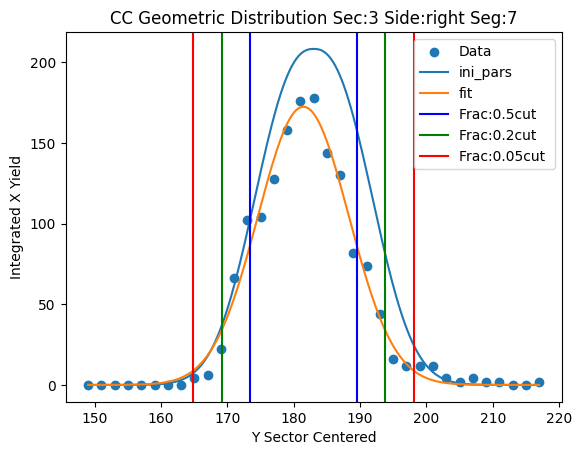

Parameters for Sec:3 Side:right Seg:8
test pars [172.51546017 199.           7.84449849   2.0109124 ]
fit pars [138.68672423 200.17619256   7.26664869   2.01406927]



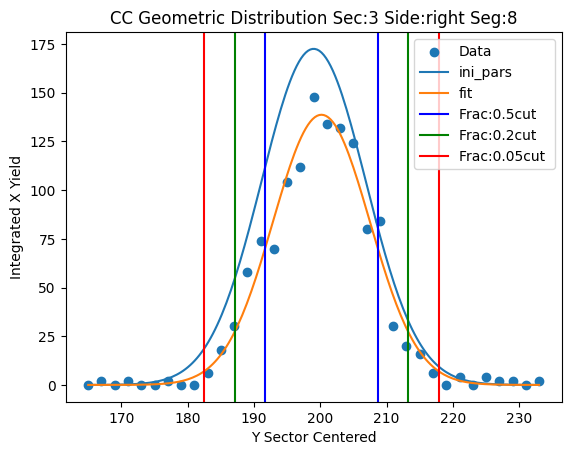

Parameters for Sec:3 Side:right Seg:9
test pars [138.68672423 219.           8.26664869   2.01406927]
fit pars [125.85015709 215.13931402   5.94705764   2.49518282]



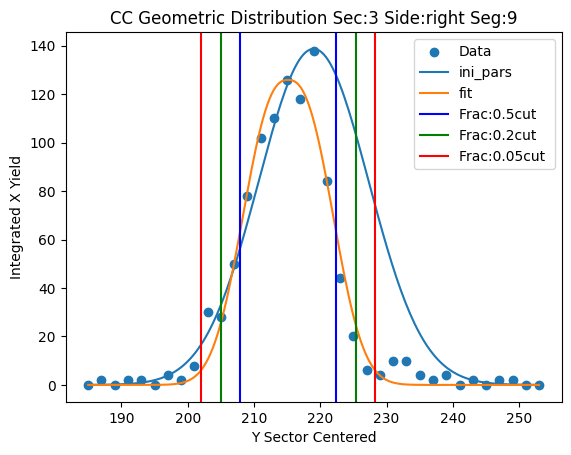

Parameters for Sec:3 Side:right Seg:10
test pars [125.85015709 227.           6.94705764   2.49518282]
fit pars [100.4194308  228.96230665   5.04132702   2.22999079]



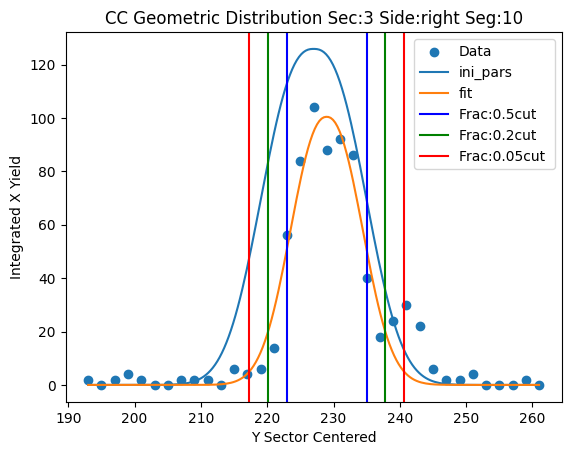

Parameters for Sec:3 Side:right Seg:11
test pars [100.4194308  251.           6.04132702   2.22999079]
fit pars [ 73.76119965 246.70513277  10.058668     5.40108364]



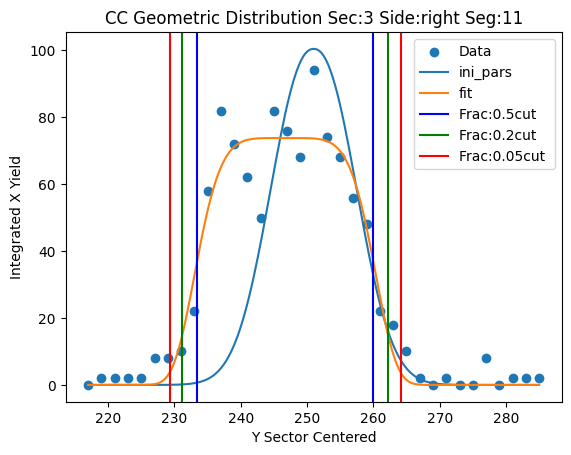

Parameters for Sec:3 Side:right Seg:12
test pars [ 73.76119965 267.          11.058668     5.40108364]
fit pars [ 77.62105287 265.24050053   4.56412159   3.78066799]



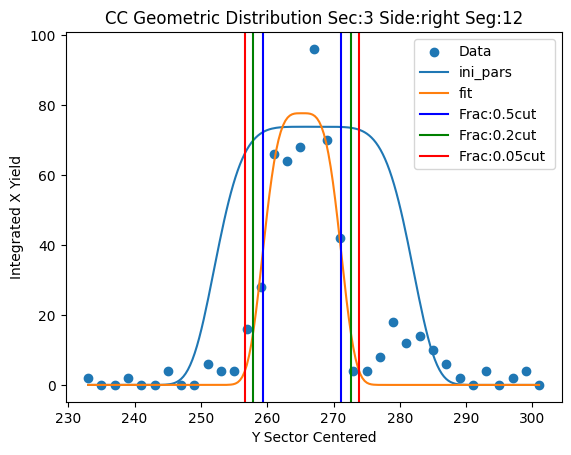

Parameters for Sec:3 Side:right Seg:13
test pars [ 77.62105287 277.           5.56412159   3.78066799]
fit pars [ 46.58697277 288.88457026  13.59330877   8.96660462]



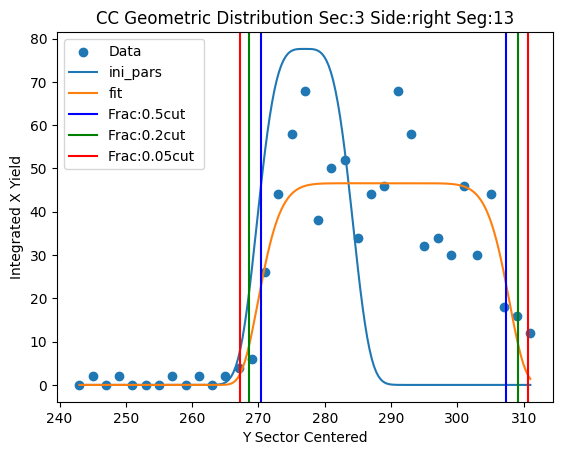

Parameters for Sec:3 Side:right Seg:14
test pars [ 46.58697277 315.          14.59330877   8.96660462]
fit pars [ 32.12018338 320.18619734   8.6335428    8.7905951 ]



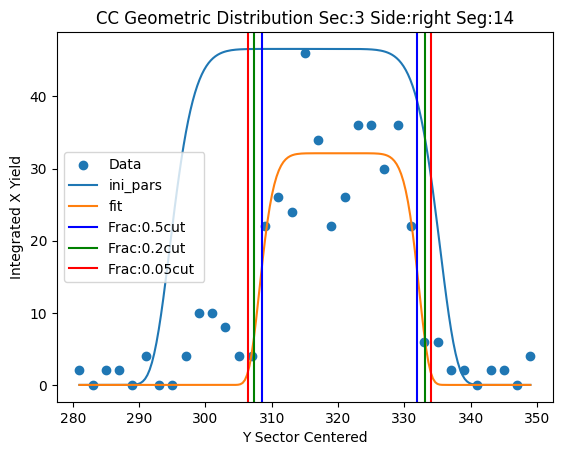

Parameters for Sec:3 Side:right Seg:15
test pars [ 32.12018338 347.           9.6335428    8.7905951 ]
fit pars [ 26.41285908 343.16881165   8.9276658    3.02670082]



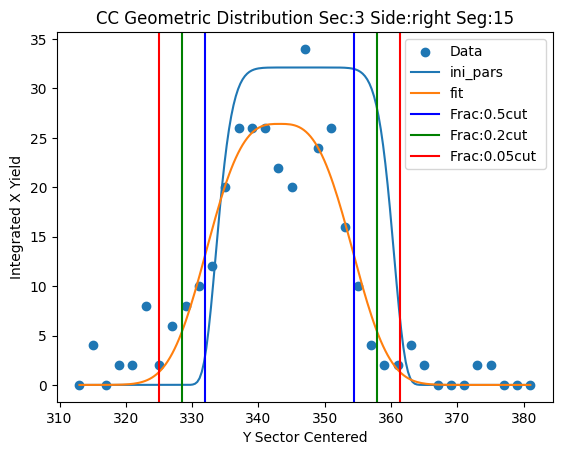

Parameters for Sec:3 Side:right Seg:16
test pars [ 26.41285908 361.           9.9276658    3.02670082]
fit pars [ 21.42598003 365.34379119   8.43661341   5.07714285]



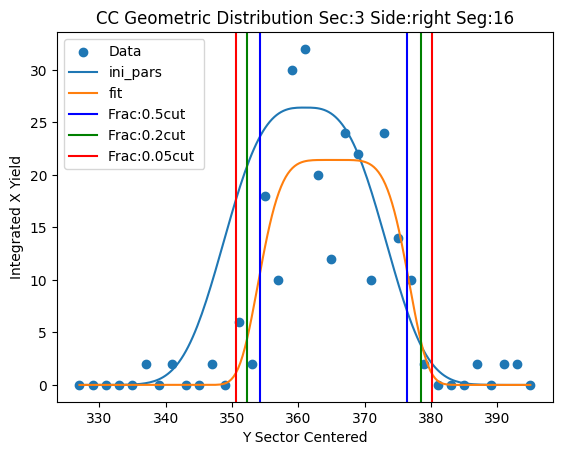

Parameters for Sec:3 Side:right Seg:17
test pars [ 21.42598003 377.           9.43661341   5.07714285]
fit pars [ 16.08716612 382.10760293   5.7699088    8.47230864]



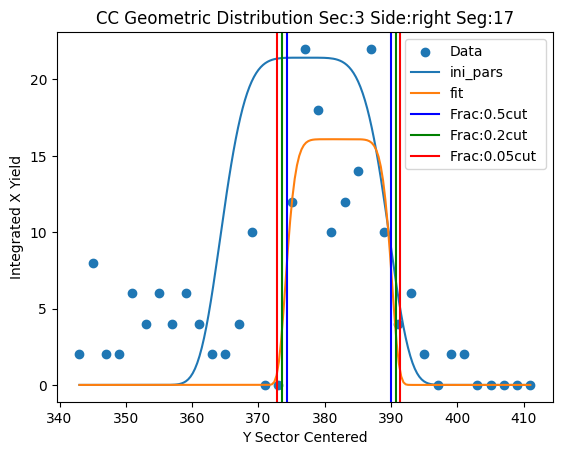

Parameters for Sec:3 Side:right Seg:18
test pars [ 16.08716612 349.           6.7699088    8.47230864]
fit pars [5.35285244e+00 3.62999999e+02 6.62405362e+01 2.72866357e-01]



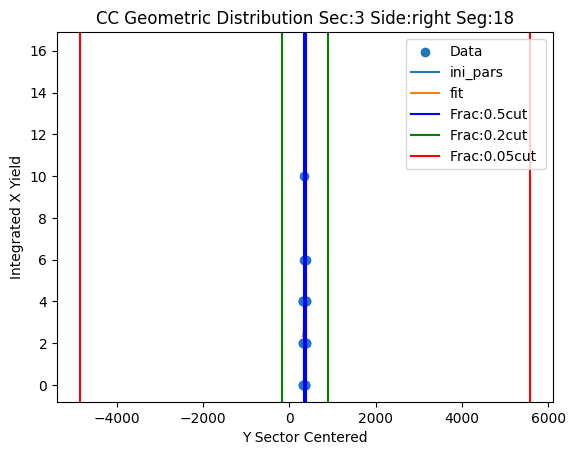

Parameters for Sec:3 Side:coinc Seg:1
test pars [40. 97. 19.  6.]
fit pars [48.7627996  86.67138048 10.98487991 16.42316204]



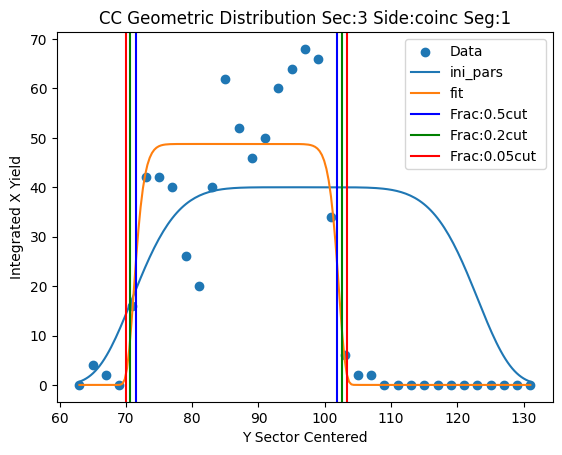

Parameters for Sec:3 Side:coinc Seg:2
test pars [ 48.7627996  103.          11.98487991  16.42316204]
fit pars [166.41938713 104.00375828   3.94711786   0.79098858]



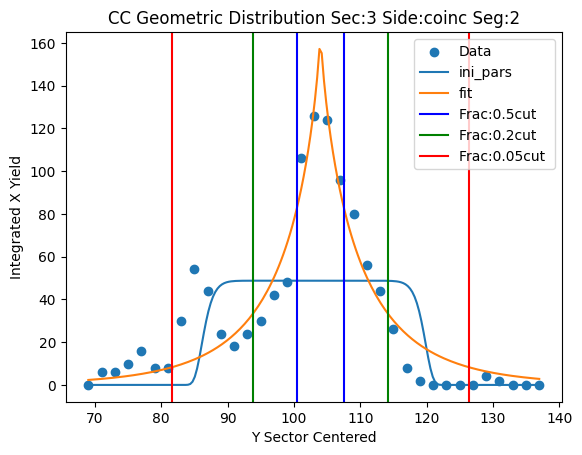

Parameters for Sec:3 Side:coinc Seg:3
test pars [166.41938713 117.           4.94711786   0.79098858]
fit pars [ 92.27307518 117.55280606   6.21838113   1.78645525]



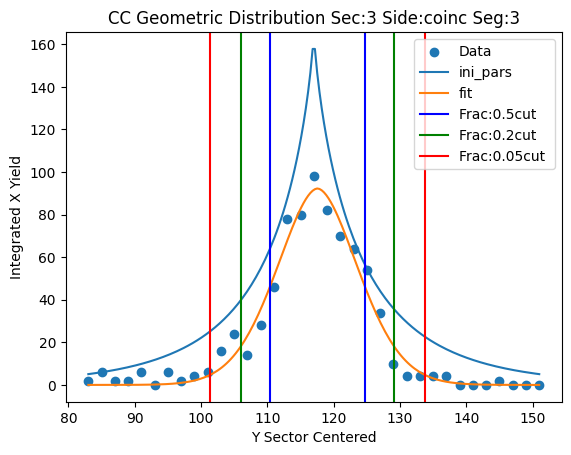

Parameters for Sec:3 Side:coinc Seg:4
test pars [ 92.27307518 137.           7.21838113   1.78645525]
fit pars [ 55.82283673 134.11110662   6.6128994    2.49760132]



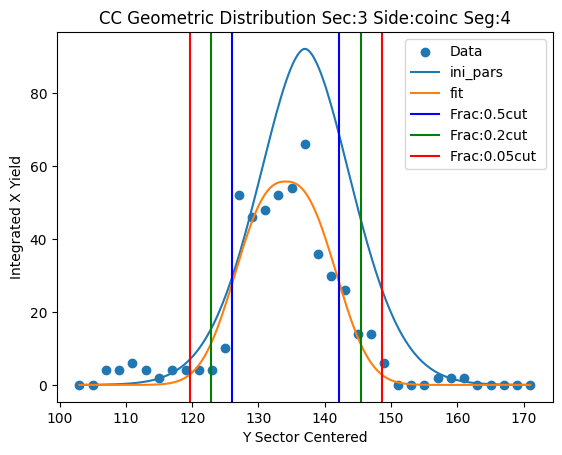

Parameters for Sec:3 Side:coinc Seg:5
test pars [ 55.82283673 145.           7.6128994    2.49760132]
fit pars [ 28.96894786 149.84236426   8.14428129   3.41622418]



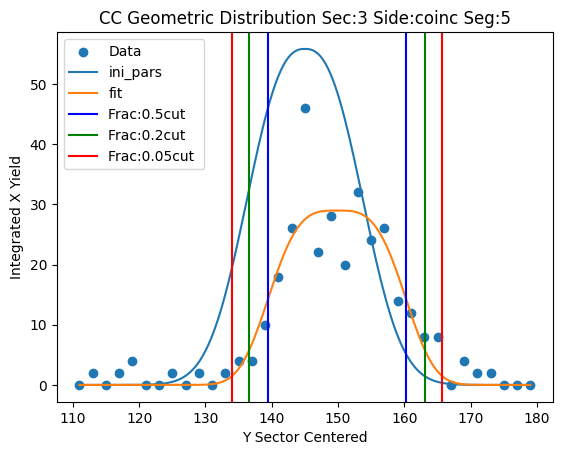

Parameters for Sec:3 Side:coinc Seg:6
test pars [ 28.96894786 169.           9.14428129   3.41622418]
fit pars [ 41.31665742 166.65286066   5.49343633   1.59205541]



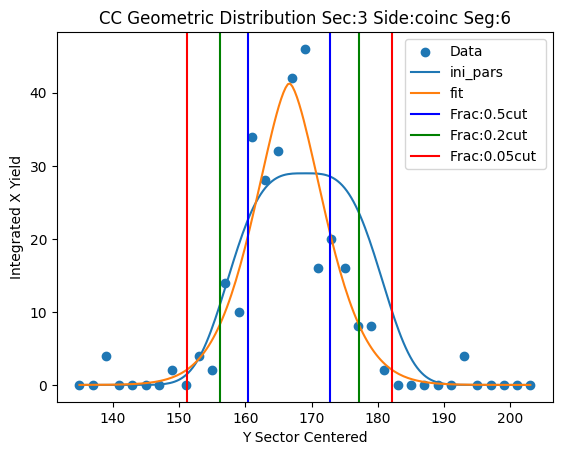

Parameters for Sec:3 Side:coinc Seg:7
test pars [ 41.31665742 191.           6.49343633   1.59205541]
fit pars [  9.80670012 184.48325126   8.97993391   3.4757738 ]



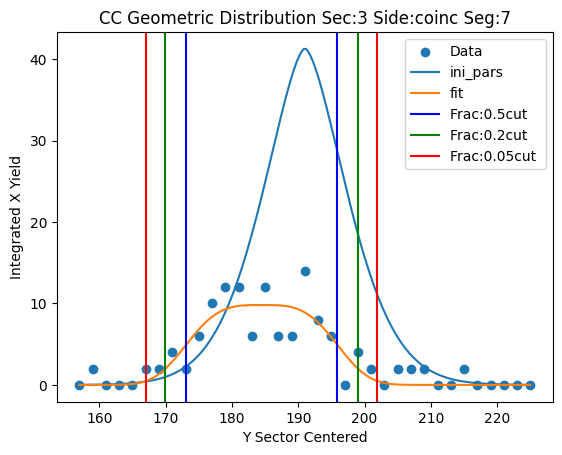

Parameters for Sec:3 Side:coinc Seg:8
test pars [  9.80670012 205.           9.97993391   3.4757738 ]
fit pars [ 17.48924489 201.13418359   6.7169665    1.51772687]



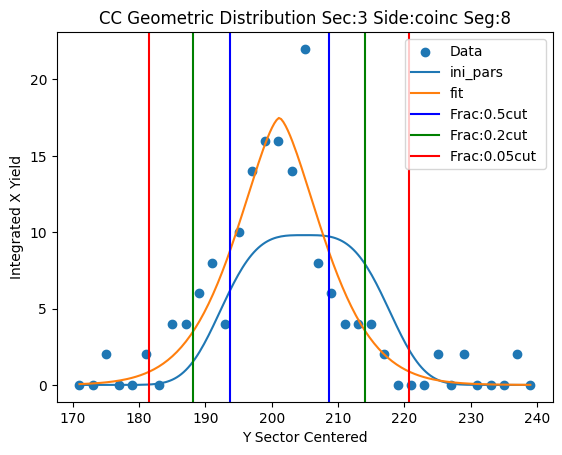

Parameters for Sec:3 Side:coinc Seg:9
test pars [ 17.48924489 215.           7.7169665    1.51772687]
fit pars [ 15.56704002 215.2556064    4.11371134   1.01982542]



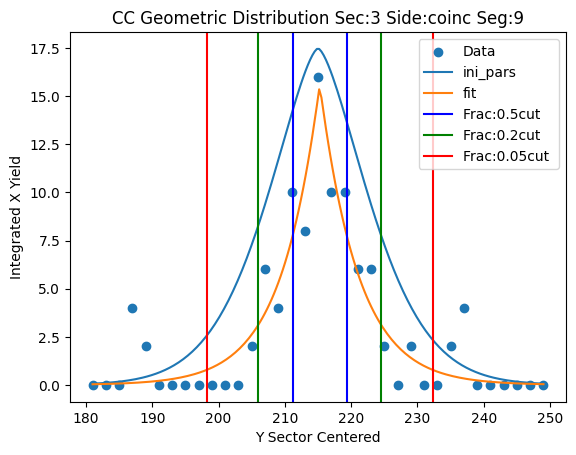

Parameters for Sec:3 Side:coinc Seg:10
test pars [ 15.56704002 229.           5.11371134   1.01982542]
fit pars [ 17.71207629 228.50073582   3.27169182   0.74338073]



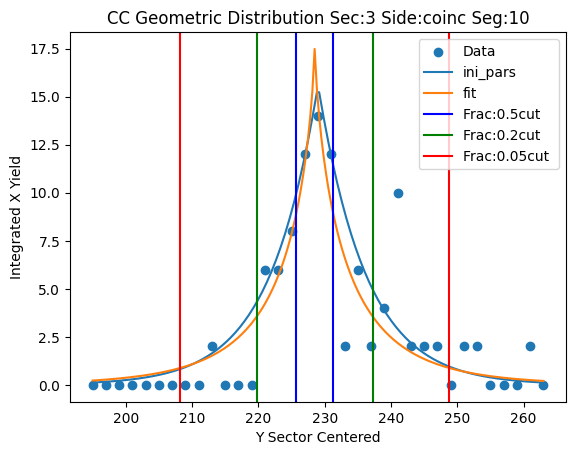

Parameters for Sec:3 Side:coinc Seg:11
test pars [ 17.71207629 239.           4.27169182   0.74338073]
fit pars [8.77852632e+00 2.39000001e+02 1.96458212e+00 1.55813012e-01]



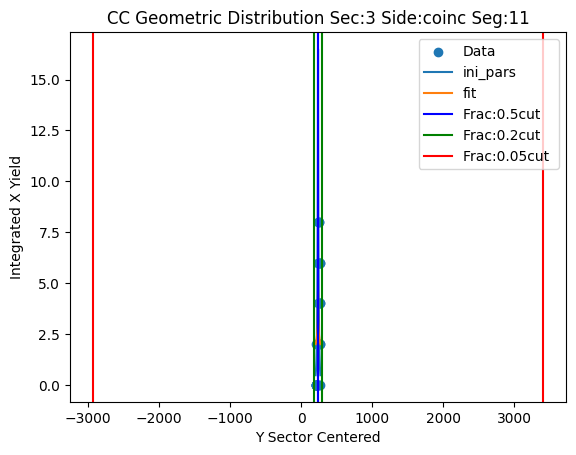

Parameters for Sec:3 Side:coinc Seg:12
test pars [8.77852632e+00 2.67000000e+02 2.96458212e+00 1.55813012e-01]
fit pars [4.32527533e+02 2.66675361e+02 1.80607163e-08 9.44559865e-02]



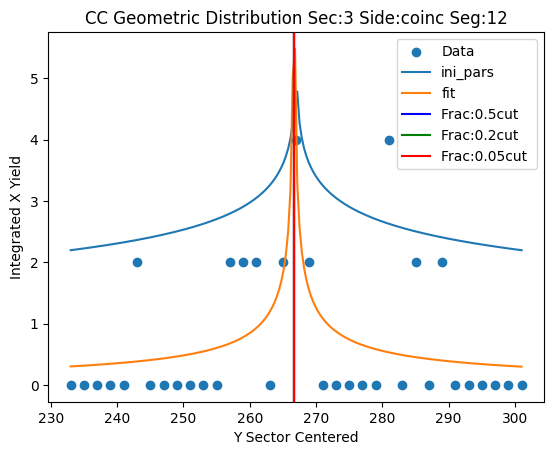

Parameters for Sec:3 Side:coinc Seg:13
test pars [4.32527533e+02 2.99000000e+02 1.00000002e+00 9.44559865e-02]
fit pars [220.33960102 299.90299754   0.32744422   1.7948879 ]



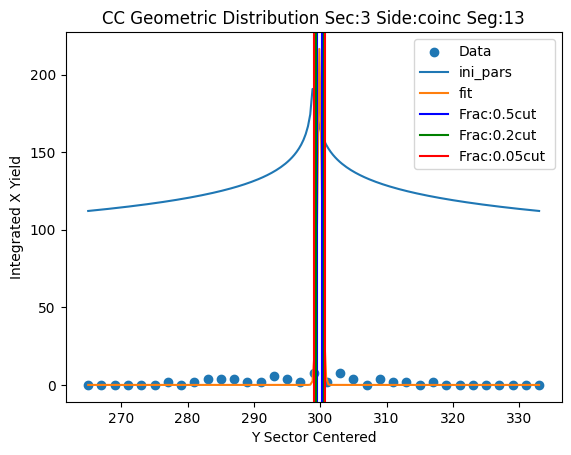

Parameters for Sec:3 Side:coinc Seg:14
test pars [220.33960102 321.           1.32744422   1.7948879 ]
fit pars [  4.86293527 320.66572405   1.59356347   0.85038447]



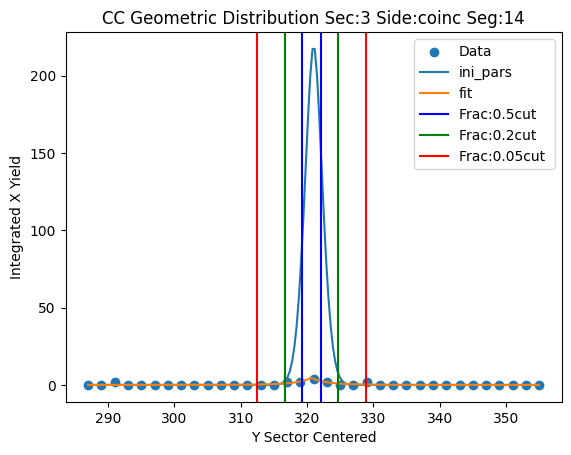

Parameters for Sec:3 Side:left Seg:1
test pars [19. 83. 13.  5.]
fit pars [17.11060565 87.80280914 10.07715665 16.14874108]



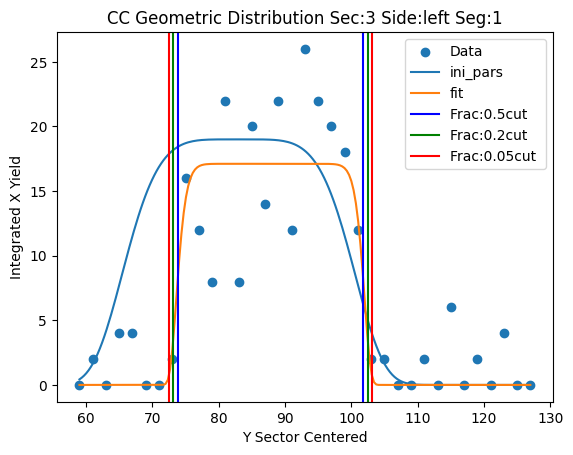

Parameters for Sec:3 Side:left Seg:2
test pars [ 17.11060565 107.          11.07715665  16.14874108]
fit pars [113.96422596 105.43033299   4.97364488   2.48842543]



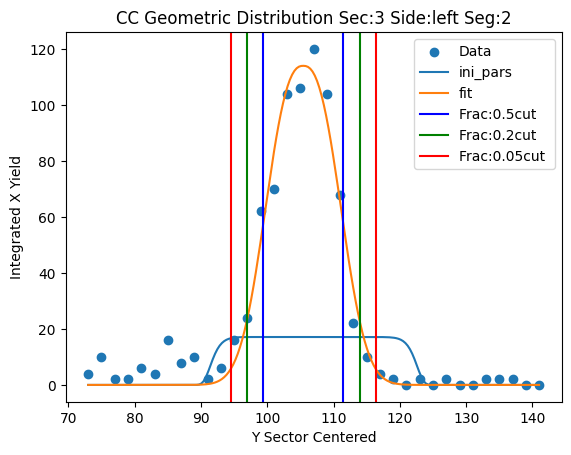

Parameters for Sec:3 Side:left Seg:3
test pars [113.96422596 117.           5.97364488   2.48842543]
fit pars [184.08204983 116.51621274   6.67220127   2.1918021 ]



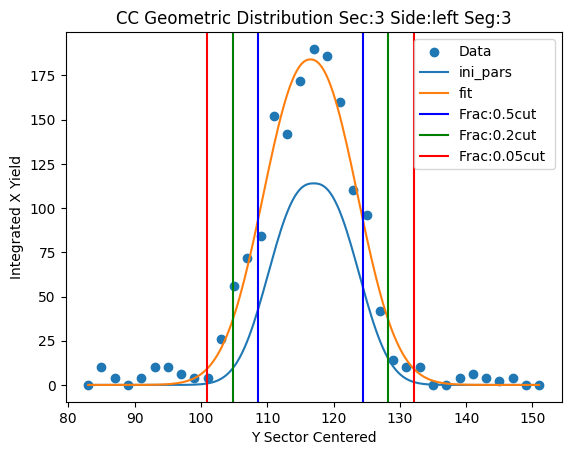

Parameters for Sec:3 Side:left Seg:4
test pars [184.08204983 131.           7.67220127   2.1918021 ]
fit pars [203.80596114 130.50930361   6.79562431   2.22527921]



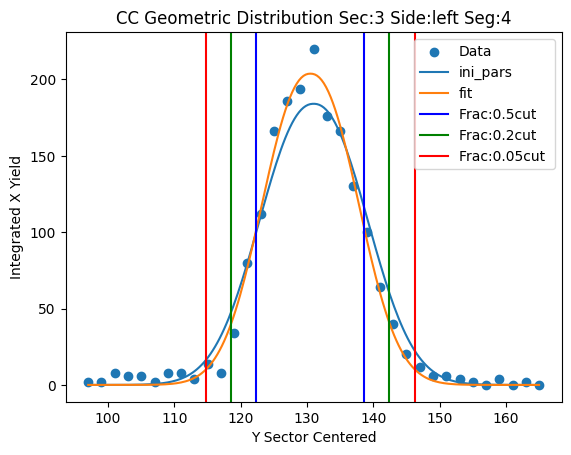

Parameters for Sec:3 Side:left Seg:5
test pars [203.80596114 143.           7.79562431   2.22527921]
fit pars [175.08475352 146.73199685   7.64529376   2.51628422]



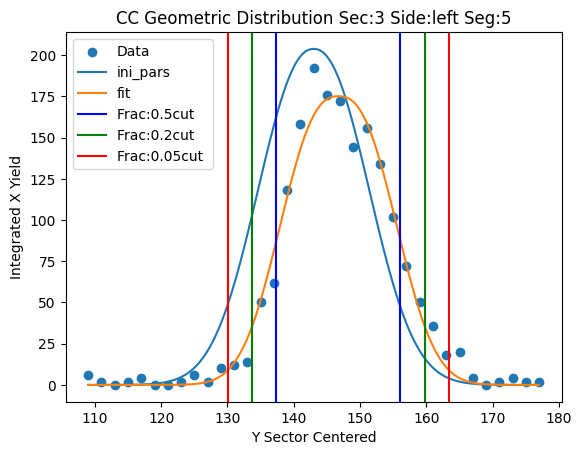

Parameters for Sec:3 Side:left Seg:6
test pars [175.08475352 163.           8.64529376   2.51628422]
fit pars [154.32463373 163.59440856   7.53954348   3.58865804]



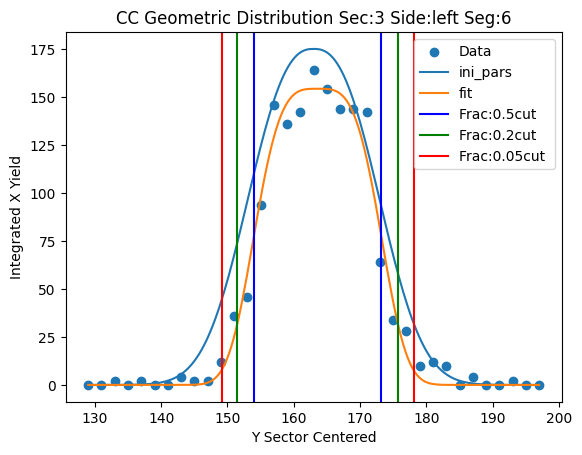

Parameters for Sec:3 Side:left Seg:7
test pars [154.32463373 179.           8.53954348   3.58865804]
fit pars [182.33906899 180.25237574   7.52203016   1.86841243]



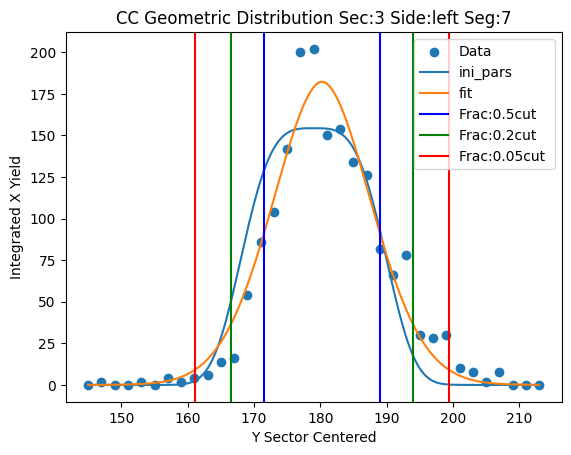

Parameters for Sec:3 Side:left Seg:8
test pars [182.33906899 199.           8.52203016   1.86841243]
fit pars [144.05571092 199.55454593   7.97232001   2.34910742]



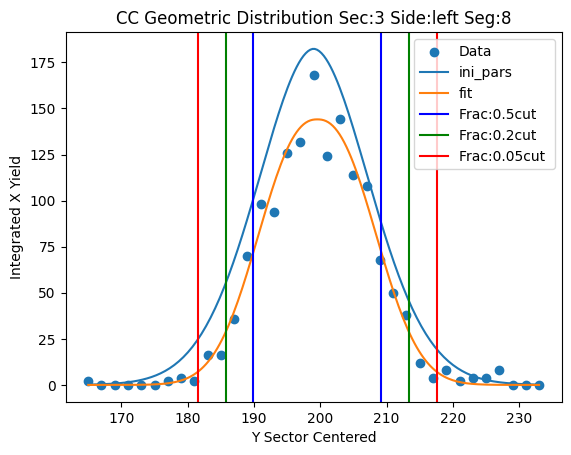

Parameters for Sec:3 Side:left Seg:9
test pars [144.05571092 215.           8.97232001   2.34910742]
fit pars [100.9597031  215.2625536    5.83693739   2.42298324]



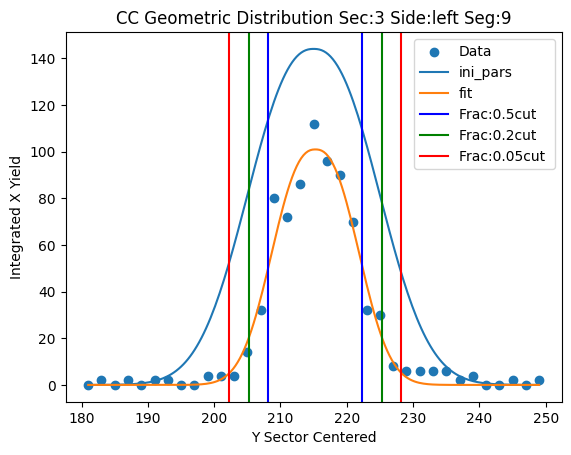

Parameters for Sec:3 Side:left Seg:10
test pars [100.9597031  227.           6.83693739   2.42298324]
fit pars [111.27783096 229.28564981   5.60839132   1.22609309]



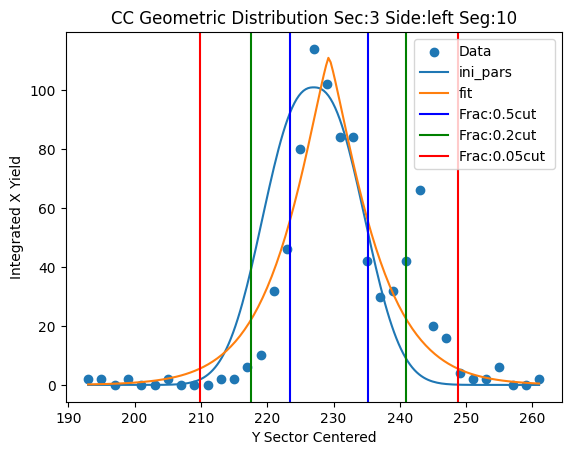

Parameters for Sec:3 Side:left Seg:11
test pars [111.27783096 249.           6.60839132   1.22609309]
fit pars [ 72.37684105 249.78133713  10.15443756   1.52356261]



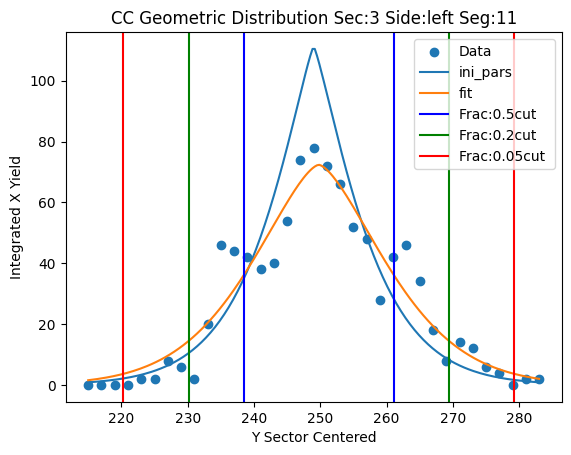

Parameters for Sec:3 Side:left Seg:12
test pars [ 72.37684105 271.          11.15443756   1.52356261]
fit pars [ 63.05939823 271.36457657   9.45486087   2.08295262]



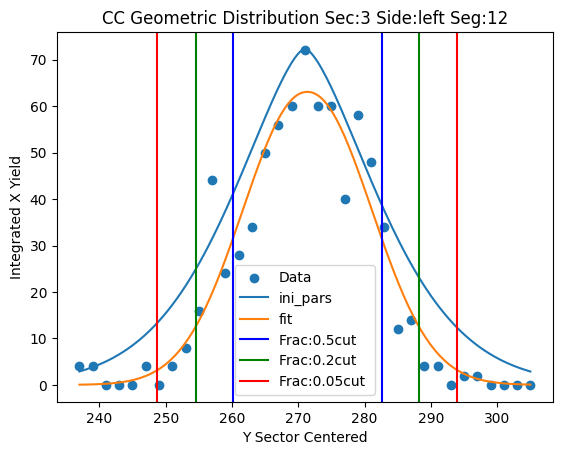

Parameters for Sec:3 Side:left Seg:13
test pars [ 63.05939823 289.          10.45486087   2.08295262]
fit pars [ 54.18148524 292.56676781  10.11013904   1.76016358]



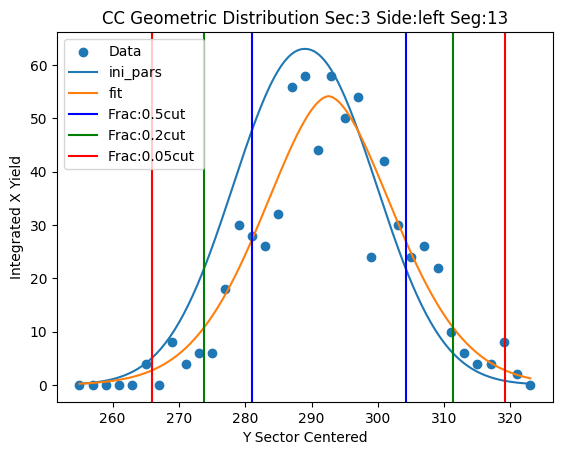

Parameters for Sec:3 Side:left Seg:14
test pars [ 54.18148524 325.          11.11013904   1.76016358]
fit pars [ 34.4339117  318.82077581  10.3993075    4.02858709]



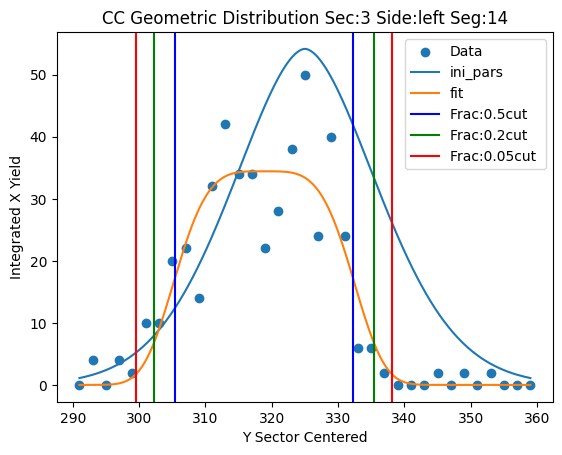

Parameters for Sec:3 Side:left Seg:15
test pars [ 34.4339117  335.          11.3993075    4.02858709]
fit pars [ 26.81931128 341.13886115   8.15758632   9.94612957]



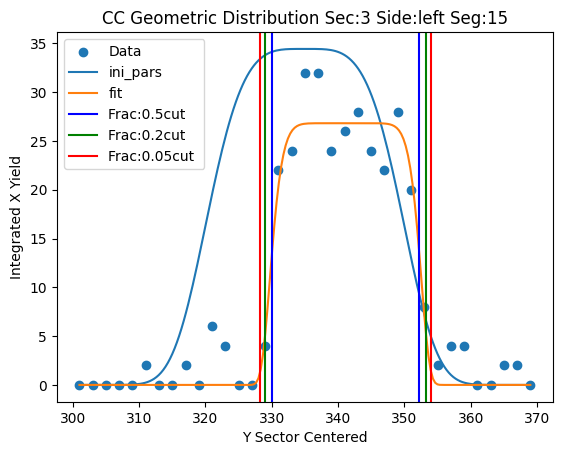

Parameters for Sec:3 Side:left Seg:16
test pars [ 26.81931128 353.           9.15758632   9.94612957]
fit pars [ 22.71867006 361.69658023   8.97076548   3.42961588]



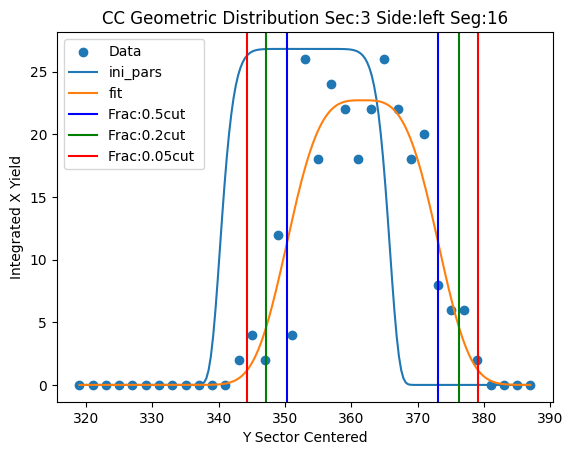

Parameters for Sec:3 Side:left Seg:17
test pars [ 22.71867006 383.           9.97076548   3.42961588]
fit pars [ 16.9641128  379.15554228   6.88535199   3.99876241]



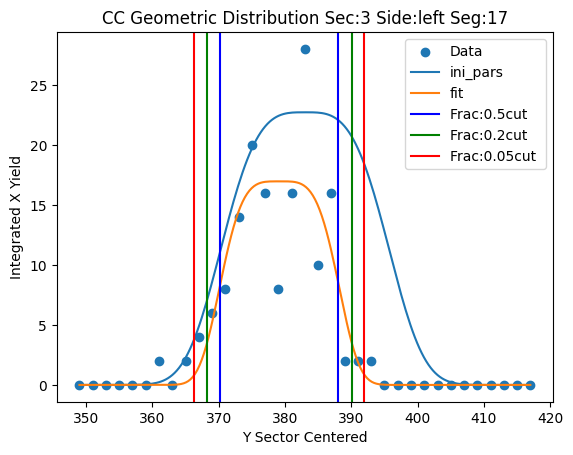

Parameters for Sec:3 Side:left Seg:18
test pars [ 16.9641128  395.           7.88535199   3.99876241]
fit pars [  2.00000058 388.44461691   5.90279492  96.9321234 ]



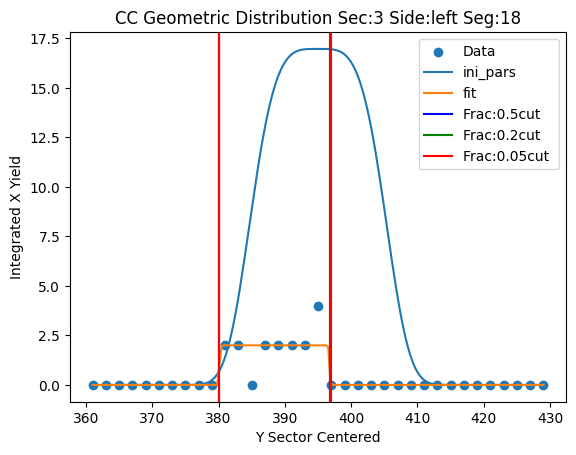

Parameters for Sec:4 Side:right Seg:1
test pars [83. 82. 10.  3.]
fit pars [74.39009646 81.52425396 11.32782617  5.46342018]



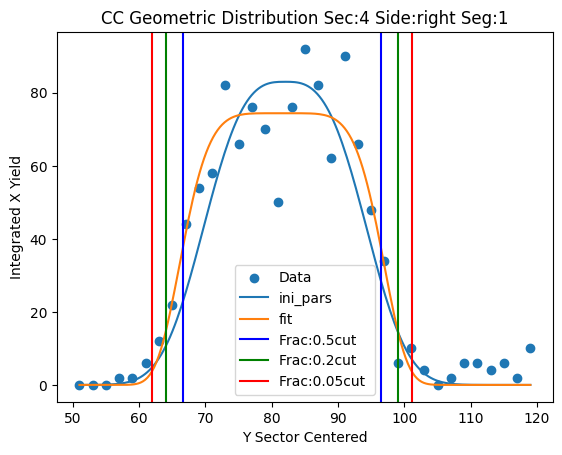

Parameters for Sec:4 Side:right Seg:2
test pars [ 74.39009646 107.          12.32782617   5.46342018]
fit pars [154.06784238 106.47324821   3.09078877   0.88853931]



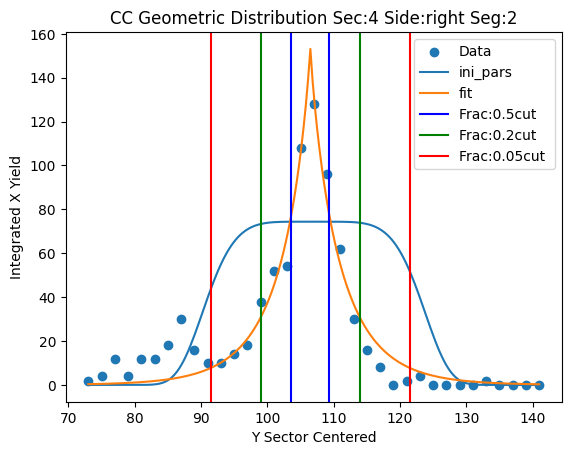

Parameters for Sec:4 Side:right Seg:3
test pars [154.06784238 121.           4.09078877   0.88853931]
fit pars [235.12489141 116.20746487   7.98096893   2.0244326 ]



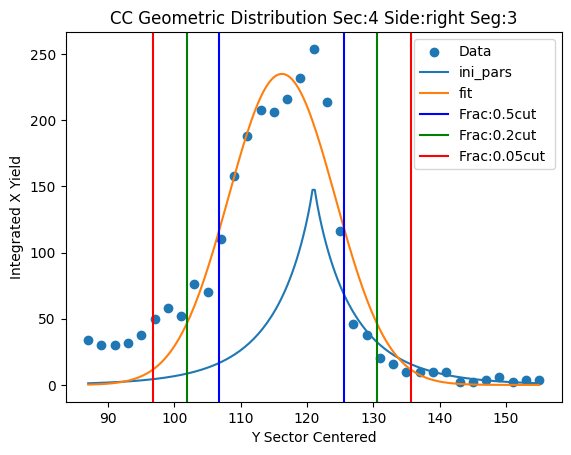

Parameters for Sec:4 Side:right Seg:4
test pars [235.12489141 129.           8.98096893   2.0244326 ]
fit pars [237.51436216 130.92093165   7.46311408   2.23356917]



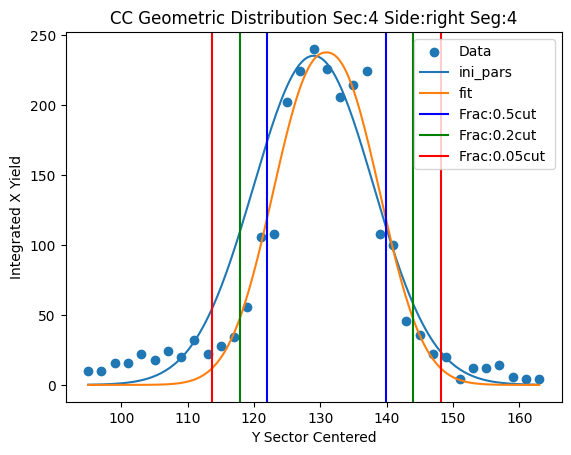

Parameters for Sec:4 Side:right Seg:5
test pars [237.51436216 145.           8.46311408   2.23356917]
fit pars [142.92727745 146.83697579   7.05529965   2.49360374]



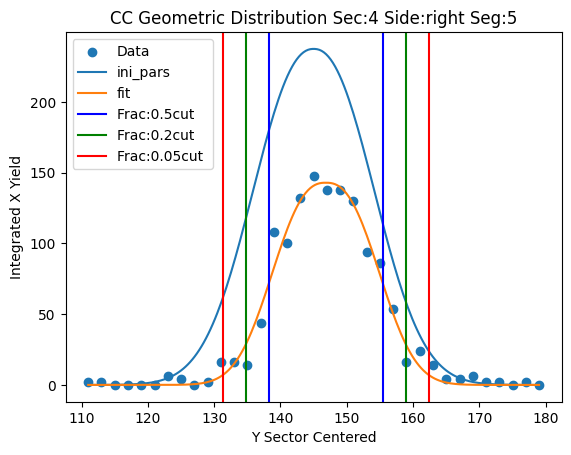

Parameters for Sec:4 Side:right Seg:6
test pars [142.92727745 159.           8.05529965   2.49360374]
fit pars [153.0346975  164.4196835    8.27418298   3.05999881]



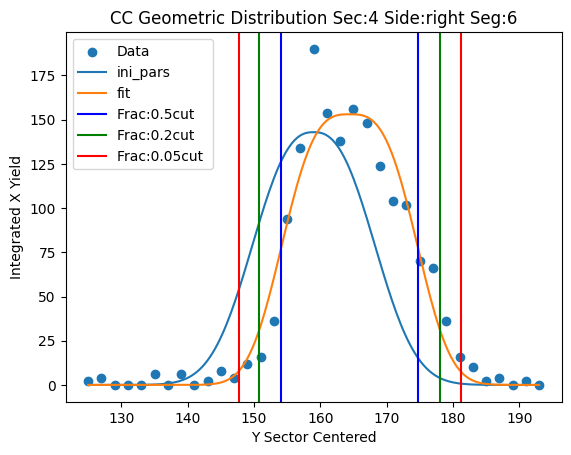

Parameters for Sec:4 Side:right Seg:7
test pars [153.0346975  185.           9.27418298   3.05999881]
fit pars [111.71217078 182.89531443   8.0217304    2.60151277]



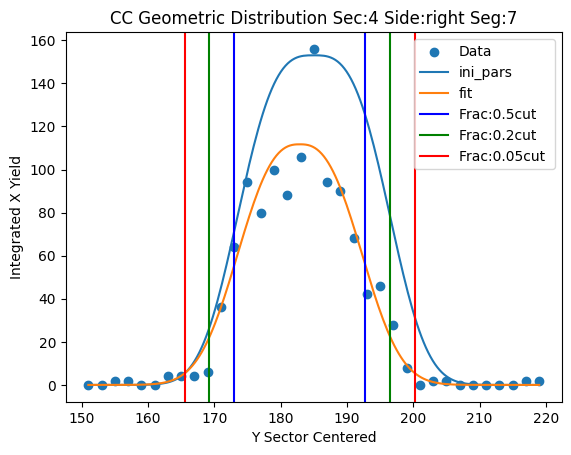

Parameters for Sec:4 Side:right Seg:8
test pars [111.71217078 203.           9.0217304    2.60151277]
fit pars [142.68693633 198.69361278   6.94765139   2.69272745]



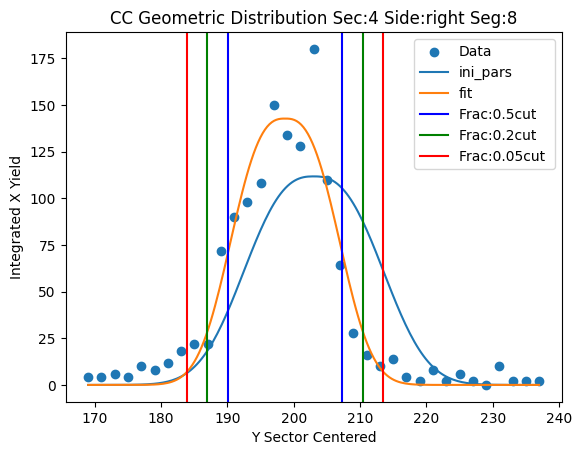

Parameters for Sec:4 Side:right Seg:9
test pars [142.68693633 211.           7.94765139   2.69272745]
fit pars [108.09664763 214.39373517   7.29074781   3.05567446]



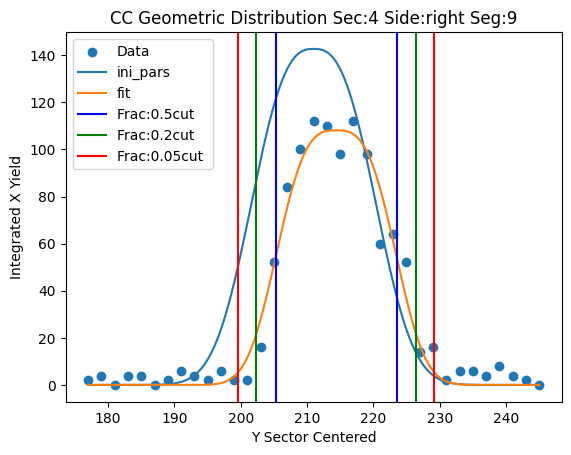

Parameters for Sec:4 Side:right Seg:10
test pars [108.09664763 227.           8.29074781   3.05567446]
fit pars [ 89.50759443 229.27709646   6.72212463   1.51744729]



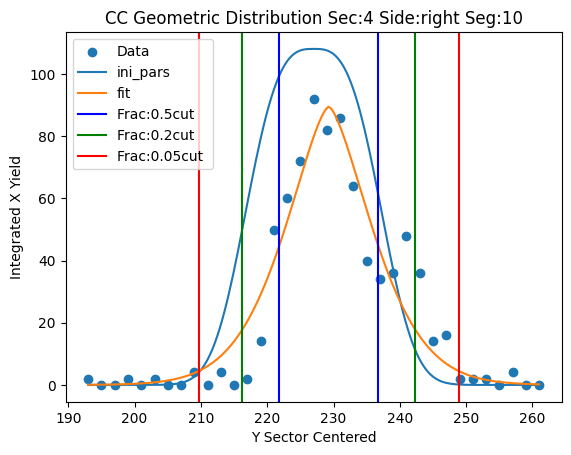

Parameters for Sec:4 Side:right Seg:11
test pars [ 89.50759443 251.           7.72212463   1.51744729]
fit pars [ 81.78781652 248.98235535   7.22290304   1.51963273]



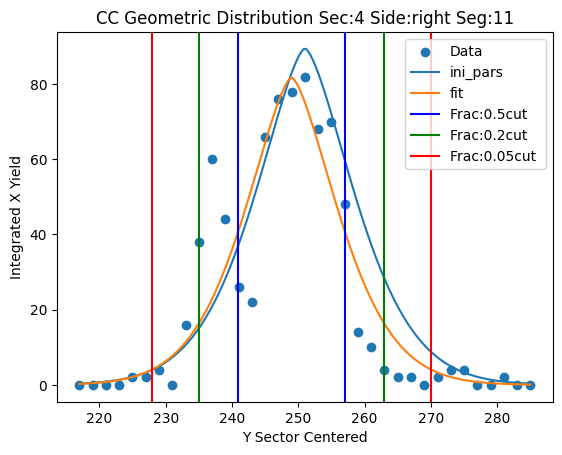

Parameters for Sec:4 Side:right Seg:12
test pars [ 81.78781652 265.           8.22290304   1.51963273]
fit pars [ 85.66018875 265.51158996   4.95340527   0.9342848 ]



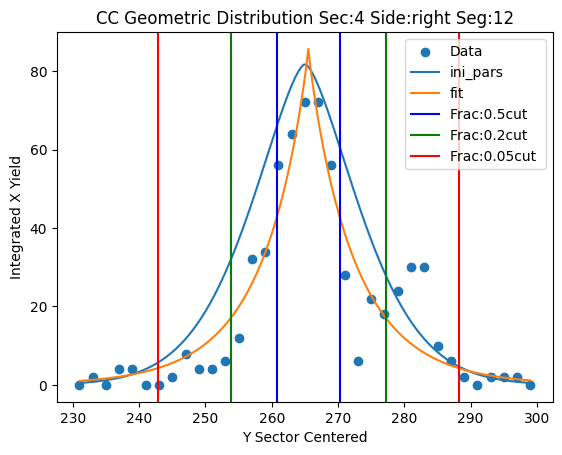

Parameters for Sec:4 Side:right Seg:13
test pars [ 85.66018875 275.           5.95340527   0.9342848 ]
fit pars [ 35.47979789 285.88616448  12.26676839   6.80426708]



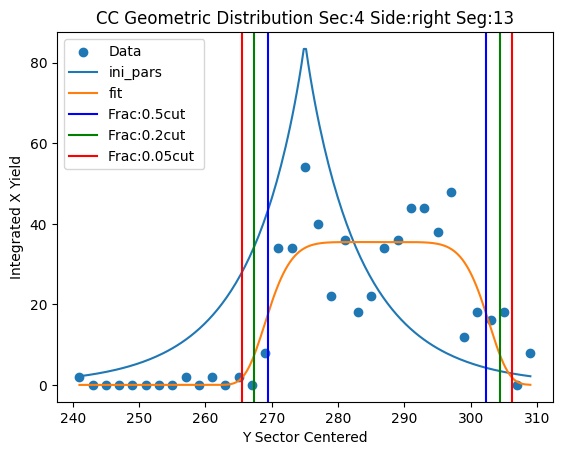

Parameters for Sec:4 Side:right Seg:14
test pars [ 35.47979789 305.          13.26676839   6.80426708]
fit pars [ 25.0144709  313.60853812  11.34046809   3.61906041]



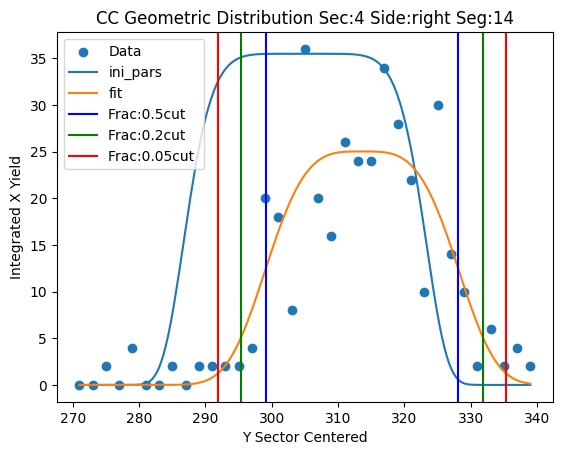

Parameters for Sec:4 Side:right Seg:15
test pars [ 25.0144709  335.          12.34046809   3.61906041]
fit pars [ 48.65806322 335.37205831   3.17954374   0.61284353]



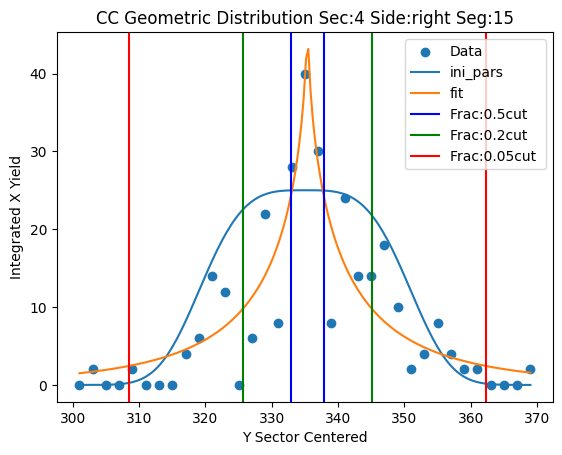

Parameters for Sec:4 Side:right Seg:16
test pars [ 48.65806322 365.           4.17954374   0.61284353]
fit pars [ 25.70194151 365.8903105    6.20669715   0.961714  ]



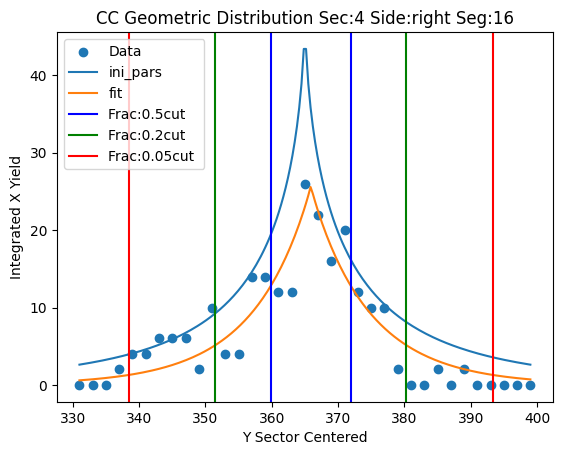

Parameters for Sec:4 Side:right Seg:17
test pars [ 25.70194151 381.           7.20669715   0.961714  ]
fit pars [ 13.38343742 379.46334439   7.61114876   2.03145573]



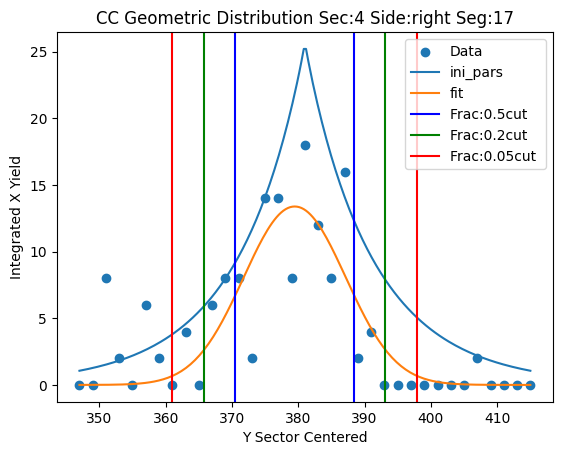

Parameters for Sec:4 Side:right Seg:18
test pars [ 13.38343742 375.           8.61114876   2.03145573]
fit pars [4.16139114e+00 3.74999999e+02 6.12121802e+00 3.12042819e-01]



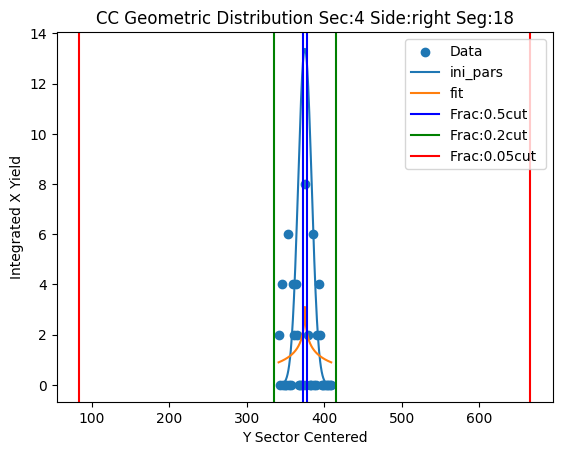

Parameters for Sec:4 Side:coinc Seg:1
test pars [40. 97. 19.  6.]
fit pars [ 24.77777783  84.02653967  13.4244236  159.85617416]



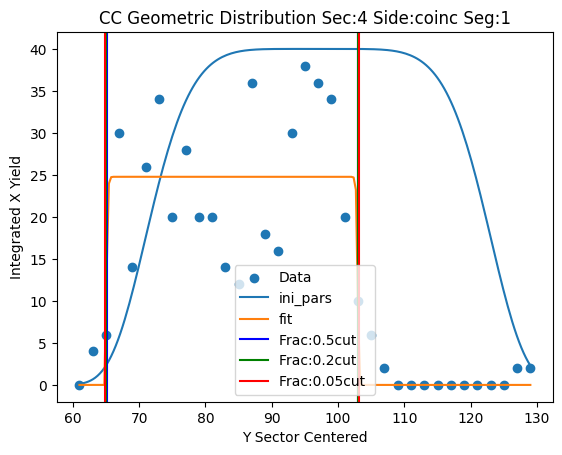

Parameters for Sec:4 Side:coinc Seg:2
test pars [ 24.77777783 105.          14.4244236  159.85617416]
fit pars [ 62.00000038 103.01170428   8.4509886   98.71758963]



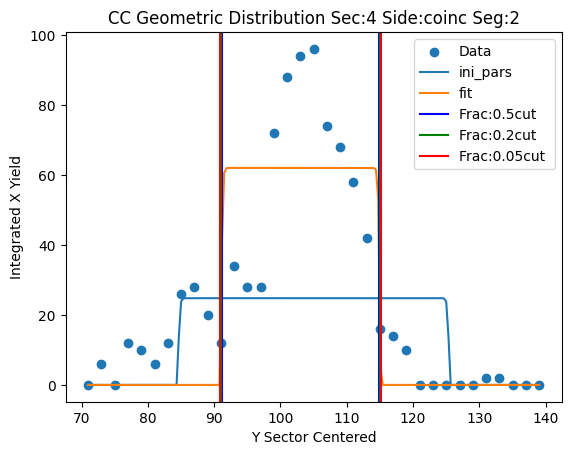

Parameters for Sec:4 Side:coinc Seg:3
test pars [ 62.00000038 117.           9.4509886   98.71758963]
fit pars [ 92.17817835 117.7452036    4.8763698    1.1657551 ]



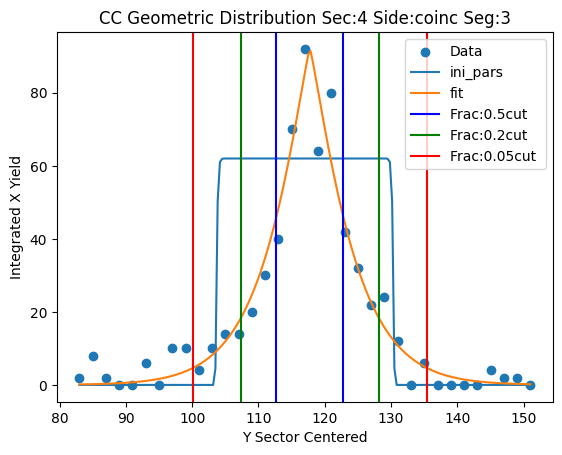

Parameters for Sec:4 Side:coinc Seg:4
test pars [ 92.17817835 131.           5.8763698    1.1657551 ]
fit pars [ 36.31819823 134.18681398   7.66257187   2.1379321 ]



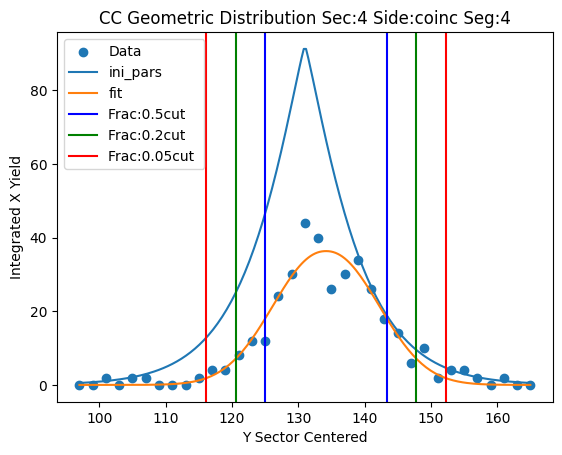

Parameters for Sec:4 Side:coinc Seg:5
test pars [ 36.31819823 147.           8.66257187   2.1379321 ]
fit pars [ 29.53228597 149.38253931   6.028512     1.66175362]



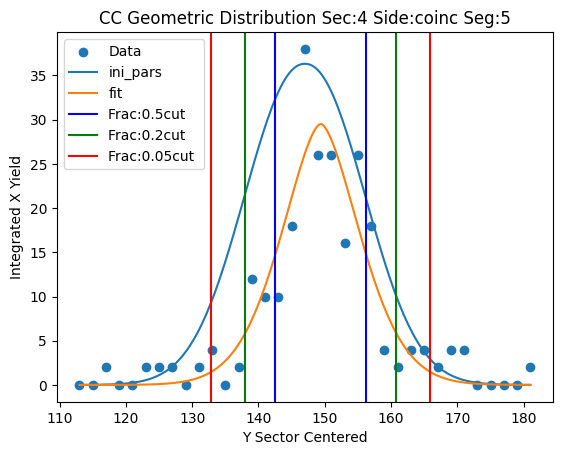

Parameters for Sec:4 Side:coinc Seg:6
test pars [ 29.53228597 161.           7.028512     1.66175362]
fit pars [ 13.97654035 167.2000644    9.84534591   3.56291122]



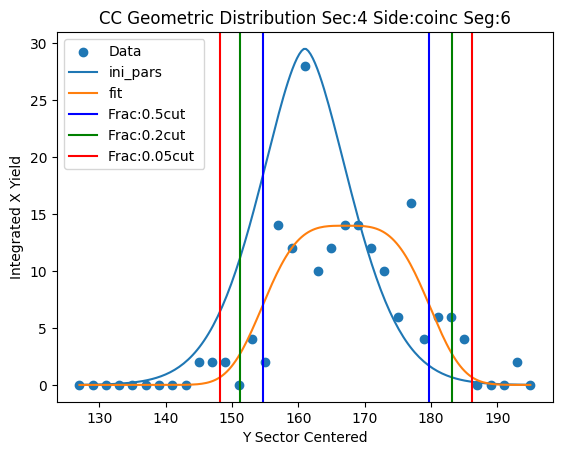

Parameters for Sec:4 Side:coinc Seg:7
test pars [ 13.97654035 181.          10.84534591   3.56291122]
fit pars [ 13.27575506 183.80509826   7.96435547   1.73694783]



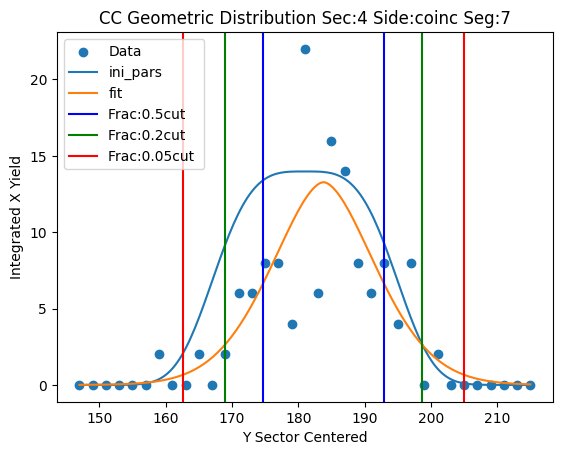

Parameters for Sec:4 Side:coinc Seg:8
test pars [ 13.27575506 203.           8.96435547   1.73694783]
fit pars [  6.24093866 202.39515096   9.95843365   2.41490957]



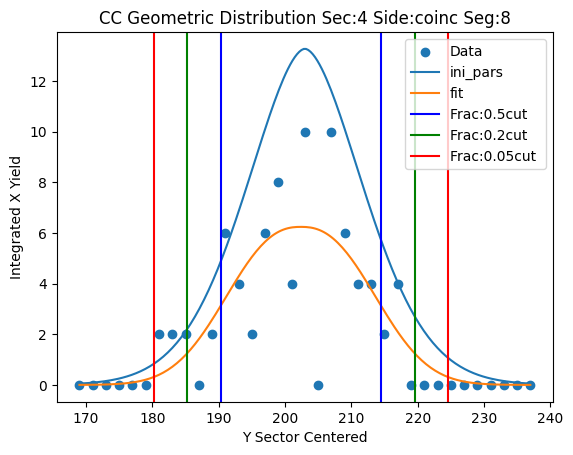

Parameters for Sec:4 Side:coinc Seg:9
test pars [  6.24093866 217.          10.95843365   2.41490957]
fit pars [ 14.02536924 217.7879157    2.90464431   0.77500563]



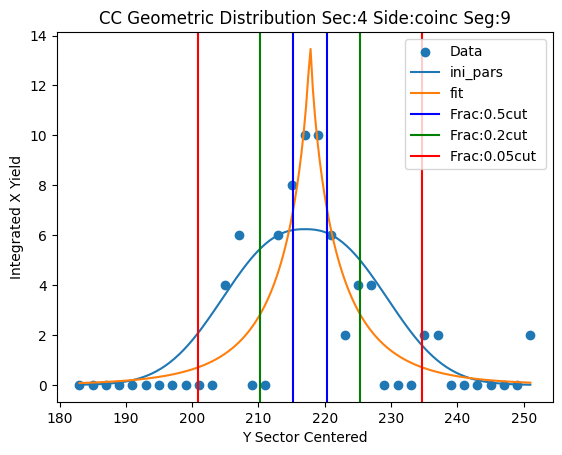

Parameters for Sec:4 Side:coinc Seg:10
test pars [ 14.02536924 229.           3.90464431   0.77500563]
fit pars [  4.73860197 234.45654801   8.38682847   3.45320855]



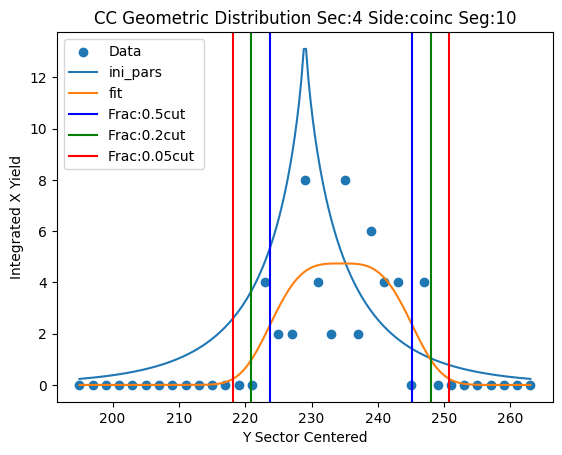

Parameters for Sec:4 Side:coinc Seg:11
test pars [  4.73860197 249.           9.38682847   3.45320855]
fit pars [  5.0210211  248.99999876   4.26012528   0.78755227]



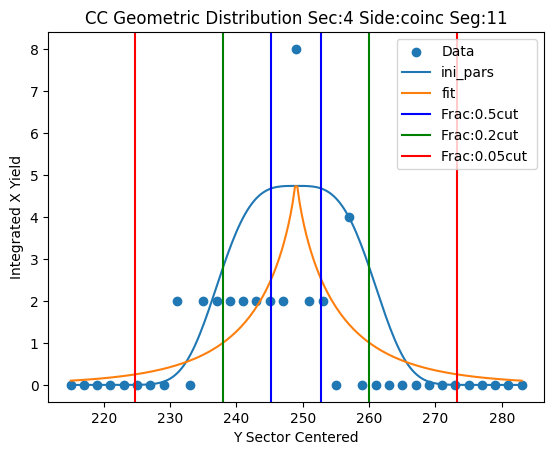

Parameters for Sec:4 Side:coinc Seg:12
test pars [  5.0210211  281.           5.26012528   0.78755227]
fit pars [  3.52913442 280.99999954   3.71813779   0.41771638]



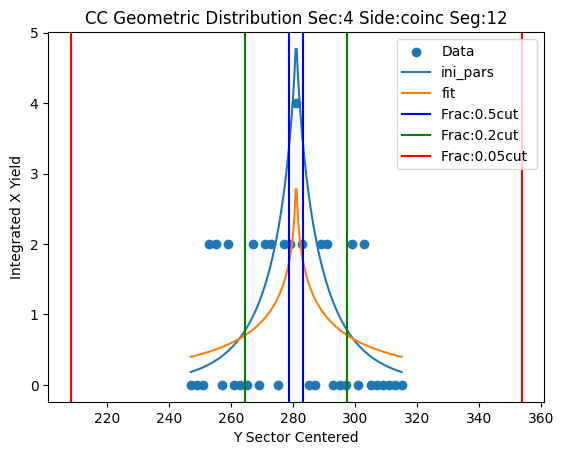

Parameters for Sec:4 Side:coinc Seg:13
test pars [  3.52913442 279.           4.71813779   0.41771638]
fit pars [2.34206680e+00 2.78999974e+02 3.55784035e+00 1.89071321e-01]



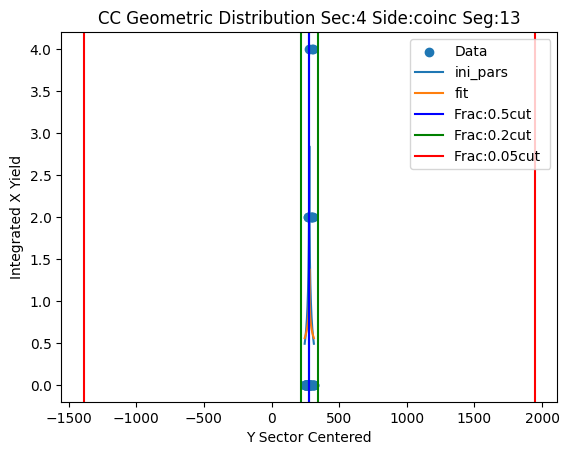

Parameters for Sec:4 Side:coinc Seg:14
test pars [2.34206680e+00 3.11000000e+02 4.55784035e+00 1.89071321e-01]
fit pars [2.34206680e+00 3.11000000e+02 4.55784035e+00 1.89071321e-01]



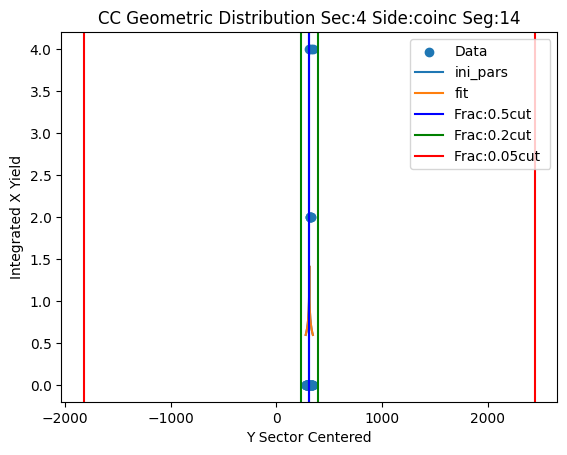

Parameters for Sec:4 Side:coinc Seg:15
test pars [2.34206680e+00 3.43000000e+02 5.55784035e+00 1.89071321e-01]
fit pars [  1.92111271 342.99999868   5.08108444   0.63388087]



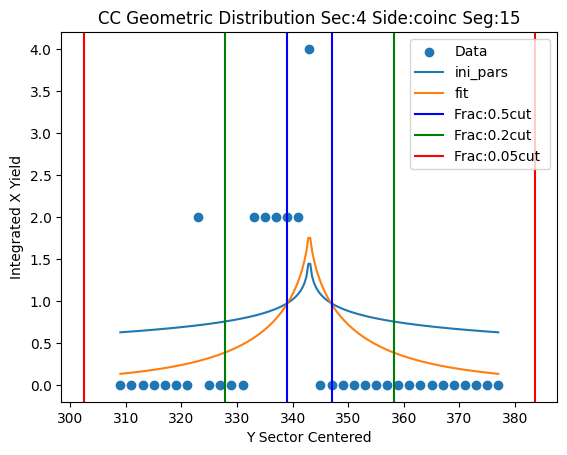

Parameters for Sec:4 Side:left Seg:1
test pars [19. 83. 13.  5.]
fit pars [22.96977308 85.07130761 13.85976902  6.78533414]



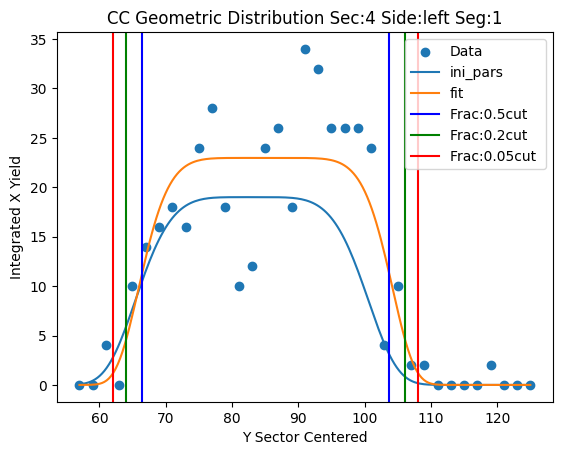

Parameters for Sec:4 Side:left Seg:2
test pars [ 22.96977308 107.          14.85976902   6.78533414]
fit pars [142.20468274 105.97745689   5.14534503   1.76970562]



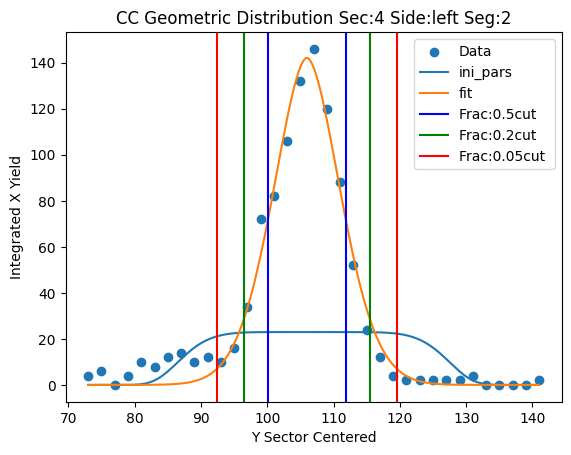

Parameters for Sec:4 Side:left Seg:3
test pars [142.20468274 119.           6.14534503   1.76970562]
fit pars [209.95926173 118.2373029    6.25089352   2.45749375]



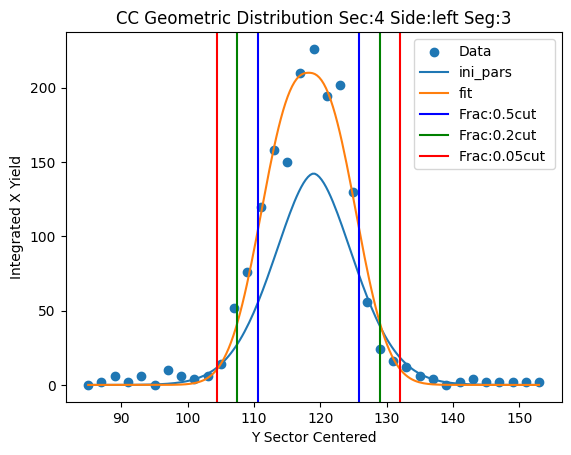

Parameters for Sec:4 Side:left Seg:4
test pars [209.95926173 131.           7.25089352   2.45749375]
fit pars [220.83374244 132.29310223   6.61671468   2.36521346]



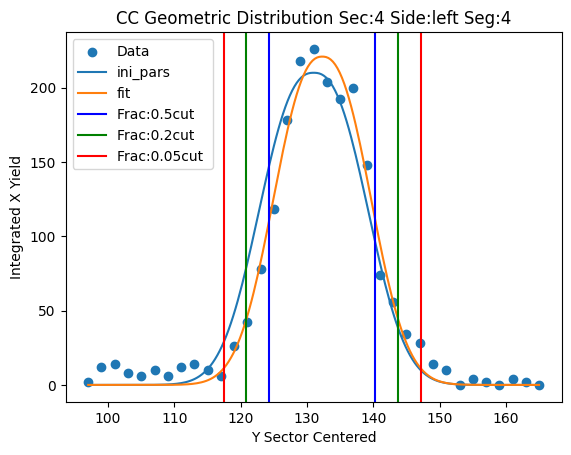

Parameters for Sec:4 Side:left Seg:5
test pars [220.83374244 143.           7.61671468   2.36521346]
fit pars [177.91039737 147.69886367   7.4528868    3.36986668]



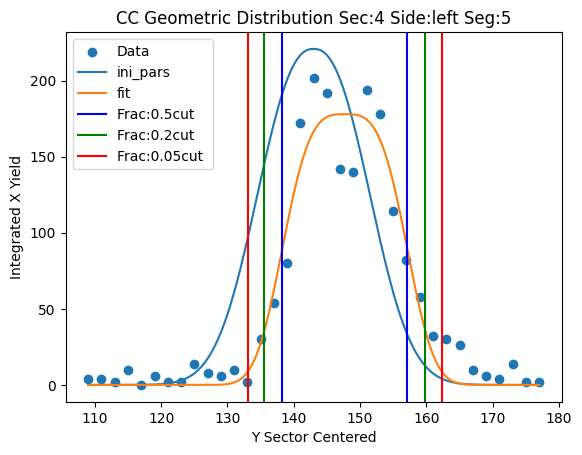

Parameters for Sec:4 Side:left Seg:6
test pars [177.91039737 167.           8.4528868    3.36986668]
fit pars [182.65863837 165.19198637   7.28575474   2.03020465]



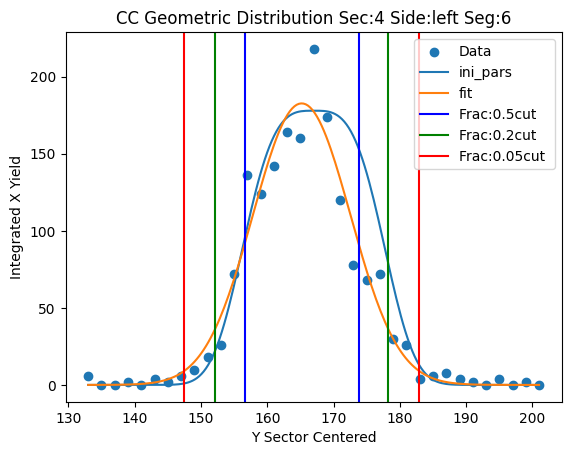

Parameters for Sec:4 Side:left Seg:7
test pars [182.65863837 185.           8.28575474   2.03020465]
fit pars [148.04439451 182.7870861    8.15202156   2.65722833]



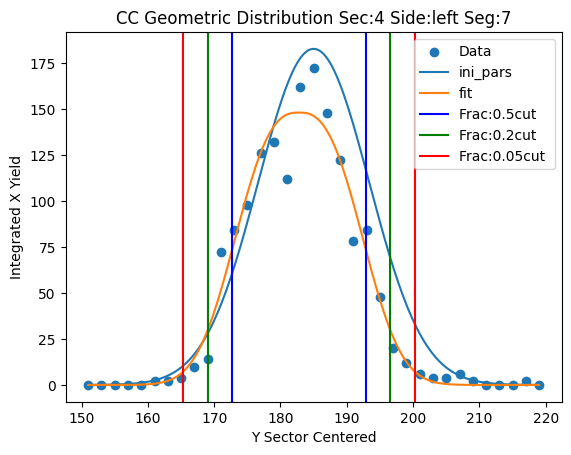

Parameters for Sec:4 Side:left Seg:8
test pars [148.04439451 199.           9.15202156   2.65722833]
fit pars [138.55546398 200.38721197   6.79398351   1.81941167]



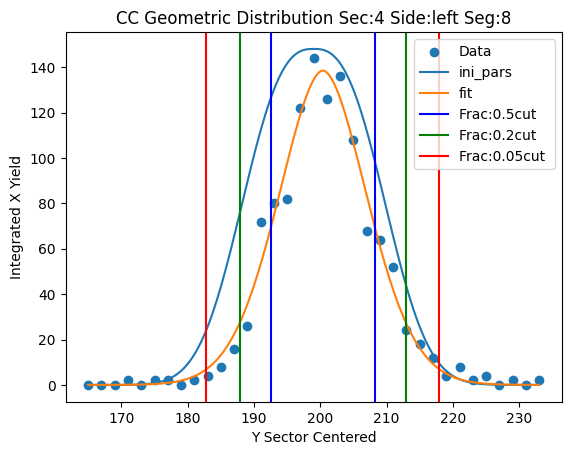

Parameters for Sec:4 Side:left Seg:9
test pars [138.55546398 219.           7.79398351   1.81941167]
fit pars [156.38796386 217.33618308   4.95128727   1.48613917]



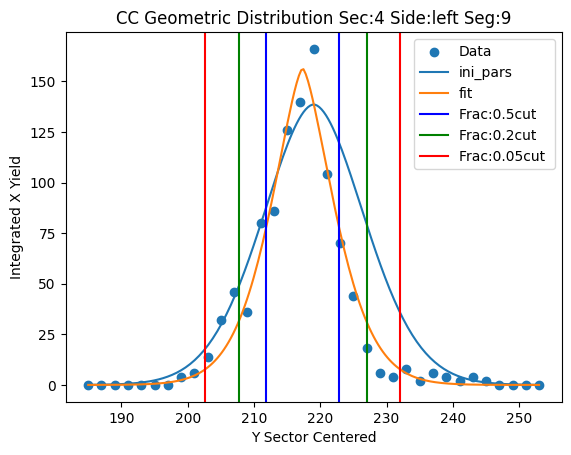

Parameters for Sec:4 Side:left Seg:10
test pars [156.38796386 229.           5.95128727   1.48613917]
fit pars [104.03435558 230.40688761   4.50884113   0.93804116]



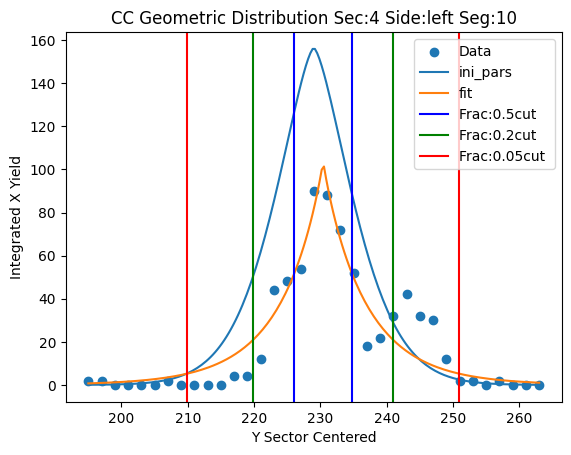

Parameters for Sec:4 Side:left Seg:11
test pars [104.03435558 251.           5.50884113   0.93804116]
fit pars [ 60.44401381 248.02847353   9.91441018   6.16779549]



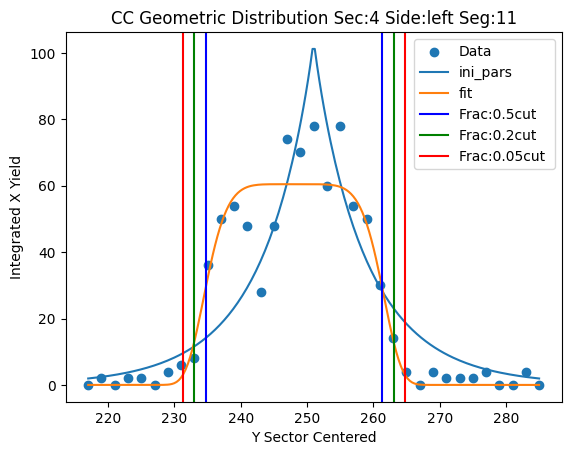

Parameters for Sec:4 Side:left Seg:12
test pars [ 60.44401381 265.          10.91441018   6.16779549]
fit pars [ 54.74089526 267.45299462   8.32864626   1.3211815 ]



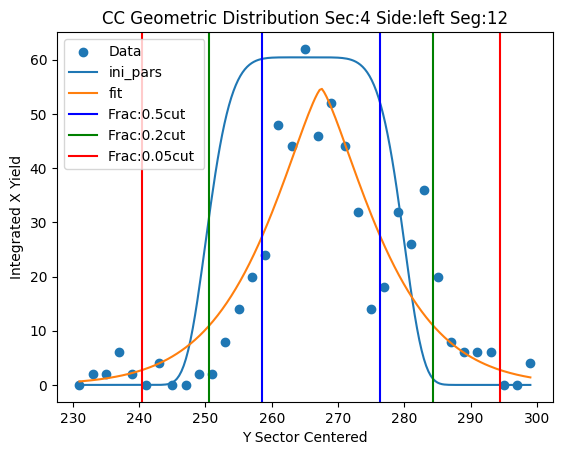

Parameters for Sec:4 Side:left Seg:13
test pars [ 54.74089526 277.           9.32864626   1.3211815 ]
fit pars [ 37.46338414 289.44010434  13.64729746   7.22068386]



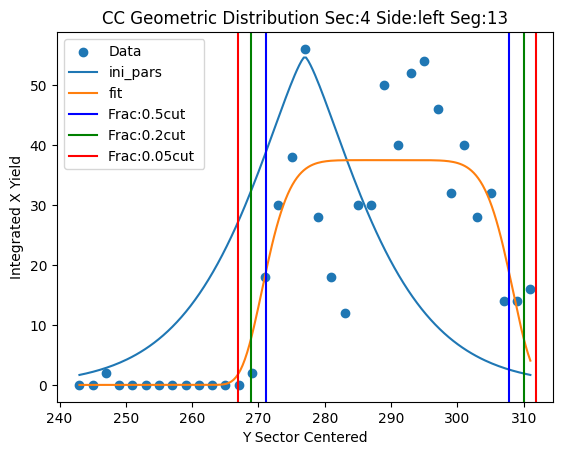

Parameters for Sec:4 Side:left Seg:14
test pars [ 37.46338414 311.          14.64729746   7.22068386]
fit pars [ 47.77295925 315.27906721   7.50936088   1.30739198]



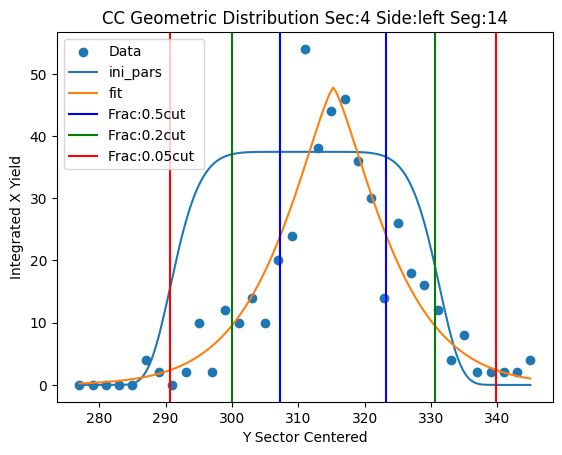

Parameters for Sec:4 Side:left Seg:15
test pars [ 47.77295925 337.           8.50936088   1.30739198]
fit pars [ 23.56260869 339.18285009  11.32244103   2.17006423]



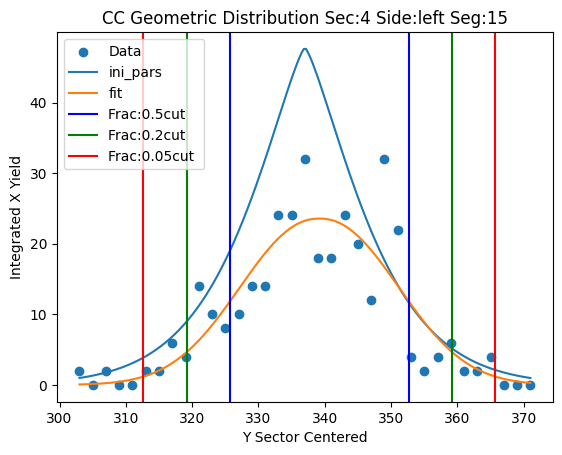

Parameters for Sec:4 Side:left Seg:16
test pars [ 23.56260869 357.          12.32244103   2.17006423]
fit pars [ 16.47064236 364.37414951   9.00369422  12.75803323]



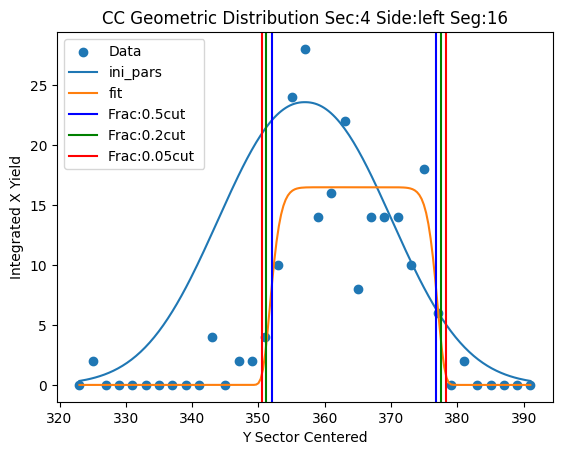

Parameters for Sec:4 Side:left Seg:17
test pars [ 16.47064236 383.          10.00369422  12.75803323]
fit pars [ 24.81489909 382.58932358   2.07334622   0.60263834]



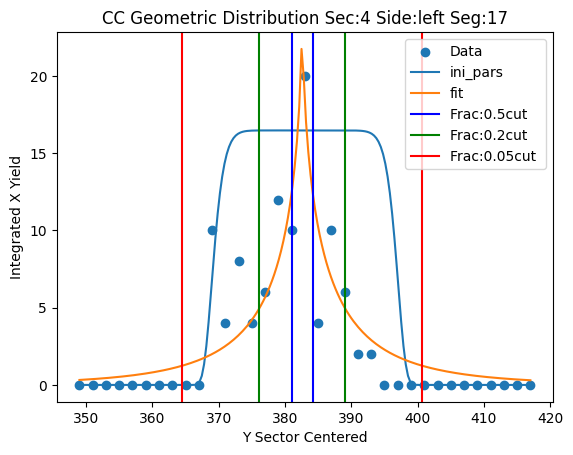

Parameters for Sec:4 Side:left Seg:18
test pars [ 24.81489909 115.           3.07334622   0.60263834]
fit pars [  3.55533241 115.22860262   0.22331323   1.71077724]



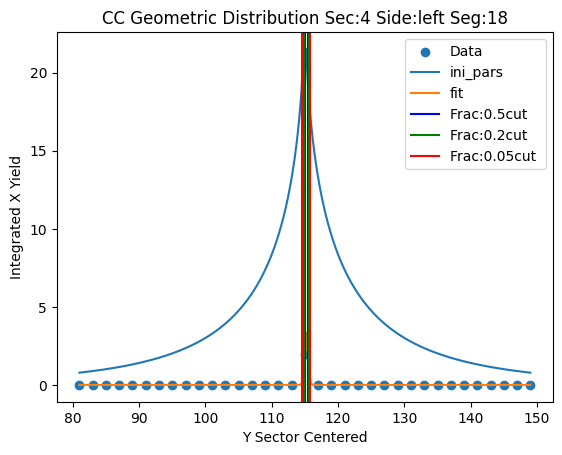

Parameters for Sec:5 Side:right Seg:1
test pars [83. 82. 10.  3.]
fit pars [75.21046219 98.99999934  3.63185952  0.73110063]



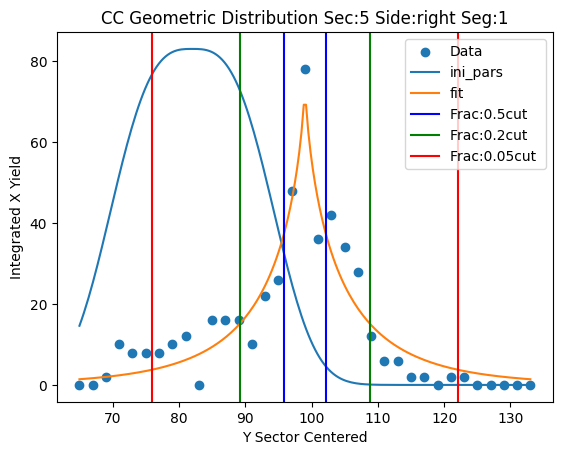

Parameters for Sec:5 Side:right Seg:2
test pars [ 75.21046219 109.           4.63185952   0.73110063]
fit pars [ 38.86364802 107.35156359   3.71279051   2.74885028]



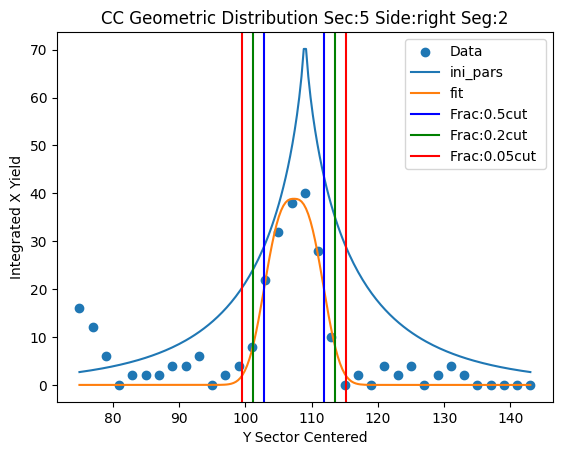

Parameters for Sec:5 Side:right Seg:3
test pars [ 38.86364802 125.           4.71279051   2.74885028]
fit pars [205.45467795 125.16575014   7.79215476   1.98658865]



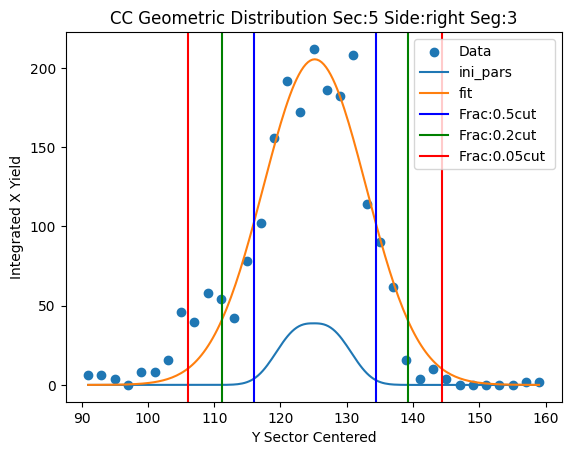

Parameters for Sec:5 Side:right Seg:4
test pars [205.45467795 137.           8.79215476   1.98658865]
fit pars [3.56616466e+04 1.37862866e+02 4.46960888e-08 1.05626714e-01]



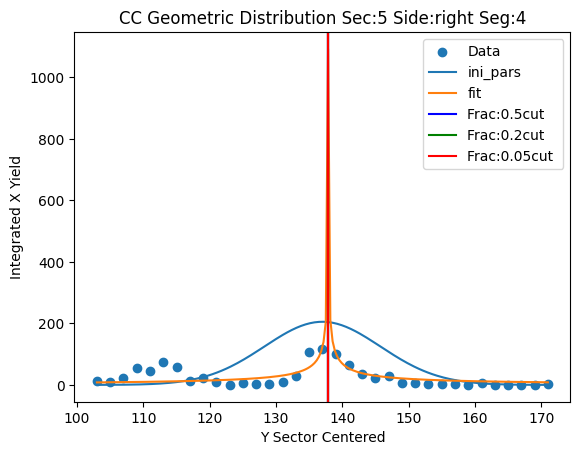

Parameters for Sec:5 Side:right Seg:5
test pars [3.56616466e+04 1.51000000e+02 1.00000004e+00 1.05626714e-01]
fit pars [2.07679208e+04 1.51991427e+02 3.61923206e-01 2.35618310e+00]



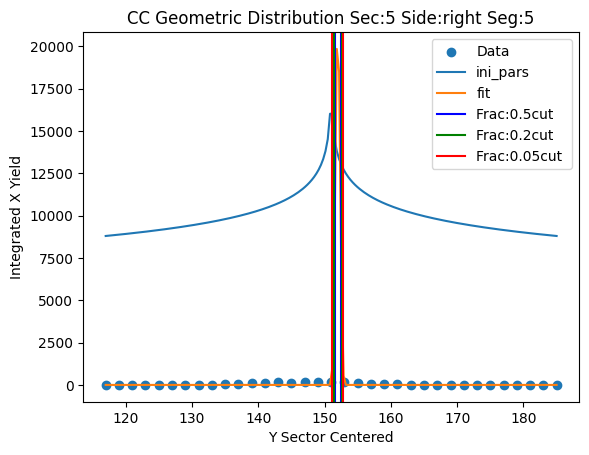

Parameters for Sec:5 Side:right Seg:6
test pars [2.07679208e+04 1.69000000e+02 1.36192321e+00 2.35618310e+00]
fit pars [136.         168.84912113   1.76211055  14.11575909]



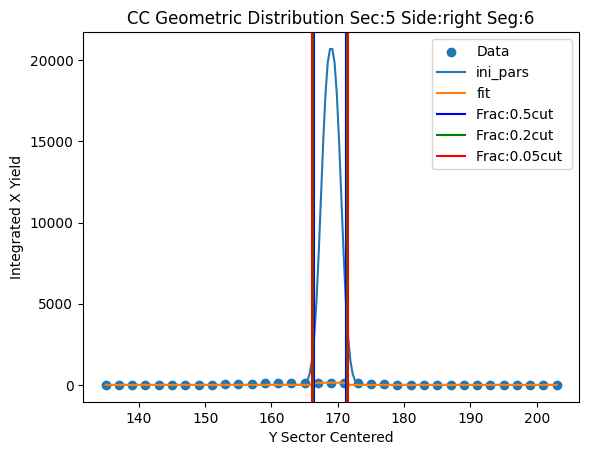

Parameters for Sec:5 Side:right Seg:7
test pars [136.         183.           2.76211055  14.11575909]
fit pars [139.00572126 183.29170458   6.99509206   2.02770889]



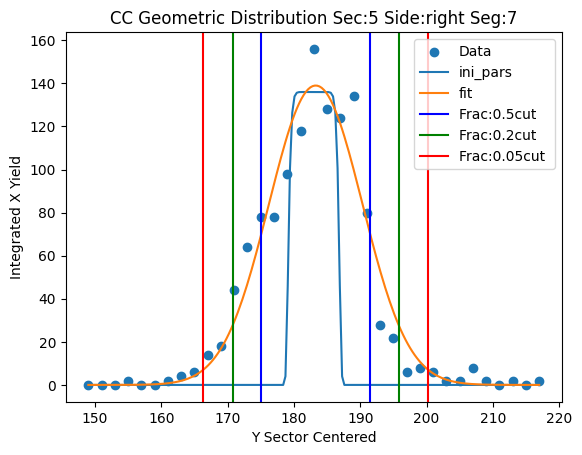

Parameters for Sec:5 Side:right Seg:8
test pars [139.00572126 197.           7.99509206   2.02770889]
fit pars [137.36034292 198.85231882   7.10182349   2.73652   ]



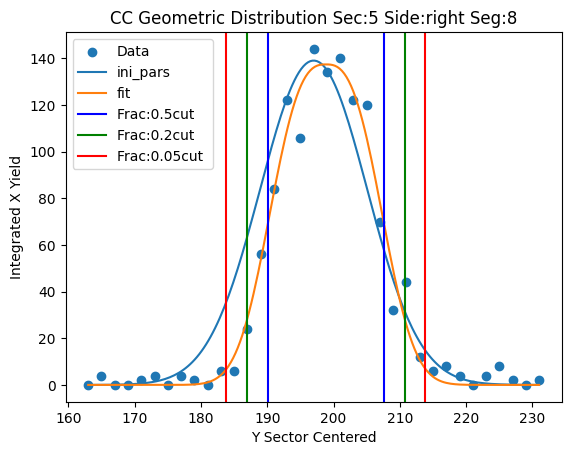

Parameters for Sec:5 Side:right Seg:9
test pars [137.36034292 213.           8.10182349   2.73652   ]
fit pars [127.43143402 216.30948105   6.74096193   1.28557927]



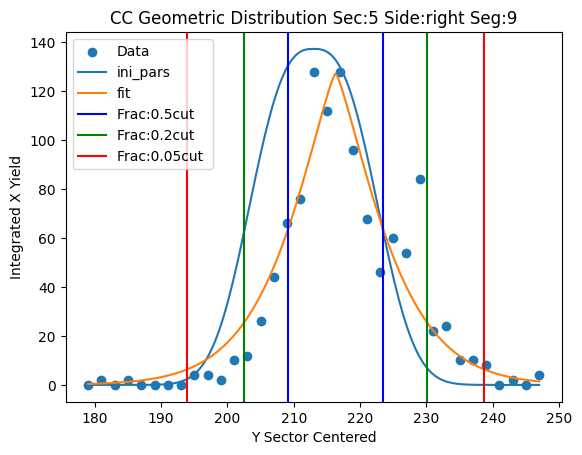

Parameters for Sec:5 Side:right Seg:10
test pars [127.43143402 237.           7.74096193   1.28557927]
fit pars [ 67.55240664 234.45919366   9.46359043   9.52971567]



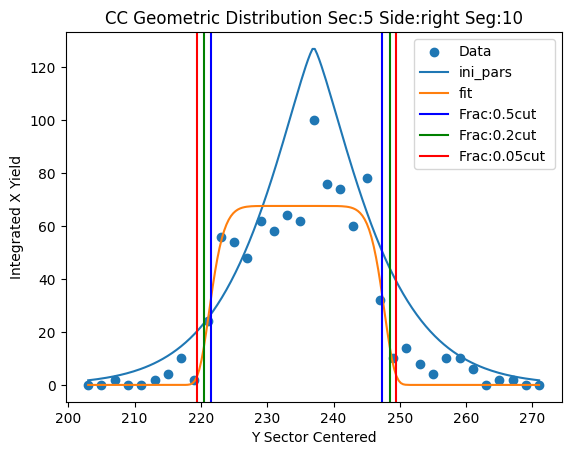

Parameters for Sec:5 Side:right Seg:11
test pars [ 67.55240664 255.          10.46359043   9.52971567]
fit pars [ 61.60814659 256.51491296   9.71048138   3.2322094 ]



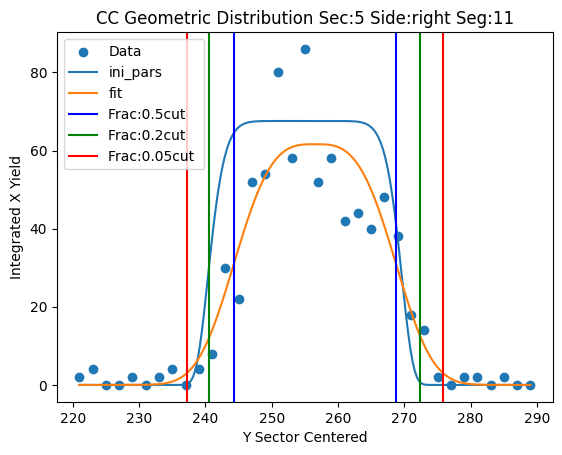

Parameters for Sec:5 Side:right Seg:12
test pars [ 61.60814659 277.          10.71048138   3.2322094 ]
fit pars [ 53.32606376 275.15560669   7.48787984   2.12847743]



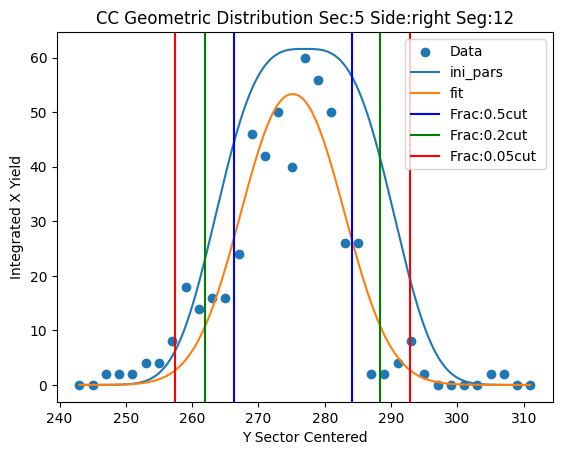

Parameters for Sec:5 Side:right Seg:13
test pars [ 53.32606376 295.           8.48787984   2.12847743]
fit pars [ 56.19152416 293.98829311   8.4052378    1.62287203]



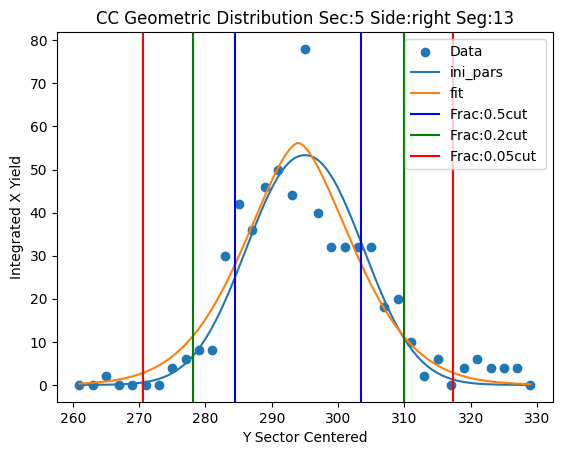

Parameters for Sec:5 Side:right Seg:14
test pars [ 56.19152416 317.           9.4052378    1.62287203]
fit pars [ 32.69047003 317.58106381  11.3190056    2.75791668]



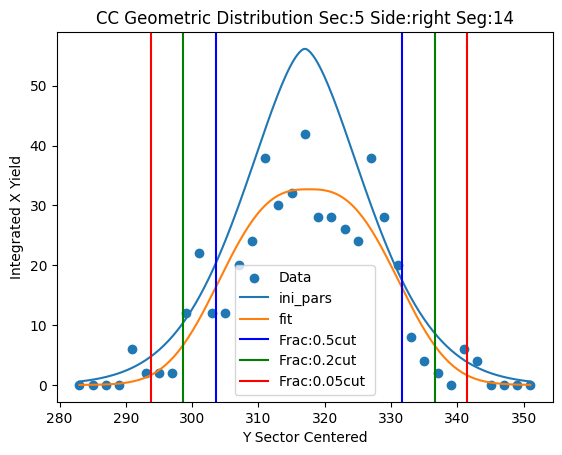

Parameters for Sec:5 Side:right Seg:15
test pars [ 32.69047003 341.          12.3190056    2.75791668]
fit pars [ 32.072532   341.33327037  10.02210191   2.10602245]



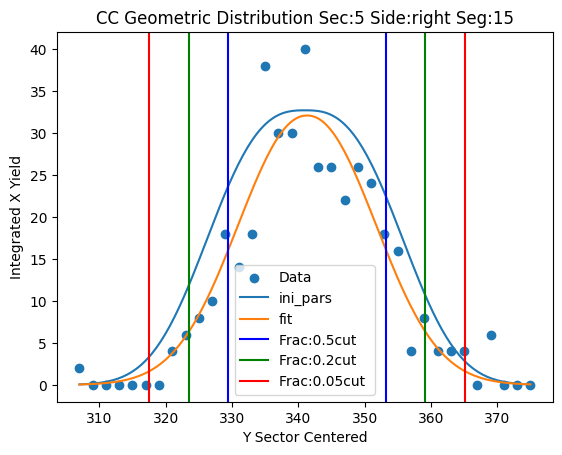

Parameters for Sec:5 Side:right Seg:16
test pars [ 32.072532   369.          11.02210191   2.10602245]
fit pars [ 20.36363642 366.94921146   8.47886698  97.7970838 ]



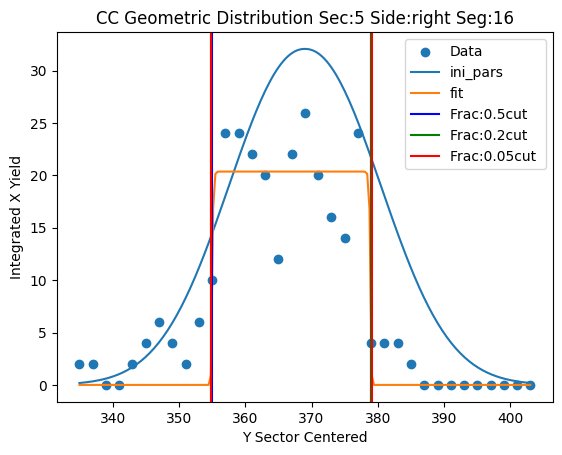

Parameters for Sec:5 Side:right Seg:17
test pars [ 20.36363642 387.           9.47886698  97.7970838 ]
fit pars [ 12.67324673 216.70773724   3.77749227  38.97382767]



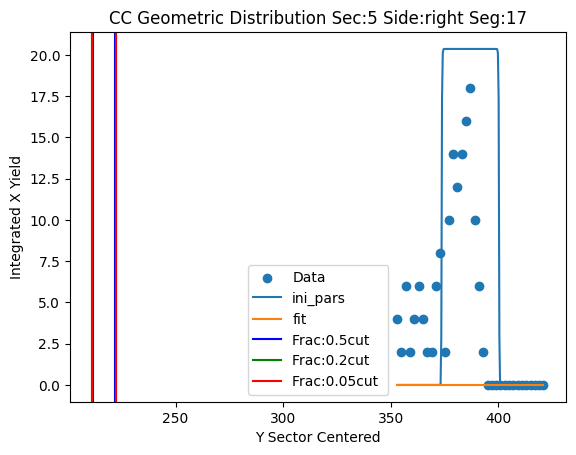

Parameters for Sec:5 Side:right Seg:18
test pars [ 12.67324673 341.           4.77749227  38.97382767]
fit pars [  5.19999999 342.75325898   4.16140019  59.0408699 ]



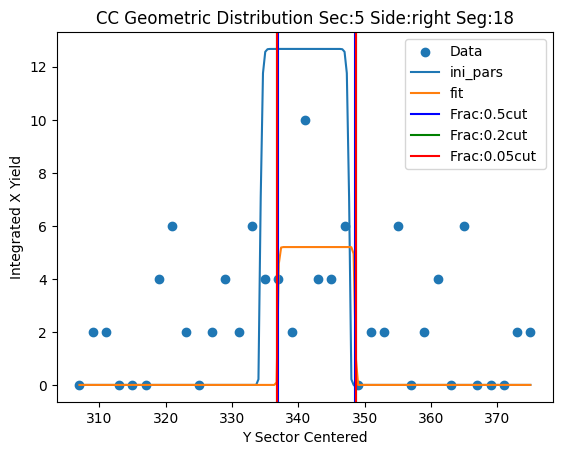

Parameters for Sec:5 Side:coinc Seg:1
test pars [40. 97. 19.  6.]
fit pars [160.33783082  98.56340765   3.9243846    0.72930545]



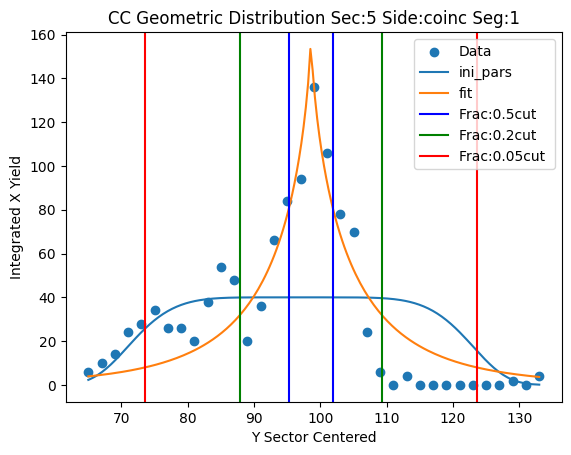

Parameters for Sec:5 Side:coinc Seg:2
test pars [160.33783082 107.           4.9243846    0.72930545]
fit pars [ 39.40902766 104.18868165   8.61178417   0.9849913 ]



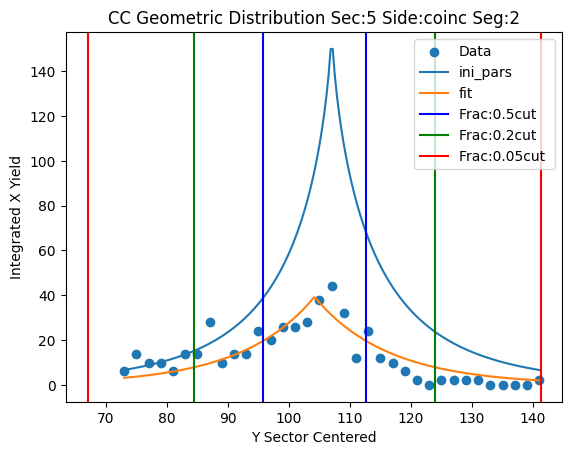

Parameters for Sec:5 Side:coinc Seg:3
test pars [ 39.40902766 117.           9.61178417   0.9849913 ]
fit pars [ 71.12061688 121.12820859   9.98997918   2.06123706]



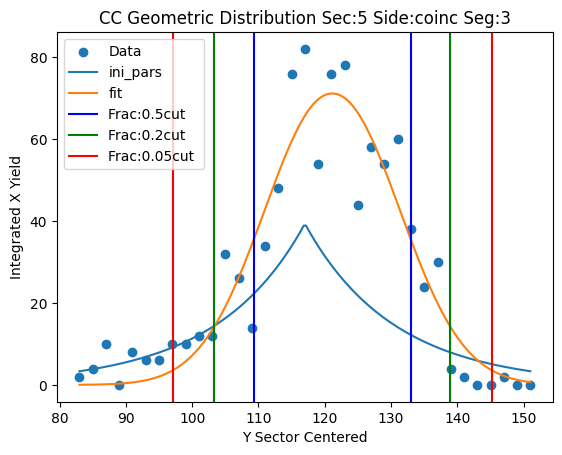

Parameters for Sec:5 Side:coinc Seg:4
test pars [ 71.12061688 139.          10.98997918   2.06123706]
fit pars [ 49.78932417 140.15934759   4.19096981   0.95470485]



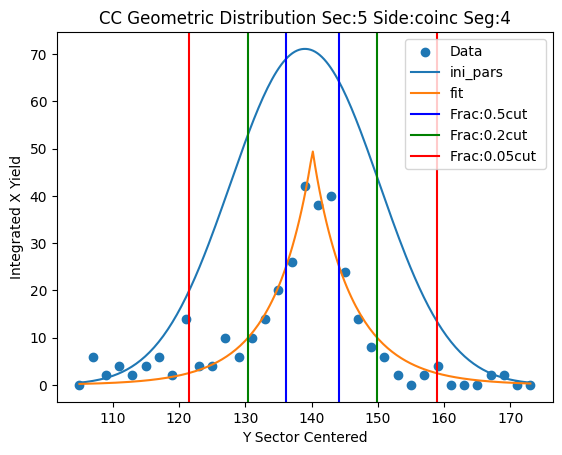

Parameters for Sec:5 Side:coinc Seg:5
test pars [ 49.78932417 155.           5.19096981   0.95470485]
fit pars [ 33.47534726 151.71964155   8.02144121   3.18315832]



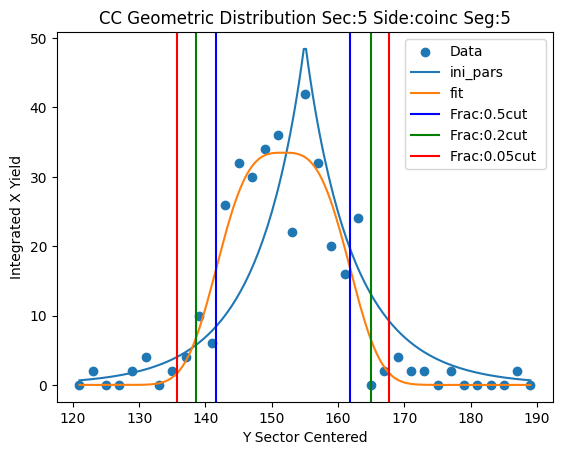

Parameters for Sec:5 Side:coinc Seg:6
test pars [ 33.47534726 169.           9.02144121   3.18315832]
fit pars [ 31.86945197 168.06203534   7.0384734    1.92620383]



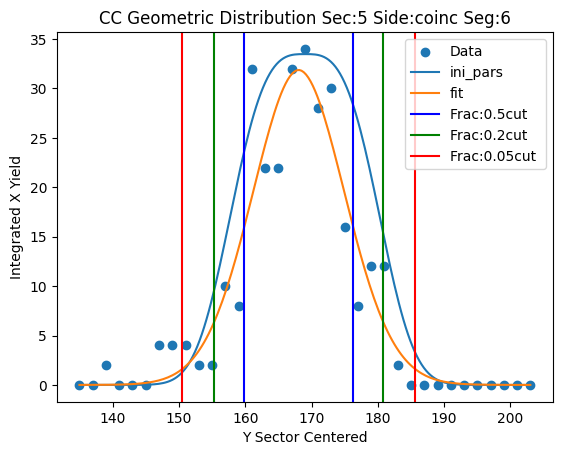

Parameters for Sec:5 Side:coinc Seg:7
test pars [ 31.86945197 183.           8.0384734    1.92620383]
fit pars [ 27.7270006  184.58278335   7.18973198   1.63824283]



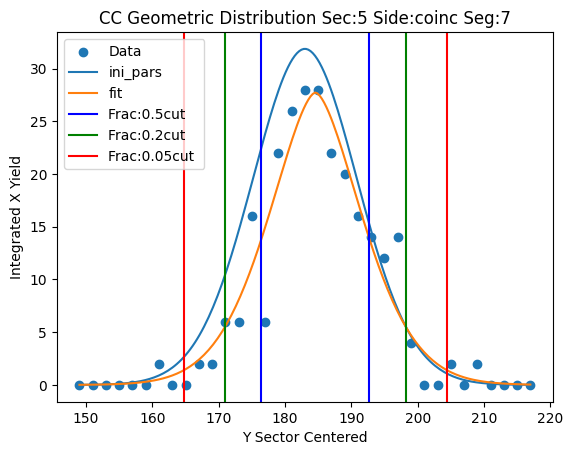

Parameters for Sec:5 Side:coinc Seg:8
test pars [ 27.7270006  197.           8.18973198   1.63824283]
fit pars [ 18.44713014 200.95831683   6.64524014   1.85083862]



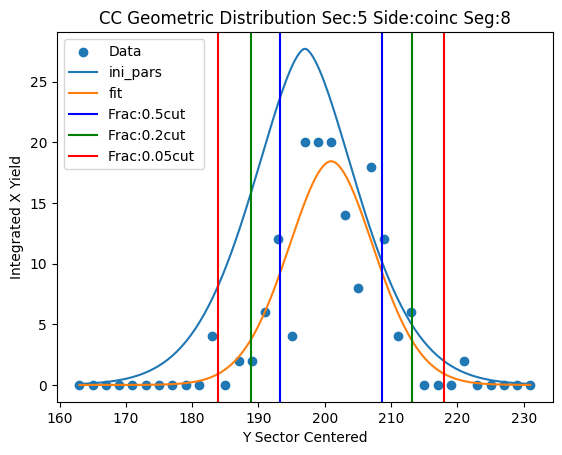

Parameters for Sec:5 Side:coinc Seg:9
test pars [ 18.44713014 215.           7.64524014   1.85083862]
fit pars [ 14.11640333 218.09498771   5.76356385   1.60659346]



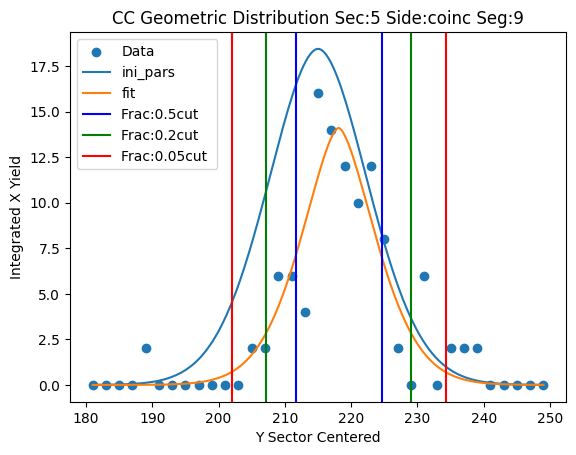

Parameters for Sec:5 Side:coinc Seg:10
test pars [ 14.11640333 237.           6.76356385   1.60659346]
fit pars [ 12.66427772 236.99998611   5.40759951   1.06086543]



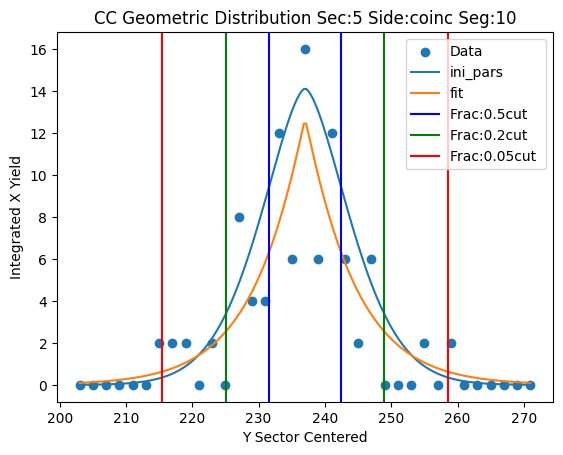

Parameters for Sec:5 Side:coinc Seg:11
test pars [ 12.66427772 261.           6.40759951   1.06086543]
fit pars [ 12.32458767 262.04434488   3.12799133   0.56920676]



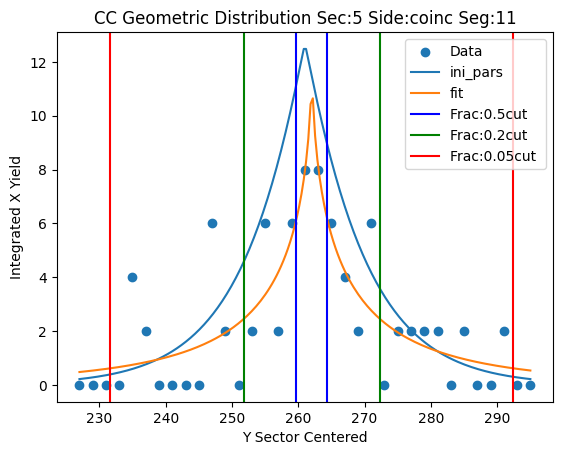

Parameters for Sec:5 Side:coinc Seg:12
test pars [ 12.32458767 277.           4.12799133   0.56920676]
fit pars [  7.93969908 277.00000013   4.00169117   0.60687238]



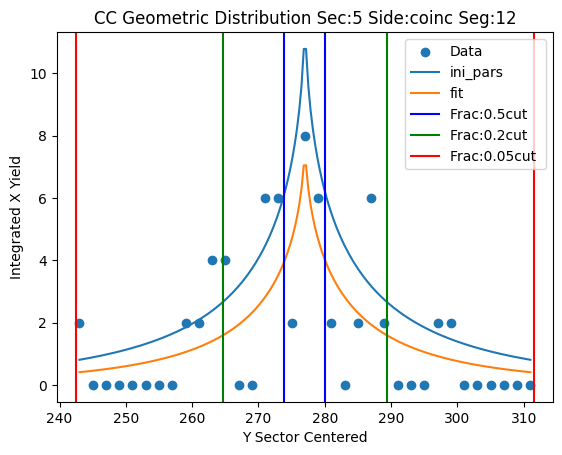

Parameters for Sec:5 Side:coinc Seg:13
test pars [  7.93969908 293.           5.00169117   0.60687238]
fit pars [  5.99555847 293.00000033   4.14543041   0.63010501]



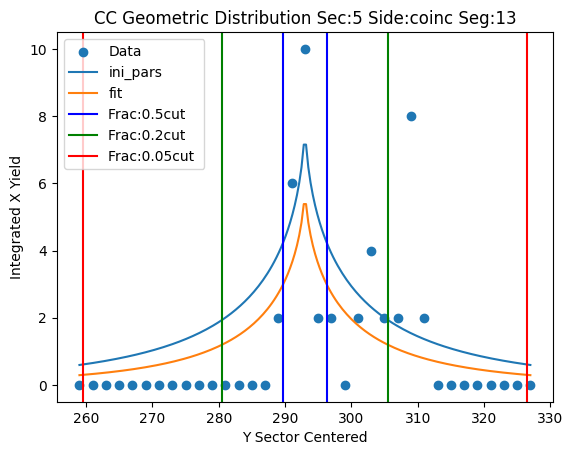

Parameters for Sec:5 Side:coinc Seg:14
test pars [  5.99555847 319.           5.14543041   0.63010501]
fit pars [  4.76344651 318.77033942   1.67527059   0.75241887]



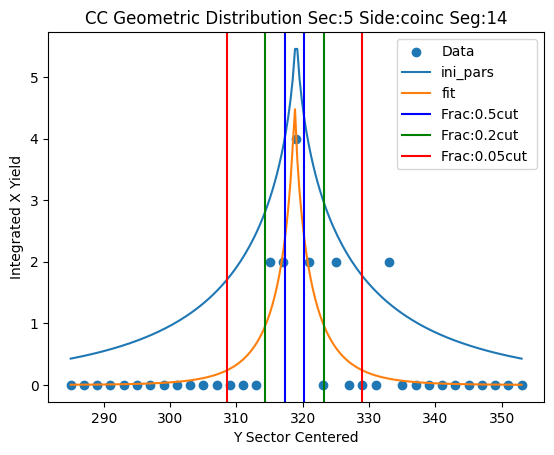

Parameters for Sec:5 Side:coinc Seg:15
test pars [  4.76344651 335.           2.67527059   0.75241887]
fit pars [  3.40465167 334.99999929   2.09477615   0.37147377]



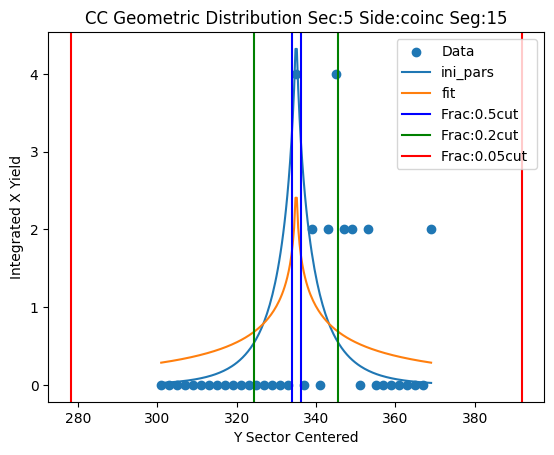

Parameters for Sec:5 Side:coinc Seg:16
test pars [3.40465167e+00 3.81000000e+02 3.09477615e+00 3.71473768e-01]
fit pars [  2.181622   380.99999945   2.3135249    0.38933487]



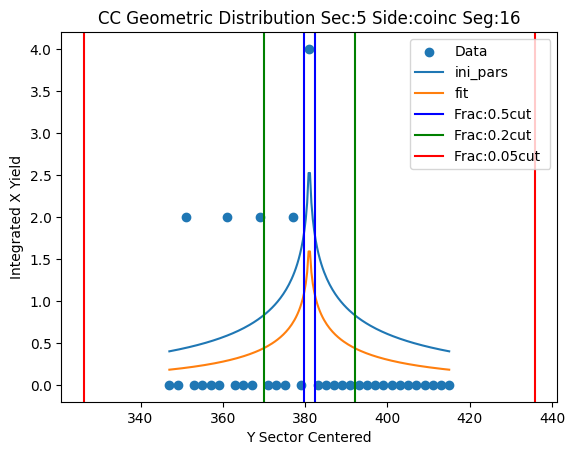

Parameters for Sec:5 Side:left Seg:1
test pars [19. 83. 13.  5.]
fit pars [13.45731598 83.41694991 13.89586032 13.39661924]



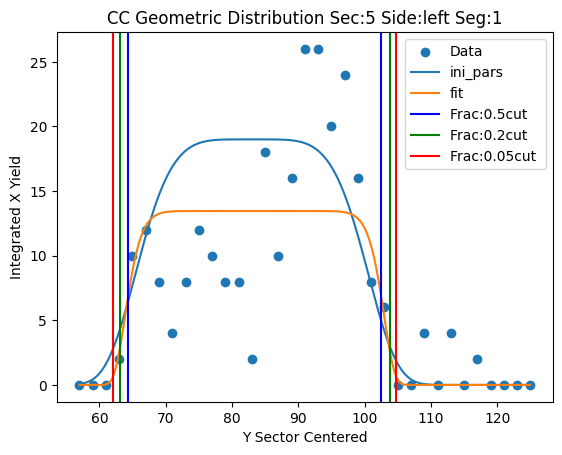

Parameters for Sec:5 Side:left Seg:2
test pars [ 13.45731598 109.          14.89586032  13.39661924]
fit pars [ 91.72884451 104.02997896   8.32671458   2.57959467]



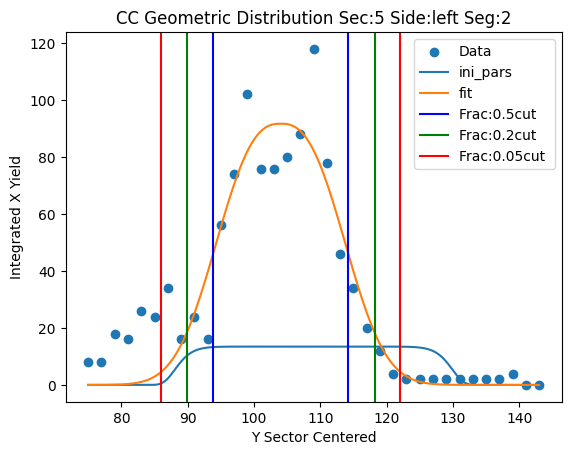

Parameters for Sec:5 Side:left Seg:3
test pars [ 91.72884451 121.           9.32671458   2.57959467]
fit pars [160.7333421  120.4218362    5.11937098   1.87102249]



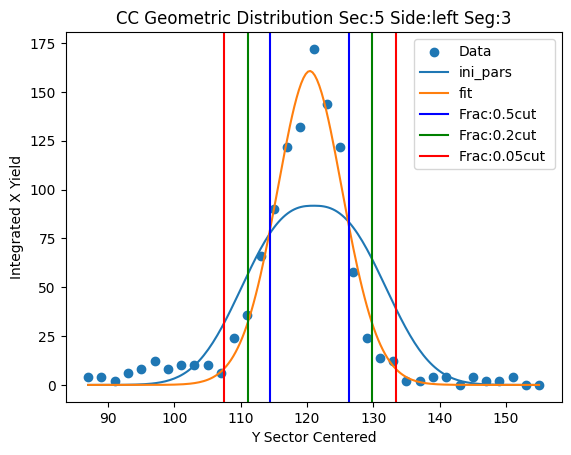

Parameters for Sec:5 Side:left Seg:4
test pars [160.7333421  129.           6.11937098   1.87102249]
fit pars [159.66719049 134.70655839   6.62287783   3.8498633 ]



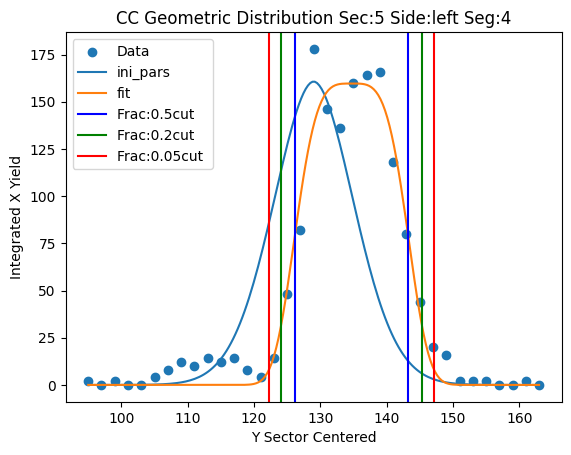

Parameters for Sec:5 Side:left Seg:5
test pars [159.66719049 149.           7.62287783   3.8498633 ]
fit pars [197.80383207 149.18855392   6.35399844   2.50544728]



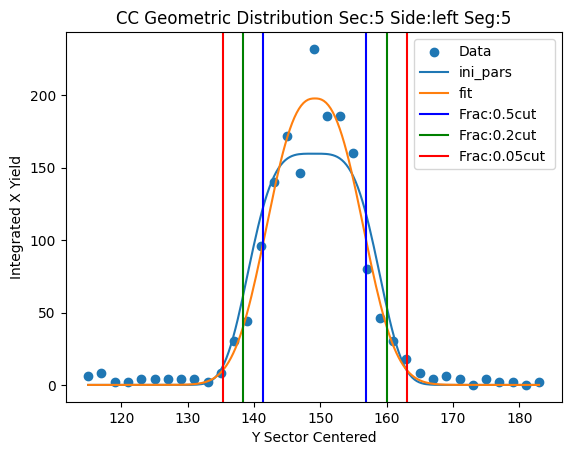

Parameters for Sec:5 Side:left Seg:6
test pars [197.80383207 167.           7.35399844   2.50544728]
fit pars [161.18649237 164.81928103   6.99906041   2.22761523]



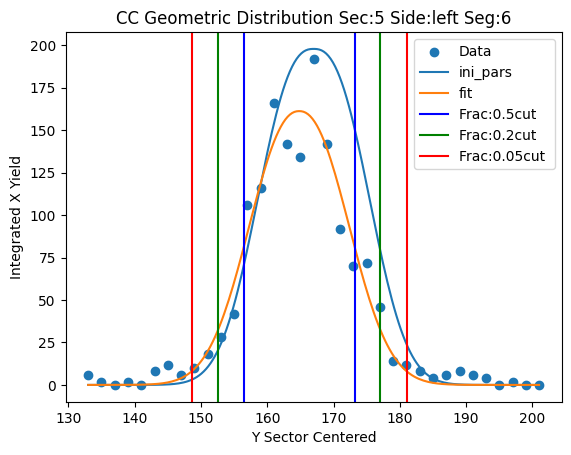

Parameters for Sec:5 Side:left Seg:7
test pars [161.18649237 185.           7.99906041   2.22761523]
fit pars [182.19010719 183.82124479   7.97560199   1.92658668]



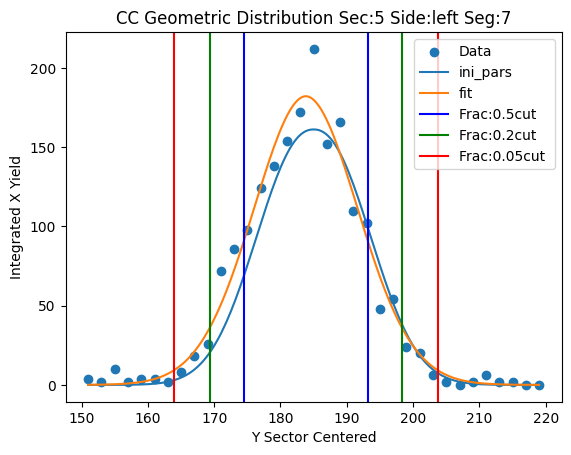

Parameters for Sec:5 Side:left Seg:8
test pars [182.19010719 203.           8.97560199   1.92658668]
fit pars [163.0801285  201.86419273   6.92322164   1.64102116]



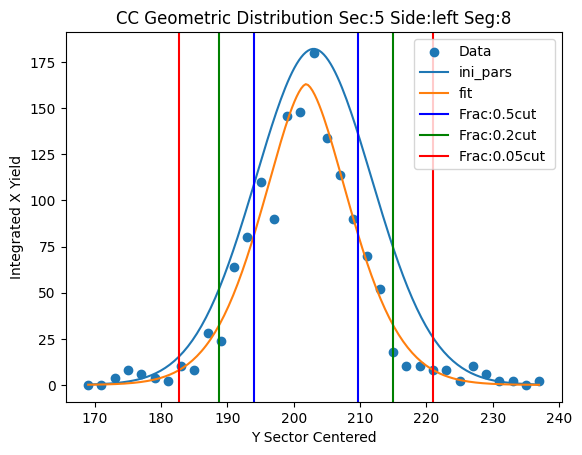

Parameters for Sec:5 Side:left Seg:9
test pars [163.0801285  215.           7.92322164   1.64102116]
fit pars [ 94.86729346 219.75306739   8.08770112   4.03478399]



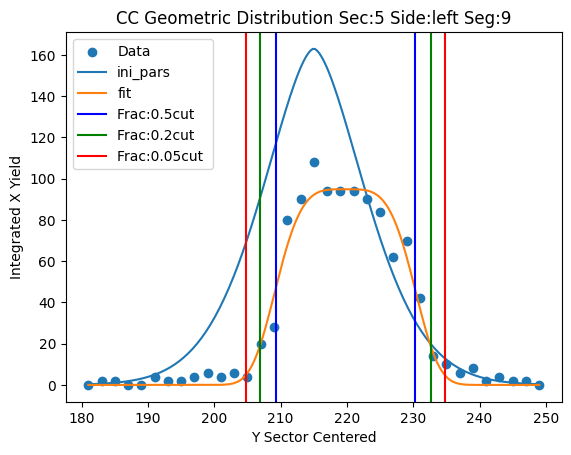

Parameters for Sec:5 Side:left Seg:10
test pars [ 94.86729346 239.           9.08770112   4.03478399]
fit pars [ 83.26339682 236.16358015   6.8385535    1.7596546 ]



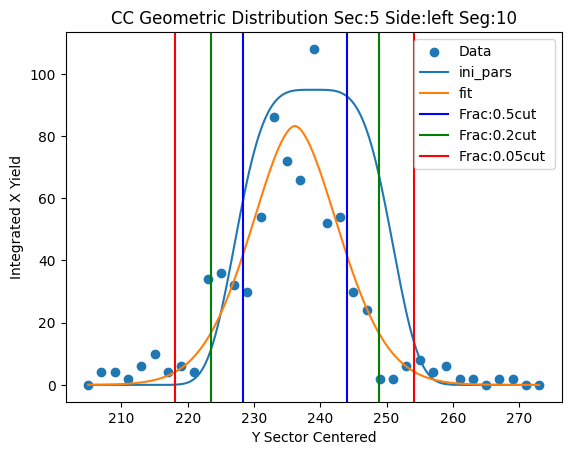

Parameters for Sec:5 Side:left Seg:11
test pars [ 83.26339682 253.           7.8385535    1.7596546 ]
fit pars [ 66.54881723 256.21881881   9.84633573   3.00347636]



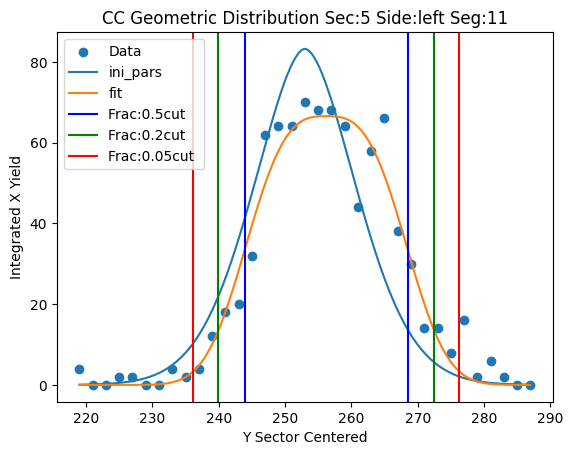

Parameters for Sec:5 Side:left Seg:12
test pars [ 66.54881723 275.          10.84633573   3.00347636]
fit pars [ 55.53553541 277.70617118   6.89897319   1.49089652]



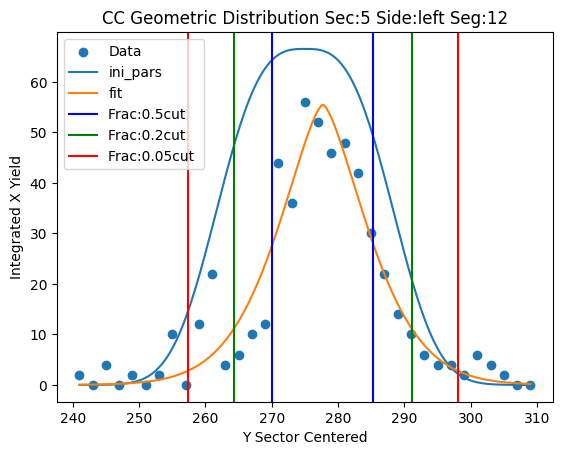

Parameters for Sec:5 Side:left Seg:13
test pars [ 55.53553541 297.           7.89897319   1.49089652]
fit pars [ 48.6640939  296.79944281   7.17728928   1.54483565]



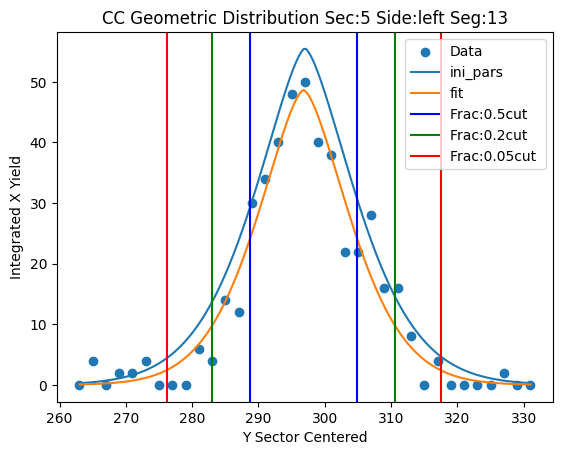

Parameters for Sec:5 Side:left Seg:14
test pars [ 48.6640939  313.           8.17728928   1.54483565]
fit pars [ 36.27568895 318.14504733   7.18666295   4.11345551]



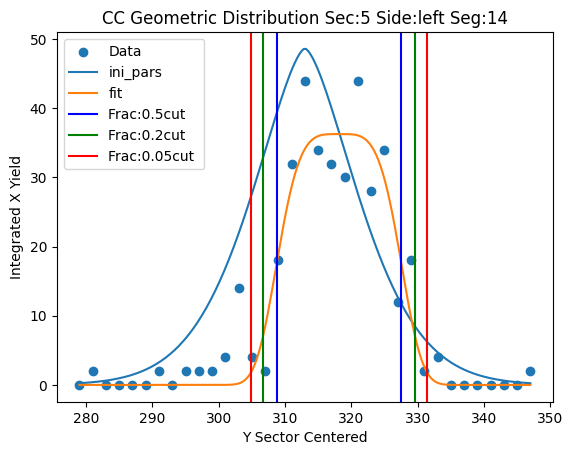

Parameters for Sec:5 Side:left Seg:15
test pars [ 36.27568895 333.           8.18666295   4.11345551]
fit pars [ 23.55919901 338.89794785  10.21853676   4.49339537]



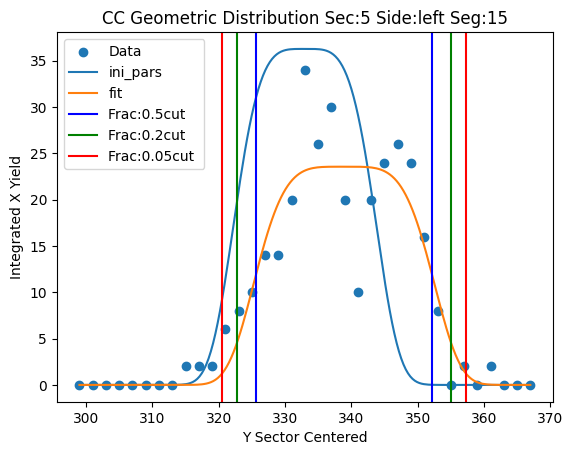

Parameters for Sec:5 Side:left Seg:16
test pars [ 23.55919901 357.          11.21853676   4.49339537]
fit pars [ 19.59113725 362.36880181   9.13735584   1.91621585]



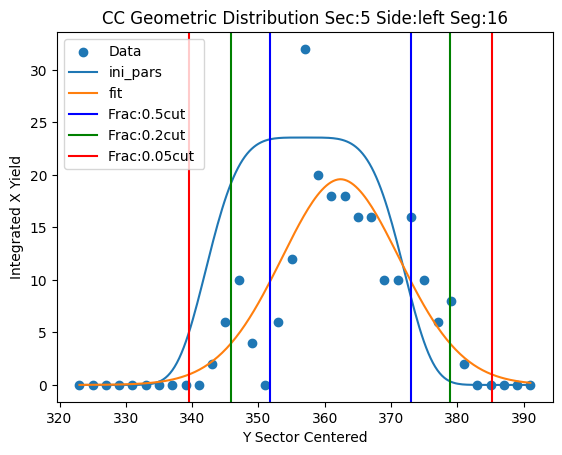

Parameters for Sec:5 Side:left Seg:17
test pars [ 19.59113725 383.          10.13735584   1.91621585]
fit pars [ 33.68003381 382.70745065   2.2214103    0.81801125]



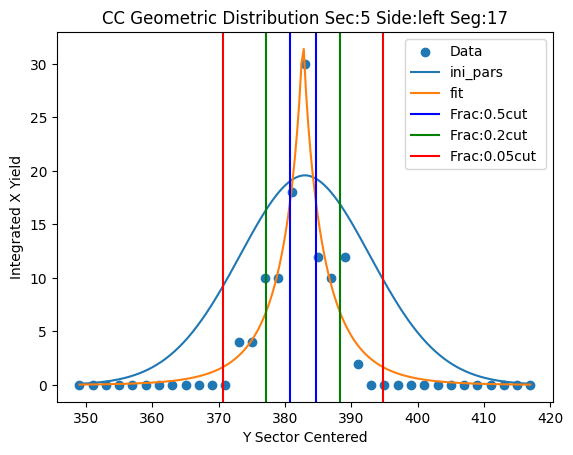

Parameters for Sec:5 Side:left Seg:18
test pars [ 33.68003381 391.           3.2214103    0.81801125]
fit pars [  4.         391.           1.53707807   4.39665322]



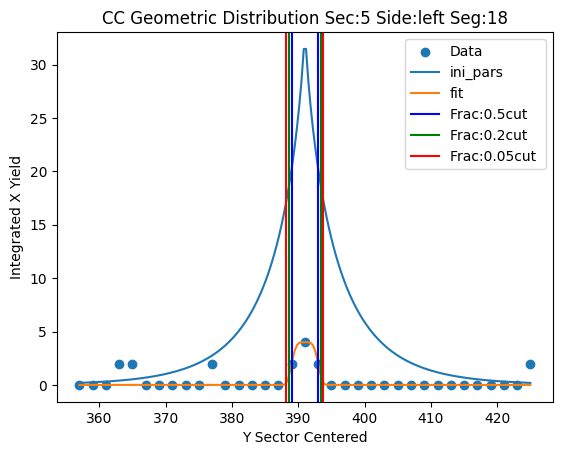

Parameters for Sec:6 Side:right Seg:1
test pars [83. 82. 10.  3.]
fit pars [19.71860399 96.99999081  3.62405264  1.04084901]



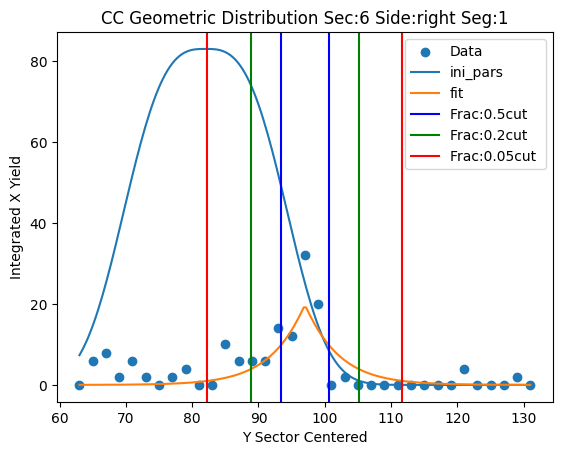

Parameters for Sec:6 Side:right Seg:2
test pars [ 19.71860399 105.           4.62405264   1.04084901]
fit pars [140.52271162 105.18365402   3.78146149   1.48098558]



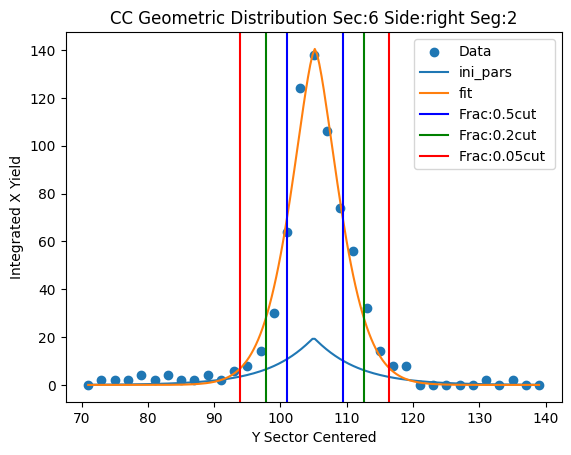

Parameters for Sec:6 Side:right Seg:3
test pars [140.52271162 121.           4.78146149   1.48098558]
fit pars [116.28111151 119.17282982   5.34302131   2.11737638]



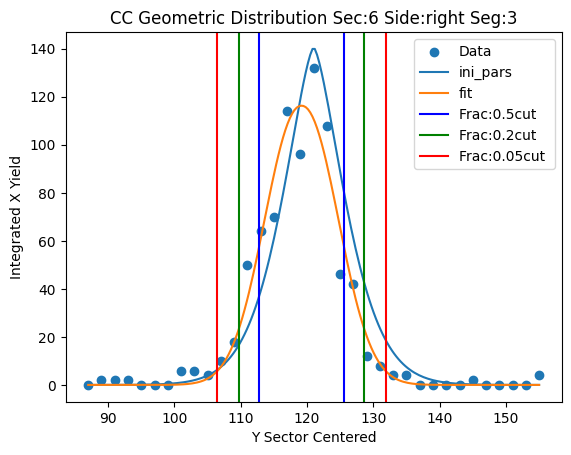

Parameters for Sec:6 Side:right Seg:4
test pars [116.28111151 129.           6.34302131   2.11737638]
fit pars [227.18492885 131.69570176   7.00389376   2.76826728]



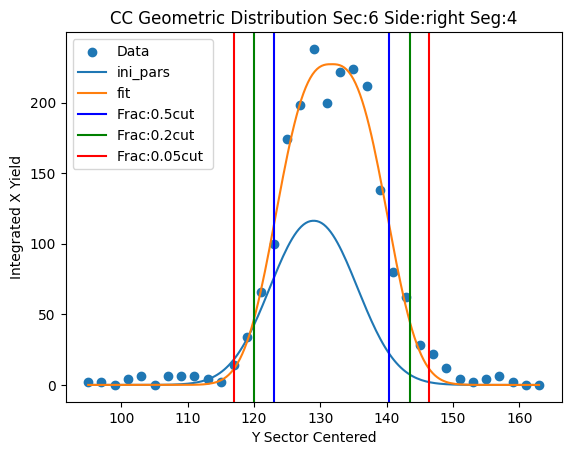

Parameters for Sec:6 Side:right Seg:5
test pars [227.18492885 145.           8.00389376   2.76826728]
fit pars [206.21871386 147.34754159   6.76072839   3.16795572]



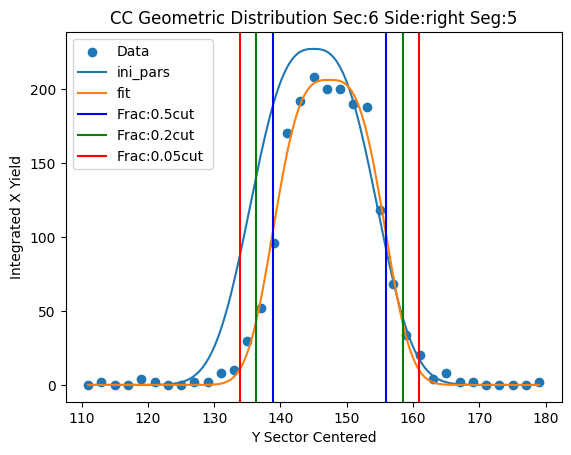

Parameters for Sec:6 Side:right Seg:6
test pars [206.21871386 165.           7.76072839   3.16795572]
fit pars [125.45622784 164.21839351   7.90748865   2.37193707]



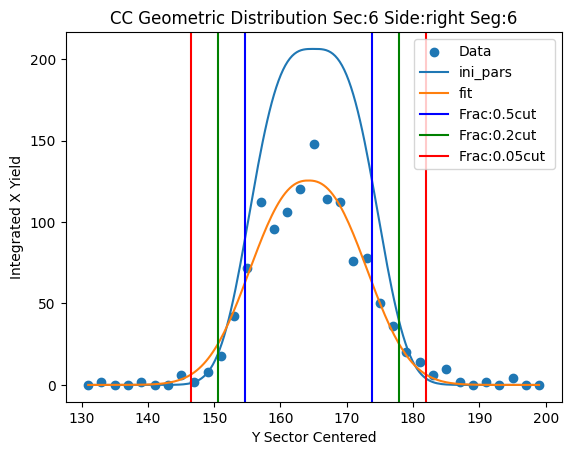

Parameters for Sec:6 Side:right Seg:7
test pars [125.45622784 179.           8.90748865   2.37193707]
fit pars [158.6077292  180.8713913    8.55271557   2.59108361]



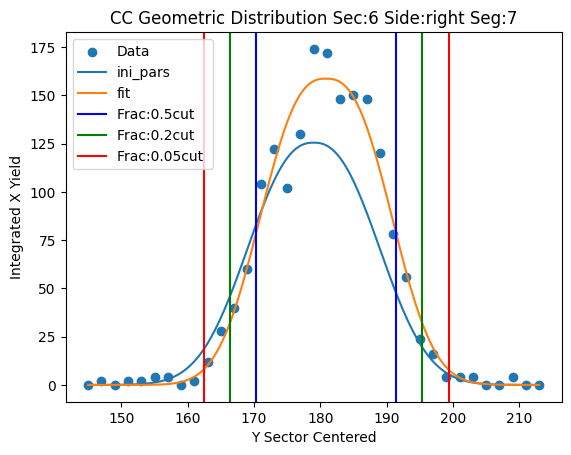

Parameters for Sec:6 Side:right Seg:8
test pars [158.6077292  199.           9.55271557   2.59108361]
fit pars [139.78105643 198.44188727   6.85972968   2.81573515]



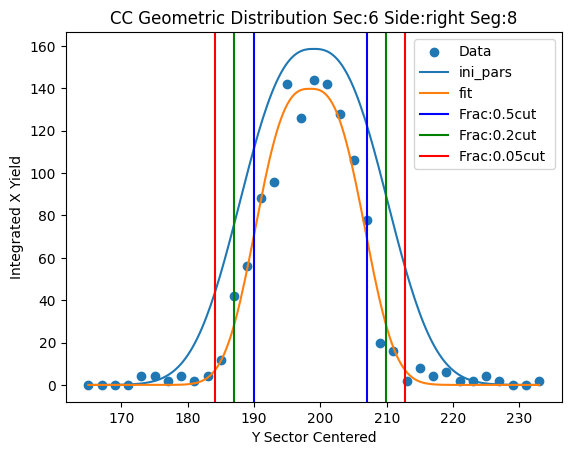

Parameters for Sec:6 Side:right Seg:9
test pars [139.78105643 211.           7.85972968   2.81573515]
fit pars [105.58887749 213.77935986   7.05739264   3.44879709]



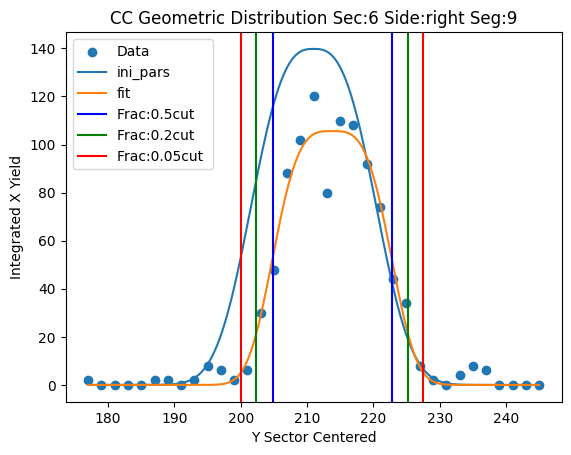

Parameters for Sec:6 Side:right Seg:10
test pars [105.58887749 229.           8.05739264   3.44879709]
fit pars [130.3926909  228.6568134    5.47181648   1.29850174]



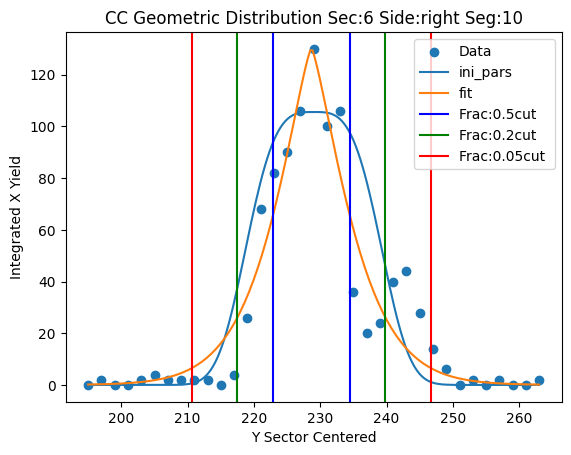

Parameters for Sec:6 Side:right Seg:11
test pars [130.3926909  251.           6.47181648   1.29850174]
fit pars [112.11866269 250.86327782   6.30417409   1.11529071]



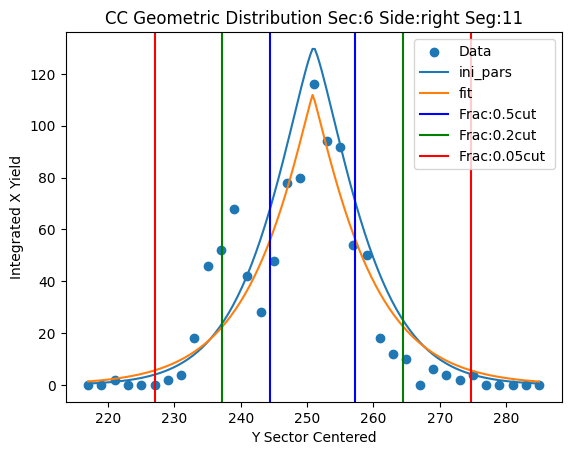

Parameters for Sec:6 Side:right Seg:12
test pars [112.11866269 265.           7.30417409   1.11529071]
fit pars [ 67.5933429  267.80868799   7.70577452   1.52034713]



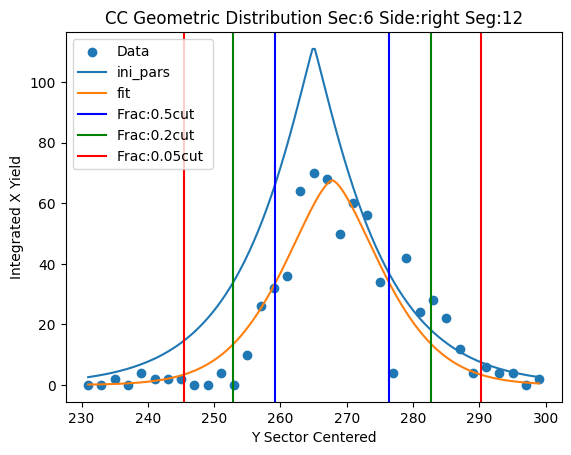

Parameters for Sec:6 Side:right Seg:13
test pars [ 67.5933429  277.           8.70577452   1.52034713]
fit pars [ 35.17128216 289.32865965  12.41644099   7.64487206]



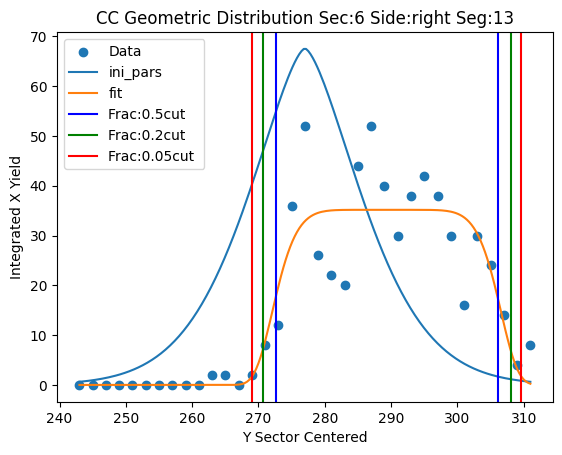

Parameters for Sec:6 Side:right Seg:14
test pars [ 35.17128216 315.          13.41644099   7.64487206]
fit pars [ 46.539291   315.21482506   6.96393201   1.05215   ]



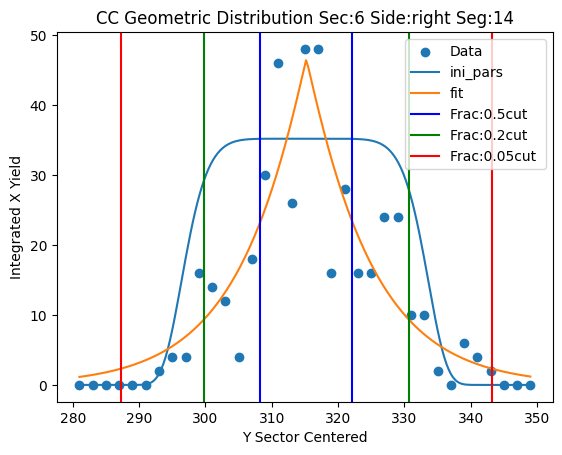

Parameters for Sec:6 Side:right Seg:15
test pars [ 46.539291   335.           7.96393201   1.05215   ]
fit pars [ 26.48226362 340.94986153   7.97452975   3.30756714]



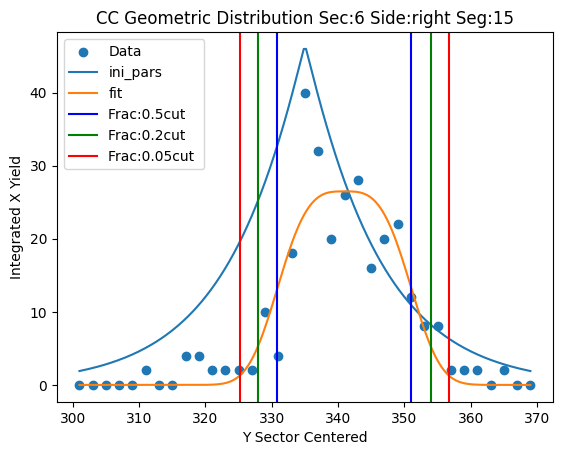

Parameters for Sec:6 Side:right Seg:16
test pars [ 26.48226362 371.           8.97452975   3.30756714]
fit pars [ 14.43017839 364.47371051  11.20750312   3.06799979]



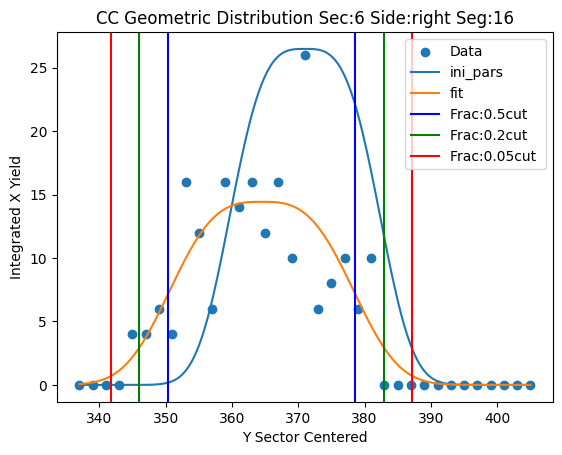

Parameters for Sec:6 Side:right Seg:17
test pars [ 14.43017839 381.          12.20750312   3.06799979]
fit pars [2.72060082e+03 3.80187369e+02 1.37374803e-08 9.35901811e-02]



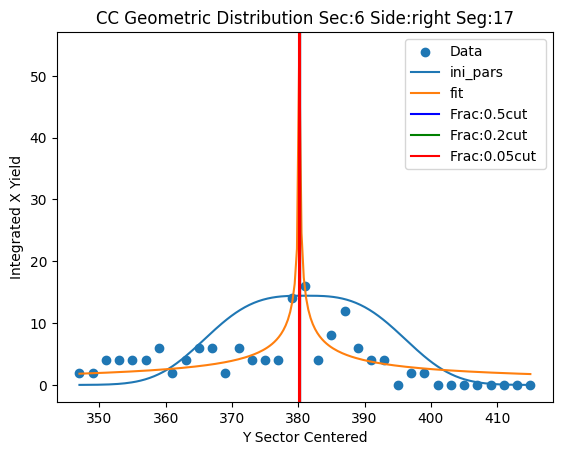

Parameters for Sec:6 Side:right Seg:18
test pars [2.72060082e+03 3.61000000e+02 1.00000001e+00 9.35901811e-02]
fit pars [1.55827811e+03 3.61818593e+02 3.65400695e-01 3.61373009e+00]



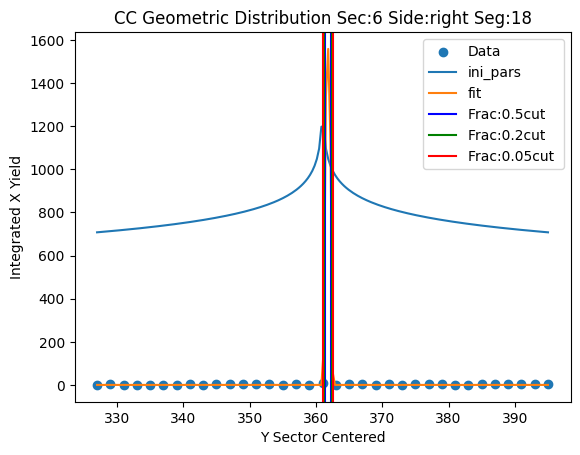

Parameters for Sec:6 Side:coinc Seg:1
test pars [40. 97. 19.  6.]
fit pars [99.36459323 96.62895996  2.61352773  0.68130292]



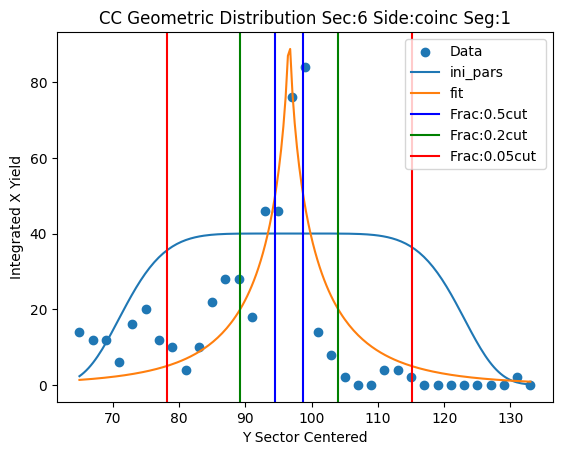

Parameters for Sec:6 Side:coinc Seg:2
test pars [ 99.36459323 103.           3.61352773   0.68130292]
fit pars [157.97475966 103.23408389   5.9706554    1.16354511]



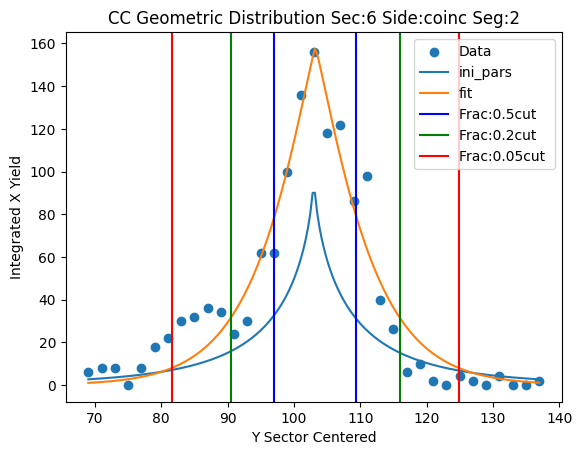

Parameters for Sec:6 Side:coinc Seg:3
test pars [157.97475966 117.           6.9706554    1.16354511]
fit pars [ 95.6117231  118.35520344   7.08309758   2.27196138]



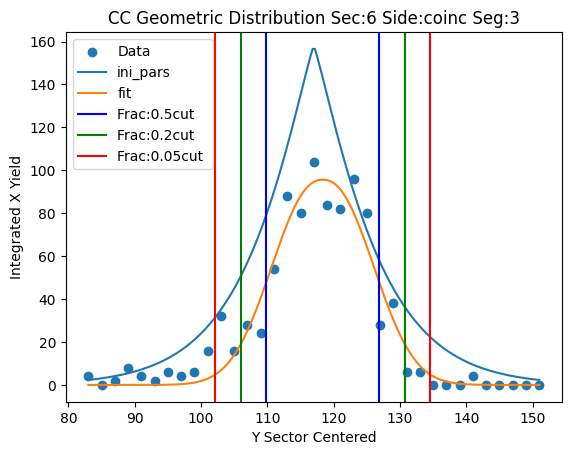

Parameters for Sec:6 Side:coinc Seg:4
test pars [ 95.6117231  135.           8.08309758   2.27196138]
fit pars [ 78.2181351  133.95129649   5.38605515   1.34888586]



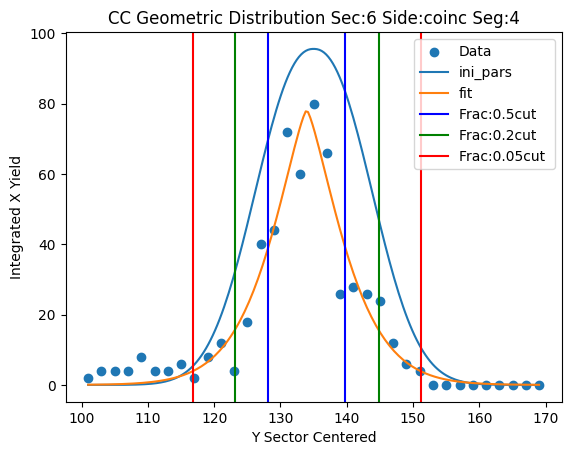

Parameters for Sec:6 Side:coinc Seg:5
test pars [ 78.2181351  149.           6.38605515   1.34888586]
fit pars [ 34.81322005 150.33867311   7.66505752   2.2204687 ]



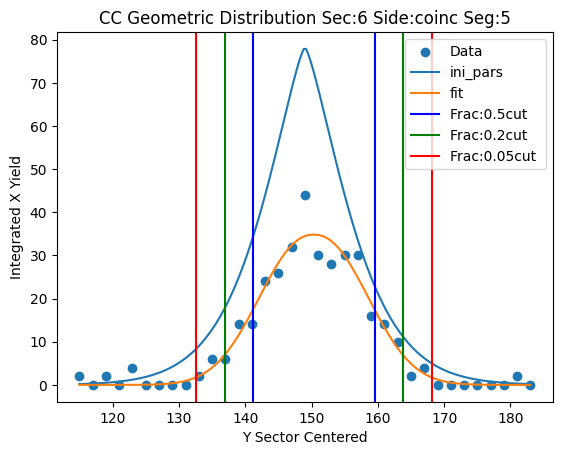

Parameters for Sec:6 Side:coinc Seg:6
test pars [ 34.81322005 169.           8.66505752   2.2204687 ]
fit pars [ 19.29241166 167.66908658   7.80970648   2.47087819]



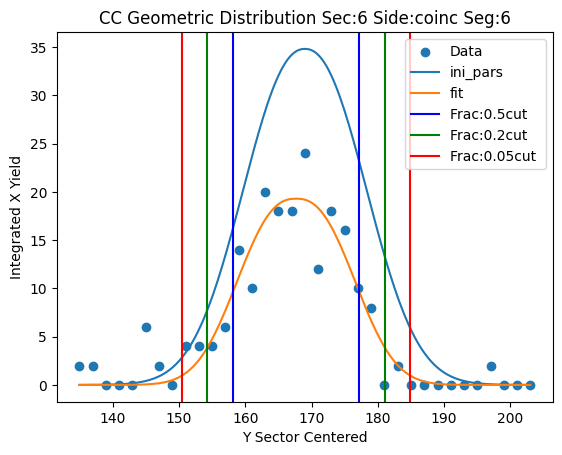

Parameters for Sec:6 Side:coinc Seg:7
test pars [ 19.29241166 185.           8.80970648   2.47087819]
fit pars [ 24.26182448 184.80869902   6.54667359   1.32424678]



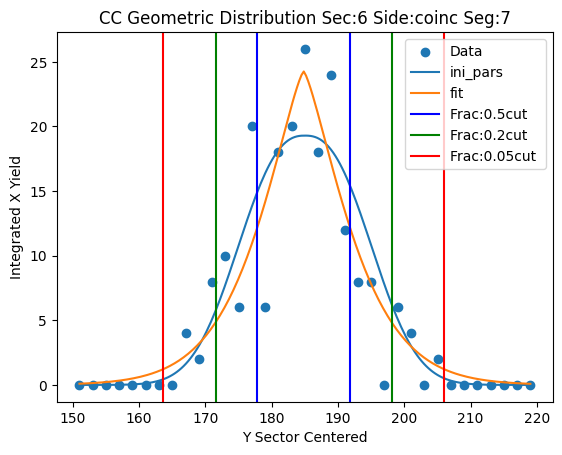

Parameters for Sec:6 Side:coinc Seg:8
test pars [ 24.26182448 201.           7.54667359   1.32424678]
fit pars [ 17.19643859 201.44330982   7.77468067   2.60567151]



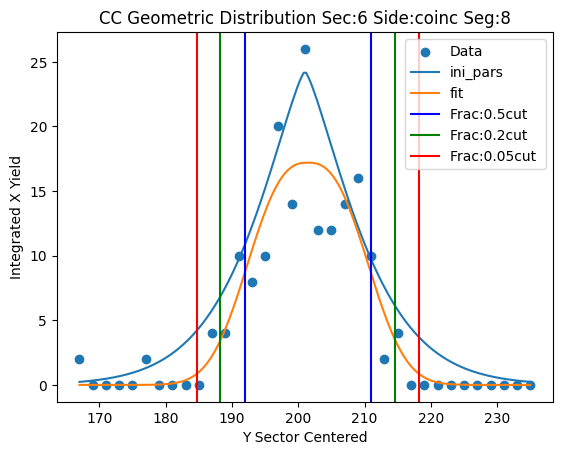

Parameters for Sec:6 Side:coinc Seg:9
test pars [ 17.19643859 217.           8.77468067   2.60567151]
fit pars [ 11.24372896 216.99999581   6.80376401   1.01321931]



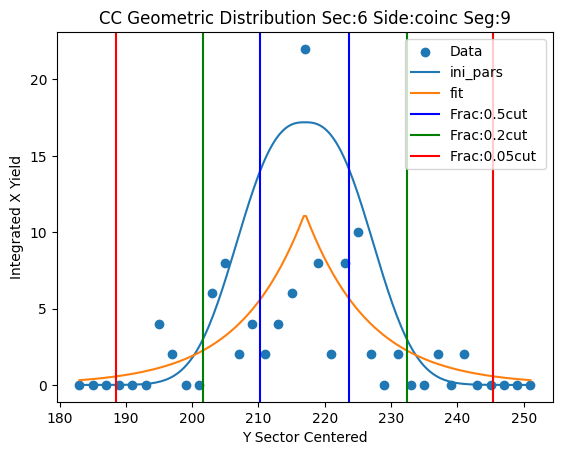

Parameters for Sec:6 Side:coinc Seg:10
test pars [ 11.24372896 227.           7.80376401   1.01321931]
fit pars [1.99797885e+04 2.27996744e+02 3.99735268e-08 1.20287446e-01]



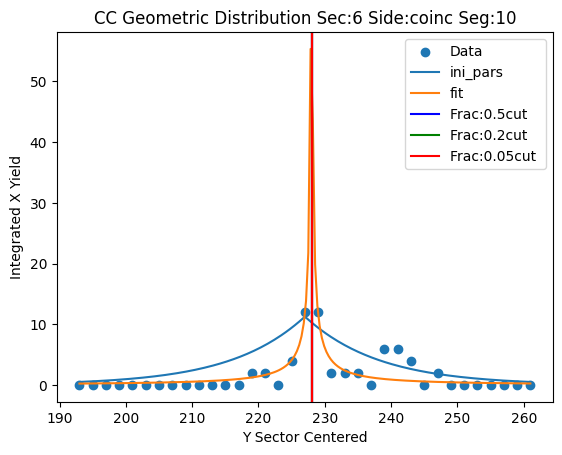

Parameters for Sec:6 Side:coinc Seg:12
test pars [1.99797885e+04 2.49000000e+02 1.00000004e+00 1.20287446e-01]
fit pars [1.14934262e+04 2.50110885e+02 3.65649645e-01 3.82818414e+00]



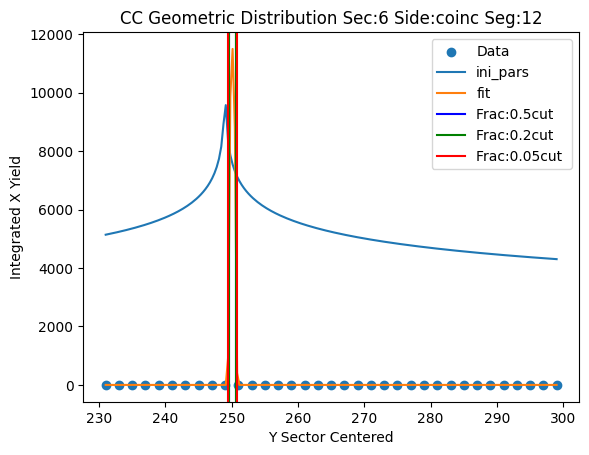

Parameters for Sec:6 Side:coinc Seg:13
test pars [1.14934262e+04 2.67000000e+02 1.36564965e+00 3.82818414e+00]
fit pars [  2.         267.           1.36564964  72.20554152]



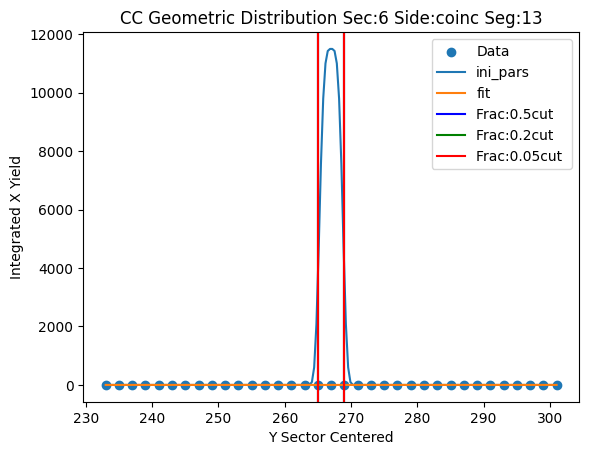

Parameters for Sec:6 Side:coinc Seg:14
test pars [  2.         295.           2.36564964  72.20554152]
fit pars [  2.66666667 295.           2.36564964  72.20554152]



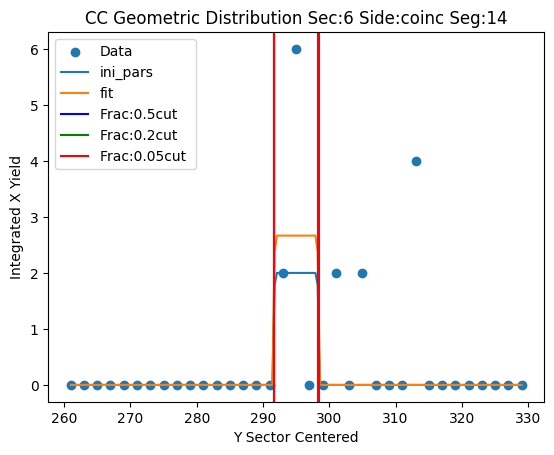

Parameters for Sec:6 Side:coinc Seg:15
test pars [  2.66666667 329.           3.36564964  72.20554152]
fit pars [  4.         329.16809556   1.31383508  25.86134061]



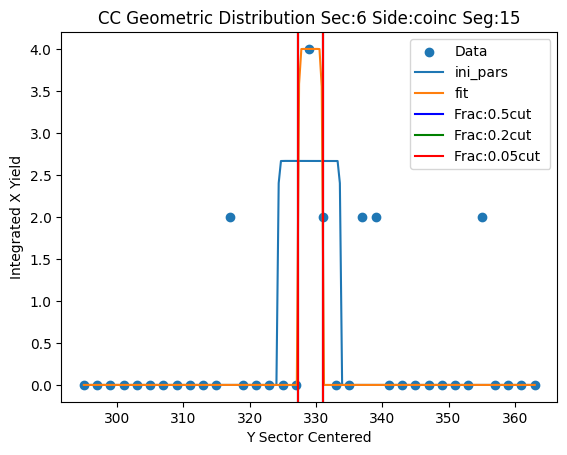

Parameters for Sec:6 Side:left Seg:1
test pars [19. 83. 13.  5.]
fit pars [10.1005604  81.9380223  15.84849133  9.82224014]



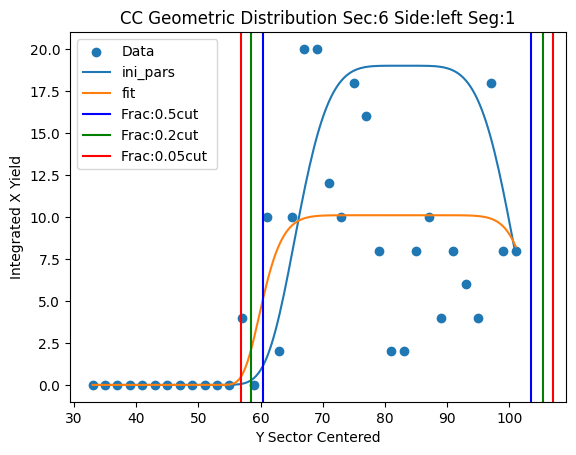

Parameters for Sec:6 Side:left Seg:2
test pars [ 10.1005604  105.          16.84849133   9.82224014]
fit pars [130.71505488 105.1599313    3.93003018   2.33022999]



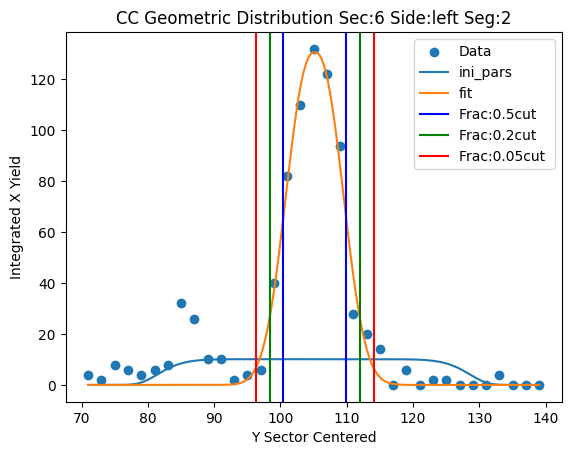

Parameters for Sec:6 Side:left Seg:3
test pars [130.71505488 117.           4.93003018   2.33022999]
fit pars [234.3989175  116.03499213   6.66525816   2.44538515]



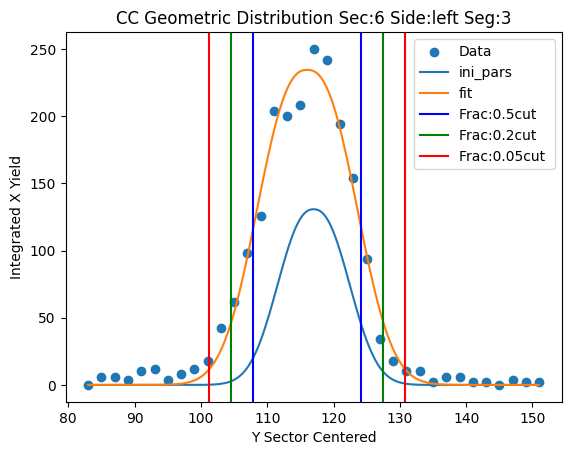

Parameters for Sec:6 Side:left Seg:4
test pars [234.3989175  125.           7.66525816   2.44538515]
fit pars [181.97798781 131.1584612    7.84758199   4.06978597]



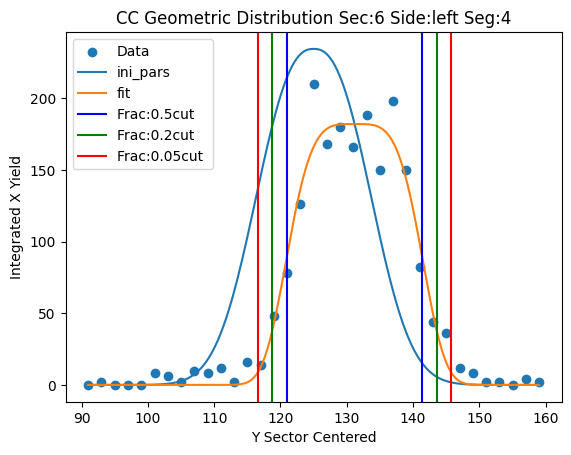

Parameters for Sec:6 Side:left Seg:5
test pars [181.97798781 149.           8.84758199   4.06978597]
fit pars [210.79432565 146.941862     6.9732586    2.21930782]



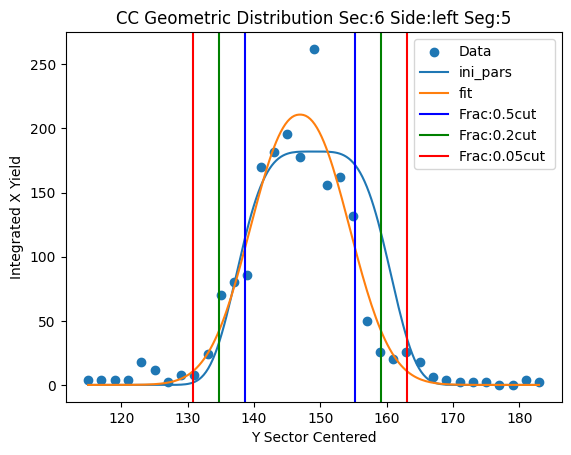

Parameters for Sec:6 Side:left Seg:6
test pars [210.79432565 165.           7.9732586    2.21930782]
fit pars [201.56823749 163.04161663   7.24152441   2.1464761 ]



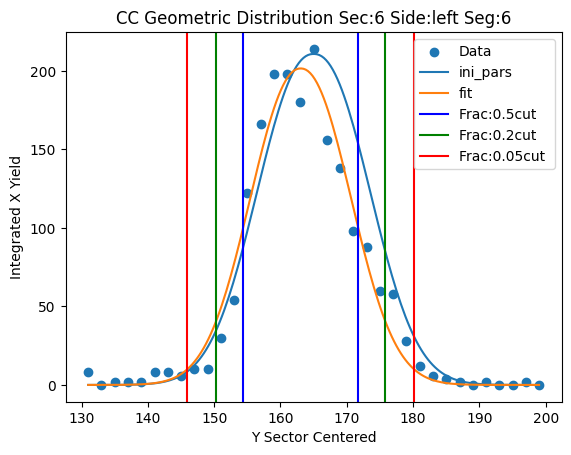

Parameters for Sec:6 Side:left Seg:7
test pars [201.56823749 183.           8.24152441   2.1464761 ]
fit pars [171.95979873 181.49850087   6.81572289   2.04829303]



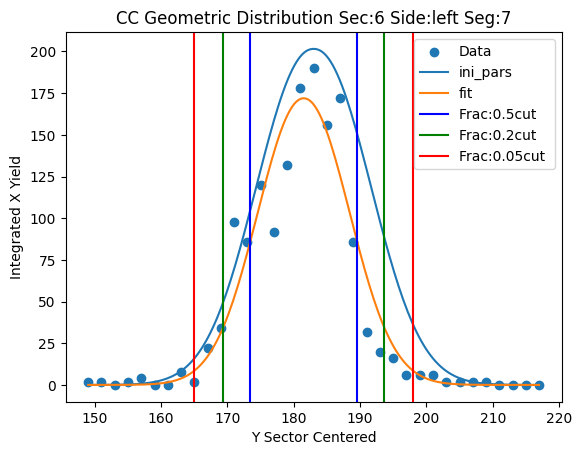

Parameters for Sec:6 Side:left Seg:8
test pars [171.95979873 199.           7.81572289   2.04829303]
fit pars [176.5693546  197.82250163   6.77137917   2.14856175]



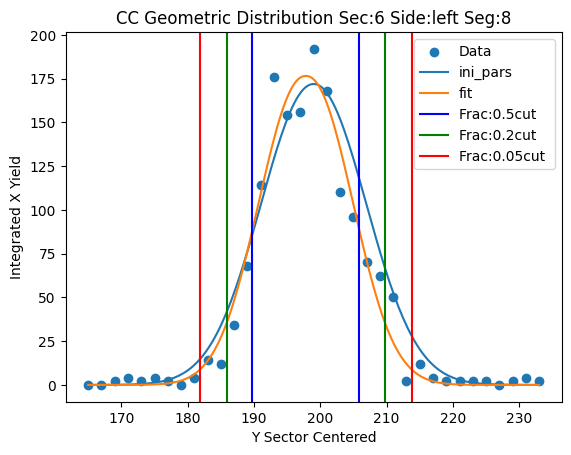

Parameters for Sec:6 Side:left Seg:9
test pars [176.5693546  217.           7.77137917   2.14856175]
fit pars [141.63124051 214.93645984   6.52940922   1.73913212]



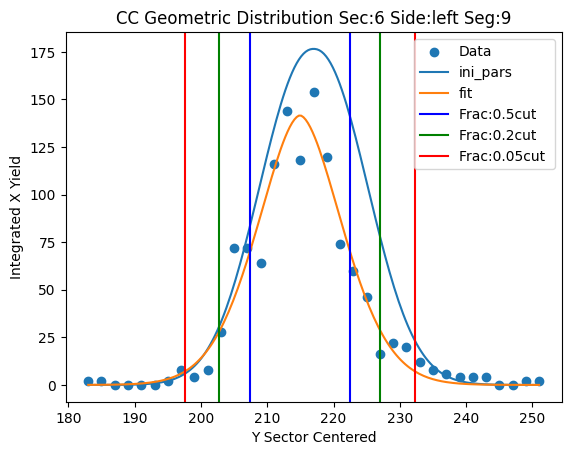

Parameters for Sec:6 Side:left Seg:10
test pars [141.63124051 231.           7.52940922   1.73913212]
fit pars [ 88.32251754 228.70902867   5.54488898   2.2931382 ]



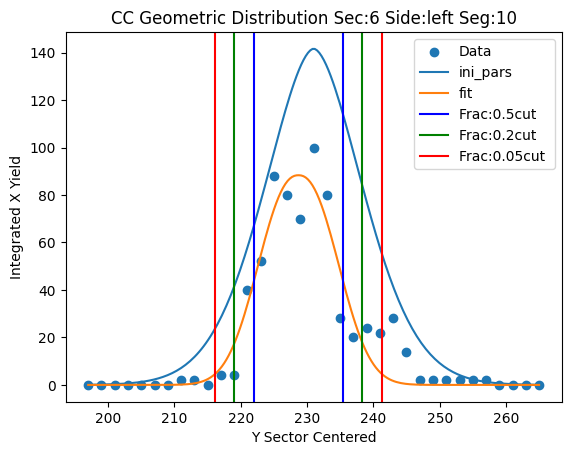

Parameters for Sec:6 Side:left Seg:11
test pars [ 88.32251754 237.           6.54488898   2.2931382 ]
fit pars [  9.95917363 237.00000046   2.22606083   0.41143006]



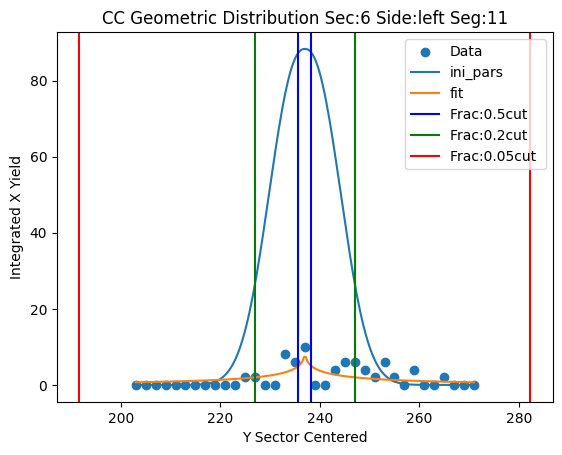

Parameters for Sec:6 Side:left Seg:12
test pars [  9.95917363 255.           3.22606083   0.41143006]
fit pars [ 70.60222143 254.27144861   5.11649808   0.99366474]



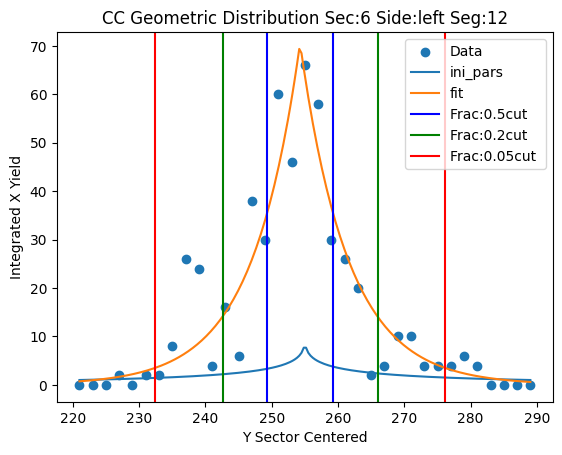

Parameters for Sec:6 Side:left Seg:13
test pars [ 70.60222143 265.           6.11649808   0.99366474]
fit pars [ 42.78589446 270.08400527   7.64294582   2.47080149]



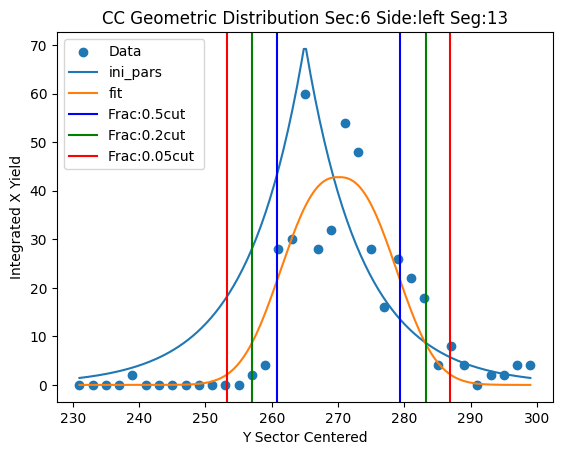

Parameters for Sec:6 Side:left Seg:14
test pars [ 42.78589446 291.           8.64294582   2.47080149]
fit pars [ 29.96777803 296.6862169   10.71742602   1.98625696]



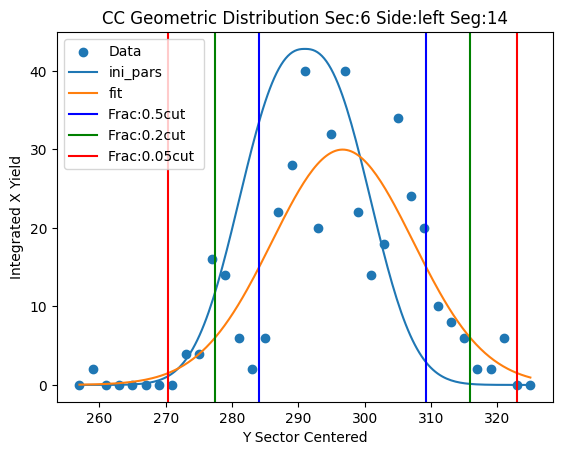

Parameters for Sec:6 Side:left Seg:15
test pars [ 29.96777803 317.          11.71742602   1.98625696]
fit pars [ 27.32466129 320.49122459   7.91310765   2.83358815]



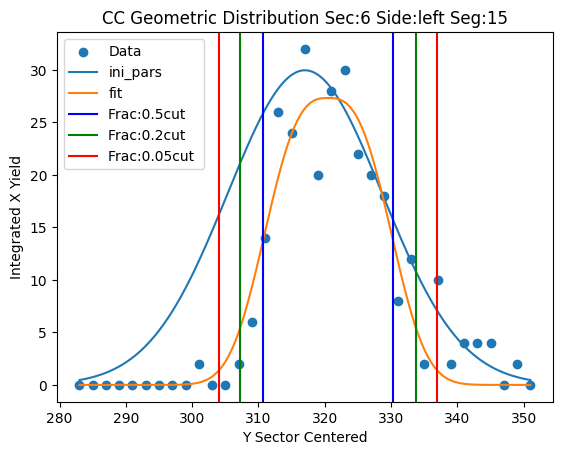

Parameters for Sec:6 Side:left Seg:16
test pars [ 27.32466129 339.           8.91310765   2.83358815]
fit pars [ 23.40000001 345.95918905   7.7819939   95.93850011]



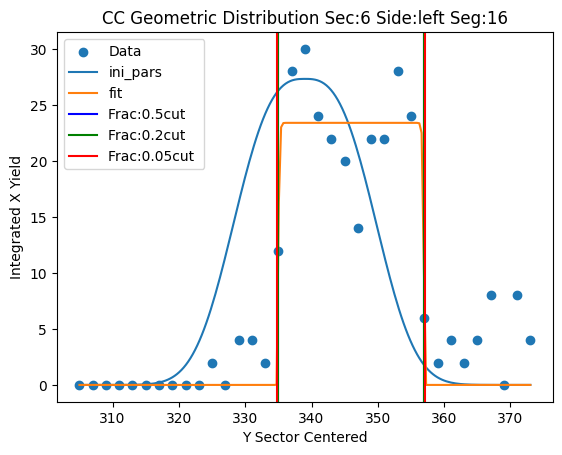

Parameters for Sec:6 Side:left Seg:17
test pars [ 23.40000001 375.           8.7819939   95.93850011]
fit pars [ 11.         367.71579822   7.60337521 145.2499386 ]



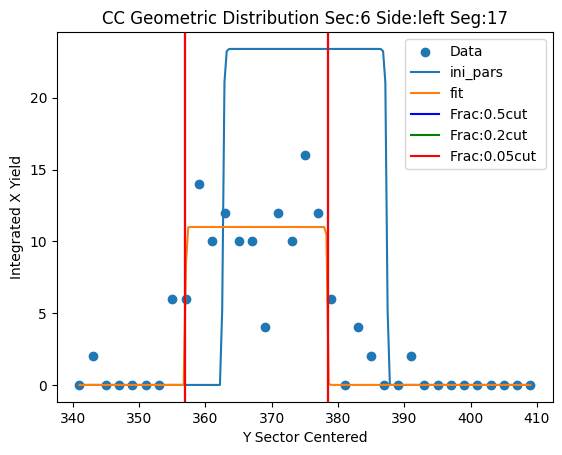

Parameters for Sec:6 Side:left Seg:18
test pars [ 11.         389.           8.60337521 145.2499386 ]
fit pars [  2.54545455 388.99990328   8.35591013 171.80745032]



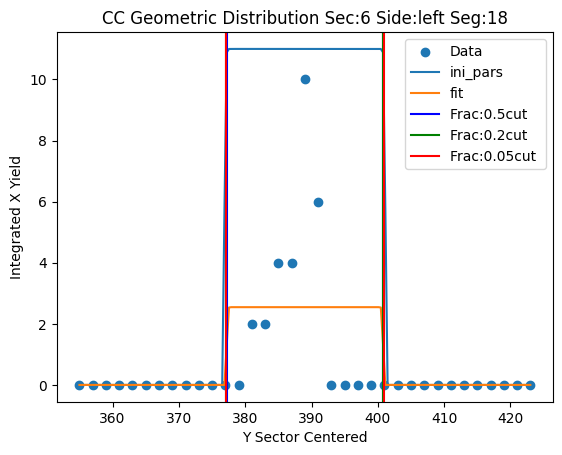

Parameters for Sec:7 Side:right Seg:1
test pars [83. 82. 10.  3.]
fit pars [294.7956002   84.9939381   11.76097161   2.42051602]



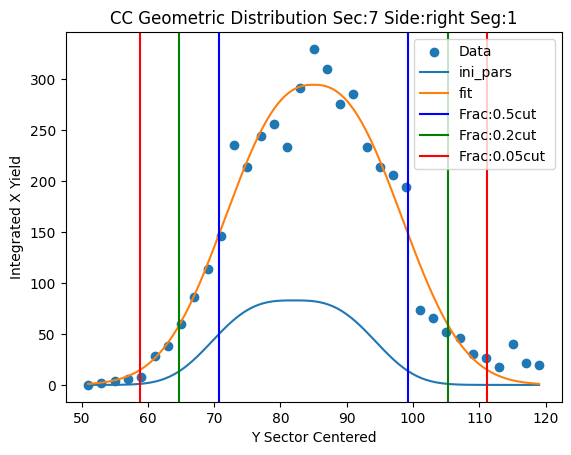

Parameters for Sec:7 Side:right Seg:2
test pars [294.7956002  107.          12.76097161   2.42051602]
fit pars [739.59250705 105.90235675   4.09821721   1.52739331]



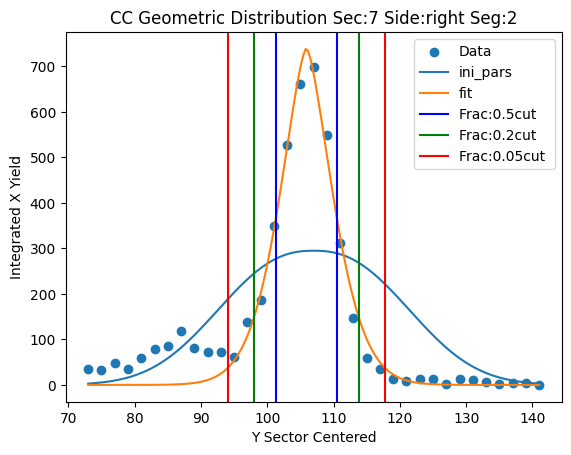

Parameters for Sec:7 Side:right Seg:3
test pars [739.59250705 119.           5.09821721   1.52739331]
fit pars [1170.74996935  117.36089888    8.17058354    1.60185665]



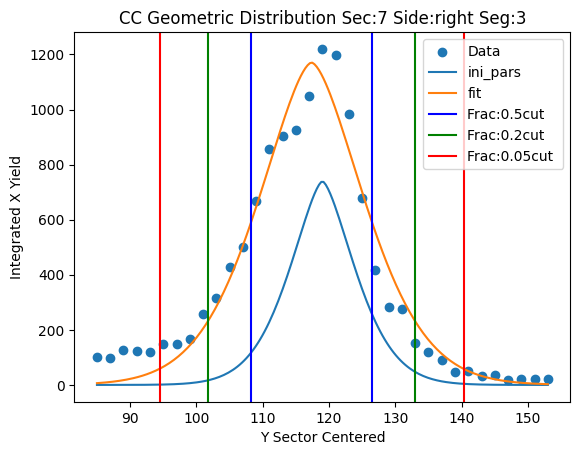

Parameters for Sec:7 Side:right Seg:4
test pars [1170.74996935  129.            9.17058354    1.60185665]
fit pars [996.3992239  131.38439162   7.67474502   2.57003857]



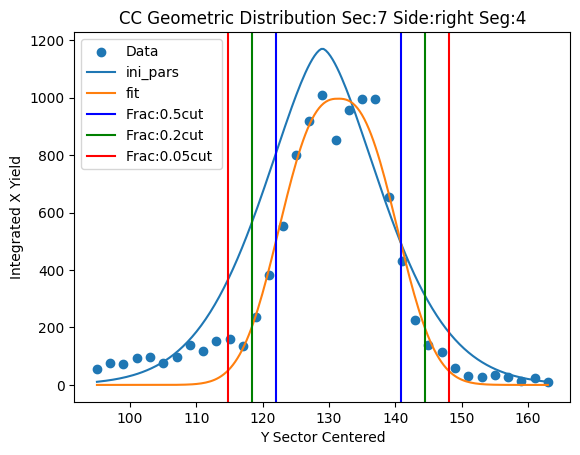

Parameters for Sec:7 Side:right Seg:5
test pars [996.3992239  149.           8.67474502   2.57003857]
fit pars [987.75146645 147.01194218   7.25575338   3.09974688]



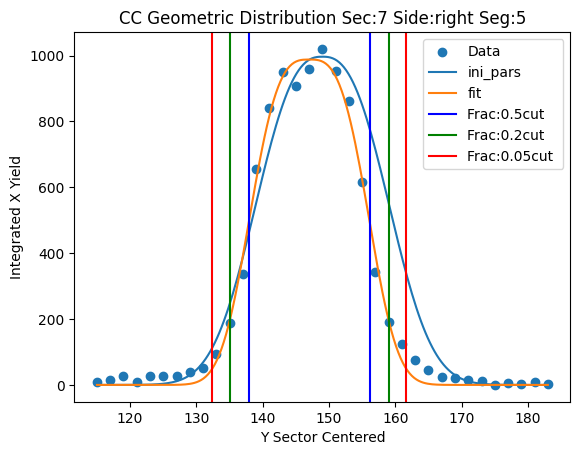

Parameters for Sec:7 Side:right Seg:6
test pars [987.75146645 161.           8.25575338   3.09974688]
fit pars [959.15954907 163.9428409    7.8123117    2.47422178]



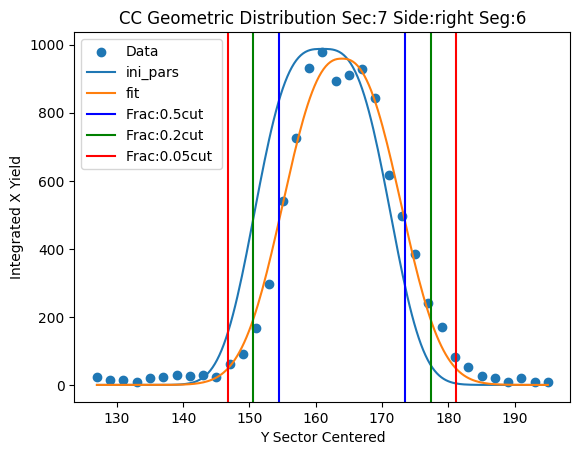

Parameters for Sec:7 Side:right Seg:7
test pars [959.15954907 183.           8.8123117    2.47422178]
fit pars [834.78301165 181.80709672   7.88331298   2.377732  ]



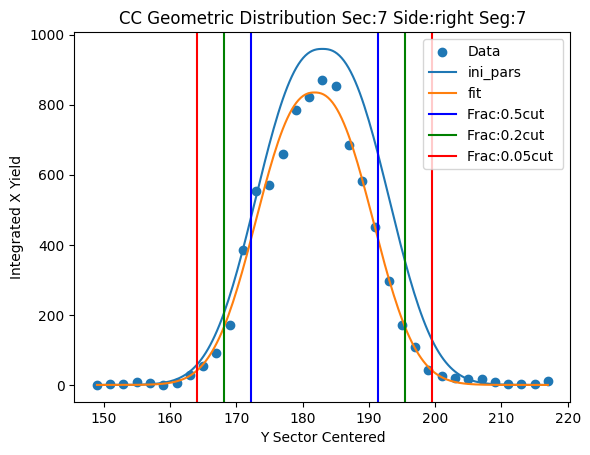

Parameters for Sec:7 Side:right Seg:8
test pars [834.78301165 199.           8.88331298   2.377732  ]
fit pars [831.80744159 198.8906155    7.09137074   2.31745608]



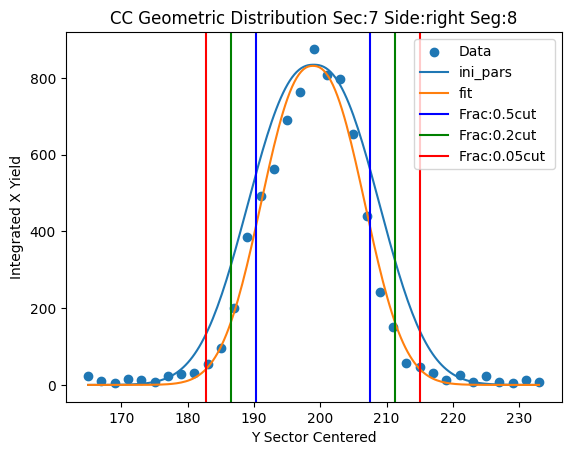

Parameters for Sec:7 Side:right Seg:9
test pars [831.80744159 217.           8.09137074   2.31745608]
fit pars [687.75397534 214.63473774   6.70719579   2.24631871]



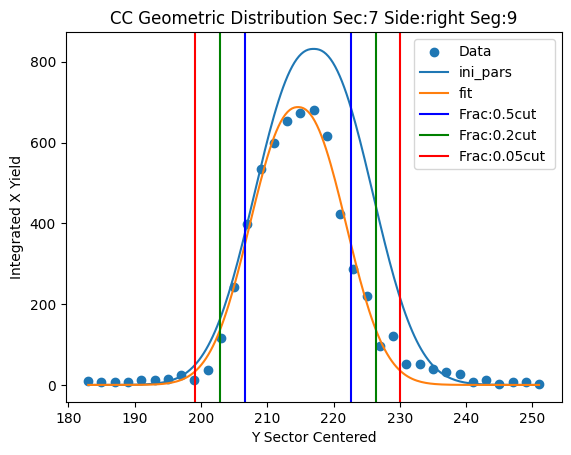

Parameters for Sec:7 Side:right Seg:10
test pars [687.75397534 227.           7.70719579   2.24631871]
fit pars [576.34730105 229.43537068   6.85025266   1.52731989]



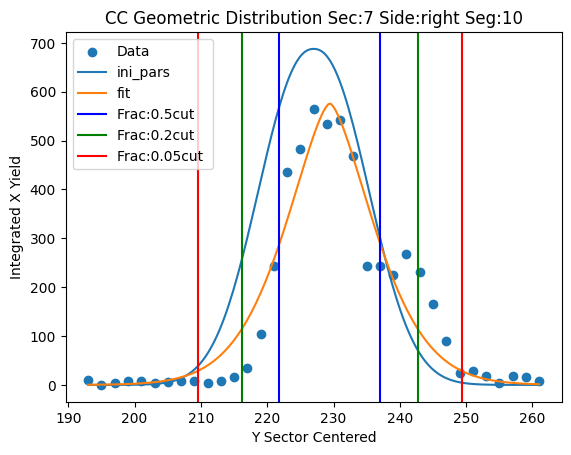

Parameters for Sec:7 Side:right Seg:11
test pars [576.34730105 251.           7.85025266   1.52731989]
fit pars [444.41850566 249.82198474   9.22023817   1.76038932]



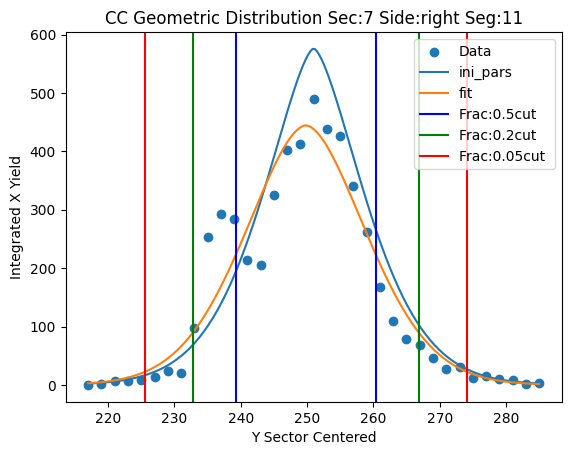

Parameters for Sec:7 Side:right Seg:12
test pars [444.41850566 267.          10.22023817   1.76038932]
fit pars [371.28882093 267.43284567   7.26287302   1.29082887]



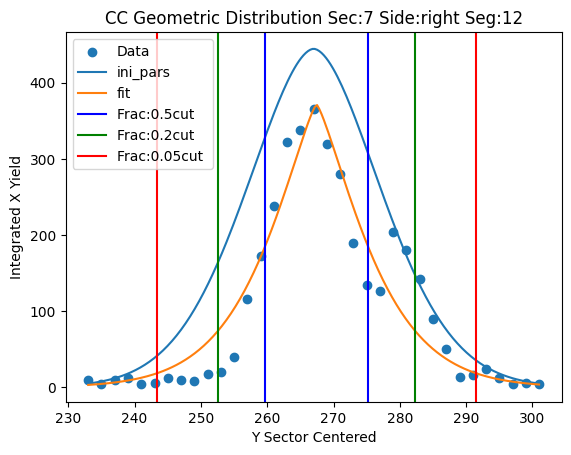

Parameters for Sec:7 Side:right Seg:13
test pars [371.28882093 295.           8.26287302   1.29082887]
fit pars [258.80169043 289.81372966  12.42222064   2.49636201]



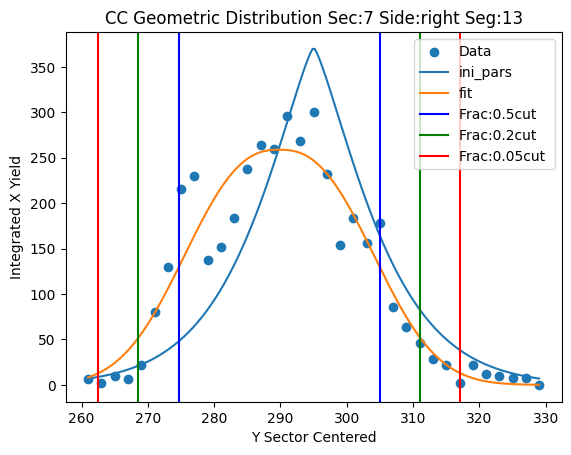

Parameters for Sec:7 Side:right Seg:14
test pars [258.80169043 317.          13.42222064   2.49636201]
fit pars [194.83060765 316.57763728  10.67814317   2.15946727]



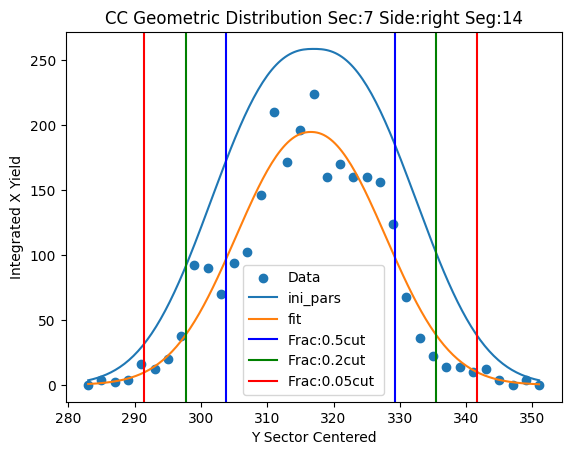

Parameters for Sec:7 Side:right Seg:15
test pars [194.83060765 335.          11.67814317   2.15946727]
fit pars [157.47863853 340.18812911   9.72811369   2.35394951]



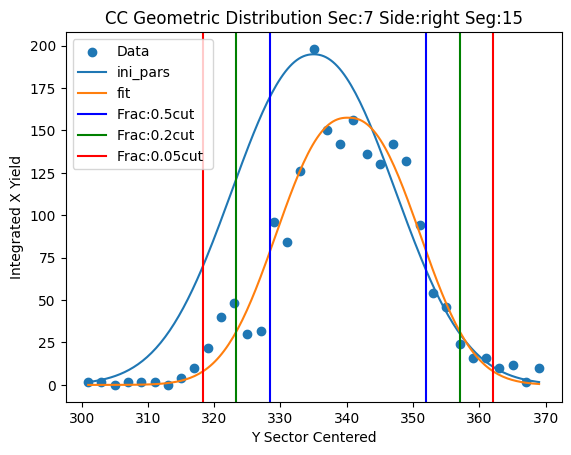

Parameters for Sec:7 Side:right Seg:16
test pars [157.47863853 361.          10.72811369   2.35394951]
fit pars [118.04601833 363.47372215   9.83524961   2.55081538]



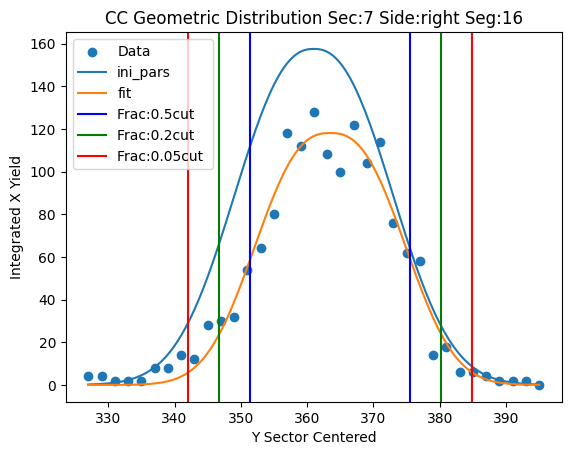

Parameters for Sec:7 Side:right Seg:17
test pars [118.04601833 387.          10.83524961   2.55081538]
fit pars [ 93.60320033 379.83407208   7.65474786   1.2353558 ]



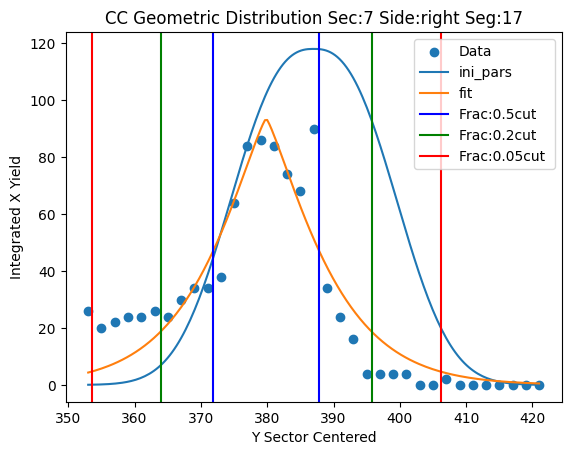

Parameters for Sec:7 Side:right Seg:18
test pars [ 93.60320033 341.           8.65474786   1.2353558 ]
fit pars [2.66234962e+01 3.40999999e+02 2.64192457e+01 1.87086295e-01]



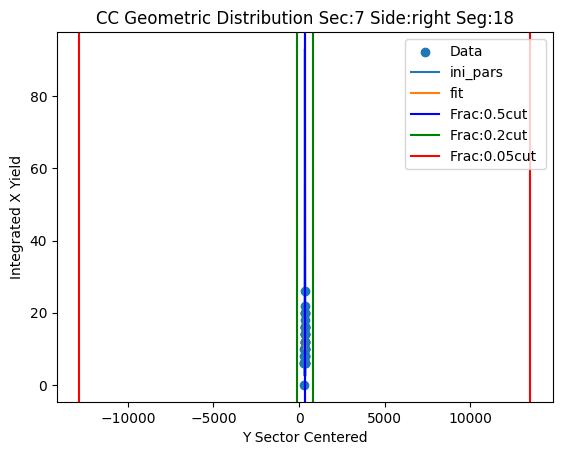

Parameters for Sec:7 Side:coinc Seg:1
test pars [40. 97. 19.  6.]
fit pars [238.34349872  88.37472778  12.53992159   4.47011795]



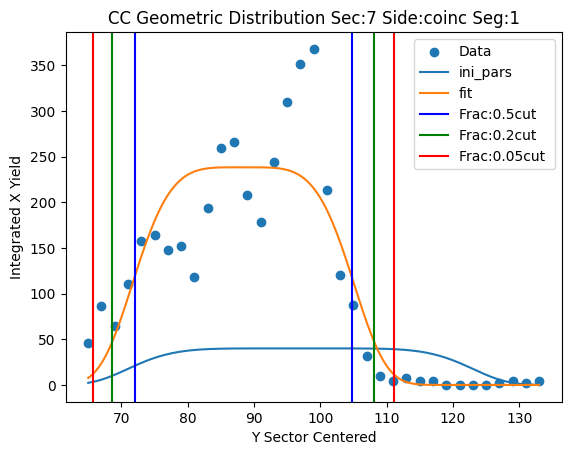

Parameters for Sec:7 Side:coinc Seg:2
test pars [238.34349872 103.          13.53992159   4.47011795]
fit pars [693.1338804  103.24881452   6.37887606   1.06894863]



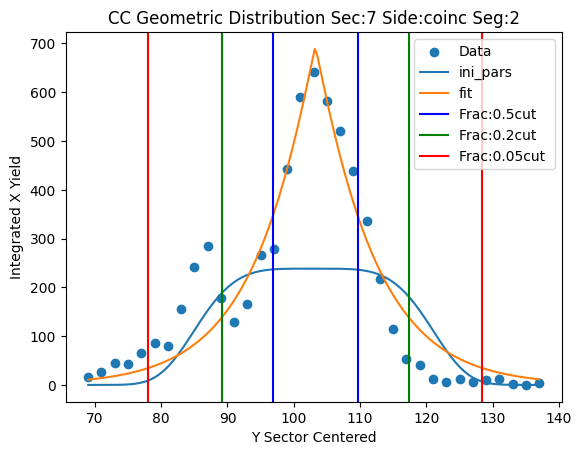

Parameters for Sec:7 Side:coinc Seg:3
test pars [693.1338804  117.           7.37887606   1.06894863]
fit pars [537.29321797 118.28137502   6.61919119   1.50679835]



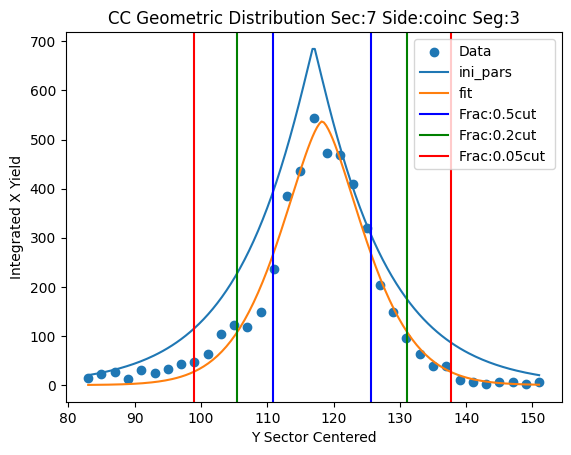

Parameters for Sec:7 Side:coinc Seg:4
test pars [537.29321797 137.           7.61919119   1.50679835]
fit pars [273.86933679 134.81491714   7.22837106   1.97235019]



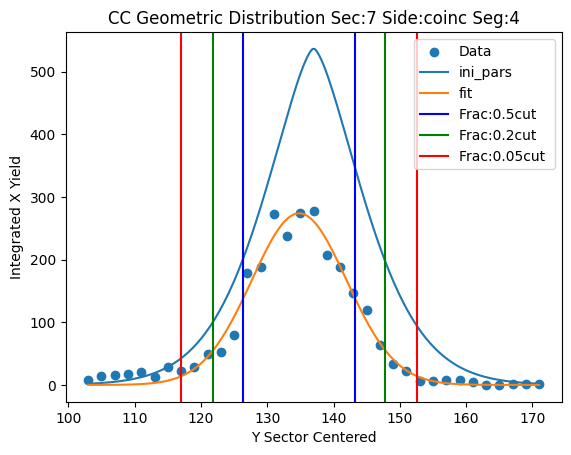

Parameters for Sec:7 Side:coinc Seg:5
test pars [273.86933679 147.           8.22837106   1.97235019]
fit pars [188.41683103 150.13343422   7.84444928   2.61446605]



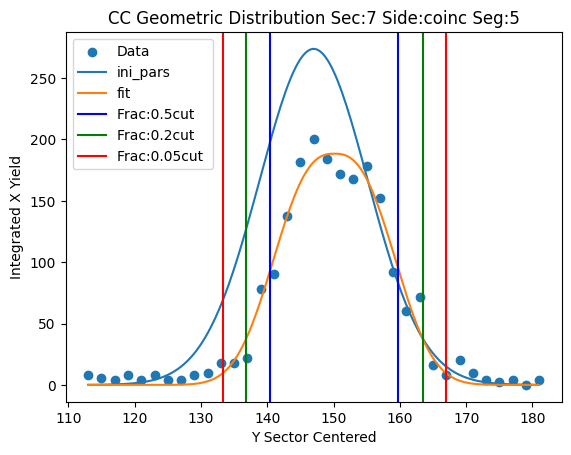

Parameters for Sec:7 Side:coinc Seg:6
test pars [188.41683103 169.           8.84444928   2.61446605]
fit pars [154.06922981 166.83025582   7.40953331   2.11248553]



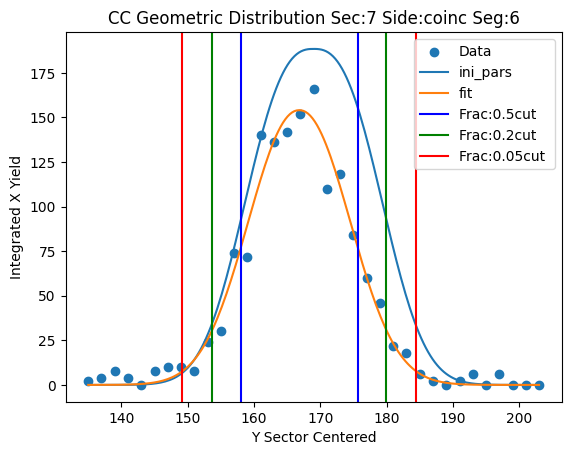

Parameters for Sec:7 Side:coinc Seg:7
test pars [154.06922981 181.           8.40953331   2.11248553]
fit pars [101.42169129 184.69626231   8.37974798   2.00842992]



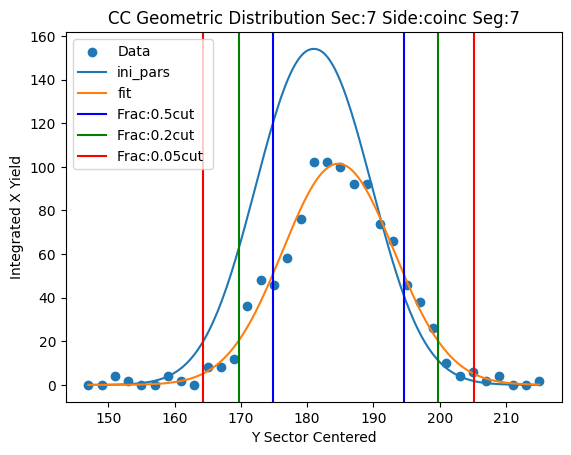

Parameters for Sec:7 Side:coinc Seg:8
test pars [101.42169129 197.           9.37974798   2.00842992]
fit pars [ 81.57211708 200.9997296    7.45483673   2.03325184]



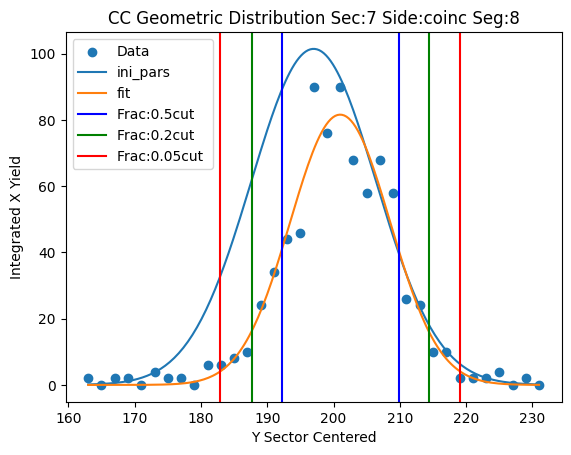

Parameters for Sec:7 Side:coinc Seg:9
test pars [ 81.57211708 217.           8.45483673   2.03325184]
fit pars [ 72.26275133 217.19147325   5.5982415    1.16053479]



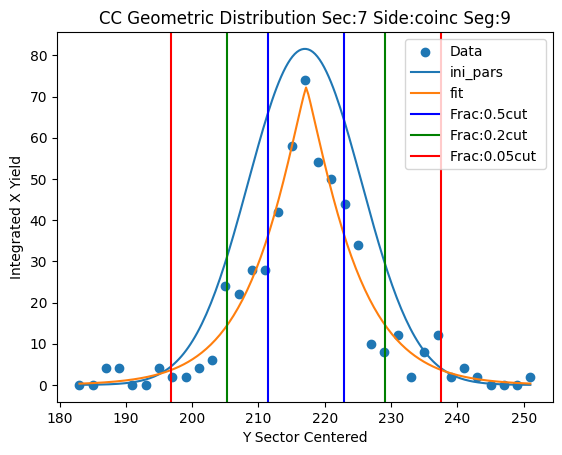

Parameters for Sec:7 Side:coinc Seg:10
test pars [ 72.26275133 227.           6.5982415    1.16053479]
fit pars [ 37.00196527 233.33373889   9.14670036   4.45162278]



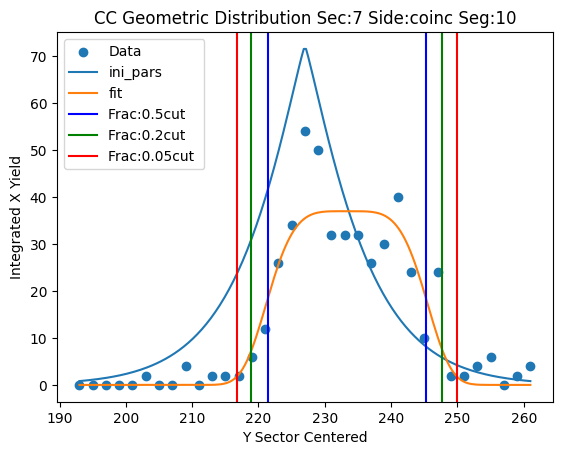

Parameters for Sec:7 Side:coinc Seg:11
test pars [ 37.00196527 253.          10.14670036   4.45162278]
fit pars [ 24.28839625 251.4174168   11.58207188   1.49491291]



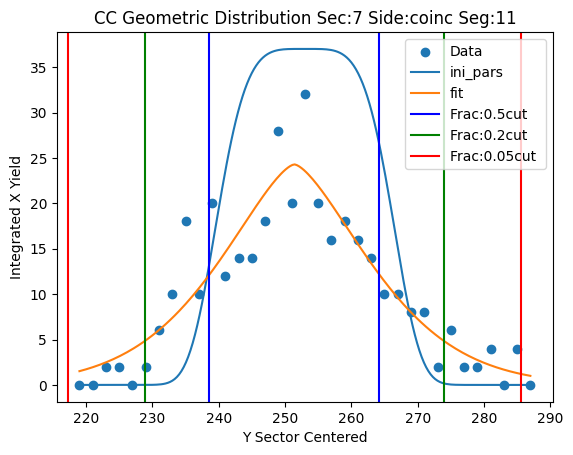

Parameters for Sec:7 Side:coinc Seg:12
test pars [ 24.28839625 265.          12.58207188   1.49491291]
fit pars [ 14.40712391 272.61387607  13.28593628   3.89498808]



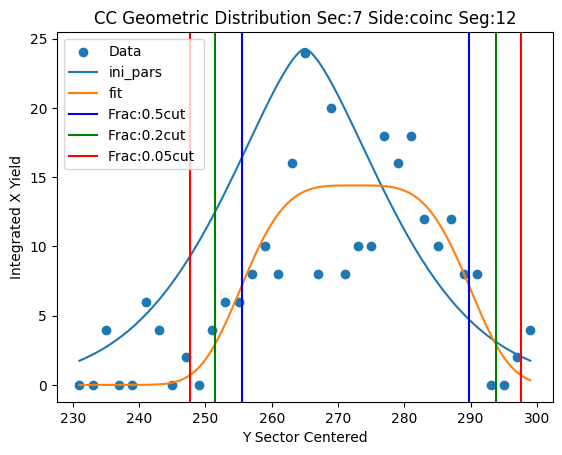

Parameters for Sec:7 Side:coinc Seg:13
test pars [ 14.40712391 291.          14.28593628   3.89498808]
fit pars [ 16.911345   295.69768682  12.12960601   2.45624218]



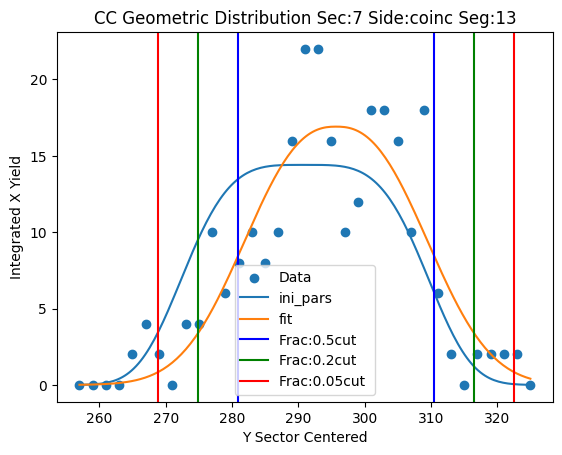

Parameters for Sec:7 Side:coinc Seg:14
test pars [ 16.911345   315.          13.12960601   2.45624218]
fit pars [  9.43567031 318.3955241    9.14976088   1.16853138]



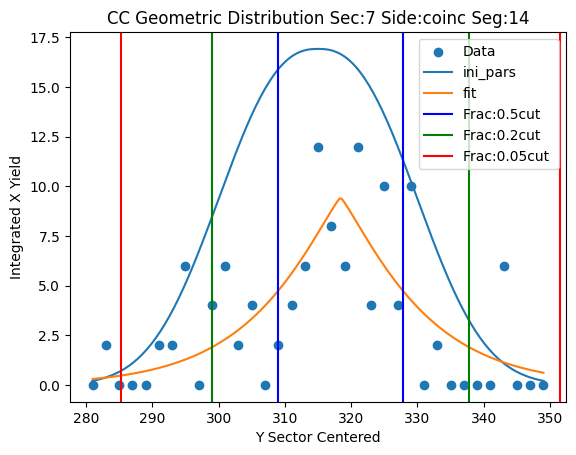

Parameters for Sec:7 Side:coinc Seg:15
test pars [  9.43567031 343.          10.14976088   1.16853138]
fit pars [ 12.0055937  340.73032977   7.63009947   1.71783636]



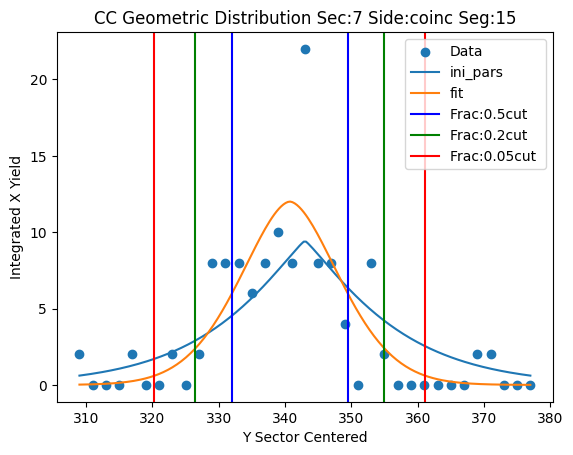

Parameters for Sec:7 Side:coinc Seg:16
test pars [ 12.0055937  365.           8.63009947   1.71783636]
fit pars [  4.97181566 364.99999444   5.50346532   0.54564969]



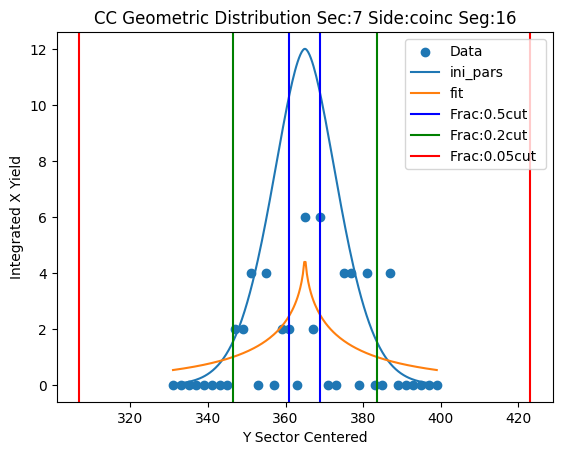

Parameters for Sec:7 Side:coinc Seg:17
test pars [  4.97181566 379.           6.50346532   0.54564969]
fit pars [  3.00000001 382.19237853   3.47257779  42.44239021]



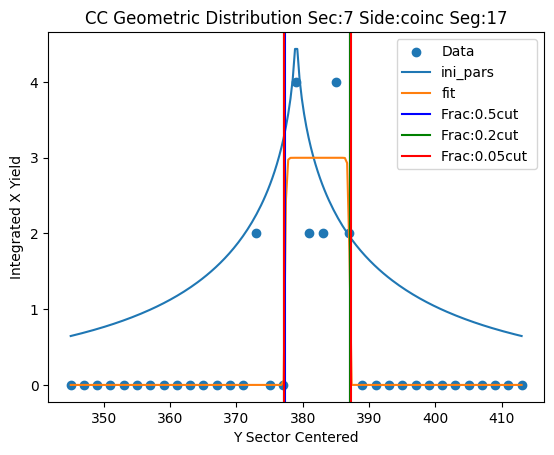

Parameters for Sec:7 Side:left Seg:1
test pars [19. 83. 13.  5.]
fit pars [95.15074801 83.23621846 14.05534151  9.29512829]



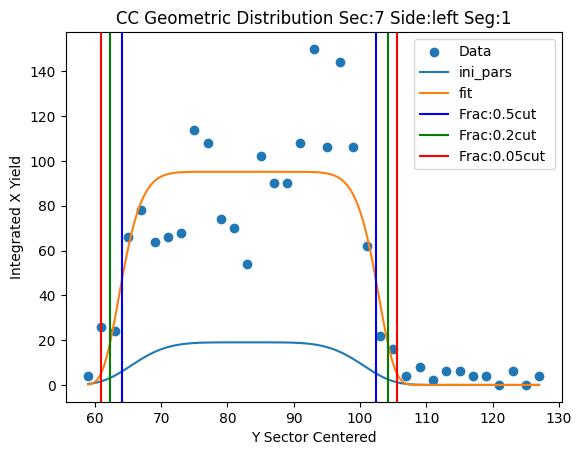

Parameters for Sec:7 Side:left Seg:2
test pars [ 95.15074801 107.          15.05534151   9.29512829]
fit pars [751.08229944 105.40794584   5.12088238   1.68365996]



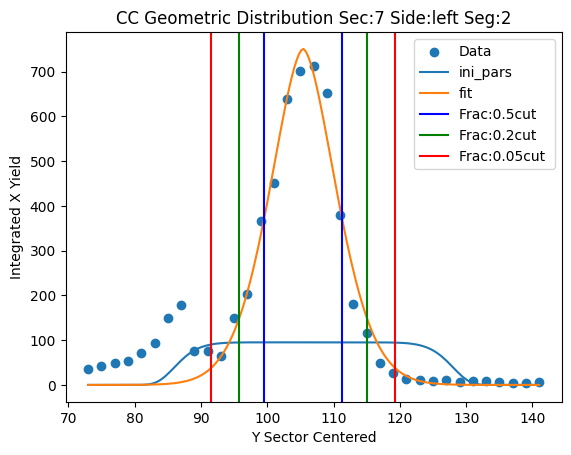

Parameters for Sec:7 Side:left Seg:3
test pars [751.08229944 119.           6.12088238   1.68365996]
fit pars [1166.46009169  117.37318455    6.56209755    2.46414559]



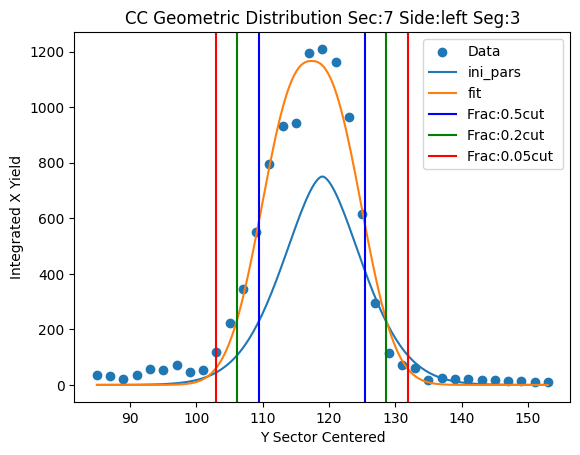

Parameters for Sec:7 Side:left Seg:4
test pars [1166.46009169  131.            7.56209755    2.46414559]
fit pars [1165.65481072  132.2092084     7.21524784    2.49777233]



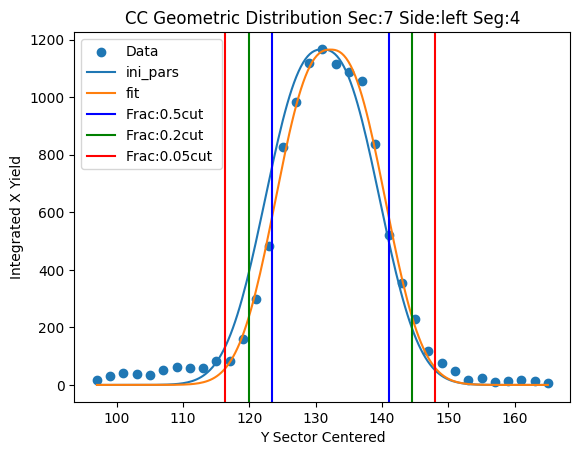

Parameters for Sec:7 Side:left Seg:5
test pars [1165.65481072  149.            8.21524784    2.49777233]
fit pars [1097.83253983  147.86467315    7.44431572    2.64769893]



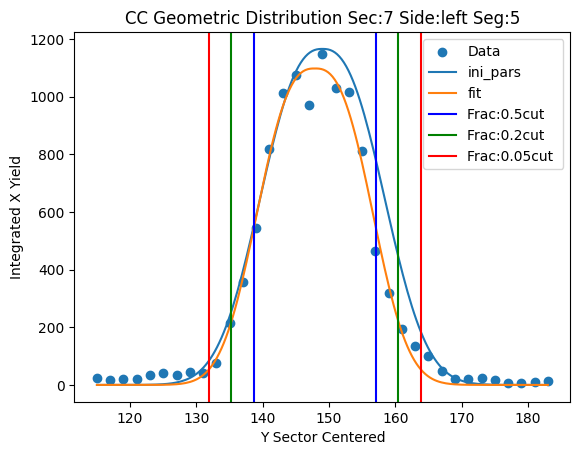

Parameters for Sec:7 Side:left Seg:6
test pars [1097.83253983  167.            8.44431572    2.64769893]
fit pars [1105.74828751  164.56013713    7.28916583    2.10286292]



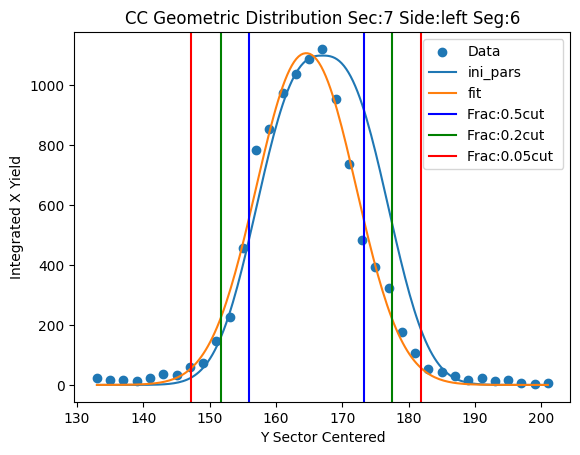

Parameters for Sec:7 Side:left Seg:7
test pars [1105.74828751  183.            8.28916583    2.10286292]
fit pars [985.89696206 182.37255774   7.78662069   2.25072633]



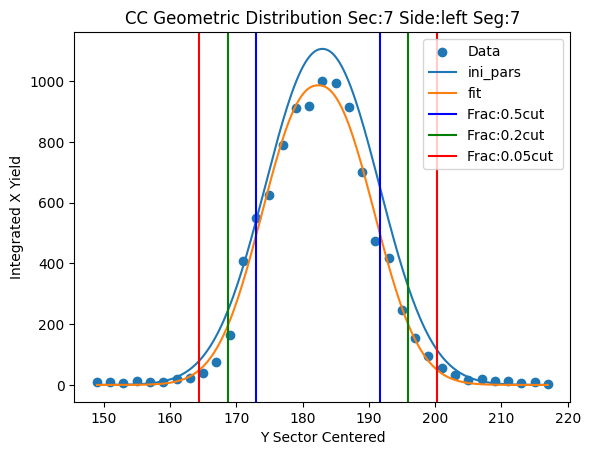

Parameters for Sec:7 Side:left Seg:8
test pars [985.89696206 199.           8.78662069   2.25072633]
fit pars [891.61554925 199.79472128   7.31519841   2.24437429]



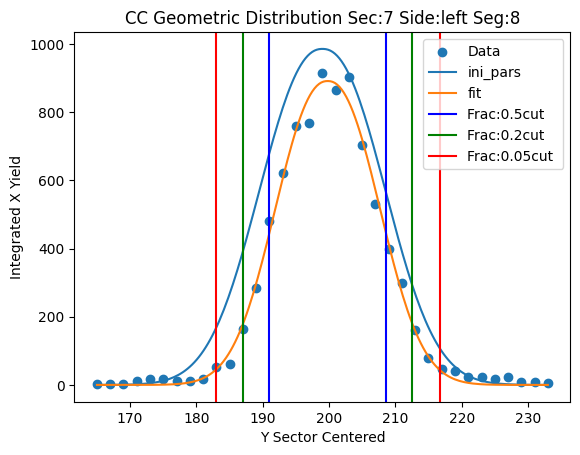

Parameters for Sec:7 Side:left Seg:9
test pars [891.61554925 215.           8.31519841   2.24437429]
fit pars [719.85409764 216.14314073   6.49809164   1.99328878]



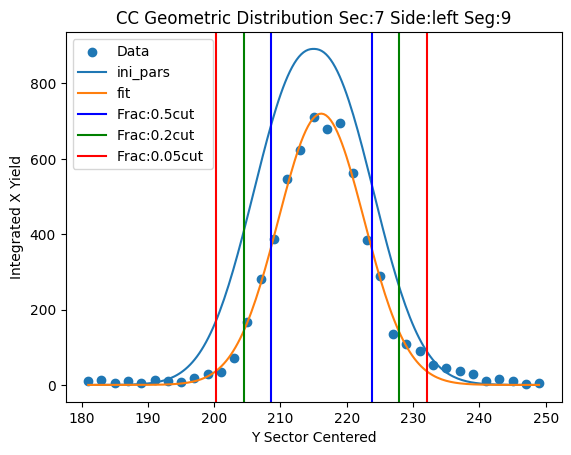

Parameters for Sec:7 Side:left Seg:10
test pars [719.85409764 231.           7.49809164   1.99328878]
fit pars [501.09215301 230.9242453    7.0330698    1.47805   ]



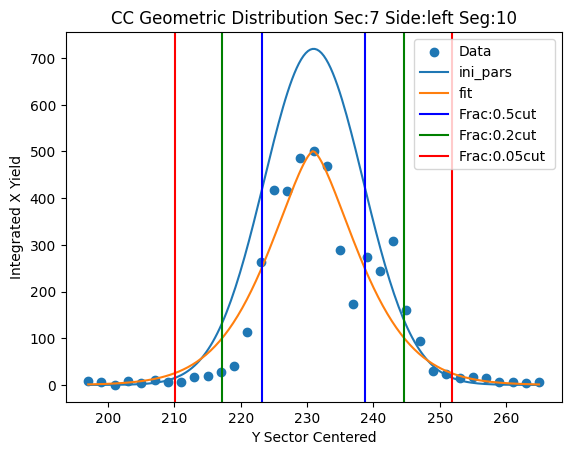

Parameters for Sec:7 Side:left Seg:11
test pars [501.09215301 251.           8.0330698    1.47805   ]
fit pars [392.15830404 250.47621906   9.12506705   1.63567965]



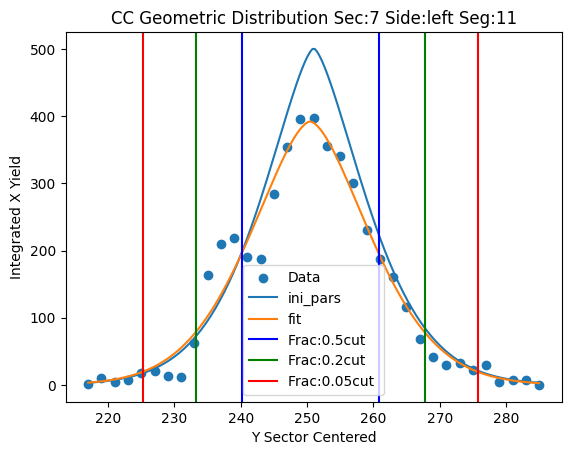

Parameters for Sec:7 Side:left Seg:12
test pars [392.15830404 269.          10.12506705   1.63567965]
fit pars [269.08239437 269.34677228  11.06005193   1.80694473]



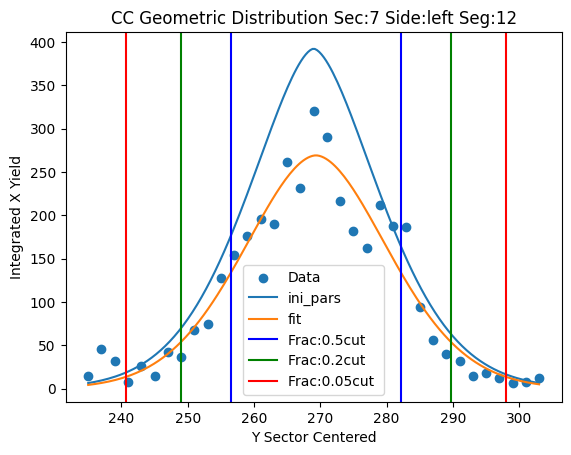

Parameters for Sec:7 Side:left Seg:13
test pars [269.08239437 293.          12.06005193   1.80694473]
fit pars [264.04922491 292.44327036  11.76127957   1.46500334]



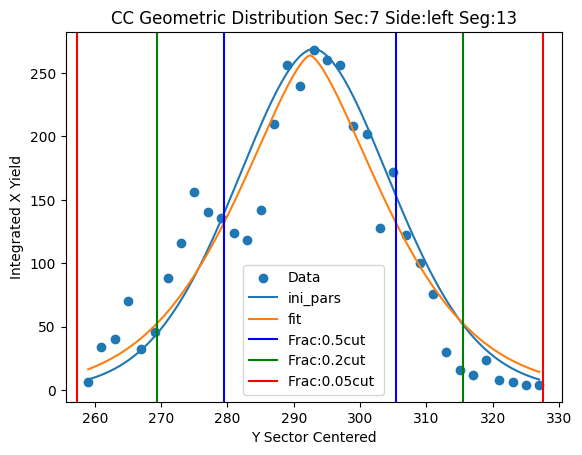

Parameters for Sec:7 Side:left Seg:14
test pars [264.04922491 317.          12.76127957   1.46500334]
fit pars [194.18551465 316.50083735  10.6796505    1.57451509]



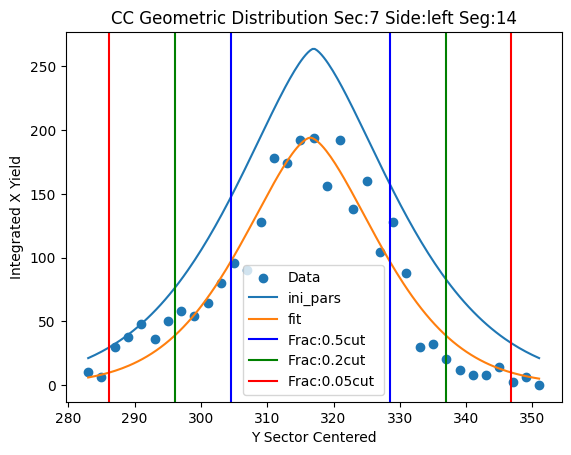

Parameters for Sec:7 Side:left Seg:15
test pars [194.18551465 337.          11.6796505    1.57451509]
fit pars [126.34242952 338.75775714  11.95602449   2.15826358]



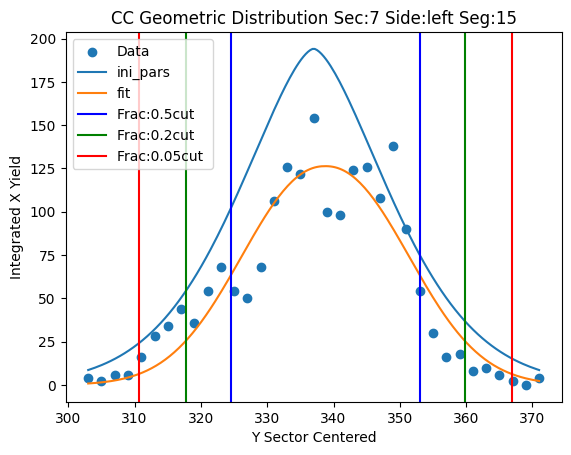

Parameters for Sec:7 Side:left Seg:16
test pars [126.34242952 357.          12.95602449   2.15826358]
fit pars [106.27574298 360.88542501  11.47738282   2.18687833]



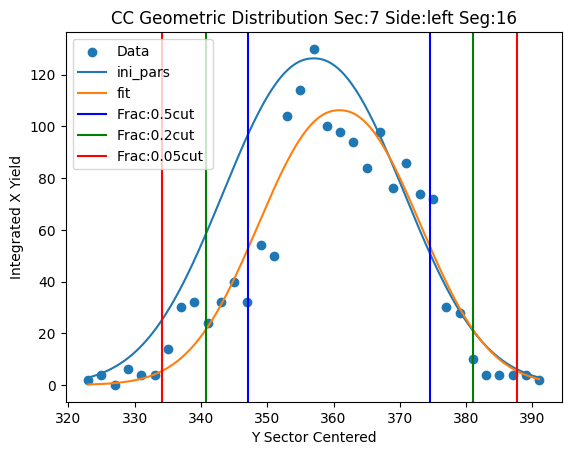

Parameters for Sec:7 Side:left Seg:17
test pars [106.27574298 383.          12.47738282   2.18687833]
fit pars [ 75.47503839 380.15692612   7.25138739   2.06623667]



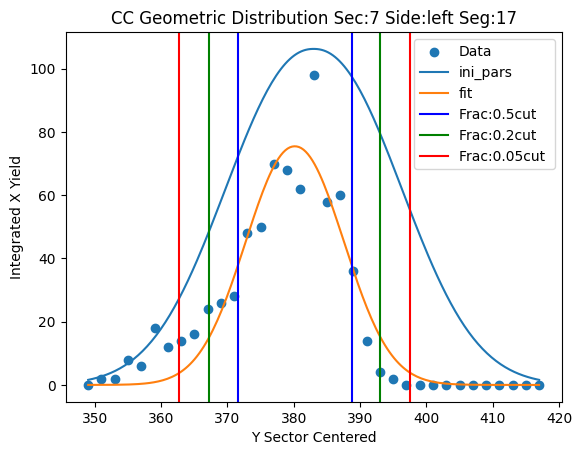

Parameters for Sec:7 Side:left Seg:18
test pars [ 75.47503839 389.           8.25138739   2.06623667]
fit pars [ 27.20622696 389.7842138    1.65885257   0.73542001]



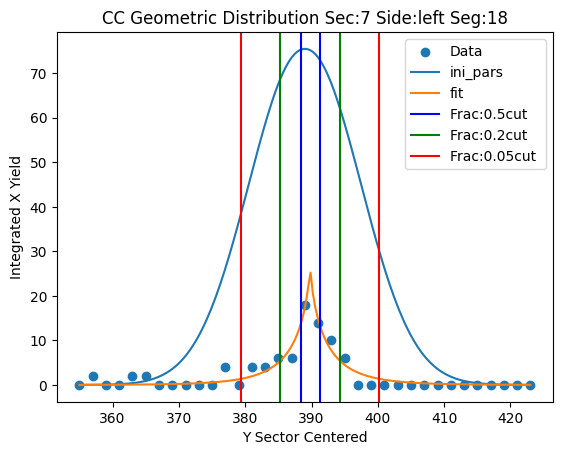

In [74]:
cut_lines = np.zeros((7,cut_hist_len,3,2))

low = 0.0
high = 0.0
space = 35

#Super_Gaus(x,a_,m_,s_,p_)


fit_pars = np.zeros((7,cut_hist_len,4))

ini_par = [83., 82, 10,   3,]
ini_par1 = [40, 97,  19,  6,]
ini_par2=[19., 83., 13.,  5.]


test_pars = np.zeros(4)

frac_cut = [0.5,0.2,0.05]

paddle_expand = 30

par_bounds = [[0.0,0.0,0.0,0.0],[np.inf,np.inf,np.inf,np.inf]]


for sec in range(7):
    for i in range(4):
        test_pars[i] = ini_par[i]
    for side in range(3):
        if side == 2:
            for i in range(4):
                test_pars[i] = ini_par2[i]
        elif side == 1:
            for i in range(4):
                test_pars[i] = ini_par1[i]
        for seg in range(num_cc_seg):
            if(Count_Non_Zero(proj_y[sec][cc_hist_idx(side,seg)]) >= 6):
                low = yvals[np.argmax(proj_y[sec][cc_hist_idx(side,seg)])] - space
                high = yvals[np.argmax(proj_y[sec][cc_hist_idx(side,seg)])] + space
                new_yvals = Bounds_on_Y(yvals,low,high)
                new_zvals = Bounds_on_X_From_Y(proj_y[sec][cc_hist_idx(side,seg)],yvals,low,high)
                plt.scatter(new_yvals,new_zvals,label="Data")
                if seg < num_sc_pad:
                    try: 
                        pars, pars_cov = op.curve_fit(Super_Gaus,new_yvals,new_zvals,p0=test_pars,bounds=par_bounds,maxfev=5000)
                        print("Parameters for Sec:{} Side:{} Seg:{}".format(sec+1,sides[side],seg+1))
                        print("test pars",test_pars)
                        print("fit pars",pars)
                        cont_x = np.linspace(new_yvals[0],new_yvals[len(new_yvals)-1],200)
                        plt.plot(cont_x,Super_Gaus(cont_x,*test_pars),label="ini_pars")
                        plt.plot(cont_x,Super_Gaus(cont_x,*pars),label="fit")

                        for j in range(4):
                            test_pars[j] = pars[j]
                            if j == 1:
                                if seg == num_cc_seg-1:
                                    test_pars[j]=yvals[np.argmax(proj_y[sec][cc_hist_idx(side,seg)])]
                                else:
                                    test_pars[j]=yvals[np.argmax(proj_y[sec][cc_hist_idx(side,seg+1)])]
                            if j == 2:
                                test_pars[j]+=1.
                            fit_pars[sec][hist_idx][j] = pars[j]
                        #if hist_idx == paddle_expand:
                        #    test_pars[2]+=3
                        for k in range(3):
                            cut_lines[sec][cc_hist_idx(side,seg)][k][0] = super_gaus_cut_bound(frac_cut[k],0,*pars)
                            cut_lines[sec][cc_hist_idx(side,seg)][k][1] = super_gaus_cut_bound(frac_cut[k],1,*pars)
                            plt.axvline(x=cut_lines[sec][cc_hist_idx(side,seg)][k][0],color=color_order[k],label="Frac:{}cut ".format(frac_cut[k]))
                            plt.axvline(x=cut_lines[sec][cc_hist_idx(side,seg)][k][1],color=color_order[k])
                        print()
                    except RuntimeError:
                        print("Runtime Error")
                    except ValueError:
                        print("Value Error")
                plt.title("CC Geometric Distribution Sec:{} Side:{} Seg:{}".format(sec+1,sides[side],seg+1))
                plt.ylabel("Integrated X Yield")
                plt.xlabel("Y Sector Centered")
                plt.legend()
                plt.show()


In [75]:
#lt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),color=color_order[cut])
cut = 2


left_bound = [[(cut_lines[sec][cc_hist_idx(2,seg)][cut][1]-left_cut_pars[sec][cut][0])/left_cut_pars[sec][cut][1] for seg in range(num_cc_seg)] for sec in range(6)]
right_bound = [[(cut_lines[sec][cc_hist_idx(0,seg)][cut][1]-right_cut_pars[sec][cut][0])/right_cut_pars[sec][cut][1] for seg in range(num_cc_seg)] for sec in range(6)]

coinc_x_bounds = [[[left_bound[sec][seg]-10,right_bound[sec][seg]+10] for seg in range(num_cc_seg)] for sec in range(6)]



low,high -40 40
Parameters for Sec:1 Side:coinc Seg:1
test pars [83.  0. 10.  3.]
fit pars [5.48516513e+01 3.36113755e-38 9.36521519e+00 1.47073382e+00]


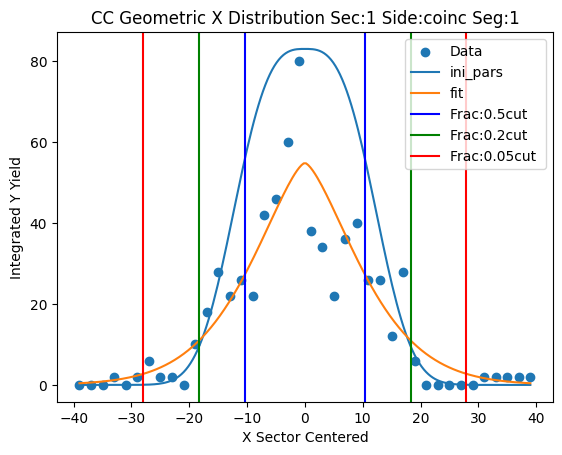

low,high -40 40
Value Error
Parameters for Sec:1 Side:coinc Seg:2
test pars [212.   0.  40.   3.]
fit pars [1.70996675e+05 4.66810510e-32 3.05539754e-08 1.13030837e-01]


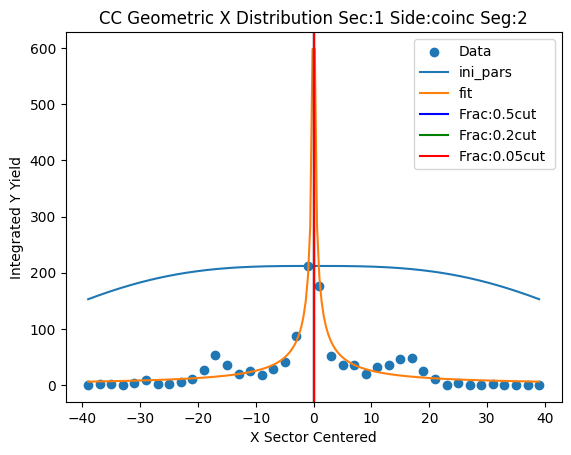

low,high -10 10
Value Error
Parameters for Sec:1 Side:coinc Seg:3
test pars [164.   0.  10.   3.]
fit pars [2.54787415e+03 7.99159514e-40 1.49456424e-02 2.71737952e-01]


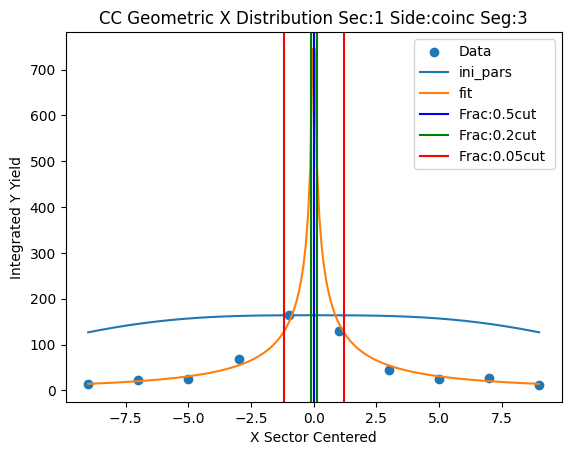

low,high -10 10
Value Error
Parameters for Sec:1 Side:coinc Seg:4
test pars [100.   0.  10.   3.]
fit pars [7.08983023e+02 2.69224543e-39 1.09459826e-01 3.71402437e-01]


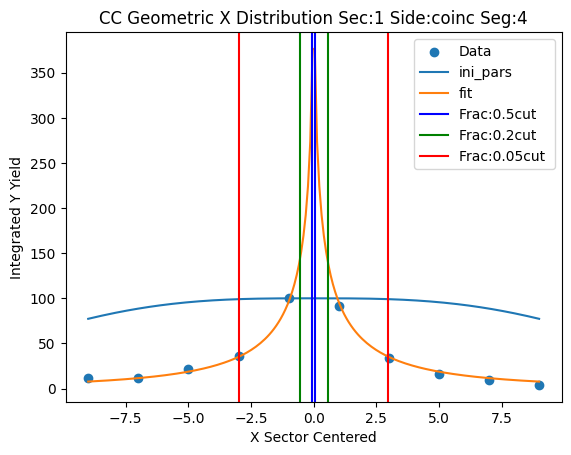

low,high -10 10
Value Error
Parameters for Sec:1 Side:coinc Seg:5
test pars [76.  0. 10.  3.]
fit pars [1.01527406e+02 8.41744809e-42 1.82933109e+00 1.26708618e+00]


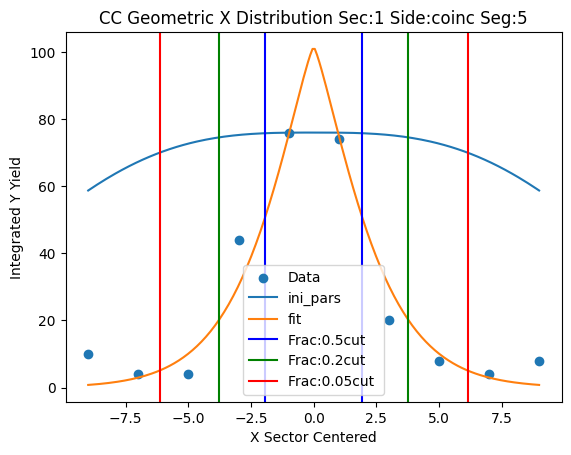

low,high -10 10
Parameters for Sec:1 Side:coinc Seg:6
test pars [101.52740553   1.           2.82933109   1.26708618]
fit pars [150.29060207   0.59684099   0.35733177   0.51972786]


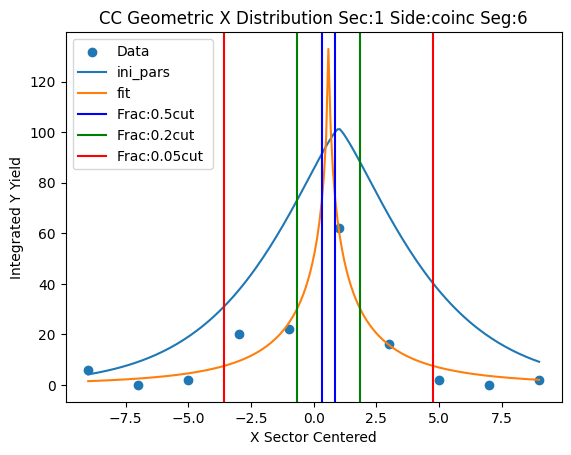

low,high -10 10
Value Error
Parameters for Sec:1 Side:coinc Seg:7
test pars [34.  0. 10.  3.]
fit pars [1.23128687e+02 3.45299613e-39 3.24755756e-01 4.73164522e-01]


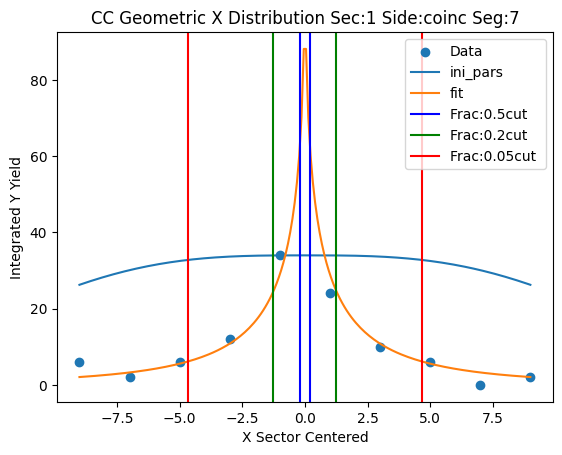

low,high -10 10
Value Error
Parameters for Sec:1 Side:coinc Seg:8
test pars [26.  0. 10.  3.]
fit pars [23.          0.11997485  2.12499732 23.82403033]


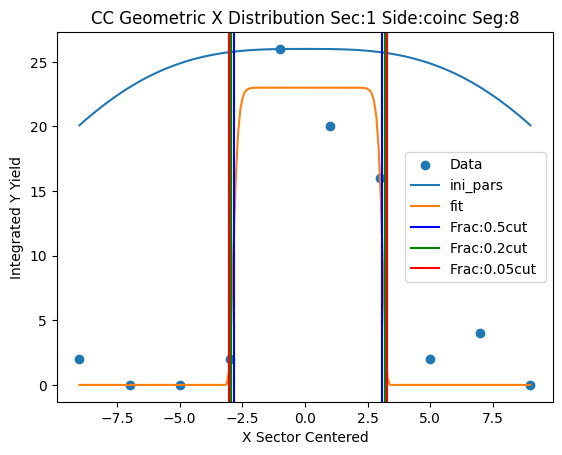

low,high -10 10
Value Error
Parameters for Sec:1 Side:coinc Seg:9
test pars [20.  0. 10.  3.]
fit pars [19.00000002  0.0453657   2.10487225 19.45749707]


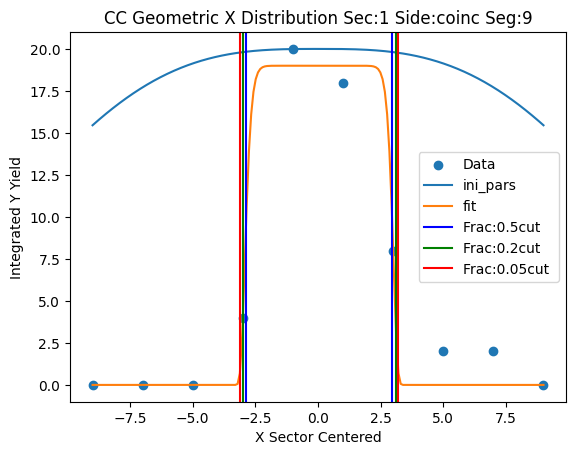

low,high -10 10


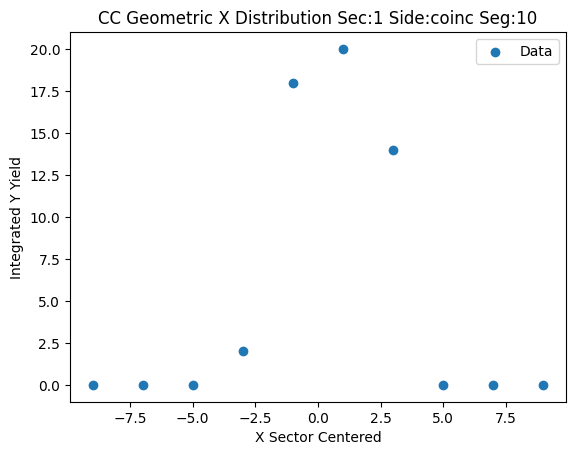

low,high -10 10
Parameters for Sec:1 Side:coinc Seg:11
test pars [19.00000002  1.          3.10487225 19.45749707]
fit pars [2.87398139e+03 4.80297204e-01 1.91820360e-04 2.00849423e-01]


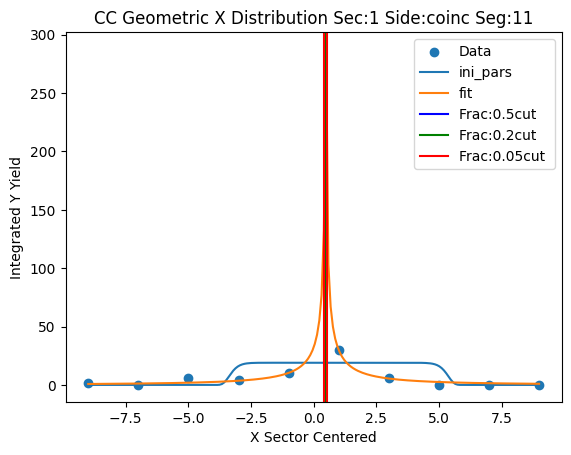

low,high -10 10
Value Error
Parameters for Sec:1 Side:coinc Seg:12
test pars [10.  0. 10.  3.]
fit pars [ 8.50000002  0.04391387  3.53126816 37.12236286]


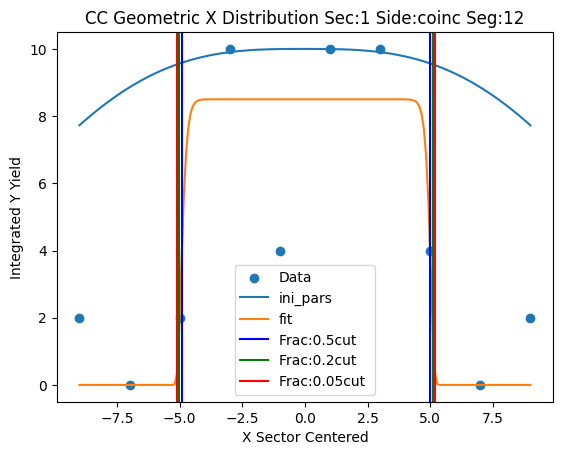

low,high -10 10
Value Error
Parameters for Sec:1 Side:coinc Seg:13
test pars [16.  0. 10.  3.]
fit pars [11.87052537  0.31757892  2.87748441  4.69838868]


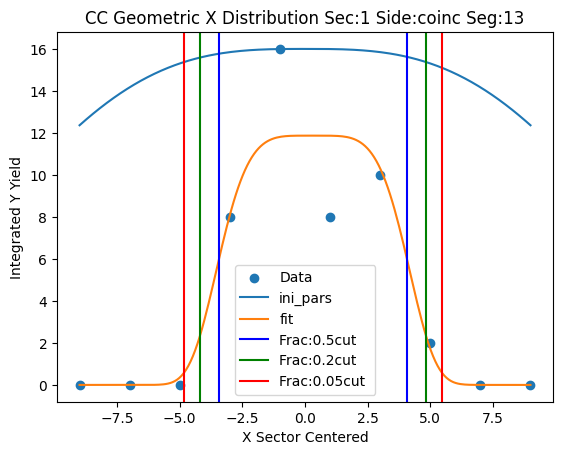

low,high -10 10
Parameters for Sec:1 Side:coinc Seg:14
test pars [11.87052537  1.          3.87748441  4.69838868]
fit pars [36.41328926  0.58993055  0.23468958  0.50074362]


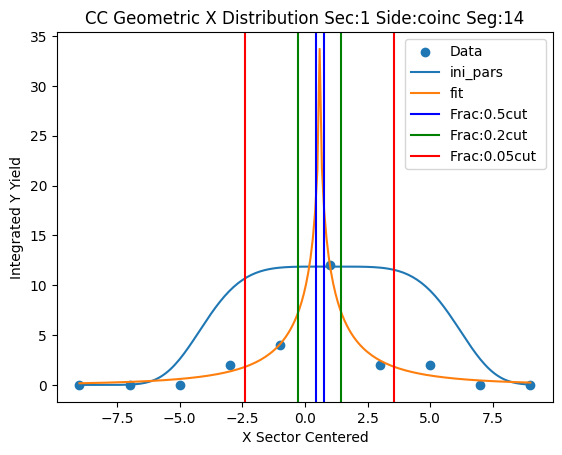

low,high -10 10


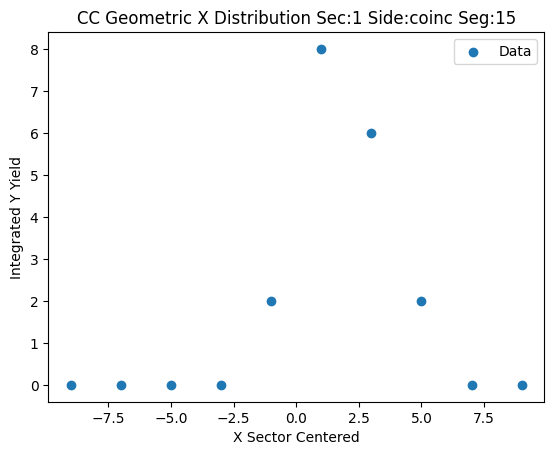

low,high -10 10


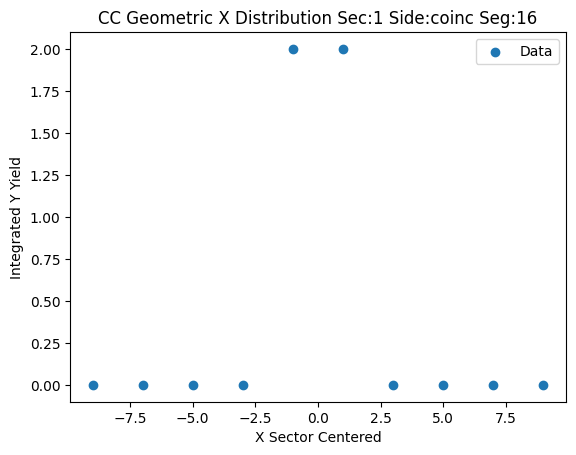

low,high -40 40
Parameters for Sec:2 Side:coinc Seg:1
test pars [83.  0. 10.  3.]
fit pars [3.88795078e+01 7.48844123e-39 1.14827533e+01 2.16862646e+00]


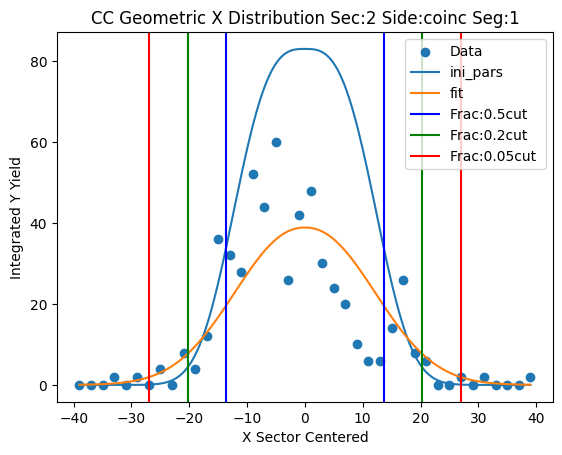

low,high -40 40
Value Error
Parameters for Sec:2 Side:coinc Seg:2
test pars [240.   0.  40.   3.]
fit pars [2.67705493e+04 1.63435103e-02 2.80423692e-05 1.53067572e-01]


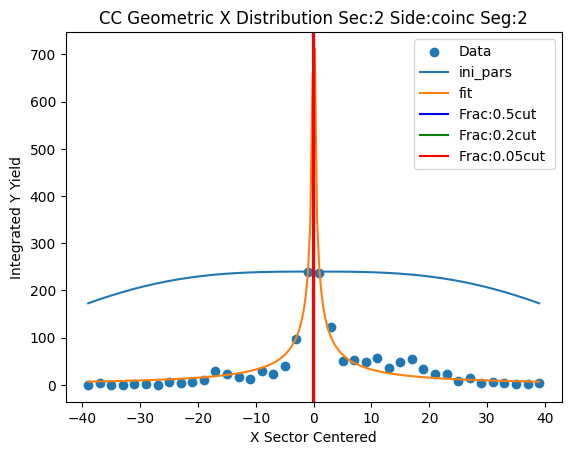

low,high -10 10
Parameters for Sec:2 Side:coinc Seg:3
test pars [2.67705493e+04 1.00000000e+00 1.00002804e+00 1.53067572e-01]
fit pars [2.22801841e+04 1.98071076e+00 4.44380339e-01 3.51306712e+00]


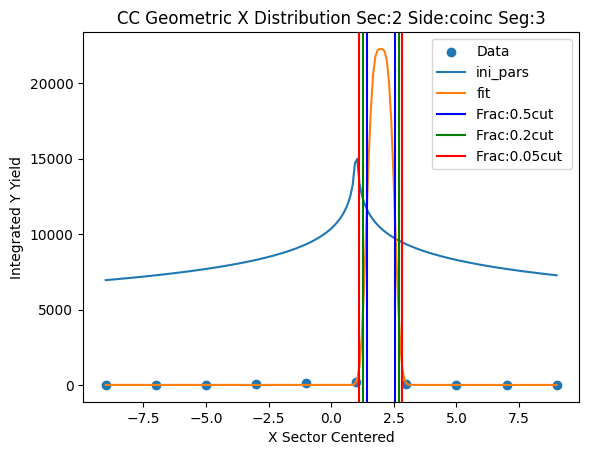

low,high -10 10
Value Error
Parameters for Sec:2 Side:coinc Seg:4
test pars [98.  0. 10.  3.]
fit pars [9.73961353e+01 3.58399976e-34 2.28964653e+00 2.61950361e+00]


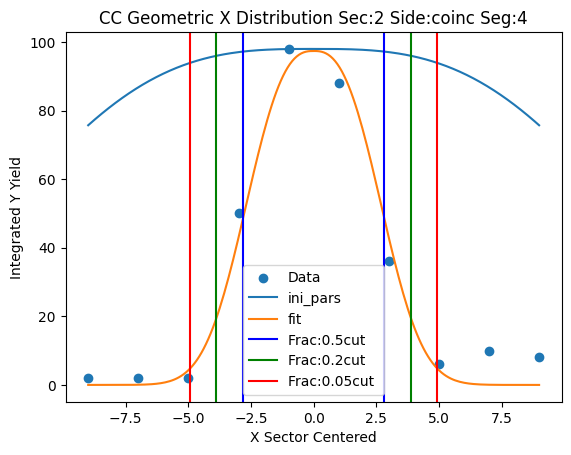

low,high -10 10
Value Error
Parameters for Sec:2 Side:coinc Seg:5
test pars [68.  0. 10.  3.]
fit pars [7.54562685e+01 1.43286989e-40 2.44885543e+00 1.84569514e+00]


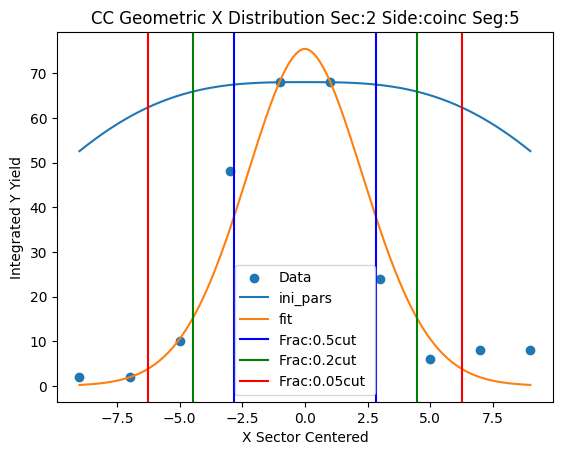

low,high -10 10
Parameters for Sec:2 Side:coinc Seg:6
test pars [75.45626854  1.          3.44885543  1.84569514]
fit pars [62.45960707  1.41883039  2.35861219  2.08528552]


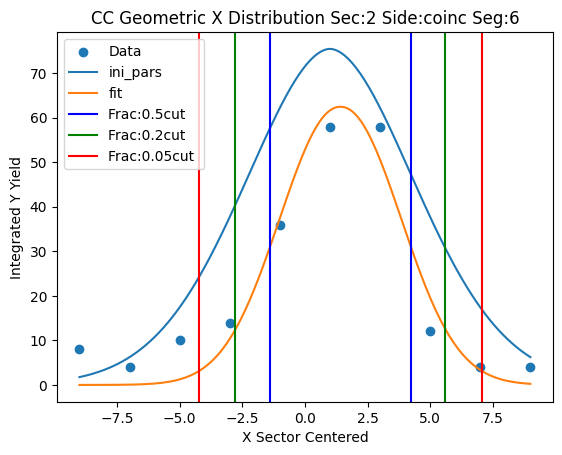

low,high -10 10
Parameters for Sec:2 Side:coinc Seg:7
test pars [62.45960707  1.          3.35861219  2.08528552]
fit pars [62.024214    1.0087968   1.81482147  1.15749378]


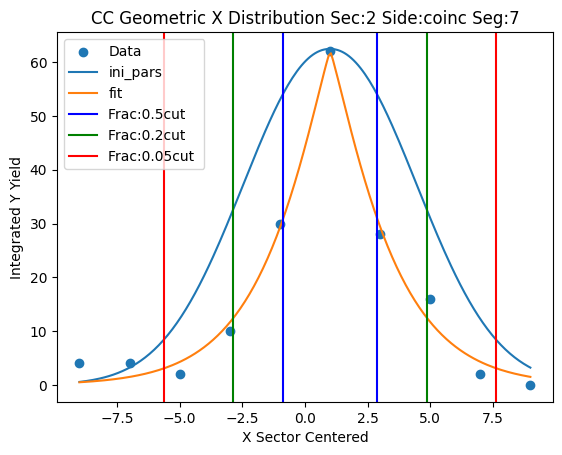

low,high -10 10
Parameters for Sec:2 Side:coinc Seg:8
test pars [62.024214    1.          2.81482147  1.15749378]
fit pars [34.257318    0.39480223  1.90670013  1.23315393]


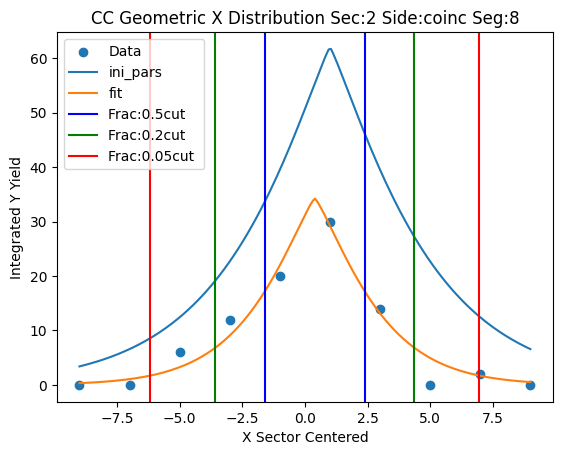

low,high -10 10
Parameters for Sec:2 Side:coinc Seg:9
test pars [34.257318    1.          2.90670013  1.23315393]
fit pars [2.05193161e+05 1.68557488e+00 7.53725359e-08 1.38492417e-01]


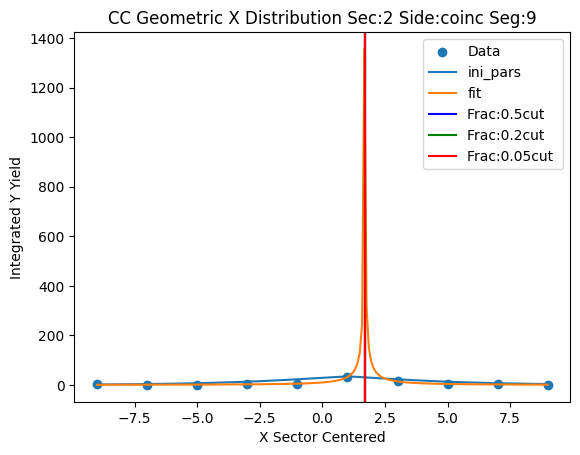

low,high -10 10
Parameters for Sec:2 Side:coinc Seg:10
test pars [2.05193161e+05 1.00000000e+00 1.00000008e+00 1.38492417e-01]
fit pars [1.69890230e+05 1.99718388e+00 4.44973220e-01 4.80947769e+00]


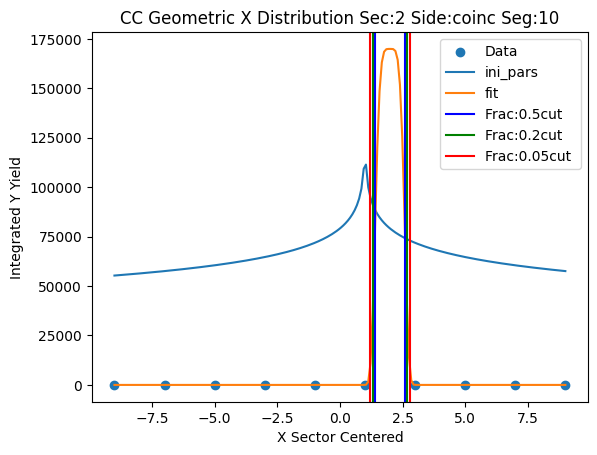

low,high -10 10
Parameters for Sec:2 Side:coinc Seg:11
test pars [1.69890230e+05 1.00000000e+00 1.44497322e+00 4.80947769e+00]
fit pars [14.          1.10922579  1.36575839 27.25743189]


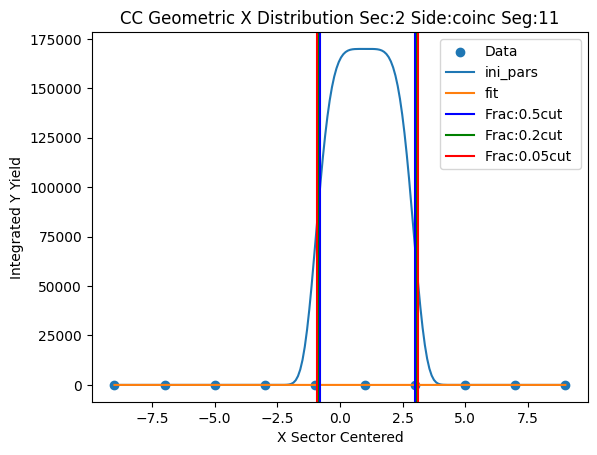

low,high -10 10
Parameters for Sec:2 Side:coinc Seg:12
test pars [14.          5.          2.36575839 27.25743189]
fit pars [ 8.16674883 12.88369402  1.26952321 17.44539569]


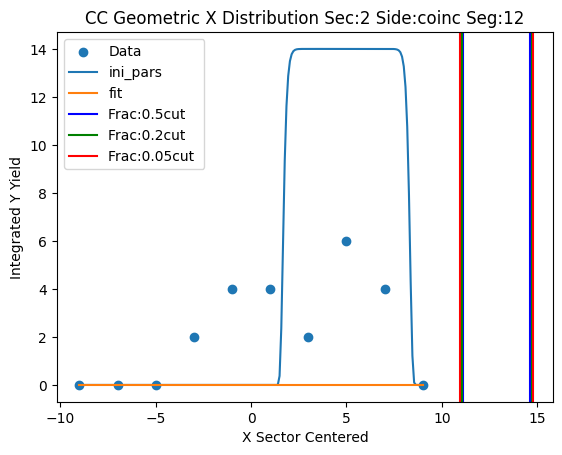

low,high -10 10
Value Error
Parameters for Sec:2 Side:coinc Seg:13
test pars [12.  0. 10.  3.]
fit pars [10.66666686  0.99999999  2.77263096 25.8574512 ]


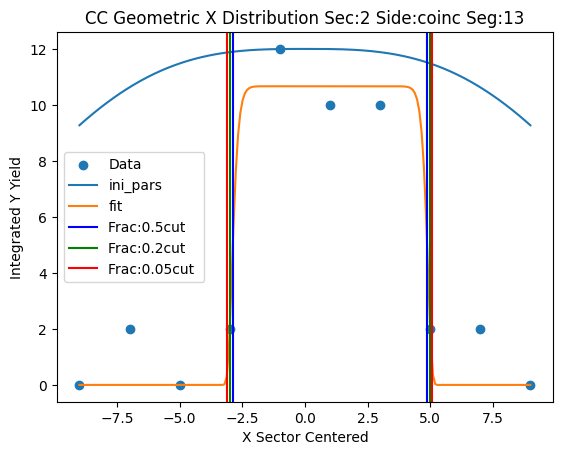

low,high -10 10


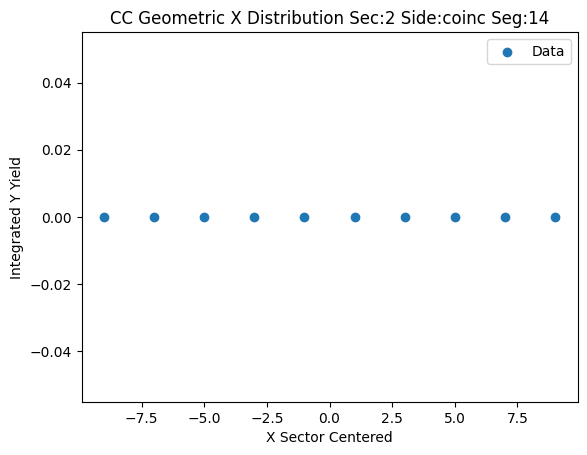

low,high -10 10


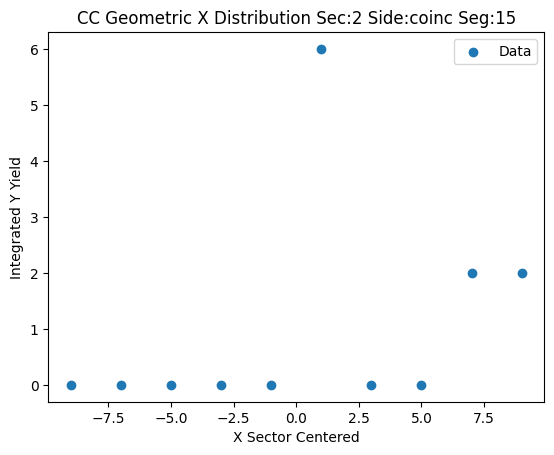

low,high -40 40
Parameters for Sec:3 Side:coinc Seg:1
test pars [83.  0. 10.  3.]
fit pars [1.13662024e+02 3.92693031e-40 4.72651602e+00 1.78407069e+00]


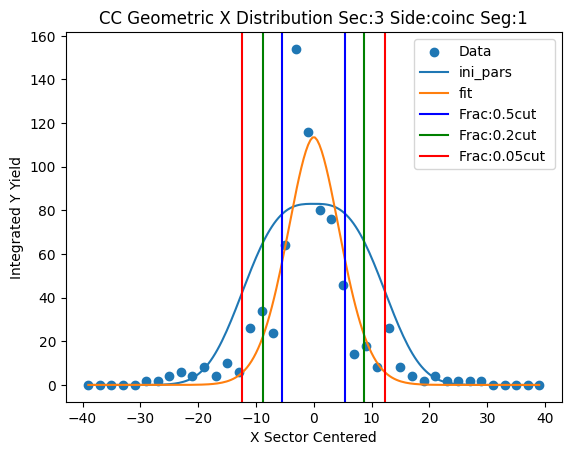

low,high -40 40
Value Error
Parameters for Sec:3 Side:coinc Seg:2
test pars [204.   0.  40.   3.]
fit pars [2.04459719e+02 4.91370613e-40 3.44728373e+00 9.75341629e-01]


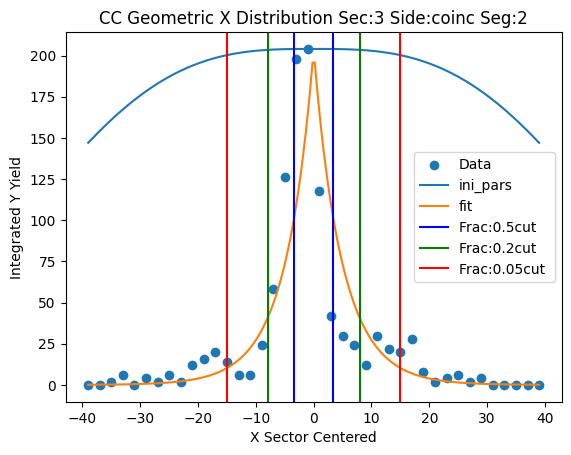

low,high -10 10
Value Error
Parameters for Sec:3 Side:coinc Seg:3
test pars [160.   0.  10.   3.]
fit pars [1.28216187e+02 3.84718669e-38 3.68880527e+00 1.77938205e+00]


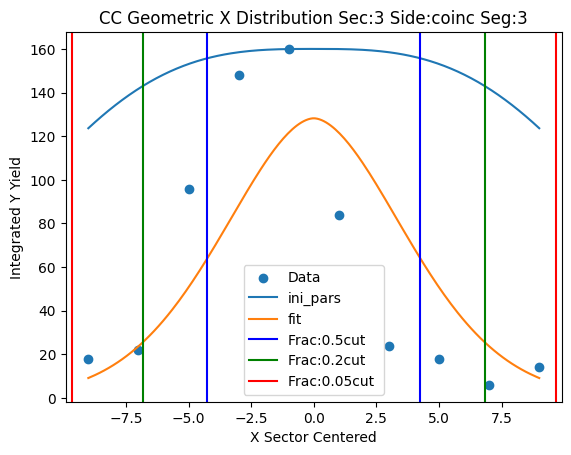

low,high -10 10
Value Error
Parameters for Sec:3 Side:coinc Seg:4
test pars [122.   0.  10.   3.]
fit pars [9.08101157e+01 1.21217017e-38 3.47164697e+00 2.12173498e+00]


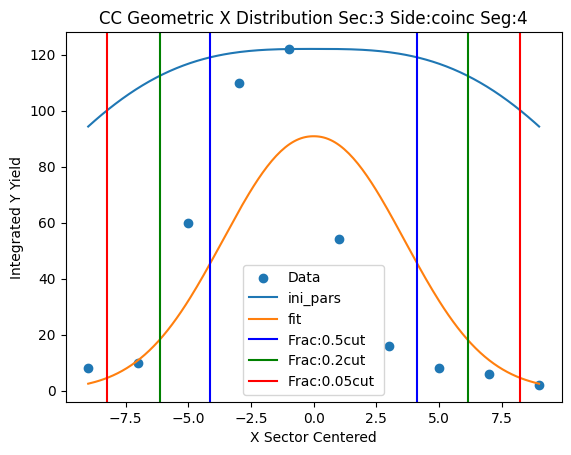

low,high -10 10
Value Error
Parameters for Sec:3 Side:coinc Seg:5
test pars [66.  0. 10.  3.]
fit pars [6.85147238e+01 2.64878737e-39 2.92464548e+00 1.43909413e+00]


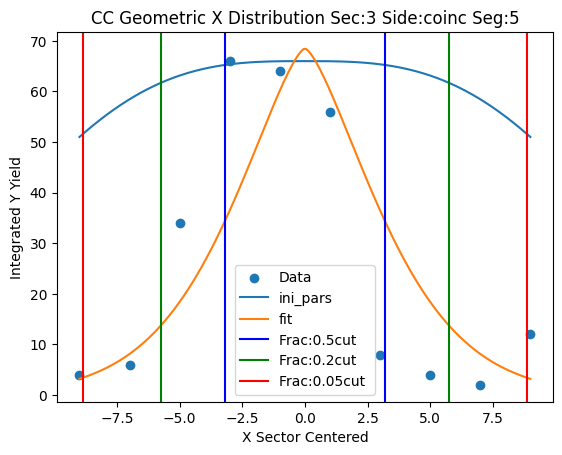

low,high -10 10
Value Error
Parameters for Sec:3 Side:coinc Seg:6
test pars [68.  0. 10.  3.]
fit pars [5.44506759e+01 4.29844499e-33 3.21161192e+00 1.63893491e+00]


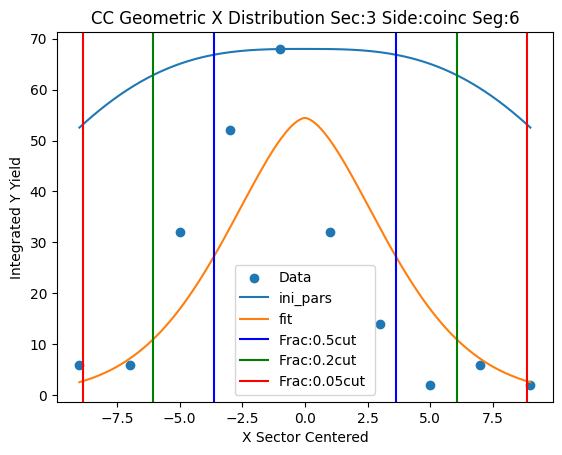

low,high -10 10
Value Error
Parameters for Sec:3 Side:coinc Seg:7
test pars [34.  0. 10.  3.]
fit pars [2.52015688e+01 1.99202021e-38 2.45730483e+00 1.93166546e+00]


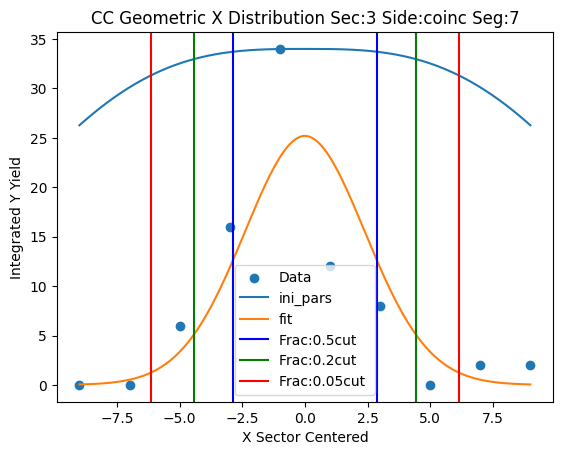

low,high -10 10
Value Error
Parameters for Sec:3 Side:coinc Seg:8
test pars [36.  0. 10.  3.]
fit pars [2.73813983e+01 5.65716981e-37 3.26018004e+00 2.72888748e+00]


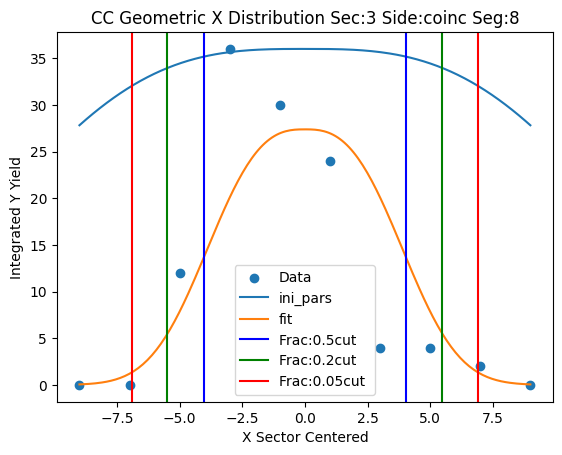

low,high -10 10
Parameters for Sec:3 Side:coinc Seg:9
test pars [27.38139828  1.          4.26018004  2.72888748]
fit pars [1.10265311e+05 1.45762113e-01 5.08026048e-08 1.31044679e-01]


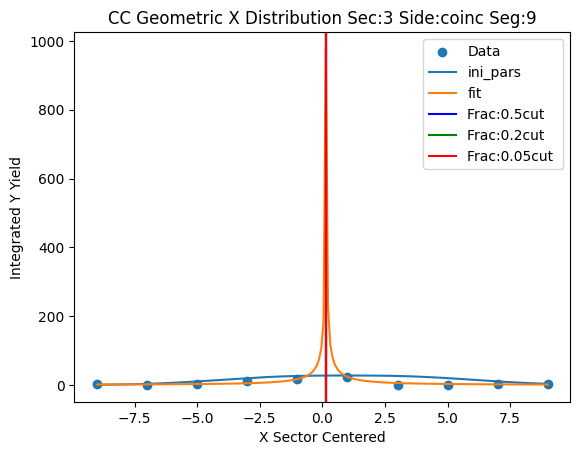

low,high -10 10
Value Error
Parameters for Sec:3 Side:coinc Seg:10
test pars [24.  0. 10.  3.]
fit pars [2.36128894e+01 2.18868196e-38 2.54557910e+00 2.07877879e+00]


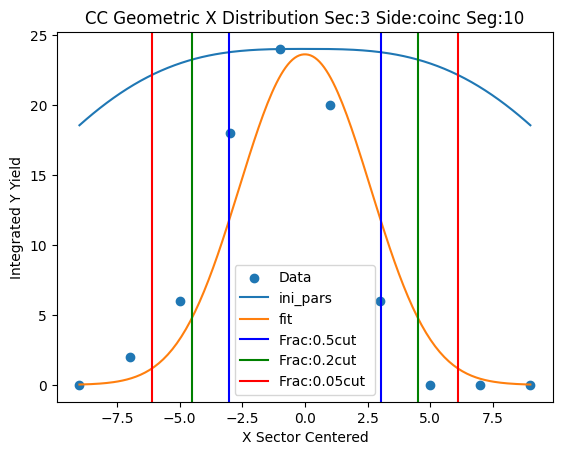

low,high -10 10
Parameters for Sec:3 Side:coinc Seg:11
test pars [23.61288939  1.          3.5455791   2.07877879]
fit pars [13.99999966  0.82018347  2.88657834 28.1785788 ]


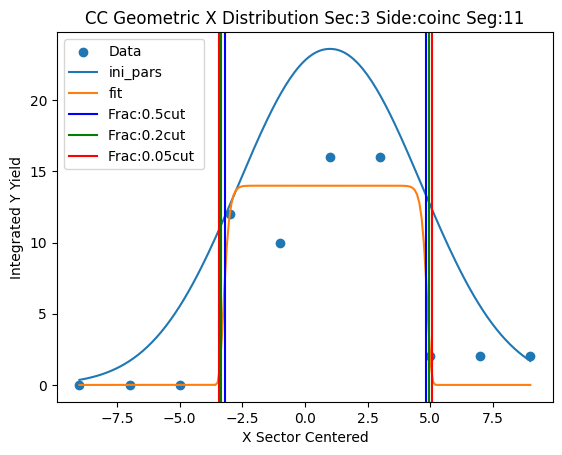

low,high -10 10


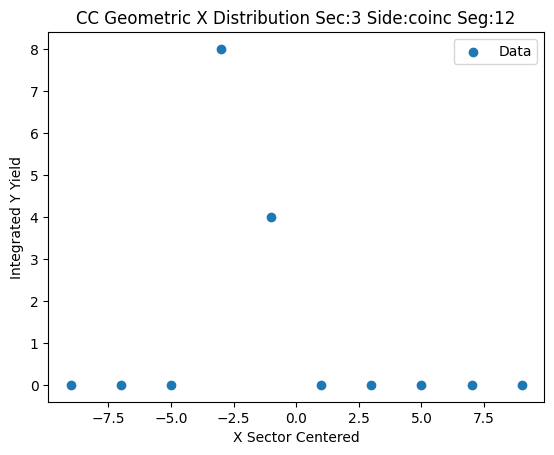

low,high -10 10
Value Error
Parameters for Sec:3 Side:coinc Seg:13
test pars [20.  0. 10.  3.]
fit pars [3.03282490e+01 6.52855659e-37 1.00931343e+00 7.08654256e-01]


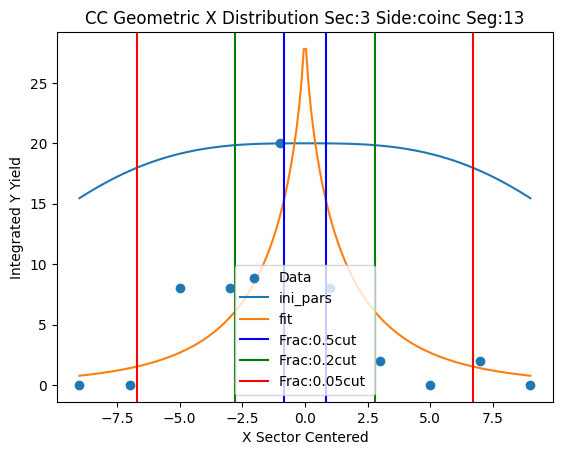

low,high -10 10


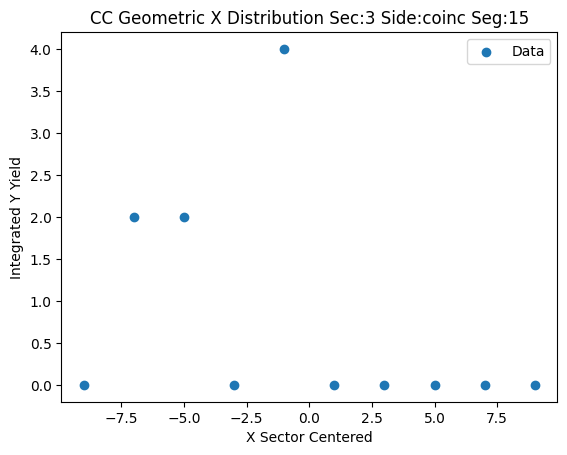

low,high -10 10


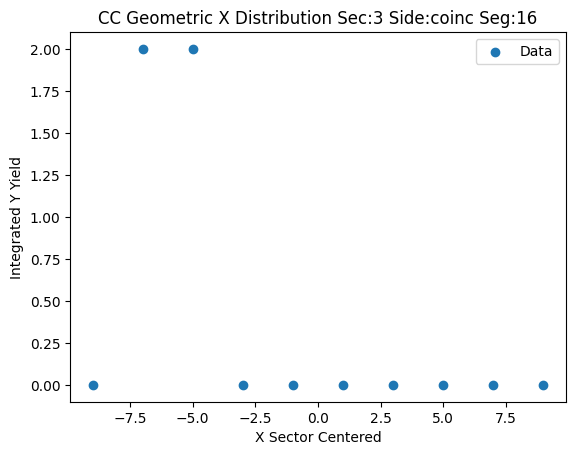

low,high -40 40
Parameters for Sec:4 Side:coinc Seg:1
test pars [83.  0. 10.  3.]
fit pars [8.55083045e+01 1.40366249e-22 3.93405431e+00 9.31860183e-01]


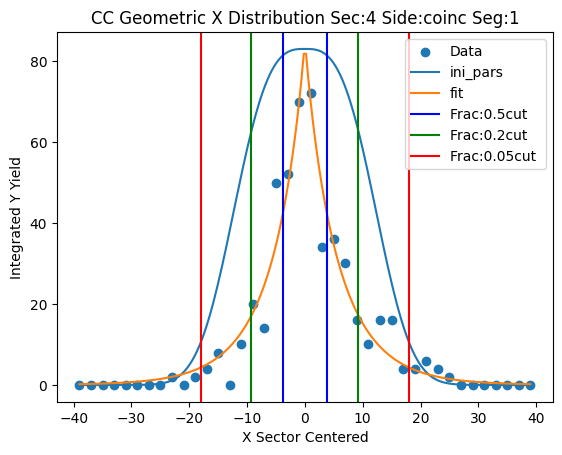

low,high -40 40
Value Error
Parameters for Sec:4 Side:coinc Seg:2
test pars [192.   0.  40.   3.]
fit pars [2.59180034e+03 1.54665994e-40 2.17576309e-02 2.77273092e-01]


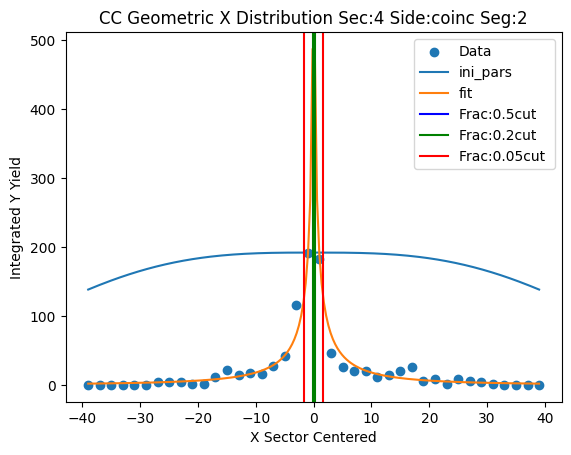

low,high -10 10
Value Error
Parameters for Sec:4 Side:coinc Seg:3
test pars [132.   0.  10.   3.]
fit pars [2.51223469e+02 3.37779070e-39 1.18377451e+00 7.76633083e-01]


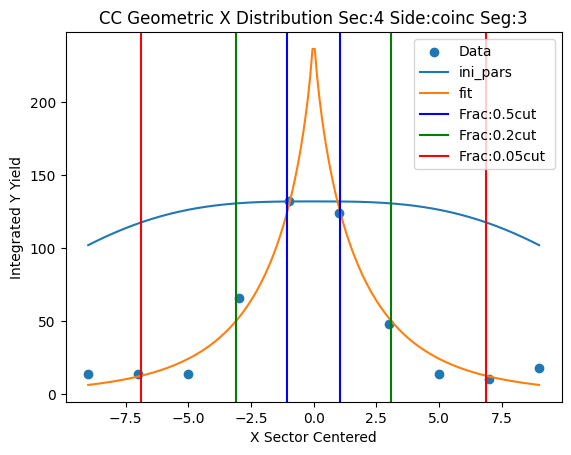

low,high -10 10
Value Error
Parameters for Sec:4 Side:coinc Seg:4
test pars [78.  0. 10.  3.]
fit pars [9.04159302e+01 7.28463977e-40 1.95076586e+00 1.52832266e+00]


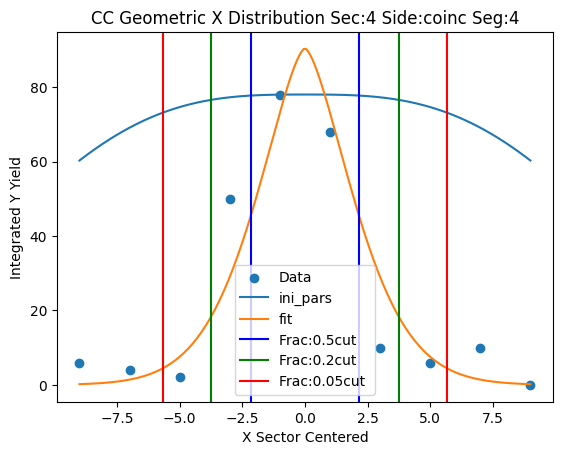

low,high -10 10
Value Error
Parameters for Sec:4 Side:coinc Seg:5
test pars [64.  0. 10.  3.]
fit pars [3.43089416e+05 9.14747794e-31 5.72287068e-08 1.32818652e-01]


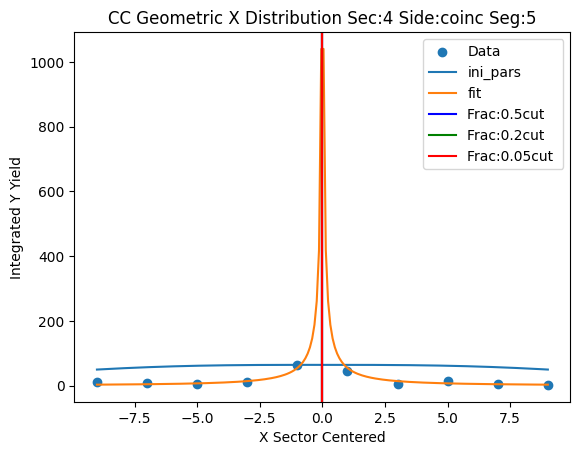

low,high -10 10
Value Error
Parameters for Sec:4 Side:coinc Seg:6
test pars [44.  0. 10.  3.]
fit pars [4.07123802e+01 9.74919281e-39 2.35037003e+00 2.62496263e+00]


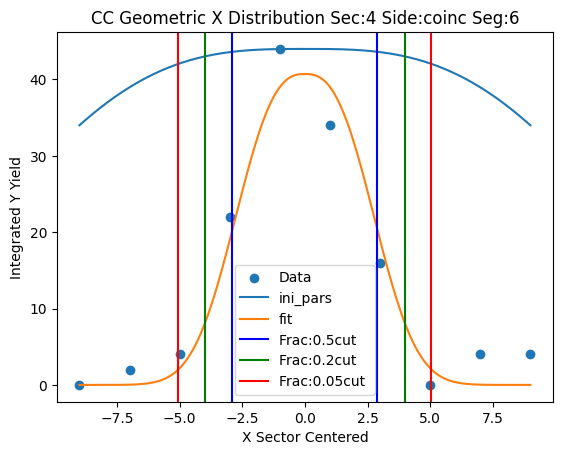

low,high -10 10
Value Error
Parameters for Sec:4 Side:coinc Seg:7
test pars [38.  0. 10.  3.]
fit pars [2.26462337e+02 4.32178468e-39 1.93979799e-01 5.57035717e-01]


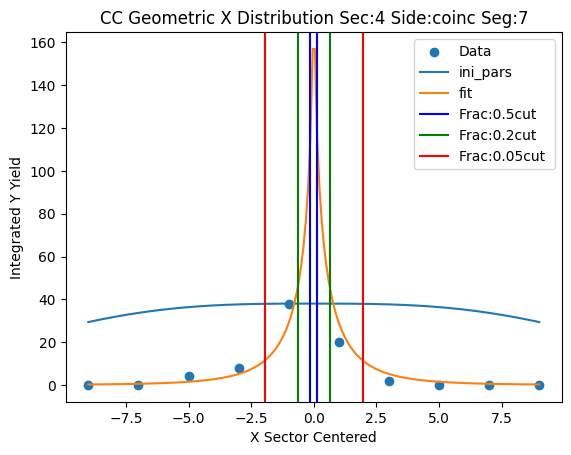

low,high -10 10


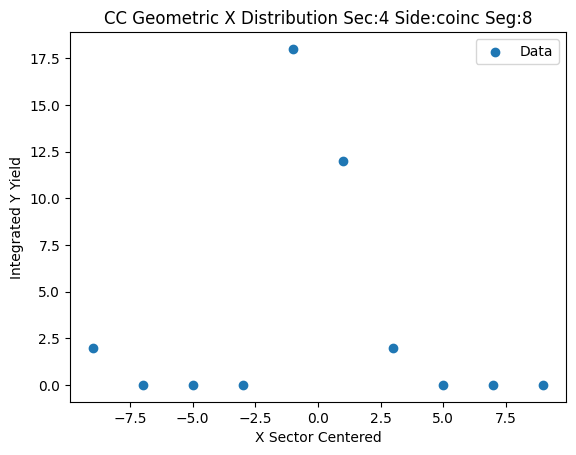

low,high -10 10
Value Error
Parameters for Sec:4 Side:coinc Seg:9
test pars [16.  0. 10.  3.]
fit pars [1.64335760e+04 2.01363372e-30 5.45107355e-08 1.21453205e-01]


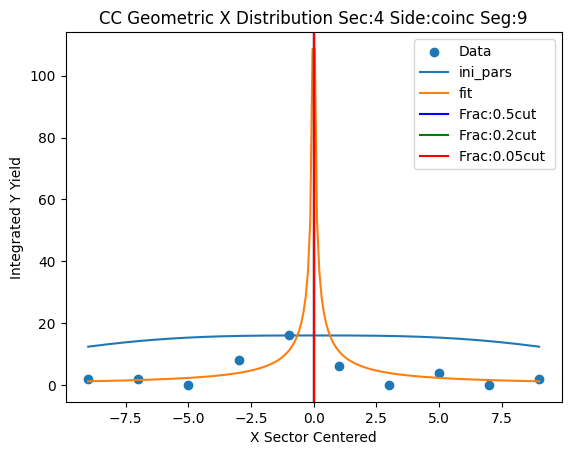

low,high -10 10
Value Error
Parameters for Sec:4 Side:coinc Seg:10
test pars [ 8.  0. 10.  3.]
fit pars [2.89952922e+03 2.03178324e-28 3.00654854e-08 1.05799482e-01]


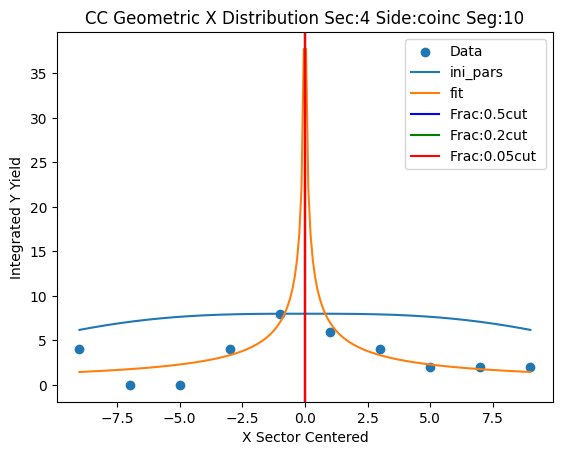

low,high -10 10


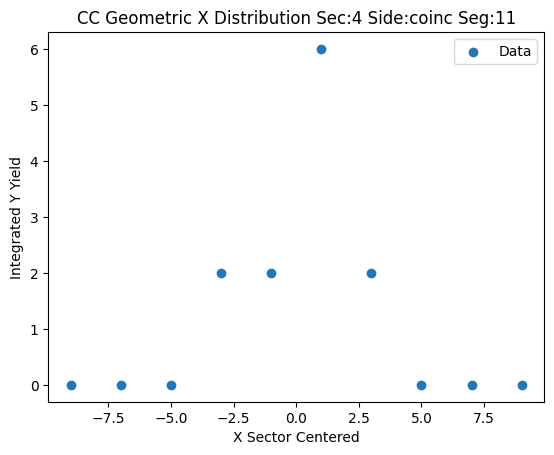

low,high -10 10
Parameters for Sec:4 Side:coinc Seg:12
test pars [2.89952922e+03 1.00000000e+00 1.00000003e+00 1.05799482e-01]
fit pars [2.46631926e+03 2.00000000e+00 4.44366443e-01 4.00417974e+00]


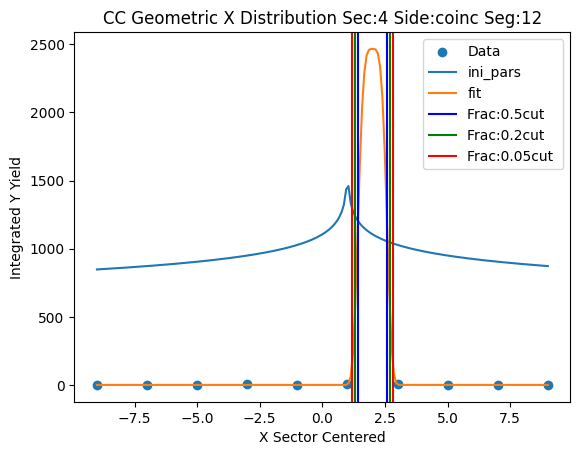

low,high -10 10


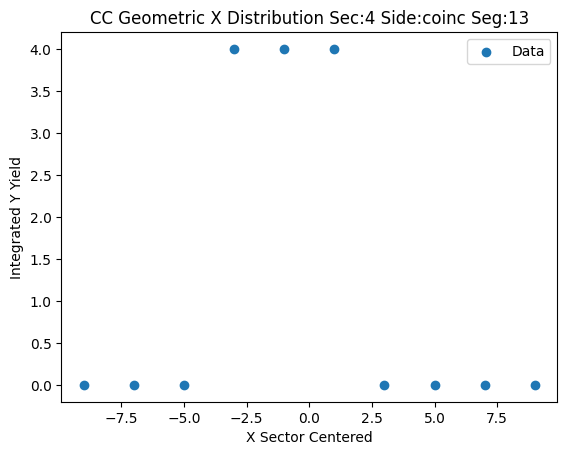

low,high -10 10


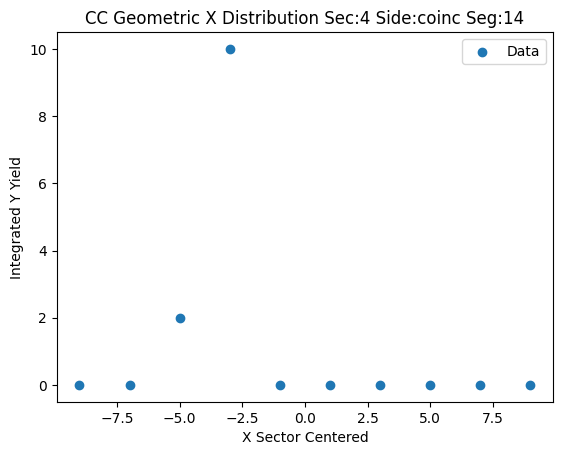

low,high -10 10


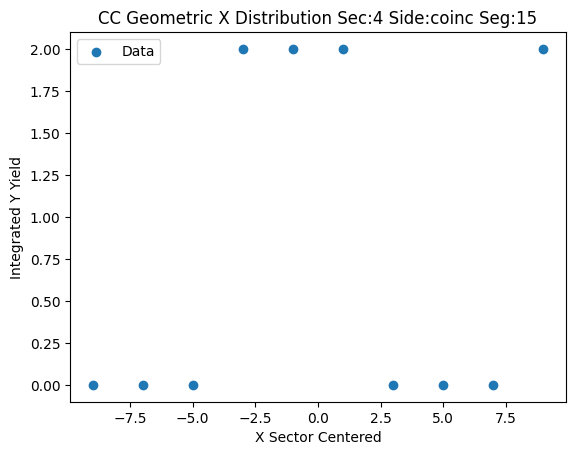

low,high -40 40
Parameters for Sec:5 Side:coinc Seg:1
test pars [83.  0. 10.  3.]
fit pars [2.77749148e+02 3.29441036e-38 1.95727448e+00 6.05209364e-01]


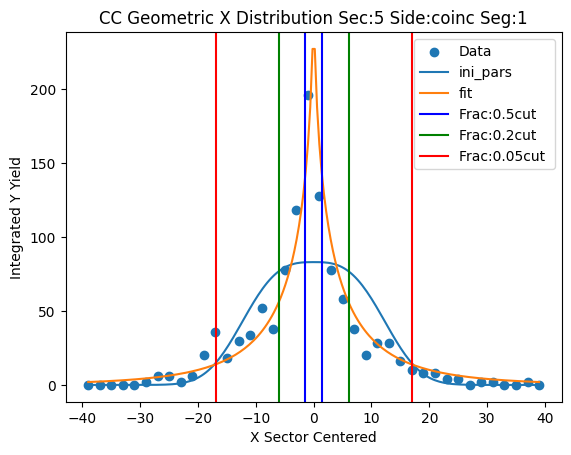

low,high -40 40
Parameters for Sec:5 Side:coinc Seg:2
test pars [277.7491482    1.           2.95727448   0.60520936]
fit pars [5.84393426e+01 3.16964878e-18 4.91287118e+00 6.81922892e-01]


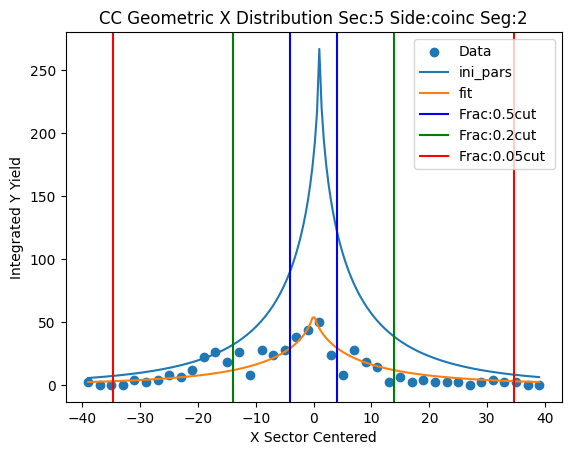

low,high -10 10
Parameters for Sec:5 Side:coinc Seg:3
test pars [58.43934258  1.          5.91287118  0.68192289]
fit pars [3.70396058e+02 4.82084715e-02 8.97617165e-01 5.46200364e-01]


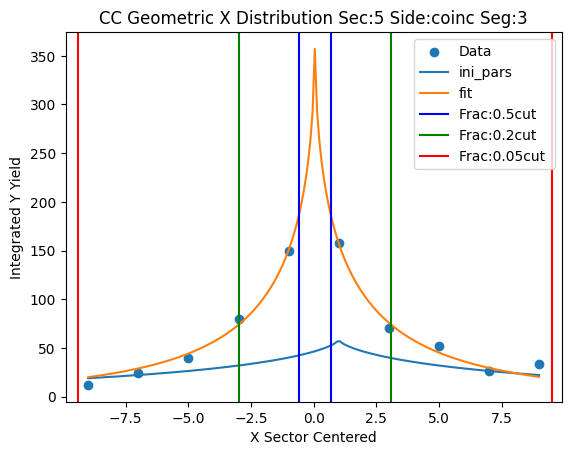

low,high -10 10
Parameters for Sec:5 Side:coinc Seg:4
test pars [370.39605826   1.           1.89761716   0.54620036]
fit pars [2.06517493e+04 1.17738804e-01 2.37337371e-08 1.05250831e-01]


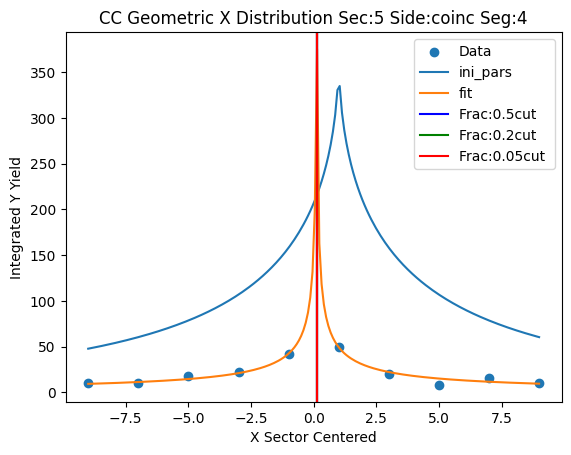

low,high -10 10
Value Error
Parameters for Sec:5 Side:coinc Seg:5
test pars [58.  0. 10.  3.]
fit pars [59.70232065  0.37830982  3.08091842  1.96133038]


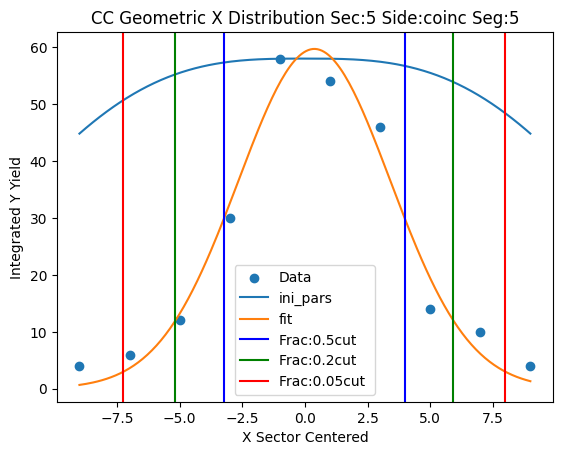

low,high -10 10
Value Error
Parameters for Sec:5 Side:coinc Seg:6
test pars [56.  0. 10.  3.]
fit pars [5.74187557e+01 2.88320640e-38 2.65523505e+00 1.51533848e+00]


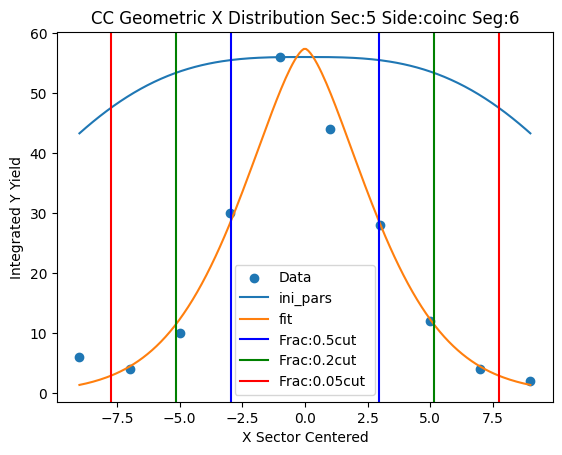

low,high -10 10
Parameters for Sec:5 Side:coinc Seg:7
test pars [57.41875568  1.          3.65523505  1.51533848]
fit pars [4.09533016e+04 2.39847826e-01 3.84669751e-08 1.15549906e-01]


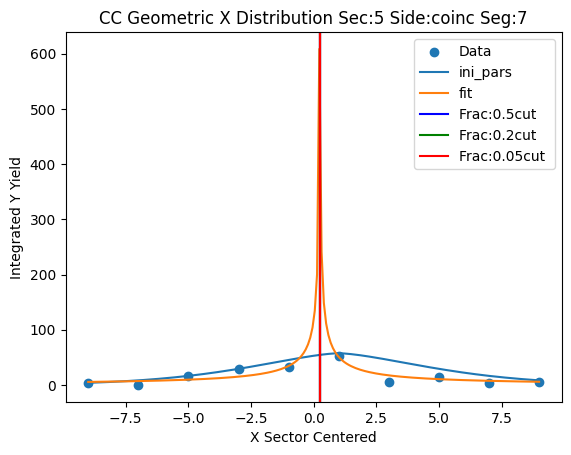

low,high -10 10
Parameters for Sec:5 Side:coinc Seg:8
test pars [4.09533016e+04 1.00000000e+00 1.00000004e+00 1.15549906e-01]
fit pars [3.40143056e+04 1.98910999e+00 4.47771063e-01 4.35350086e+00]


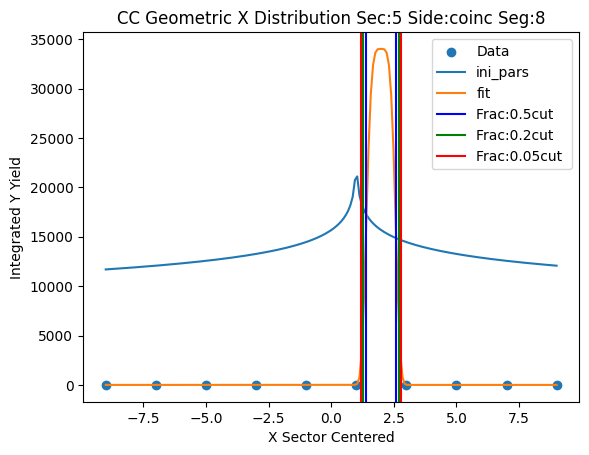

low,high -10 10
Parameters for Sec:5 Side:coinc Seg:9
test pars [3.40143056e+04 1.00000000e+00 1.44777106e+00 4.35350086e+00]
fit pars [20.          0.95496454  1.45210618 20.94681185]


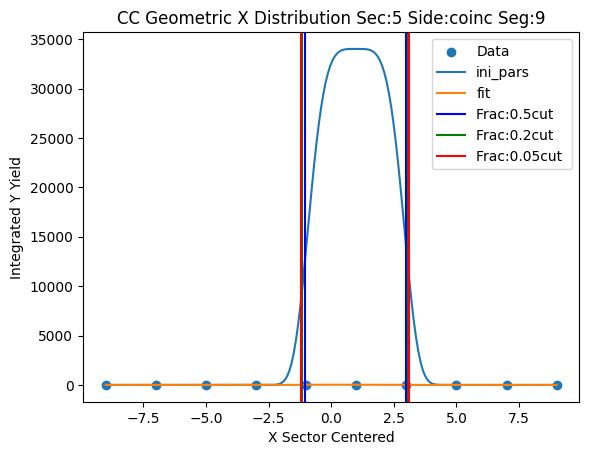

low,high -10 10
Parameters for Sec:5 Side:coinc Seg:10
test pars [20.          1.          2.45210618 20.94681185]
fit pars [26.00000005  0.90364338  1.39927476  6.63683153]


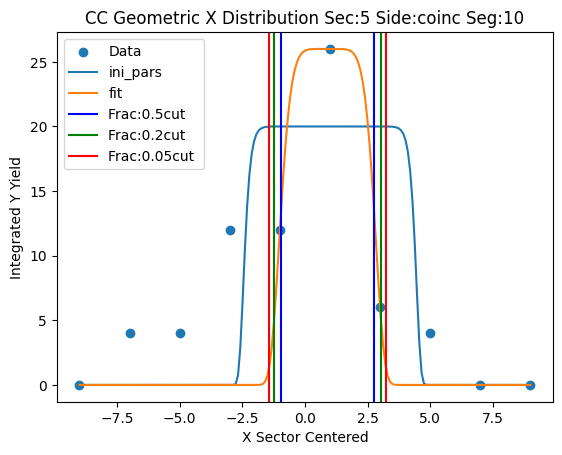

low,high -10 10
Value Error
Parameters for Sec:5 Side:coinc Seg:11
test pars [16.  0. 10.  3.]
fit pars [1.00000591e+01 7.30420594e-34 3.50644907e+00 2.24557597e+01]


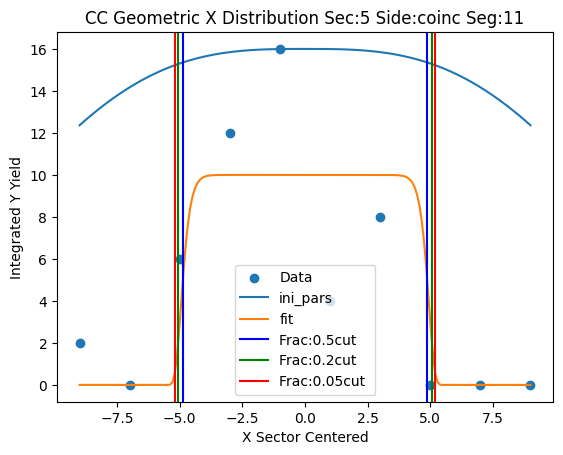

low,high -10 10
Value Error
Parameters for Sec:5 Side:coinc Seg:12
test pars [14.  0. 10.  3.]
fit pars [1.10454126e+01 6.28500196e-39 3.11147606e+00 4.09356884e+00]


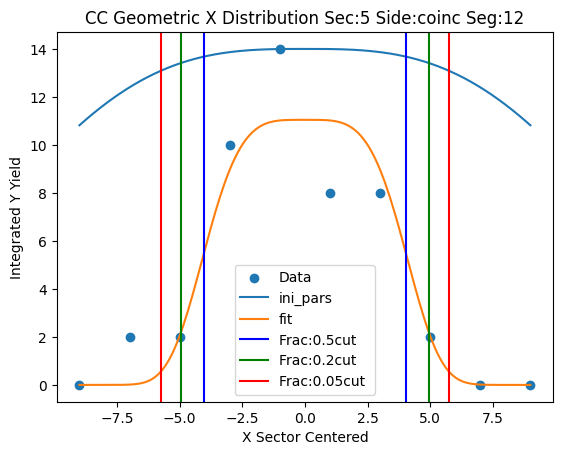

low,high -10 10
Parameters for Sec:5 Side:coinc Seg:13
test pars [11.04541264  1.          4.11147606  4.09356884]
fit pars [7.4510914  0.99999999 2.02092761 0.53005761]


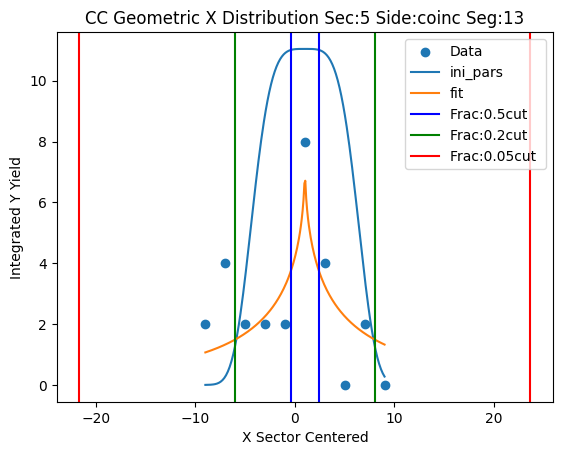

low,high -10 10


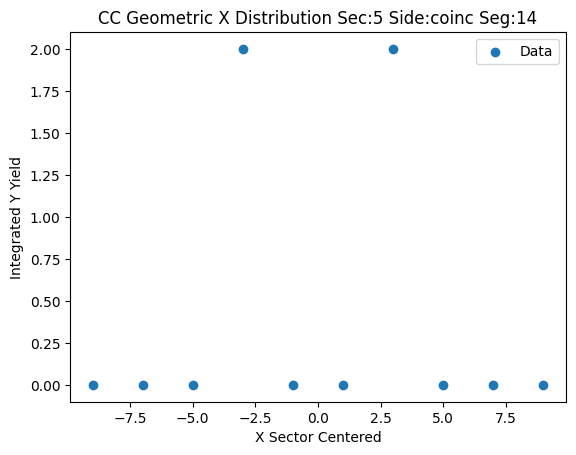

low,high -10 10


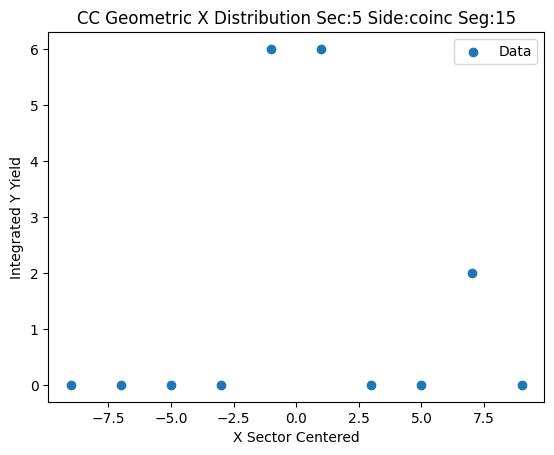

low,high -10 10


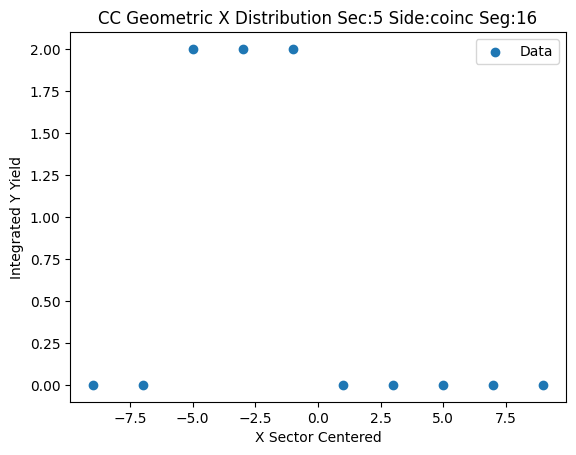

low,high -40 40
Parameters for Sec:6 Side:coinc Seg:1
test pars [83.  0. 10.  3.]
fit pars [1.96791910e+02 2.65982015e-37 1.23515963e+00 5.80097236e-01]


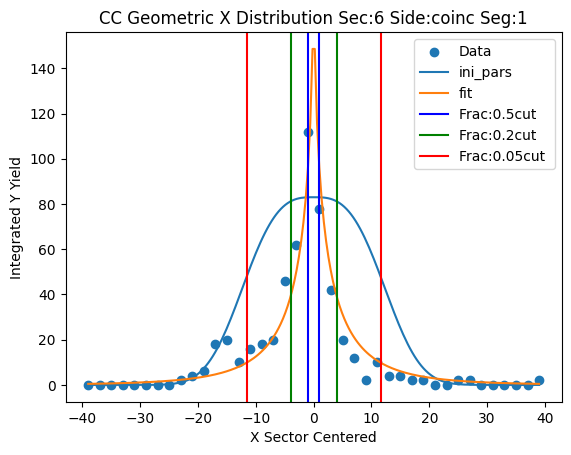

low,high -40 40
Value Error
Parameters for Sec:6 Side:coinc Seg:2
test pars [258.   0.  40.   3.]
fit pars [4.70680831e+02 1.44543057e-36 1.36044214e+00 6.02737038e-01]


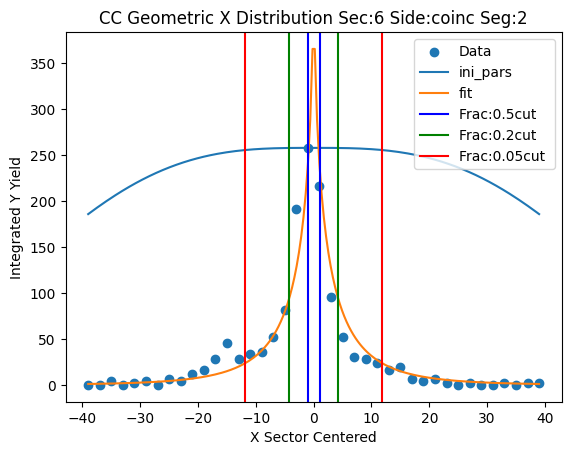

low,high -10 10
Parameters for Sec:6 Side:coinc Seg:3
test pars [470.68083094   1.           2.36044214   0.60273704]
fit pars [2.78311975e+02 2.86523253e-25 1.73948177e+00 8.90866520e-01]


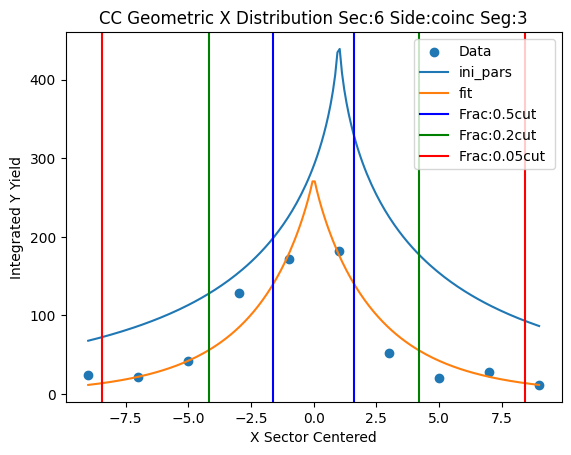

low,high -10 10
Value Error
Parameters for Sec:6 Side:coinc Seg:4
test pars [120.   0.  10.   3.]
fit pars [1.24455388e+02 2.80429723e-40 2.55706968e+00 1.73523111e+00]


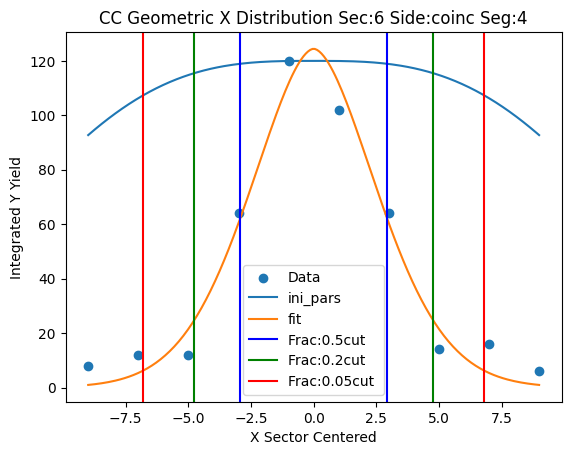

low,high -10 10
Value Error
Parameters for Sec:6 Side:coinc Seg:5
test pars [76.  0. 10.  3.]
fit pars [1.16995465e+02 1.96401555e-38 1.48337953e+00 1.01992430e+00]


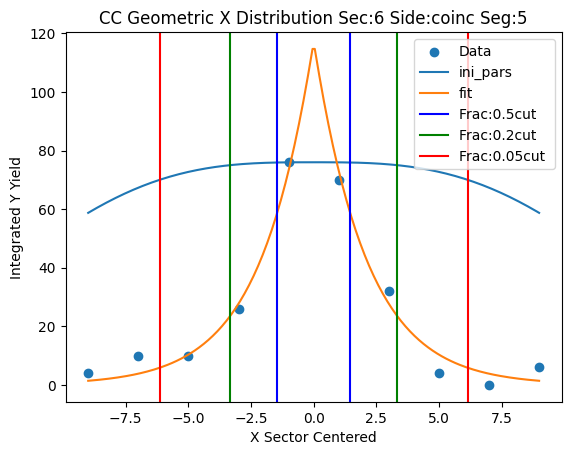

low,high -10 10
Value Error
Parameters for Sec:6 Side:coinc Seg:6
test pars [38.  0. 10.  3.]
fit pars [5.36245102e+04 1.42440171e-29 5.71242751e-08 1.22019568e-01]


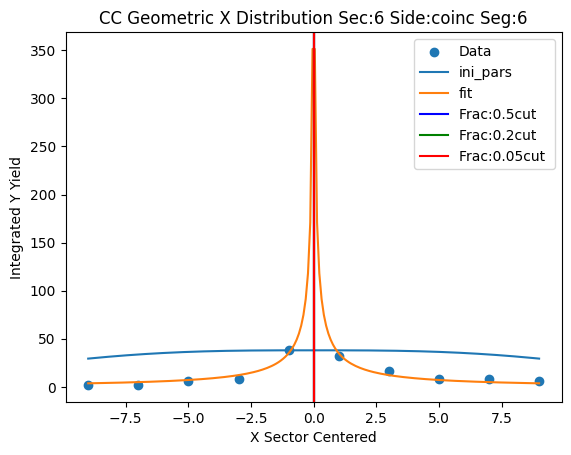

low,high -10 10
Parameters for Sec:6 Side:coinc Seg:7
test pars [5.36245102e+04 1.00000000e+00 1.00000006e+00 1.22019568e-01]
fit pars [4.45030242e+04 1.97661297e+00 4.47000251e-01 4.41797868e+00]


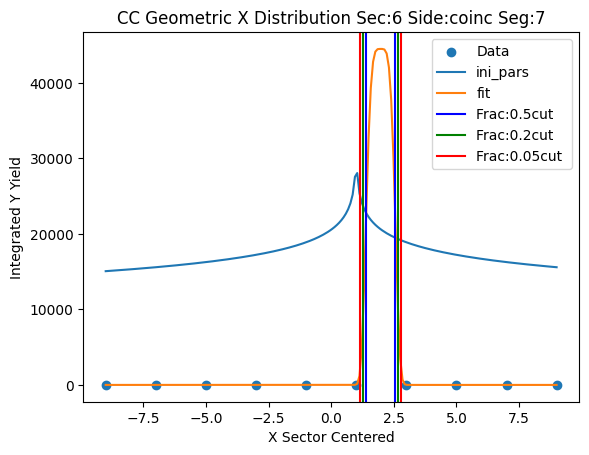

low,high -10 10
Value Error
Parameters for Sec:6 Side:coinc Seg:8
test pars [40.  0. 10.  3.]
fit pars [2.70771300e+05 1.99234432e-33 8.92323131e-08 1.37417499e-01]


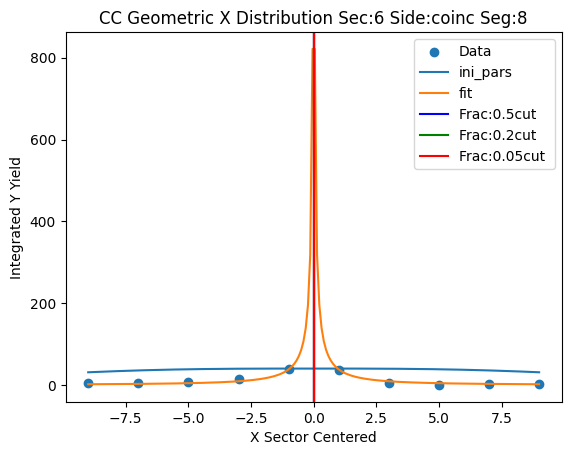

low,high -10 10
Value Error
Parameters for Sec:6 Side:coinc Seg:9
test pars [12.  0. 10.  3.]
fit pars [1.20081215e+01 1.01961448e-38 2.95821140e+00 5.10670783e+00]


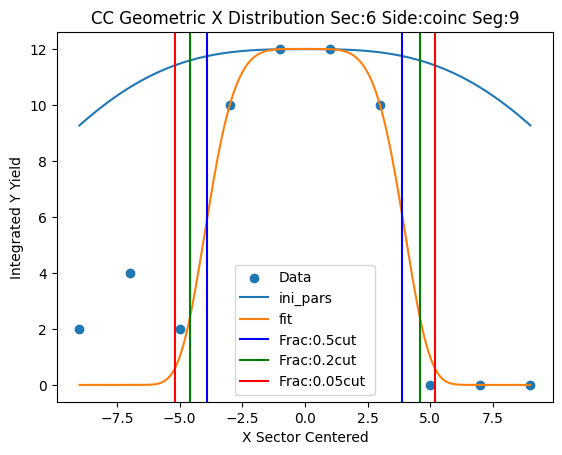

low,high -10 10


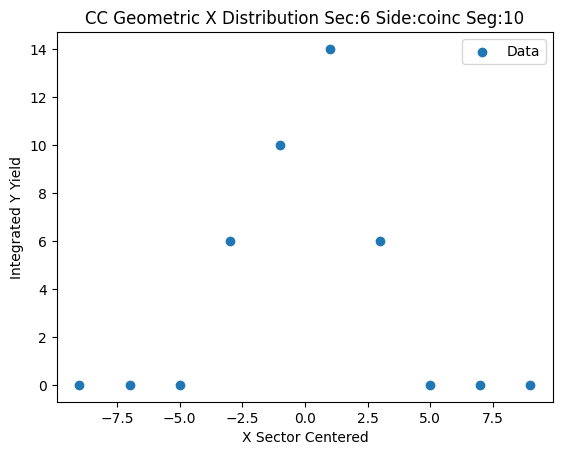

low,high -10 10
Parameters for Sec:6 Side:coinc Seg:12
test pars [12.00812145  1.          3.9582114   5.10670783]
fit pars [4.50000006e+00 6.68105747e-35 3.49396259e+00 3.44699441e+01]


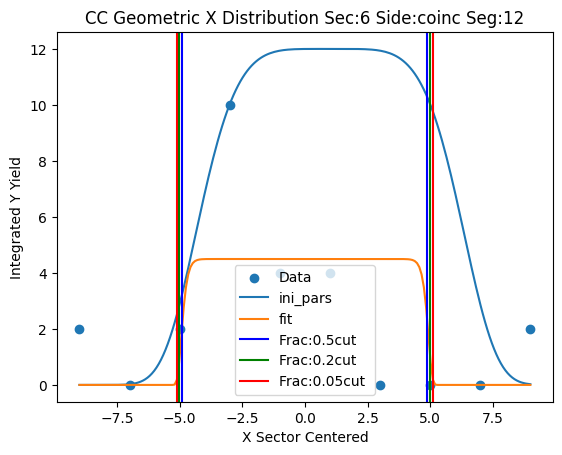

low,high -10 10


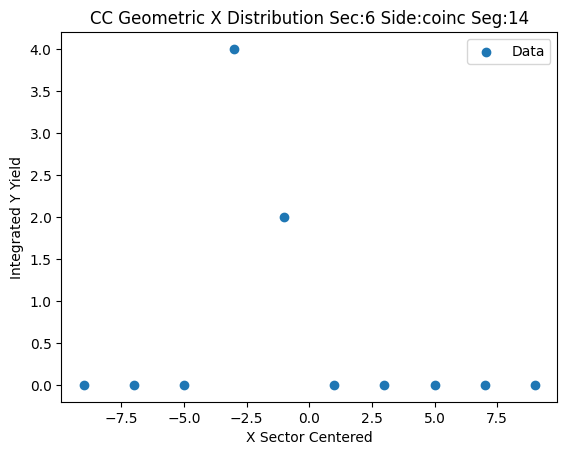

low,high -10 10


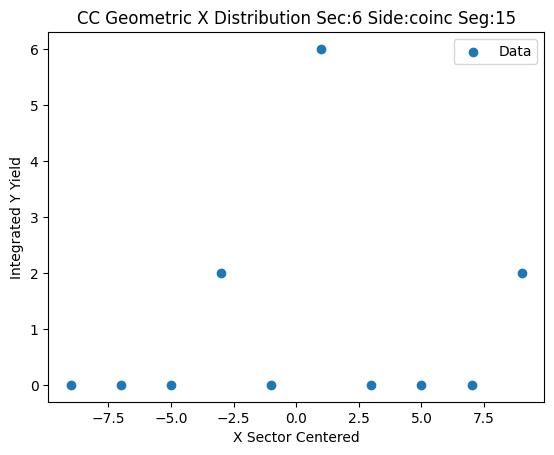

low,high -40 40
Parameters for Sec:7 Side:coinc Seg:1
test pars [83.  0. 10.  3.]
fit pars [6.78435585e+02 1.92043179e-38 3.91496937e+00 8.27705080e-01]


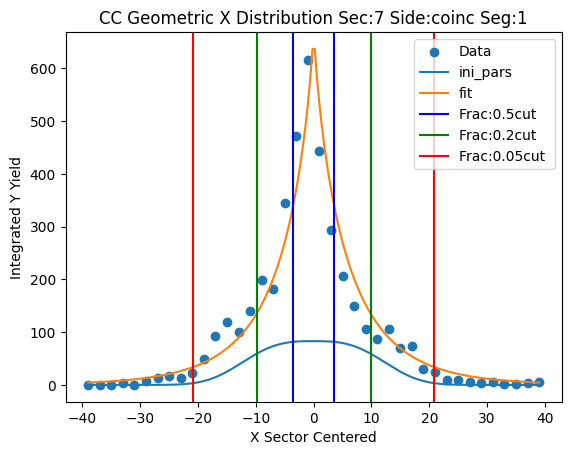

low,high -40 40
Value Error
Parameters for Sec:7 Side:coinc Seg:2
test pars [1150.    0.   40.    3.]
fit pars [5.25824395e+03 4.77633240e-38 1.83193327e-01 3.44736131e-01]


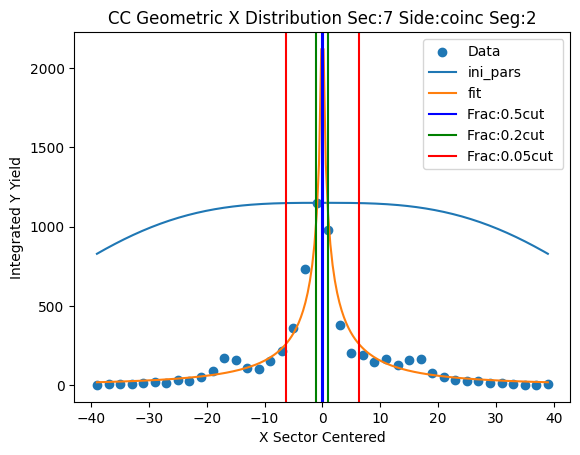

low,high -10 10
Value Error
Parameters for Sec:7 Side:coinc Seg:3
test pars [930.   0.  10.   3.]
fit pars [1.41301904e+03 1.66703864e-39 1.76233037e+00 8.73507414e-01]


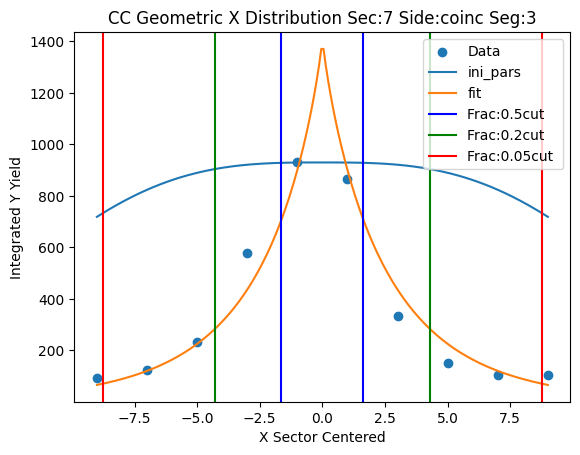

low,high -10 10
Value Error
Parameters for Sec:7 Side:coinc Seg:4
test pars [560.   0.  10.   3.]
fit pars [7.02390568e+02 7.59949332e-40 2.01554195e+00 1.08013045e+00]


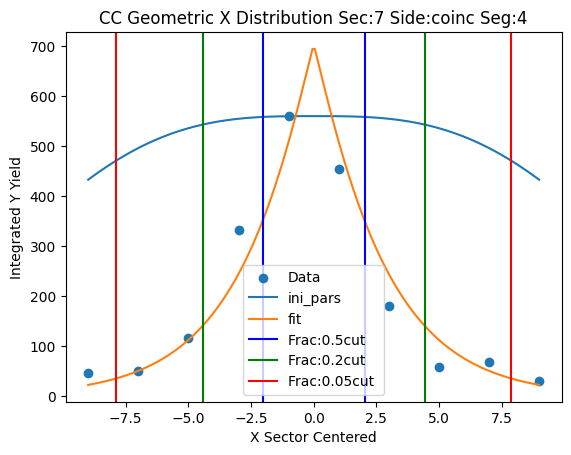

low,high -10 10
Value Error
Parameters for Sec:7 Side:coinc Seg:5
test pars [406.   0.  10.   3.]
fit pars [5.95024859e+02 1.16453628e-39 1.70160006e+00 9.68405146e-01]


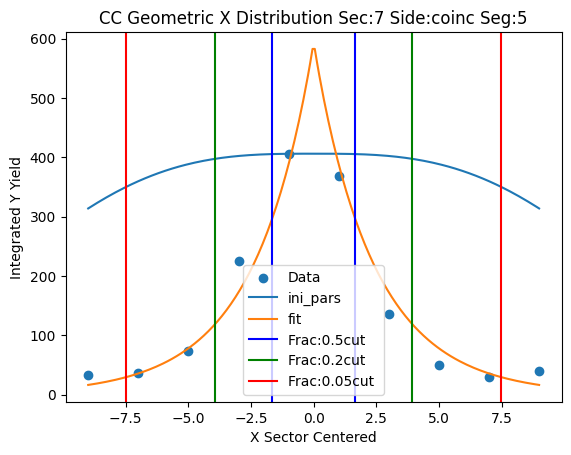

low,high -10 10
Value Error
Parameters for Sec:7 Side:coinc Seg:6
test pars [264.   0.  10.   3.]
fit pars [3.12941322e+02 1.65395234e-34 2.48965848e+00 1.41121682e+00]


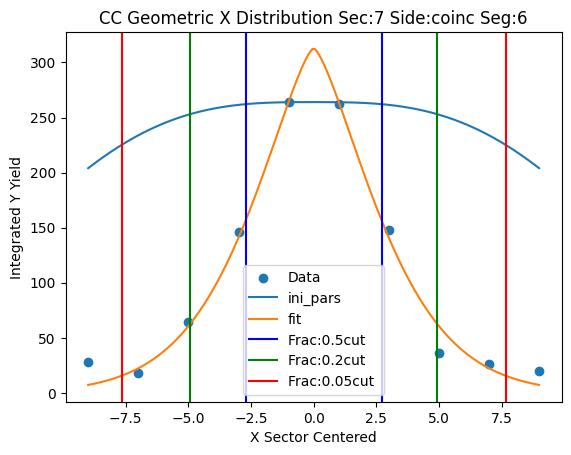

low,high -10 10
Parameters for Sec:7 Side:coinc Seg:7
test pars [312.94132232   1.           3.48965848   1.41121682]
fit pars [4.78722001e+02 2.07492263e-02 9.33436106e-01 7.39319293e-01]


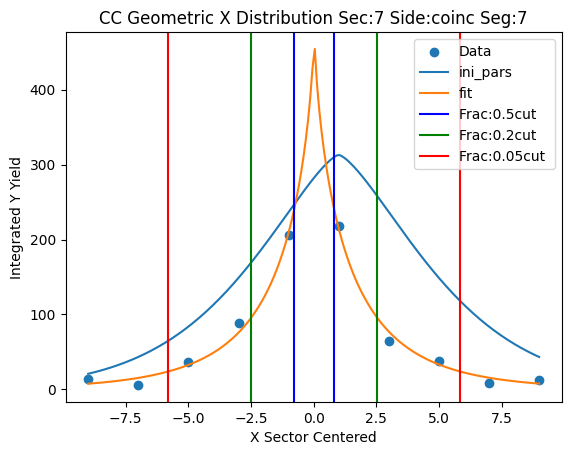

low,high -10 10
Value Error
Parameters for Sec:7 Side:coinc Seg:8
test pars [162.   0.  10.   3.]
fit pars [2.06218016e+02 4.54007315e-39 1.91724107e+00 1.33084189e+00]


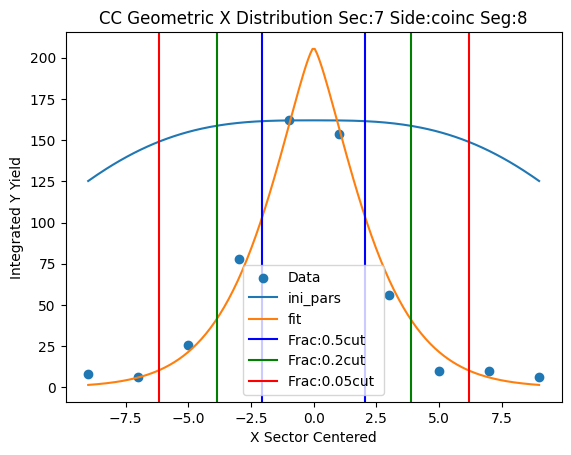

low,high -10 10
Parameters for Sec:7 Side:coinc Seg:9
test pars [206.21801558   1.           2.91724107   1.33084189]
fit pars [179.3135983    0.2418161    1.27181827   0.83407492]


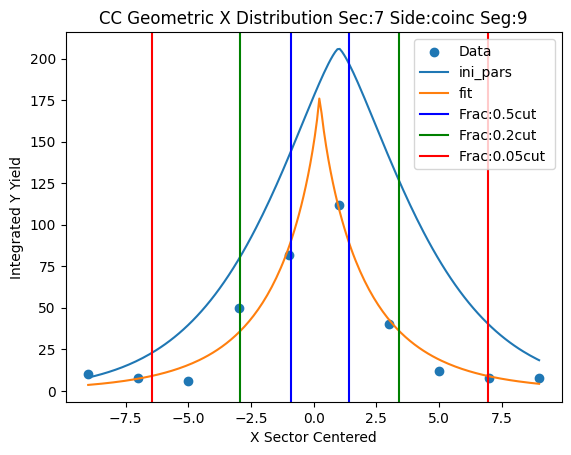

low,high -10 10
Parameters for Sec:7 Side:coinc Seg:10
test pars [179.3135983    1.           2.27181827   0.83407492]
fit pars [112.95039982   0.31830944   2.15891114   1.45572212]


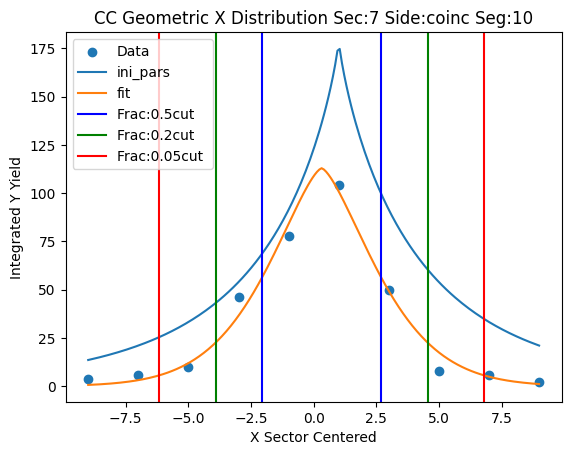

low,high -10 10
Parameters for Sec:7 Side:coinc Seg:11
test pars [112.95039982   1.           3.15891114   1.45572212]
fit pars [73.93677686  0.66771345  2.16199608  1.17488195]


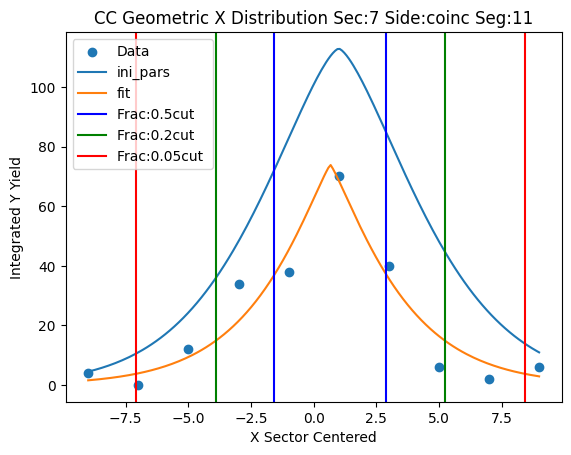

low,high -10 10
Value Error
Parameters for Sec:7 Side:coinc Seg:12
test pars [44.  0. 10.  3.]
fit pars [3.25000001e+01 2.31862783e-02 3.51948989e+00 3.68119612e+01]


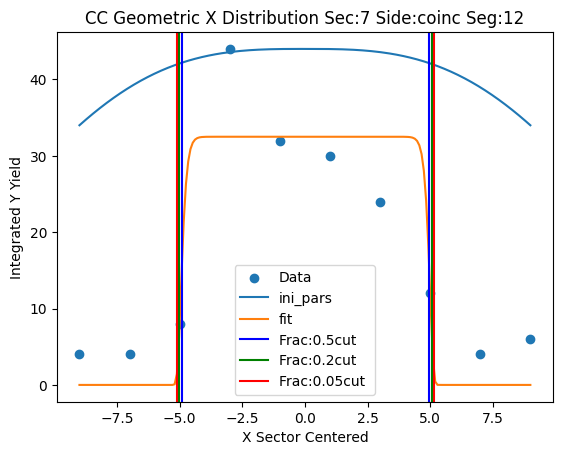

low,high -10 10
Value Error
Parameters for Sec:7 Side:coinc Seg:13
test pars [58.  0. 10.  3.]
fit pars [6.03748776e+01 9.75224985e-37 2.31464213e+00 1.42249116e+00]


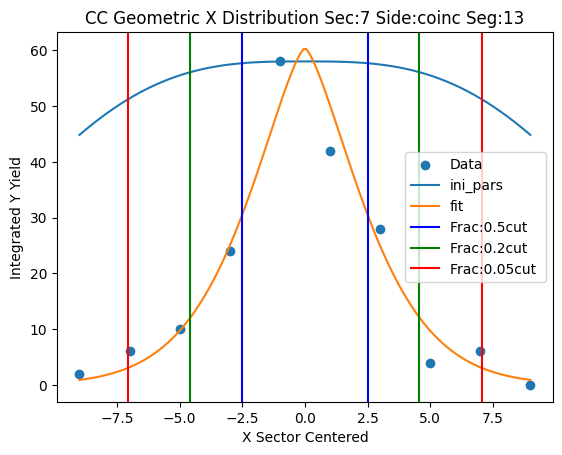

low,high -10 10
Value Error
Parameters for Sec:7 Side:coinc Seg:14
test pars [18.  0. 10.  3.]
fit pars [1.40391364e+01 2.49453112e-40 3.00071356e+00 4.06794198e+00]


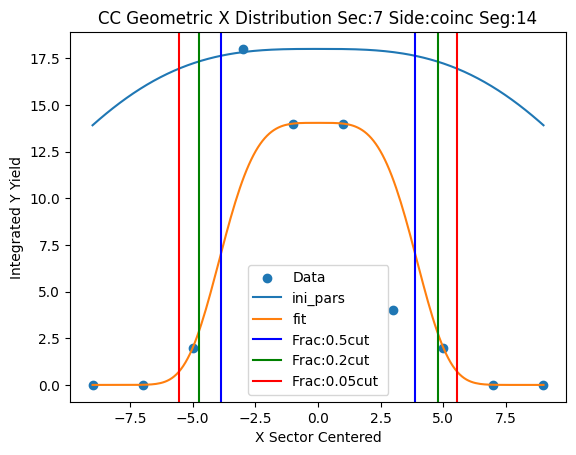

low,high -10 10
Parameters for Sec:7 Side:coinc Seg:15
test pars [14.03913643  1.          4.00071356  4.06794198]
fit pars [17.01991366  0.99999998  2.37068785  1.01830234]


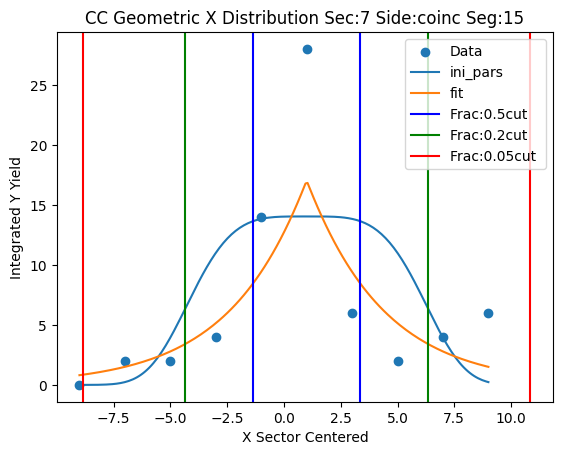

low,high -10 10
Value Error
Parameters for Sec:7 Side:coinc Seg:16
test pars [ 6.  0. 10.  3.]
fit pars [7.91309316e+00 4.76655506e-37 7.15619603e-01 4.27951261e-01]


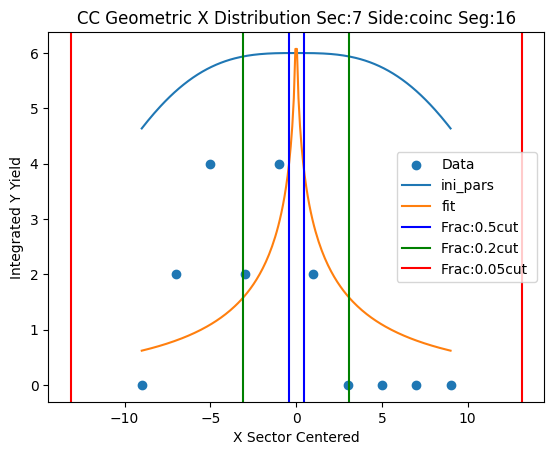

low,high -10 10


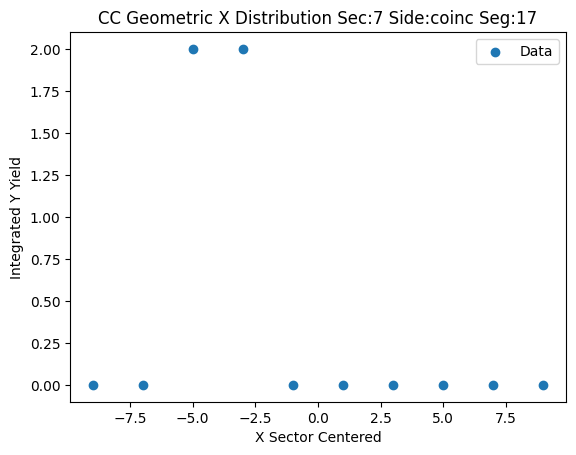

In [76]:
coinc_cut_lines = np.zeros((7,num_cc_seg,3,2))

low = 0.0
high = 0.0
space = 15

#Super_Gaus(x,a_,m_,s_,p_)


coinc_fit_pars = np.zeros((7,num_cc_seg,4))

ini_par = [83., 0.0, 10,   3,]

test_pars = np.zeros(4)

frac_cut = [0.5,0.2,0.05]

paddle_expand = 30

par_bounds = [[0.0,0.0,0.0,0.0],[np.inf,np.inf,np.inf,np.inf]]

side = 1
for sec in range(7):
    for i in range(4):
        test_pars[i] = ini_par[i]
    if(Count_Non_Zero(proj_x[sec][cc_hist_idx(side,seg)]) >= 6):
        test_pars[1] = xvals[np.argmax(proj_x[sec][cc_hist_idx(side,seg)])]
    for seg in range(num_cc_seg):
        if(Count_Non_Zero(proj_x[sec][cc_hist_idx(side,seg)]) >= 6):
            #low = xvals[np.argmax(proj_x[sec][cc_hist_idx(side,seg)])] - space
            #high = xvals[np.argmax(proj_x[sec][cc_hist_idx(side,seg)])] + space
            #low = coinc_x_bounds[sec][seg][0]
            #high = coinc_x_bounds[sec][seg][1]
            #if low > 0.0:
            #    low = -150
            #if high < 0.0:
            #    high = 150.
            #if np.isinf(low):
            #    if np.isinf(high):
            #        low = -150
            #    else:
            #        low = -high
            #elif np.isinf(high):
            #    high = -low
            if seg == 0 or seg == 1:
                low = -40
                high = 40
            else:
                low = -10
                high = 10
            print("low,high",low,high)
            new_yvals = Bounds_on_Y(xvals,low,high)
            new_zvals = Bounds_on_X_From_Y(proj_x[sec][cc_hist_idx(side,seg)],xvals,low,high)
            plt.scatter(new_yvals,new_zvals,label="Data")
            if(Count_Non_Zero(new_zvals) >= 5):
                if seg < num_sc_pad:
                    try: 
                        pars, pars_cov = op.curve_fit(Super_Gaus,new_yvals,new_zvals,p0=test_pars,bounds=par_bounds,maxfev=5000)
                        print("Parameters for Sec:{} Side:{} Seg:{}".format(sec+1,sides[side],seg+1))
                        print("test pars",test_pars)
                        print("fit pars",pars)
                        cont_x = np.linspace(new_yvals[0],new_yvals[len(new_yvals)-1],200)
                        plt.plot(cont_x,Super_Gaus(cont_x,*test_pars),label="ini_pars")
                        plt.plot(cont_x,Super_Gaus(cont_x,*pars),label="fit")

                        for j in range(4):
                            test_pars[j] = pars[j]
                            if j == 1:
                                if seg == num_cc_seg-1:
                                    test_pars[j]=xvals[np.argmax(proj_x[sec][cc_hist_idx(side,seg)])]
                                else:
                                    test_pars[j]=xvals[np.argmax(proj_x[sec][cc_hist_idx(side,seg+1)])]
                            if j == 2:
                                test_pars[j]+=1.
                            coinc_fit_pars[sec][seg][j] = pars[j]
                        #if hist_idx == paddle_expand:
                        #    test_pars[2]+=3
                        for k in range(3):
                            coinc_cut_lines[sec][seg][k][0] = super_gaus_cut_bound(frac_cut[k],0,*pars)
                            coinc_cut_lines[sec][seg][k][1] = super_gaus_cut_bound(frac_cut[k],1,*pars)
                            plt.axvline(x=coinc_cut_lines[sec][seg][k][0],color=color_order[k],label="Frac:{}cut ".format(frac_cut[k]))
                            plt.axvline(x=coinc_cut_lines[sec][seg][k][1],color=color_order[k])
                    except RuntimeError:
                        print("Runtime Error")
                    except ValueError:
                        print("Value Error")
                        try: 
                            test_pars[0] = proj_x[sec][cc_hist_idx(side,seg)][np.argmax(proj_x[sec][cc_hist_idx(side,seg)])]
                            test_pars[1] = 0.0
                            test_pars[2] = (high-low)/2.
                            test_pars[3] = 3.
                            pars2, pars_cov2 = op.curve_fit(Super_Gaus,new_yvals,new_zvals,p0=test_pars,bounds=par_bounds,maxfev=5000)
                            print("Parameters for Sec:{} Side:{} Seg:{}".format(sec+1,sides[side],seg+1))
                            print("test pars",test_pars)
                            print("fit pars",pars2)
                            cont_x = np.linspace(new_yvals[0],new_yvals[len(new_yvals)-1],200)
                            plt.plot(cont_x,Super_Gaus(cont_x,*test_pars),label="ini_pars")
                            plt.plot(cont_x,Super_Gaus(cont_x,*pars2),label="fit")

                            for j in range(4):
                                test_pars[j] = pars2[j]
                                if j == 1:
                                    if seg == num_cc_seg-1:
                                        test_pars[j]=xvals[np.argmax(proj_x[sec][cc_hist_idx(side,seg)])]
                                    else:
                                        test_pars[j]=xvals[np.argmax(proj_x[sec][cc_hist_idx(side,seg+1)])]
                                if j == 2:
                                    test_pars[j]+=1.
                                coinc_fit_pars[sec][seg][j] = pars2[j]
                            #if hist_idx == paddle_expand:
                            #    test_pars[2]+=3
                            for k in range(3):
                                coinc_cut_lines[sec][seg][k][0] = super_gaus_cut_bound(frac_cut[k],0,*pars2)
                                coinc_cut_lines[sec][seg][k][1] = super_gaus_cut_bound(frac_cut[k],1,*pars2)
                                plt.axvline(x=coinc_cut_lines[sec][seg][k][0],color=color_order[k],label="Frac:{}cut ".format(frac_cut[k]))
                                plt.axvline(x=coinc_cut_lines[sec][seg][k][1],color=color_order[k])
                        except RuntimeError:
                            print("Runtime Error")
                        except ValueError:
                            print("Value Error")
            plt.title("CC Geometric X Distribution Sec:{} Side:{} Seg:{}".format(sec+1,sides[side],seg+1))
            plt.ylabel("Integrated Y Yield")
            plt.xlabel("X Sector Centered")
            plt.legend()
            plt.show()

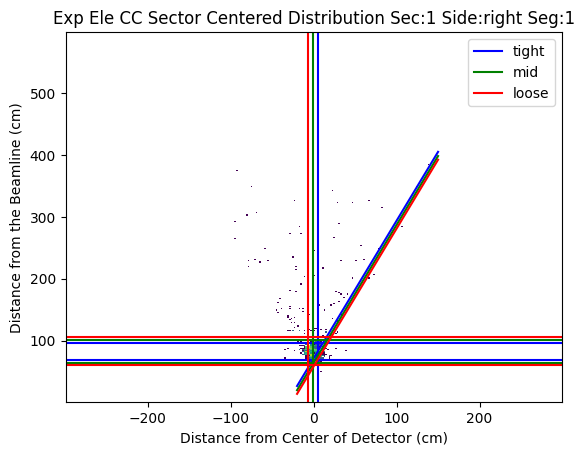

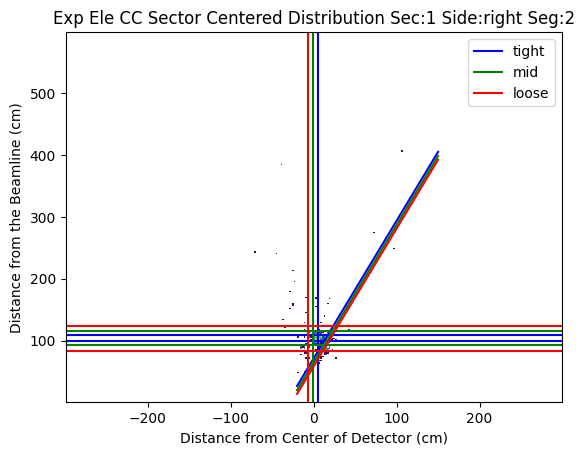

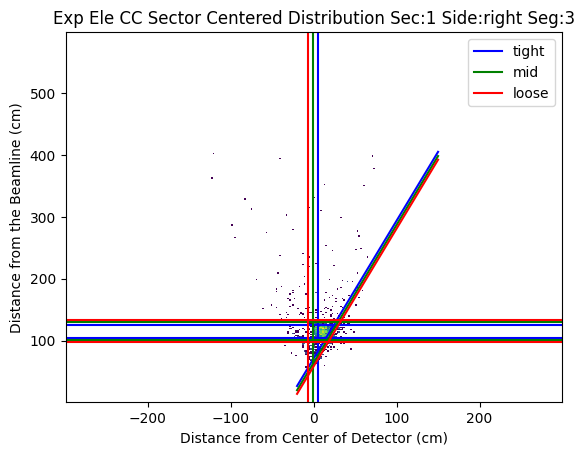

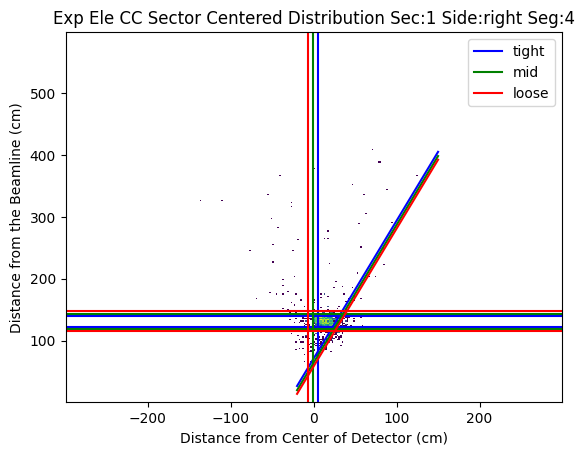

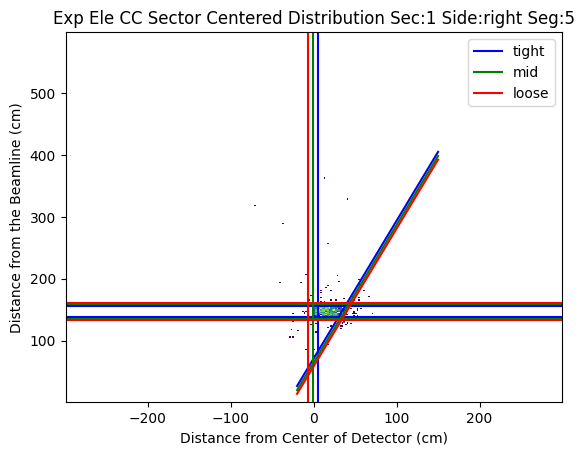

...

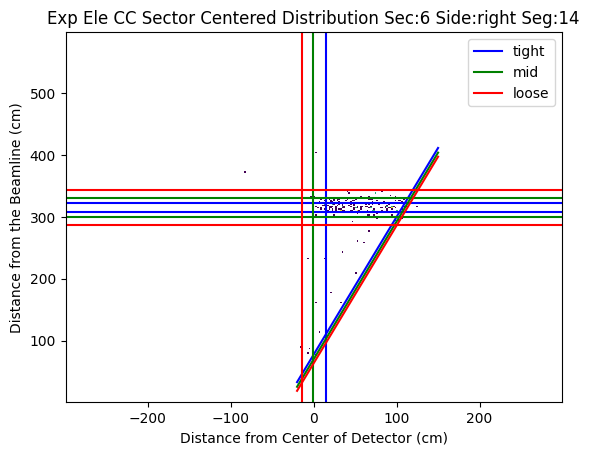

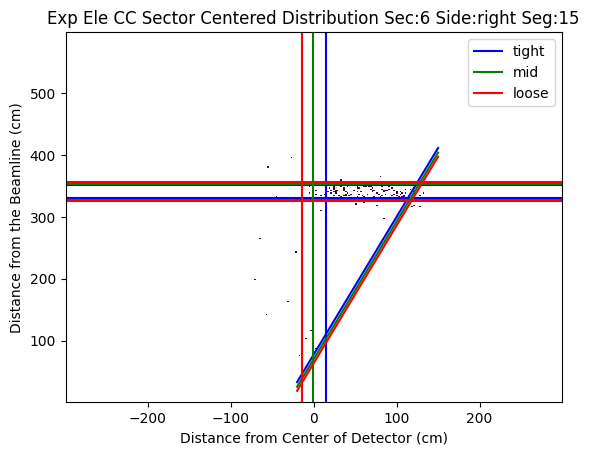

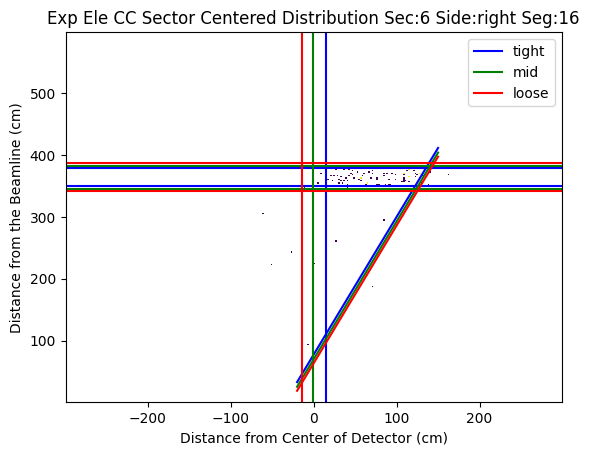

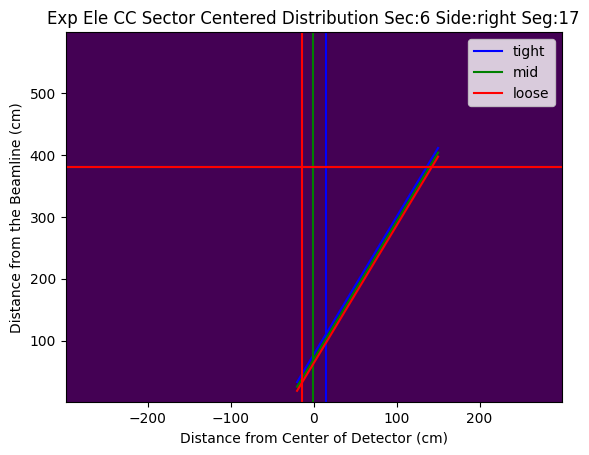

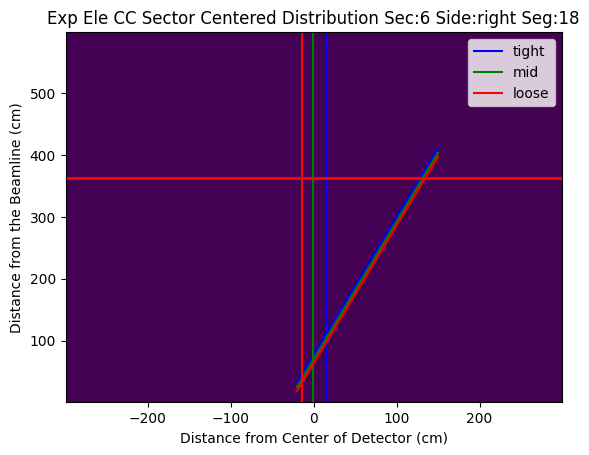

In [77]:
cont_x_r = np.linspace(-20.0,150.,200)
cont_x_l = np.linspace(-150.0,20.,200)

side = 0
for sec in range(6):
    for seg in range(num_cc_seg):
        plt.hist2d(dumb1_x[sec][cc_hist_idx(side,seg)], dumb1_y[sec][cc_hist_idx(side,seg)], bins=(xdim, ydim), weights=dense1[sec][cc_hist_idx(side,seg)],norm = mpl.colors.LogNorm())
        for cut in range(3):
            plt.plot(cont_x_r,Poly(cont_x_r,right_cut_pars[sec][cut]),label=cut_name[cut],color=color_order[cut])
            
            #plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),color=color_order[cut])
            if cut_lines[sec][cc_hist_idx(side,seg)][cut][0] > 0.0:
                plt.axvline(x=right_cen_edge[sec][cut],color=color_order[cut])
                plt.axhline(y=cut_lines[sec][cc_hist_idx(side,seg)][cut][0],color=color_order[cut])
                plt.axhline(y=cut_lines[sec][cc_hist_idx(side,seg)][cut][1],color=color_order[cut])
        plt.title("Exp Ele CC Sector Centered Distribution Sec:{} Side:{} Seg:{}".format(sec+1,sides[side],seg+1))
        plt.xlabel("Distance from Center of Detector (cm)")
        plt.ylabel("Distance from the Beamline (cm)")
        plt.legend()
        plt.show()

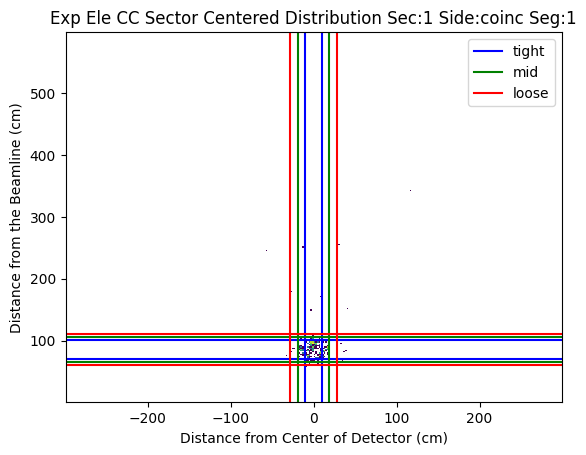

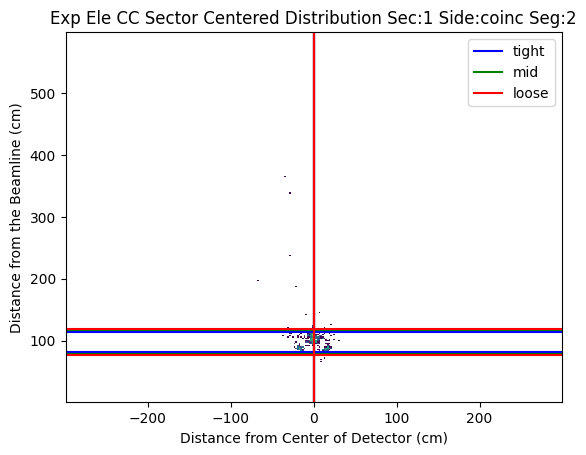

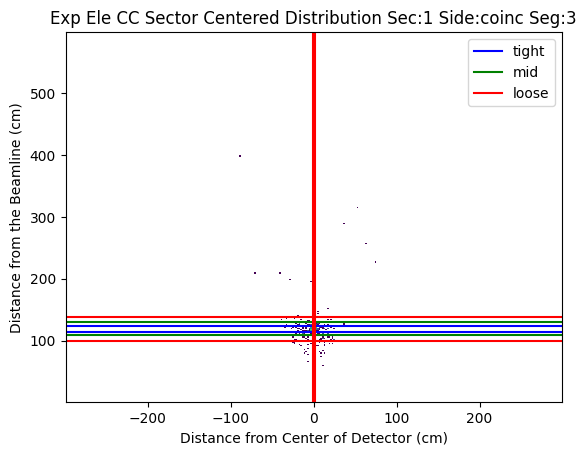

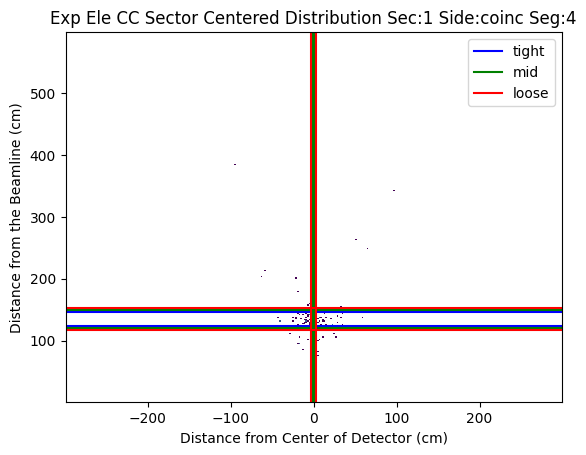

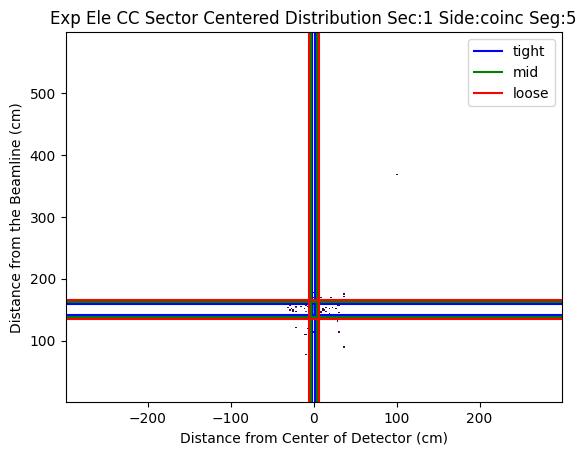

...

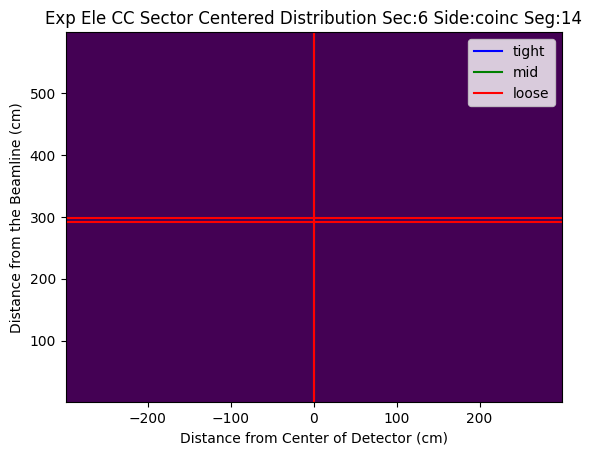

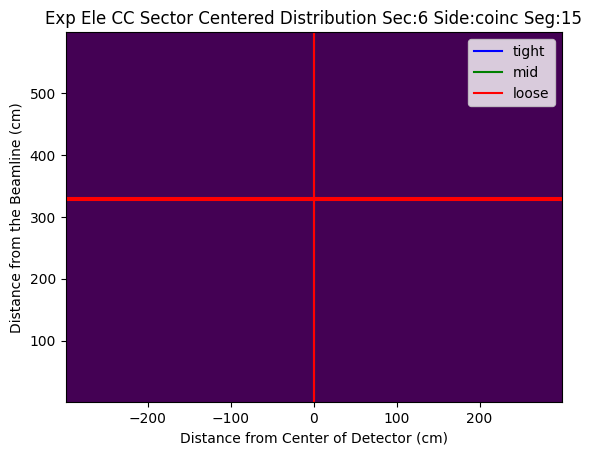

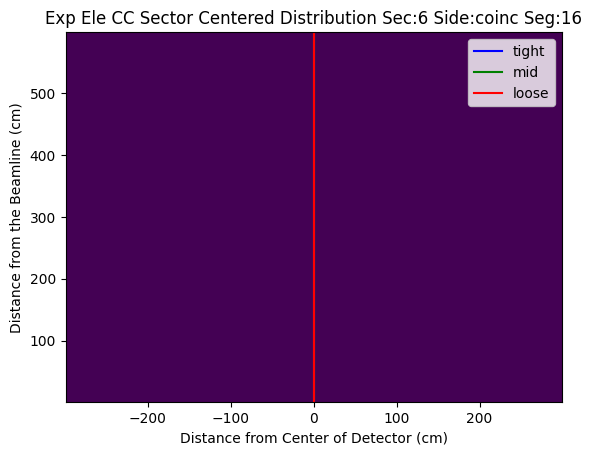

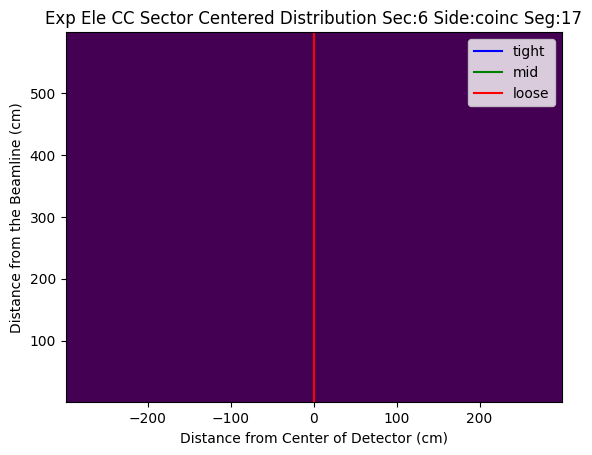

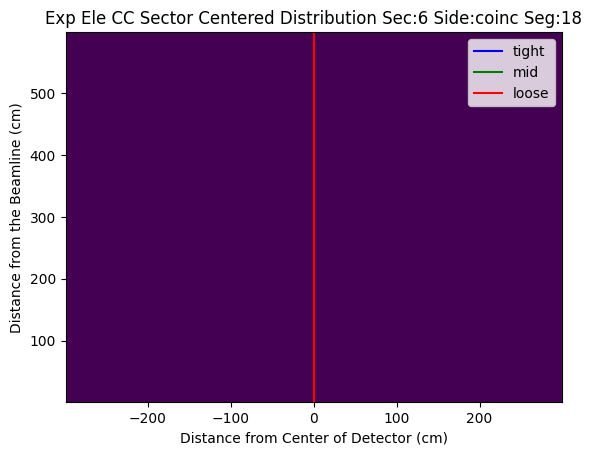

In [78]:

side = 1
for sec in range(6):
    for seg in range(num_cc_seg):
        plt.hist2d(dumb1_x[sec][cc_hist_idx(side,seg)], dumb1_y[sec][cc_hist_idx(side,seg)], bins=(xdim, ydim), weights=dense1[sec][cc_hist_idx(side,seg)],norm = mpl.colors.LogNorm())
        for cut in range(3):
            #plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),label=cut_name[cut],color=color_order[cut])
            plt.axvline(x=coinc_cut_lines[sec][seg][cut][0],color=color_order[cut],label=cut_name[cut])
            plt.axvline(x=coinc_cut_lines[sec][seg][cut][1],color=color_order[cut])
            #plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),color=color_order[cut])
            if cut_lines[sec][cc_hist_idx(side,seg)][cut][0] > 0.0:
                plt.axhline(y=cut_lines[sec][cc_hist_idx(side,seg)][cut][0],color=color_order[cut])
                plt.axhline(y=cut_lines[sec][cc_hist_idx(side,seg)][cut][1],color=color_order[cut])
        plt.title("Exp Ele CC Sector Centered Distribution Sec:{} Side:{} Seg:{}".format(sec+1,sides[side],seg+1))
        plt.xlabel("Distance from Center of Detector (cm)")
        plt.ylabel("Distance from the Beamline (cm)")
        plt.legend()
        plt.show()

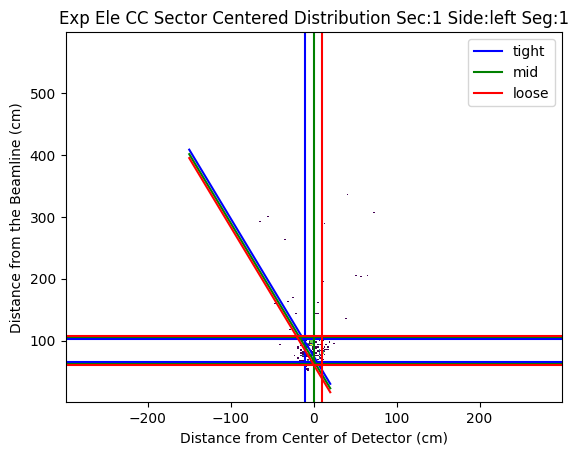

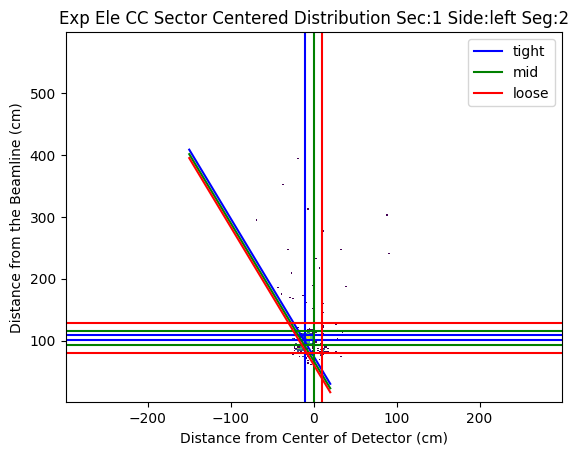

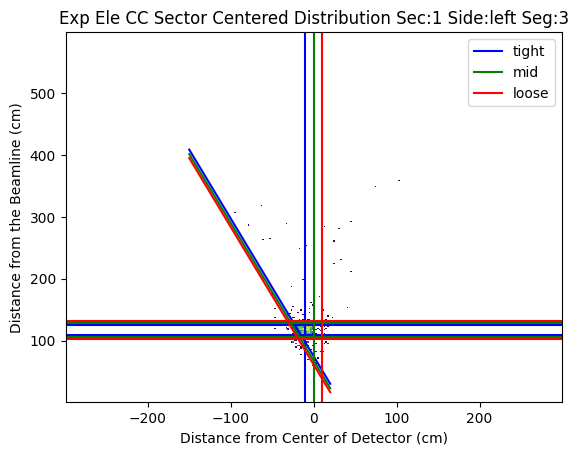

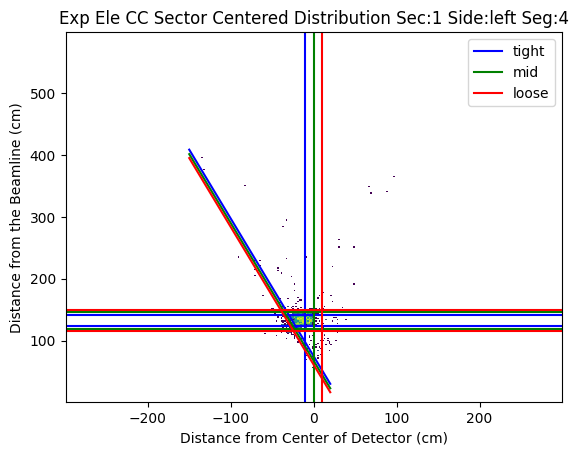

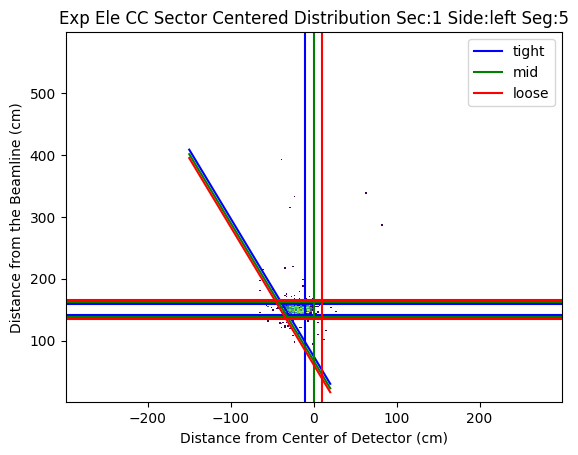

...

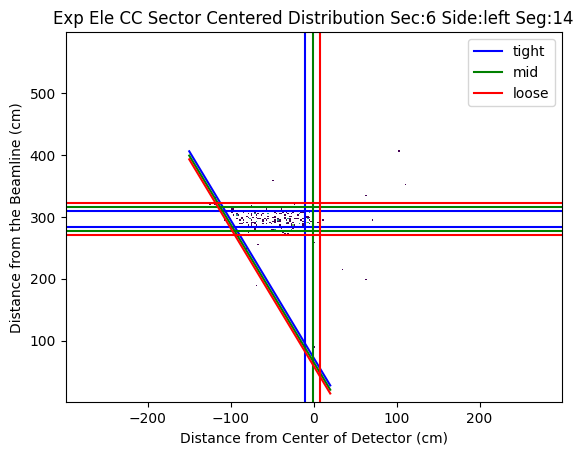

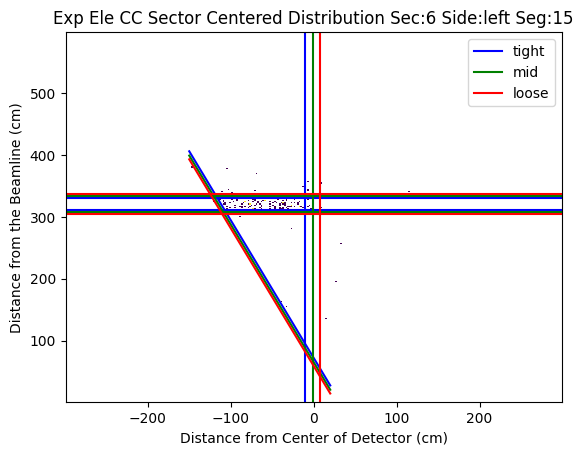

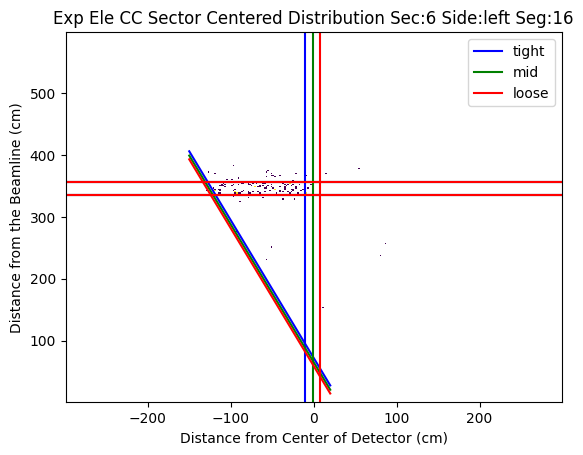

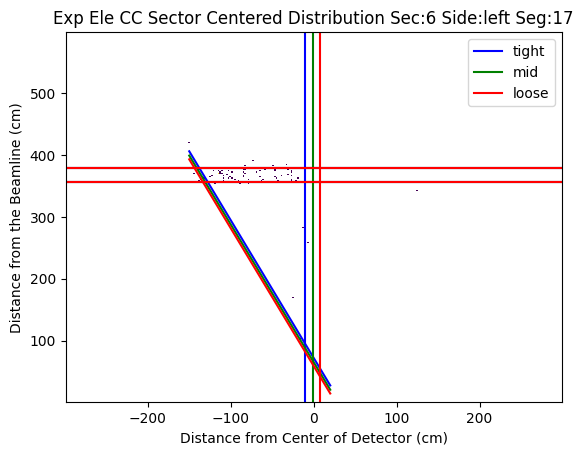

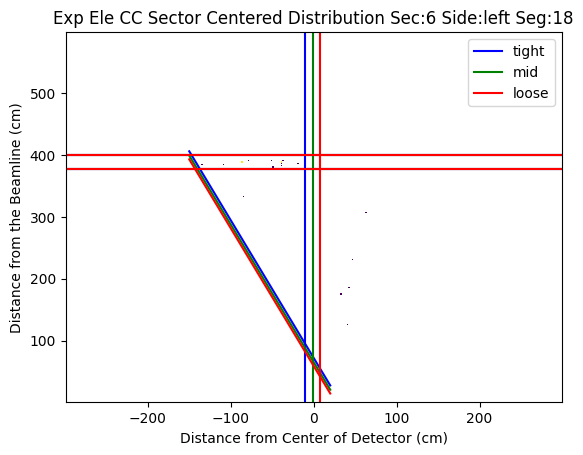

In [79]:
cont_x_r = np.linspace(-20.0,150.,200)
cont_x_l = np.linspace(-150.0,20.,200)

side = 2
for sec in range(6):
    for seg in range(num_cc_seg):
        plt.hist2d(dumb1_x[sec][cc_hist_idx(side,seg)], dumb1_y[sec][cc_hist_idx(side,seg)], bins=(xdim, ydim), weights=dense1[sec][cc_hist_idx(side,seg)],norm = mpl.colors.LogNorm())
        for cut in range(3):
            plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),label=cut_name[cut],color=color_order[cut])
            
            #plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),color=color_order[cut])
            if cut_lines[sec][cc_hist_idx(side,seg)][cut][0] > 0.0:
                plt.axvline(x=left_cen_edge[sec][cut],color=color_order[cut])
                plt.axhline(y=cut_lines[sec][cc_hist_idx(side,seg)][cut][0],color=color_order[cut])
                plt.axhline(y=cut_lines[sec][cc_hist_idx(side,seg)][cut][1],color=color_order[cut])
        plt.title("Exp Ele CC Sector Centered Distribution Sec:{} Side:{} Seg:{}".format(sec+1,sides[side],seg+1))
        plt.xlabel("Distance from Center of Detector (cm)")
        plt.ylabel("Distance from the Beamline (cm)")
        plt.legend()
        plt.show()

In [80]:
print("Cut Parameters for "+species+" CC Geometric Cut Edges")
print("side_cut_par[sec][{tight,mid,loose}][right,left][intercept,slope]")

for sec in range(6):
    for cut in range(3):
        if cut == 0:
            if sec ==0:
                print("{\t{\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
            else:
                print("\t{\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
        elif cut == 2:
            if sec==5:
                print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}}}}")
            else:
                print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}}},")
        else:
            print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
        
        

Cut Parameters for ele CC Geometric Cut Edges
side_cut_par[sec][{tight,mid,loose}][right,left][intercept,slope]
{	{	{	{ 70.98551398279388 , 2.2285714285714286 },{ 74.55781002472749 , -2.2285714285714286 }},
		{	{ 64.2299122064902 , 2.2285714285714286 },{ 67.29388664119375 , -2.2285714285714286 }},
		{	{ 58.318760652224476 , 2.2285714285714286 },{ 60.93795368060174 , -2.2285714285714286 }}},
	{	{	{ 64.40013195960987 , 2.4375 },{ 96.76239014424658 , -1.813953488372093 }},
		{	{ 58.41067983869384 , 2.4375 },{ 83.20868087418476 , -1.813953488372093 }},
		{	{ 53.16990923289231 , 2.4375 },{ 71.34918526288067 , -1.813953488372093 }}},
	{	{	{ 84.1481339498871 , 1.95 },{ 75.65498261685829 , -2.2285714285714286 }},
		{	{ 75.71463124171648 , 1.95 },{ 66.16342754641255 , -2.2285714285714286 }},
		{	{ 68.33531637206721 , 1.95 },{ 57.85831685977252 , -2.2285714285714286 }}},
	{	{	{ 75.56122224343876 , 2.0526315789473686 },{ 80.78146441102103 , -2.108108108108108 }},
		{	{ 70.02841560119867 , 2.05263

In [81]:
print("Cut Parameters for "+species+" CC Geometric Cut Centers")
print("side_center_cut_par[sec][{tight,mid,loose}][right,left]")

for sec in range(6):
    for cut in range(3):
        if cut == 0:
            if sec ==0:
                print("{\t{\t{",right_cen_edge[sec][cut],",",left_cen_edge[sec][cut],end="},")
            else:
                print("\t{\t{",right_cen_edge[sec][cut],",",left_cen_edge[sec][cut],end="},")
        elif cut == 2:
            if sec==5:
                print("{",right_cen_edge[sec][cut],",",left_cen_edge[sec][cut],"}}}")
            else:
                print("{",right_cen_edge[sec][cut],",",left_cen_edge[sec][cut],"}},")
        else:
            print("{",right_cen_edge[sec][cut],",",left_cen_edge[sec][cut],end="},")
        

Cut Parameters for ele CC Geometric Cut Centers
side_center_cut_par[sec][{tight,mid,loose}][right,left]
{	{	{ 4.647908521275895 , -10.64065135087495},{ -1.168156584041305 , 0.2140260165991268},{ -6.257213551193855 , 9.711868713138948 }},
	{	{ 10.42617464507611 , -10.788234520868713},{ -0.1653332984039504 , 0.9419250602587009},{ -9.432902748949003 , 11.20581469374519 }},
	{	{ 4.698025784617961 , -13.701690051737057},{ -2.685255810640943 , -1.4986763656651894},{ -9.145627206492485 , 9.178960609647696 }},
	{	{ 5.452697000040863 , -11.93528264210496},{ -1.2757849007236306 , 0.5834438794770377},{ -7.1632065638925635 , 11.537329585861288 }},
	{	{ 10.229388028172412 , -8.821950806008653},{ -0.5716547458292496 , -0.06314509958440162},{ -10.022567173080706 , 7.60080989353682 }},
	{	{ 14.482282581411464 , -10.23295766725063},{ -0.9183422936232861 , -0.7106977216216501},{ -14.393889059278694 , 7.621279730803707 }}}


In [82]:
print("Cut Parameters for "+species+" CC Geometric Cut Coinc X bounds")
print("side_cut_par[sec][seg][{tight,mid,loose}][{bot,top}]")

for sec in range(6):
    for seg in range(num_cc_seg):
        for cut in range(3):
            if cut == 0:
                if seg == 0:
                    if sec ==0:
                        print("{\t{\t{\t{",coinc_cut_lines[sec][seg][cut][0],",",coinc_cut_lines[sec][seg][cut][1],end="},")
                    else:
                        print("\t{\t{\t{",coinc_cut_lines[sec][seg][cut][0],",",coinc_cut_lines[sec][seg][cut][1],end="},")
                else:
                    print("\t\t{\t{",coinc_cut_lines[sec][seg][cut][0],",",coinc_cut_lines[sec][seg][cut][1],end="},")
            elif cut == 2:
                if seg == num_cc_seg-1:
                    if sec==5:
                        print("{",coinc_cut_lines[sec][seg][cut][0],",",coinc_cut_lines[sec][seg][cut][1],"}}}}")
                    else:
                        print("{",coinc_cut_lines[sec][seg][cut][0],",",coinc_cut_lines[sec][seg][cut][1],"}}},")
                else:
                    print("{",coinc_cut_lines[sec][seg][cut][0],",",coinc_cut_lines[sec][seg][cut][1],"}},")
            else:
                print("{",coinc_cut_lines[sec][seg][cut][0],",",coinc_cut_lines[sec][seg][cut][1],end="},")

Cut Parameters for ele CC Geometric Cut Coinc X bounds
side_cut_par[sec][seg][{tight,mid,loose}][{bot,top}]
{	{	{	{ -10.322972892842603 , 10.322972892842603},{ -18.304476866307358 , 18.304476866307358},{ -27.926899512393714 , 27.926899512393714 }},
		{	{ -1.6878847084881583e-09 , 1.6878847084881583e-09},{ -2.911114004954247e-06 , 2.911114004954247e-06},{ -0.0007100239425123318 , 0.0007100239425123318 }},
		{	{ -0.005486112884104395 , 0.005486112884104395},{ -0.12178506738865613 , 0.12178506738865613},{ -1.1983073541871485 , 1.1983073541871485 }},
		{	{ -0.057702251678561765 , 0.057702251678561765},{ -0.557493127346226 , 0.557493127346226},{ -2.969974435729614 , 2.969974435729614 }},
		{	{ -1.9372461622058224 , 1.9372461622058224},{ -3.766319480719331 , 3.766319480719331},{ -6.149918238757668 , 6.149918238757668 }},
		{	{ 0.34719679783776547 , 0.8464851789733518},{ -0.665699114239919 , 1.8593810910510364},{ -3.5758706423138866 , 4.769552619125004 }},
		{	{ -0.21167406080296475 , 0.21167

In [83]:
print("Y Cut Parameters for "+species+" CC Geometric Cut by Segment")
print("cut_par[segment][sec][side][{tight,mid,loose}][{bot,top}]")
for pad in range(num_cc_seg):
    for sec in range(6):
        for side in range(3):
            for cut in range(3):
                if math.isinf(cut_lines[sec][pad][cut][0]):
                    cut_lines[sec][pad][cut][0] = 0.0
                    cut_lines[sec][pad][cut][1] = 0.0
                if cut ==0:
                    if side ==0:
                        if sec == 0:
                            if pad==0:
                                print("{\t{\t{\t{\t{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],end="},")
                            else:
                                print("\t{\t{\t{\t{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],end="},")
                        else:
                            print("\t\t{\t{\t{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],end="},")
                    else:
                        print("\t\t\t{\t{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],end="},")
                elif cut == 2:
                    if side ==2:
                        if sec == 5:
                            if pad == num_cc_seg-1:
                                print("{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],"}}}}}")
                            else:
                                print("{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],"}}}},")
                        else:
                            print("{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],"}}},")
                    else:
                        print("{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],"}},")
                else:
                    print("{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],end="},")


Y Cut Parameters for ele CC Geometric Cut by Segment
cut_par[segment][sec][side][{tight,mid,loose}][{bot,top}]
{	{	{	{	{ 68.85721934889236 , 95.98418811133783},{ 64.24209474236149 , 100.5993127178687},{ 59.85919519453749 , 104.9822122656927 }},
			{	{ 68.85721934889236 , 95.98418811133783},{ 64.24209474236149 , 100.5993127178687},{ 59.85919519453749 , 104.9822122656927 }},
			{	{ 68.85721934889236 , 95.98418811133783},{ 64.24209474236149 , 100.5993127178687},{ 59.85919519453749 , 104.9822122656927 }}},
		{	{	{ 85.40611185950426 , 91.73322422394135},{ 77.26926094155647 , 99.87007514188915},{ 59.66988100094123 , 117.46945508250438 }},
			{	{ 85.40611185950426 , 91.73322422394135},{ 77.26926094155647 , 99.87007514188915},{ 59.66988100094123 , 117.46945508250438 }},
			{	{ 85.40611185950426 , 91.73322422394135},{ 77.26926094155647 , 99.87007514188915},{ 59.66988100094123 , 117.46945508250438 }}},
		{	{	{ 75.04710720370552 , 95.86012399041492},{ 69.26796447614481 , 101.63926671797563},{ 63.